In [1]:
import numpy as np
import matplotlib as mpl
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.pyplot as plt
import scipy as sc

In [2]:
import matplotlib.animation as animation

In [2]:
mpl.use("pgf")
#plt.rcParams['text.latex.unicode'] = True
plt.rcParams.update({
    "pgf.texsystem":   "pdflatex", # or any other engine you want to use
    "text.usetex":     True,       # use TeX for all texts
    "font.family":     "serif",
    "font.serif":      [],         # empty entries should cause the usage of the document fonts
    "font.sans-serif": [],
    "font.monospace":  [],
    "font.size":       10,         # control font sizes of different elements
    "axes.labelsize":  10,
    "legend.fontsize": 9,
    "xtick.labelsize": 9,
    "ytick.labelsize": 9,
    "pgf.preamble": [              # specify additional preamble calls for LaTeX's run
        r"\usepackage[T1]{fontenc}",
        r"\usepackage{siunitx}",
        r"\usepackage[utf8]{inputenc}",
        r"\DeclareUnicodeCharacter{2212}{-}",
    ],
})

In [3]:
from tqdm.notebook import tqdm

In [4]:
from ipywidgets import interact, interactive, fixed, interact_manual

In [5]:
from matplotlib.collections import LineCollection

In [6]:
from sympy import symbols, Symbol, expand, collect,sqrt,factor,fraction, diff, elliptic_e, elliptic_k, \
simplify,Poly,lambdify,series, cancel, Matrix
from sympy.parsing.mathematica import parse_mathematica as prsmat
x = symbols('x')

In [7]:
np.seterr('ignore')

{'divide': 'warn', 'over': 'warn', 'under': 'ignore', 'invalid': 'warn'}

In [8]:
### parse field expression ###
P,P1,P2,P3,P4 = symbols('P P1 P2 P3 P4')
Z,Z1,Z2,Z3,Z4 = symbols('Z Z1 Z2 Z3 Z4')
H1_wol_str = '(P2 Z1-P1 Z2)/(P1^2+Z1^2)^(3/2)'
H1_wol = prsmat(H1_wol_str)
H1_wol_lam = lambdify([P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4], H1_wol)
H2_wol_str = '-(Z1/(P Sqrt[P1^2+Z1^2]))'
H2_wol = prsmat(H2_wol_str)
H2_wol_lam = lambdify([P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4], H2_wol)


laplH1_wol_str='(1/(P (P1^2+Z1^2)^(9/2)))(-P1^6 Z3+P1^2 Z1 (3 P P2 (5 P2^2-13 Z2^2)+Z1^2 (-3 P2^2+2 P P4+3 Z2^2)-Z1^3 Z3+2 P Z1 (-P3 Z2+P2 Z3))+P1^4 (Z1 (-3 P2^2+P P4+3 Z2^2)-2 Z1^2 Z3+2 P (2 P3 Z2+3 P2 Z3))+P Z1^3 (-3 P2^3+Z1 (P4 Z1-6 P3 Z2)+P2 (15 Z2^2-4 Z1 Z3))+P1^5 (P3 Z1+3 P2 Z2-P Z4)+P1 Z1^2 (P3 Z1^3+3 P Z2 (13 P2^2-5 Z2^2)+10 P Z1 (-P2 P3+Z2 Z3)-Z1^2 (3 P2 Z2+P Z4))+P1^3 (2 P3 Z1^3+P (-10 P2 P3 Z1-15 P2^2 Z2+3 Z2^3+10 Z1 Z2 Z3-2 Z1^2 Z4)))'
laplH1_wol = prsmat(laplH1_wol_str)
laplH1_wol_lam = lambdify([P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4], laplH1_wol)
laplH2_wol_str='(1/(P^3 (P1^2+Z1^2)^(7/2)))(-P1^6 Z1+P P2 Z1^3 (P P2+Z1^2)+P P1^5 Z2+P^2 P1^3 (P3 Z1+3 P2 Z2)+P P1 Z1^2 (P P3 Z1-(5 P P2+Z1^2) Z2)-P1^4 (P P2 Z1+2 Z1^3+P^2 Z3)-P1^2 Z1 (Z1^4+P^2 (3 P2^2-4 Z2^2)+P^2 Z1 Z3))'
laplH2_wol = prsmat(laplH2_wol_str)
laplH2_wol_lam = lambdify([P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4], laplH2_wol)

In [9]:
def get_ext_array(arr, tp='z'):
    n_arr = len(arr)-1
    ext_arr = np.zeros(2*n_arr)
    ext_arr[0:n_arr+1]=arr
    if tp=='p':
        ext_arr[n_arr+1:]=-arr[::-1][1:-1:]
    else:
        ext_arr[n_arr+1:]=arr[::-1][1:-1:]
    return ext_arr

In [10]:
#%run G_define.ipynb

In [11]:
### on the axis ###
def D_z_axis_part(z_,rho1_):
    return -2*np.pi*rho1_*z_*(rho1_**2-2*z_**2)/(rho1_**2+z_**2)**(5/2)
def D_rho_axis_part(z_,rho1_):
    return 2*np.pi*rho1_**2*(rho1_**2-2*z_**2)/(rho1_**2+z_**2)**(5/2)

In [12]:
import numdifftools as nd 

## setting

In [918]:
N=100

j_N = np.arange(N+1)
tau_N = j_N/N


n_int = 200
N_int = n_int*20

Tau_int = np.arange(N_int+1)/(N_int)
tau_int = np.arange(n_int+1)/(n_int)

dtau_int = tau_int.reshape(-1,1) - Tau_int.reshape(1,-1) 

In [919]:
weights_simp1 = np.zeros_like(Tau_int)
weights_simp2 = np.zeros_like(Tau_int)

weights_simp1 +=1
weights_simp1[0]=1/2; weights_simp1[-1]=1/2

weights_simp2[::2] +=1
weights_simp2[::2][0]=1/2; weights_simp2[::2][-1]=1/2

weights_simp = 4/3*weights_simp1 - 2/3*weights_simp2
weights_simp /= N_int

In [920]:
Kron = (np.abs(dtau_int)<1e-6)
AKron = ~Kron

In [16]:
def get_int_field(field_rfft):
    """
    Returns N_int points of field by furier transphorm from `field_fur`
    """
    field_int = np.fft.irfft(field_rfft, norm='forward', n=2*N_int)
    return field_int[0:N_int+1]

def get_rfft_N_field(field):
    """
    Returns rfft of filed
    up to N harmonics
    """
    field_rfft=np.fft.rfft(field, norm='forward')
    return field_rfft[0:N]

def get_int_fields(field_rfft):
    """
    Returns N_int points of field and 4 derivatives by furier transphorm from `field_fur`
    """

    field_int = np.fft.irfft(field_rfft, norm='forward', n=2*N_int)
    der_oper = 1j*np.pi*np.arange(field_rfft.shape[0])
    field_1_int = np.fft.irfft(field_rfft*der_oper, norm='forward', n=2*N_int)
    field_2_int = np.fft.irfft(field_rfft*der_oper**2, norm='forward', n=2*N_int)
    field_3_int = np.fft.irfft(field_rfft*der_oper**3, norm='forward', n=2*N_int)
    field_4_int = np.fft.irfft(field_rfft*der_oper**4, norm='forward', n=2*N_int)
    return field_int[0:N_int+1], field_1_int[0:N_int+1], \
           field_2_int[0:N_int+1], field_3_int[0:N_int+1],field_4_int[0:N_int+1]

In [17]:
def get_VolSqr(P_fur, Z_fur):    
    ### find fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)    
    V = np.sqrt(P1**2+Z1**2)  
    Sqr = np.sum(2*np.pi * V*P *weights_simp)
    Vol= np.sum(-np.pi * P**2*Z1*weights_simp)
    V_cal = Vol/4/np.pi*3/(Sqr/4/np.pi)**(3/2)
    return Vol, Sqr, V_cal

In [18]:
from numpy import sqrt as Sqrt

In [19]:
def List(*a):
    return np.array(a)


def get_G_tilde_KE(rho, z, rho1):
    return List(List(List((2*
            (rho**2 + rho1**2 + 2*z**2))/
          (rho*Sqrt((rho - rho1)**2 + z**2)),
         (2*rho1*z)/
          (rho*Sqrt((rho - rho1)**2 + z**2))),
        List((-2*z)/Sqrt((rho - rho1)**2 + z**2),
         (4*rho1)/Sqrt((rho - rho1)**2 + z**2))),
       List(List((-2*
            ((rho**2 - rho1**2)**2 + 
              (3*rho**2 + 3*rho1**2)*z**2 + 
              2*z**4))/
          (rho*Sqrt((rho - rho1)**2 + z**2)*
            ((rho + rho1)**2 + z**2)),
         (-2*rho1*z*(-rho**2 + rho1**2 + z**2))/
          (rho*Sqrt((rho - rho1)**2 + z**2)*
            ((rho + rho1)**2 + z**2))),
        List((2*z*(rho**2 - rho1**2 + z**2))/
          (Sqrt((rho - rho1)**2 + z**2)*
            ((rho + rho1)**2 + z**2)),
         (4*rho1*z**2)/
          (Sqrt((rho - rho1)**2 + z**2)*
            ((rho + rho1)**2 + z**2)))))

In [20]:
from numba import njit, vectorize

In [21]:
@njit
def get_G_tilde_KE_numba(rho, z, rho1):
    
    ### K part ###
    factor_K = 2/Sqrt((rho - rho1)**2 + z**2)
    
    arr_K_0_0 = (rho**2 + rho1**2 + 2*z**2)/rho
    arr_K_0_1 = (rho1*z)/rho
    arr_K_1_0 = -z
    arr_K_1_1 = 2*rho1
    arr_K_0_0 *= factor_K ;arr_K_0_1 *= factor_K;
    arr_K_1_0 *= factor_K ;arr_K_1_1 *= factor_K;
    
    arr_K = [[arr_K_0_0,arr_K_0_1],
            [arr_K_1_0, arr_K_1_1]]
    
    ### E part ###
    factor_E = -2/(Sqrt((rho - rho1)**2 + z**2)*((rho + rho1)**2 + z**2))
    
    arr_E_0_0 =((rho**2 - rho1**2)**2 + 3*(rho**2 + rho1**2)*z**2 + 2*z**4)/rho
    arr_E_0_1 =(rho1*z*(-rho**2 + rho1**2 + z**2))/rho
    arr_E_1_0 =-(z*(rho**2 - rho1**2 + z**2))
    arr_E_1_1 =-2*rho1*z**2
    
    arr_E_0_0 *= factor_E ;arr_E_0_1 *= factor_E;
    arr_E_1_0 *= factor_E ;arr_E_1_1 *= factor_E;
    
    arr_E = [[arr_E_0_0,arr_E_0_1],
            [arr_E_1_0, arr_E_1_1]]
    
    return [arr_K,arr_E]

In [22]:
print('Checking equality')
print(np.allclose(get_G_tilde_KE(0.2,3,5.),
np.array(get_G_tilde_KE_numba(0.2,3,5.))))

test_arr = np.linspace(1,2,10)
res = get_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

test_arr = np.linspace(1,2,10).reshape(2,-1)
res = get_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

Checking equality
True
True
True


In [23]:
get_G_tilde_KE = get_G_tilde_KE_numba

In [24]:
def get_drho_G_tilde_KE(rho, z, rho1):
    return List(List(List((-2*((-(rho**2*rho1) + rho1**3)**2 + 
              (3*rho**4 - 3*rho**2*rho1**2 + 4*rho1**4)*z**2 + 5*(rho**2 + rho1**2)*z**4 + 2*z**6))/
          (rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)),
         (2*rho1*z*(-(rho + rho1)**2 - z**2)*
            ((rho**2 - rho1**2)**2 + 2*(2*rho**2 + rho1**2)*z**2 + z**4))/
          (rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2)),
        List((2*z*((rho**2 - rho1**2)**2 + (rho**2 + rho1**2)*z**2))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)),
         (2*rho1*(-(rho + rho1)**2 - z**2)*
            ((rho**2 - rho1**2)**2 + (rho**2 + 3*rho1**2)*z**2 + 2*z**4))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2))),
       List(List((2*(rho1**2*(-rho**2 + rho1**2)**3 + 
              (3*rho**6 + 3*rho**4*rho1**2 - 11*rho**2*rho1**4 + 5*rho1**6)*z**2 + 
              (8*rho**4 - rho**2*rho1**2 + 9*rho1**4)*z**4 + 7*(rho**2 + rho1**2)*z**6 + 2*z**8))/
          (rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2),
         (2*rho1*z*(-3*rho**6 + 7*rho**4*rho1**2 - 5*rho**2*rho1**4 + rho1**6 + 
              (3*rho**4 + 2*rho**2*rho1**2 + 3*rho1**4)*z**2 + (7*rho**2 + 3*rho1**2)*z**4 + z**6))/
          (rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2)),
        List((-2*z*((rho**2 - rho1**2)**2*(rho**2 + rho1**2) + 
              2*(rho**4 - 6*rho**2*rho1**2 + rho1**4)*z**2 + (rho**2 + rho1**2)*z**4))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2),
         (2*rho1*(-(rho**2 - rho1**2)**3 + 4*(-2*rho**4 + rho**2*rho1**2 + rho1**4)*z**2 + 
              5*(-rho**2 + rho1**2)*z**4 + 2*z**6))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2))))

def get_dz_G_tilde_KE(rho, z, rho1):
    return List(List(List((2*z*(3*(rho**2 - rho1**2)**2 + 5*(rho**2 + rho1**2)*z**2 + 2*z**4))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)),
         (2*rho1*((rho**2 - rho1**2)**2 + (3*rho**2 + rho1**2)*z**2))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2))),
        List((-2*((rho**2 - rho1**2)**2 + (rho**2 + 3*rho1**2)*z**2))/
          (((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)),
         (4*rho1*z**3)/(((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)))),
       List(List((-2*z*(3*(rho**2 - rho1**2)**2*(rho**2 + rho1**2) + 
              8*(rho**4 - rho**2*rho1**2 + rho1**4)*z**2 + 7*(rho**2 + rho1**2)*z**4 + 2*z**6))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2),
         (-2*rho1*(-(rho**2 - rho1**2)**3 + 2*(3*rho**4 - 4*rho**2*rho1**2 + rho1**4)*z**2 + 
              (7*rho**2 + rho1**2)*z**4))/
          (rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2)),
        List((2*((rho**2 - rho1**2)**3 + 2*(rho**4 - 4*rho**2*rho1**2 + 3*rho1**4)*z**2 + 
              (rho**2 + 7*rho1**2)*z**4))/(((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2),
         (4*rho1*z*((rho**2 - rho1**2)**2 - 2*(rho**2 + rho1**2)*z**2 - 3*z**4))/
          (((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2))))

In [25]:
@njit
def get_drho_G_tilde_KE_numba(rho, z, rho1):
    ### K part ###
    factor_K = 2/(rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2))
    
    arr_K_0_0 =-(-(rho**2*rho1) + rho1**3)**2 + (-3*rho**4 + 3*rho**2*rho1**2 - 4*rho1**4)*z**2 - 5*(rho**2 + rho1**2)*z**4 - 2*z**6
    arr_K_0_1 =-(rho1*z*((rho**2 - rho1**2)**2 + 2*(2*rho**2 + rho1**2)*z**2 + z**4))
    arr_K_1_0 =rho*z*((rho**2 - rho1**2)**2 + (rho**2 + rho1**2)*z**2)
    arr_K_1_1 =-(rho*rho1*((rho**2 - rho1**2)**2 + (rho**2 + 3*rho1**2)*z**2 + 2*z**4))
    
    arr_K_0_0 *= factor_K ;arr_K_0_1 *= factor_K;
    arr_K_1_0 *= factor_K ;arr_K_1_1 *= factor_K;
    
    arr_K = [[arr_K_0_0,arr_K_0_1],
            [arr_K_1_0, arr_K_1_1]]
    
    ### E part ###
    factor_E = -2/(rho**2*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2)
    
    arr_E_0_0 = rho1**2*(rho**2 - rho1**2)**3 - (3*rho**6 + 3*rho**4*rho1**2 - 11*rho**2*rho1**4 + 5*rho1**6)*z**2 + (-8*rho**4 + rho**2*rho1**2 - 9*rho1**4)*z**4 - 7*(rho**2 + rho1**2)*z**6 - 2*z**8
    arr_E_0_1 = -(rho1*z*(-3*rho**6 + 7*rho**4*rho1**2 - 5*rho**2*rho1**4 + rho1**6 + (3*rho**4 + 2*rho**2*rho1**2 + 3*rho1**4)*z**2 + (7*rho**2 + 3*rho1**2)*z**4 + z**6))
    arr_E_1_0 = rho*z*((rho**2 - rho1**2)**2*(rho**2 + rho1**2) + 2*(rho**4 - 6*rho**2*rho1**2 + rho1**4)*z**2 + (rho**2 + rho1**2)*z**4)
    arr_E_1_1 = rho*rho1*((rho**2 - rho1**2)**3 + 4*(rho - rho1)*(rho + rho1)*(2*rho**2 + rho1**2)*z**2 + 5*(rho - rho1)*(rho + rho1)*z**4 - 2*z**6)
    
    arr_E_0_0 *= factor_E ;arr_E_0_1 *= factor_E;
    arr_E_1_0 *= factor_E ;arr_E_1_1 *= factor_E;
    
    arr_E = [[arr_E_0_0,arr_E_0_1],
            [arr_E_1_0, arr_E_1_1]]
    
    return [arr_K,arr_E]

In [26]:
@njit
def get_dz_G_tilde_KE_numba(rho, z, rho1):
    ### K part ###
    factor_K = 2/(rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2))
    
    arr_K_0_0 =3*(rho**2 - rho1**2)**2*z + 5*(rho**2 + rho1**2)*z**3 + 2*z**5
    arr_K_0_1 =rho1*((rho**2 - rho1**2)**2 + (3*rho**2 + rho1**2)*z**2)
    arr_K_1_0 =-(rho*((rho**2 - rho1**2)**2 + (rho**2 + 3*rho1**2)*z**2))
    arr_K_1_1 =2*rho*rho1*z**3
    
    arr_K_0_0 *= factor_K ;arr_K_0_1 *= factor_K;
    arr_K_1_0 *= factor_K ;arr_K_1_1 *= factor_K;
    
    arr_K = [[arr_K_0_0,arr_K_0_1],
            [arr_K_1_0, arr_K_1_1]]
    
    ### E part ###
    factor_E = -2/(rho*((rho - rho1)**2 + z**2)**1.5*((rho + rho1)**2 + z**2)**2)
    
    arr_E_0_0 =3*(rho**2 - rho1**2)**2*(rho**2 + rho1**2)*z + 8*(rho**4 - rho**2*rho1**2 + rho1**4)*z**3 + 7*(rho**2 + rho1**2)*z**5 + 2*z**7
    arr_E_0_1 =rho1*(-(rho**2 - rho1**2)**3 + 2*(3*rho**4 - 4*rho**2*rho1**2 + rho1**4)*z**2 + (7*rho**2 + rho1**2)*z**4)
    arr_E_1_0 =-(rho*((rho**2 - rho1**2)**3 + 2*(rho**4 - 4*rho**2*rho1**2 + 3*rho1**4)*z**2 + (rho**2 + 7*rho1**2)*z**4))
    arr_E_1_1 =2*rho*rho1*z*(-(rho**2 - rho1**2)**2 + 2*(rho**2 + rho1**2)*z**2 + 3*z**4)
    
    arr_E_0_0 *= factor_E ;arr_E_0_1 *= factor_E;
    arr_E_1_0 *= factor_E ;arr_E_1_1 *= factor_E;
    
    arr_E = [[arr_E_0_0,arr_E_0_1],
            [arr_E_1_0, arr_E_1_1]]
    
    return [arr_K,arr_E]

In [27]:
print('Check drho')
print(np.allclose(get_drho_G_tilde_KE(0.2,3,5.),
np.array(get_drho_G_tilde_KE_numba(0.2,3,5.))))

test_arr = np.linspace(1,2,10)
res = get_drho_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_drho_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

test_arr = np.linspace(1,2,10).reshape(2,-1)
res = get_drho_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_drho_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

print('Check dz')
print(np.allclose(get_dz_G_tilde_KE(0.2,3,5.),
np.array(get_dz_G_tilde_KE_numba(0.2,3,5.))))

test_arr = np.linspace(1,2,10)
res = get_dz_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_dz_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

test_arr = np.linspace(1,2,10).reshape(2,-1)
res = get_dz_G_tilde_KE(test_arr, test_arr*2,test_arr)
res_numba = np.array(get_dz_G_tilde_KE_numba(
    test_arr, test_arr*2,test_arr))
print(np.allclose(res, res_numba))

Check drho
True
True
True
Check dz
True
True
True


In [28]:
get_drho_G_tilde_KE = get_drho_G_tilde_KE_numba
get_dz_G_tilde_KE = get_dz_G_tilde_KE_numba

In [29]:
from scipy.special import ellipk, ellipe


def get_all_G_tilde(P, P_int, Z, Z_int):
    dZ = Z_int.reshape(-1,1) - Z.reshape(1,-1)
    Rho = P_int.reshape(-1,1) + dZ*0
    Rho1 = P.reshape(1,-1) + dZ*0

    G_tilde_KE = np.array(get_G_tilde_KE(Rho, dZ, Rho1))
    

    Nu_mesh = 4*Rho*Rho1/(dZ**2 + (Rho-Rho1)**2)
    
    K,E = ellipk(-Nu_mesh), ellipe(-Nu_mesh)
    G = G_tilde_KE[0]*K
    G +=G_tilde_KE[1]*E
    return G

In [30]:
def get_dG_tilde(P, P_int, Z, Z_int):
    dZ = Z_int.reshape(-1,1) - Z.reshape(1,-1)
    Rho = P_int.reshape(-1,1) + dZ*0
    Rho1 = P.reshape(1,-1) + dZ*0
    
    drho_G_tilde_KE = np.array(get_drho_G_tilde_KE(Rho, dZ, Rho1))
    dz_G_tilde_KE   = np.array(get_dz_G_tilde_KE(Rho, dZ, Rho1))
    
    Nu_mesh = 4*Rho*Rho1/(dZ**2 + (Rho-Rho1)**2)
    K,E = ellipk(-Nu_mesh), ellipe(-Nu_mesh)

    drho_G = drho_G_tilde_KE[0]*K + drho_G_tilde_KE[1]*E
    dz_G = dz_G_tilde_KE[0]*K + dz_G_tilde_KE[1]*E
    return drho_G, dz_G

### Testing field

In [46]:
P_fur = np.zeros(N);
P_fur[1]=2./2

Z_fur = np.zeros(N);
Z_fur[1]=1./2

In [47]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)

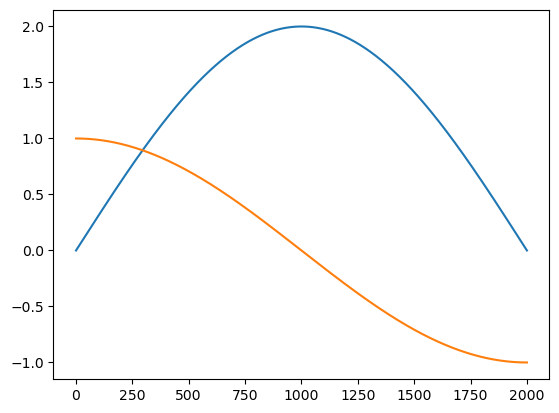

In [48]:
plt.figure()
plt.plot(P)
plt.plot(Z)

Text(0.5, 1.0, 'Input form \n $V=16.76, S=34.69$, $\\mathcal{V}=$$0.87$')

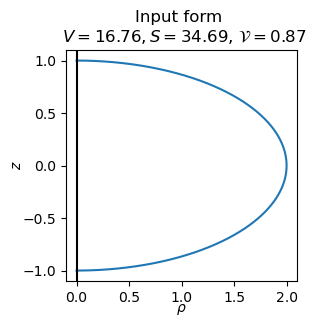

In [49]:
# %matplotlib notebook

Vol0,Sqr0,V_cal0 = get_VolSqr(P_fur, Z_fur)


plt.figure(figsize=(3,3))
plt.plot(P, Z,lw=1.5, ms=8, color = 'C0')
plt.axis('scaled')

plt.axvline(0, color='k')
plt.xlabel(r'$\rho$', labelpad=-2)
plt.ylabel(r'$z$', labelpad=-1)
plt.title(fr'Input form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.2f}$')

### force function

In [31]:
def get_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4):
    V = np.sqrt(P1**2+Z1**2)
    H1 = H1_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    H2 = H2_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    H2[0] = H1[0];H2[-1] = H1[-1]
    
    
    K = H1*H2
    H = H1+H2
    
    laplH1 = laplH1_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    laplH1[0] = 2*(-P1[0]**2*Z4[0]+4*P1[0]*P3[0]*Z2[0]+3*Z2[0]**3)/np.abs(P1[0])**5/P1[0]
    laplH1[-1] = 2*(-P1[-1]**2*Z4[-1]+4*P1[-1]*P3[-1]*Z2[-1]+3*Z2[-1]**3)/np.abs(P1[-1])**5/P1[-1]
    
    laplH2 = laplH2_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    laplH2[0]=laplH1[0]/3
    laplH2[-1]=laplH1[-1]/3
    
    laplH = laplH1+laplH2
    
    force =  H**3/2 - 2*H*K + laplH
    return force

def get_force_from_ar(P_fur, Z_fur):
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    return get_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4)

In [32]:
def get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4):
    V = np.sqrt(P1**2+Z1**2)
    H1 = H1_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    H2 = H2_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    H2[0] = H1[0];H2[-1] = H1[-1]
    
    
    K = H1*H2
    H = H1+H2
    
    laplH1 = laplH1_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    laplH1[0] = 2*(-P1[0]**2*Z4[0]+4*P1[0]*P3[0]*Z2[0]+3*Z2[0]**3)/np.abs(P1[0])**5/P1[0]
    laplH1[-1] = 2*(-P1[-1]**2*Z4[-1]+4*P1[-1]*P3[-1]*Z2[-1]+3*Z2[-1]**3)/np.abs(P1[-1])**5/P1[-1]
    
    laplH2 = laplH2_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
    laplH2[0]=laplH1[0]/3
    laplH2[-1]=laplH1[-1]/3
    
    laplH = laplH1+laplH2
    
    force =  H**3/2 - 2*H*K + laplH
    return H, force

def get_H_force_from_ar(P_fur, Z_fur):
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    return get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4)

### Normal delta

In [33]:
def get_normal_delta_PZ(P_fur, Z_fur, normal_delta_fur):
    normal_delta = get_int_field(normal_delta_fur)
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)    
    V = np.sqrt(P1**2+Z1**2)  
    
    normal_delta_P = get_int_field(normal_delta_fur)*(-Z1/V)
    normal_delta_Z = get_int_field(normal_delta_fur)*(P1/V)
    
    return normal_delta_P,normal_delta_Z

def get_normal_delta_PZ_fur(P_fur, Z_fur, normal_delta_fur):
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur, Z_fur, normal_delta_fur)
    normal_delta_P_fur = np.real(np.fft.rfft(get_ext_array(normal_delta_P, 'p'), norm='forward')[:n_int]/(-1j))
    normal_delta_Z_fur = np.fft.rfft(get_ext_array(normal_delta_Z, 'z'), norm='forward')[:n_int].real
    return normal_delta_P_fur, normal_delta_Z_fur

### Velocity be Helfrik

In [568]:
def get_velo_h(P_fur, Z_fur):
    """
    Find velocity induced by Helfrik force 
    at n_int points
    Returns:
    V_rho, V_z
    """
    ### find fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)

    force = get_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    V_int = V[::N_int//n_int]
    
    Z_int = Z[::N_int//n_int]
    P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int]
    P1_int = P1[::N_int//n_int]
    force_int = force[::N_int//n_int]
    

    ### kernals G ###
    G_tild_mesh = get_all_G_tilde(P, P_int, Z, Z_int)

    G_rhorho_tilde_mesh = G_tild_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tild_mesh[0,1]
    G_zz_tilde_mesh     = G_tild_mesh[1,1]
    G_zrho_tilde_mesh   = G_tild_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    ### Kernals for normal force ###
    
    ### V_rho ###
    K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\
                     -Z1.reshape(1,-1)*G_rhorho_tilde_mesh
    
    K_rho[Kron]=0
    K_rho[0]=0; K_rho[-1]=0
    
    V_rho_force = K_rho @ (weights_simp*force) - (force_int.reshape(-1,1)*K_rho) @ weights_simp
    V_rho_force /= 8*np.pi
    
    ### V_z ###    
    K_z =  P1.reshape(1,-1)*G_zz_tilde_mesh\
                     -Z1.reshape(1,-1)*G_zrho_tilde_mesh
    K_z[1:-1][Kron[1:-1]]=0
    
    
    V_z_force = K_z @ (weights_simp*force) - (force_int.reshape(-1,1)*K_z) @ weights_simp
    V_z_force /= 8*np.pi
    
    return V_rho_force, V_z_force

In [569]:
def get_velo_h_fur(P_fur, Z_fur):
    """
    Find N furier compoemts of 
    velocity induced by Helfrik force 
    at n_int points
    Returns:
    V_rho_fur, V_z_fur
    """
    velo_h_rho, velo_h_z = get_velo_h(P_fur, Z_fur)
    velo_h_rho_fur = np.fft.rfft(get_ext_array(velo_h_rho,'p'), norm='forward')[:N]
    velo_h_z_fur = np.fft.rfft(get_ext_array(velo_h_z,'z'), norm='forward')[:N]
    return (velo_h_rho_fur/(-1j)).real, velo_h_z_fur.real

In [570]:
def get_velo_h_fur_full(P_fur, Z_fur):
    """
    Find all furier compoemts of 
    velocity induced by Helfrik force 
    at n_int points
    Returns:
    V_rho_fur, V_z_fur
    """
    velo_h_rho, velo_h_z = get_velo_h(P_fur, Z_fur)
    velo_h_rho_fur = np.fft.rfft(get_ext_array(velo_h_rho,'p'), norm='forward')[:-1]
    velo_h_z_fur = np.fft.rfft(get_ext_array(velo_h_z,'z'), norm='forward')[:-1]
    return (velo_h_rho_fur/(-1j)).real, velo_h_z_fur.real

In [571]:
def get_velo_h_normal(P_fur, Z_fur):
    """
    Returns normal part of velocity, induced by Helfrik force
    """
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)

    force = get_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### fields at n_int points ###
    V_int = V[::N_int//n_int]
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    force_int = force[::N_int//n_int]
    
    ### kernals G ###
    G_tild_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tild_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tild_mesh[0,1]
    G_zz_tilde_mesh     = G_tild_mesh[1,1]
    G_zrho_tilde_mesh   = G_tild_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    ### Kernals for normal force ###
    
    ### V_rho ###
    K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\
                     -Z1.reshape(1,-1)*G_rhorho_tilde_mesh
    
    K_rho[Kron]=0
    K_rho[0]=0; K_rho[-1]=0
    
    V_rho_force = K_rho @ (weights_simp*force) - (force_int.reshape(-1,1)*K_rho) @ weights_simp
    V_rho_force /= 8*np.pi
    
    ### V_z ###    
    K_z =  P1.reshape(1,-1)*G_zz_tilde_mesh\
                     -Z1.reshape(1,-1)*G_zrho_tilde_mesh
    K_z[1:-1][Kron[1:-1]]=0
    
    
    V_z_force = K_z @ (weights_simp*force) - (force_int.reshape(-1,1)*K_z) @ weights_simp
    V_z_force /= 8*np.pi
    
    ### Normal part ###
    velo_norm = -Z1_int/V_int* V_rho_force + P1_int/V_int* V_z_force
    
    return velo_norm

In [572]:
def get_div_v_force_fur(P_fur, Z_fur):
    """
    Return div_v_force_fur 
    """
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    H,force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4)
    
    ### fileds ###
    V = np.sqrt(P1**2+Z1**2)
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    
    ### kernals G ###
    G_tilde_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tilde_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tilde_mesh[0,1]
    G_zz_tilde_mesh     = G_tilde_mesh[1,1]
    G_zrho_tilde_mesh   = G_tilde_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    
    
    ### kernals dG (tilde) ###
    d_rhoG, d_zG = get_dG_tilde(P, P_int, Z, Z_int)
        
    d_rhoG_rhorho = d_rhoG[0,0]; d_rhoG_rhoz = d_rhoG[0,1]
    d_rhoG_zrho   = d_rhoG[1,0]; d_rhoG_zz   = d_rhoG[1,1]
    
    d_zG_rhorho = d_zG[0,0]; d_zG_rhoz = d_zG[0,1]
    d_zG_zrho   = d_zG[1,0]; d_zG_zz   = d_zG[1,1]


    ### vector kernals ###
    D_rho = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zrho+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_int).reshape(-1,1)*(G_rhorho_tilde_mesh)
    D_z = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zz+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_int).reshape(-1,1)*(G_rhoz_tilde_mesh)
    ### axis expr ###
    D_z[0,:] = D_z_axis_part(Z_int[0]-Z, P); D_z[-1,:] = D_z_axis_part(Z_int[-1]-Z, P)
    D_rho[0,:] = D_rho_axis_part(Z_int[0]-Z, P);D_rho[-1,:] = D_rho_axis_part(Z_int[-1]-Z, P)
    D_z[0,0] = np.pi*Z2_int[0]/P1_int[0]**2;D_z[-1,-1] = np.pi*Z2_int[-1]/P1_int[-1]**2

    ### normal response ###
    D_n = -Z1.reshape(1,-1)*D_rho + P1.reshape(1,-1)*D_z
    D_n[0,0] = -Z2_int[0]*2*np.pi/P1_int[0]+P1_int[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_int[-1]*2*np.pi/P1_int[-1]+P1_int[-1]*D_z[-1,-1]
    D_n[1:-1][Kron[1:-1]]=0

    ### find div_v from helfrih force ###
    Div_v_force = D_n * weights_simp.reshape(1,-1)      @ force -\
                         (D_n @ weights_simp) * force[::N_int//n_int]
    Div_v_force /= 8*np.pi
    Div_v_force_fur =  np.fft.rfft(get_ext_array(Div_v_force), norm='forward').real
    
    return Div_v_force_fur

In [573]:
def get_div_v_force_by_velo(P_fur, Z_fur):
    
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)    
    
    V = np.sqrt(P1**2+Z1**2)
    
    V_P_fur, V_Z_fur = get_velo_h_fur_full(P_fur, Z_fur)
    der_oper = 1j*np.pi*np.arange(V_P_fur.shape[0])
    
    
    V_rho = np.fft.irfft(V_P_fur*(-1j), norm='forward', n=2*N_int)[:N_int+1]
    V_rho1 = np.fft.irfft(V_P_fur*(-1j)*der_oper, norm='forward', n=2*N_int)[:N_int+1]
    
    V_z = np.fft.irfft(V_Z_fur, norm='forward', n=2*N_int)[:N_int+1]
    V_z1 = np.fft.irfft(V_Z_fur*der_oper, norm='forward', n=2*N_int)[:N_int+1]
    
    div_V = P1/V**2*V_rho1 + Z1/V**2*V_z1+V_rho/P
    
    return div_V



def get_div_v_force_fur_by_velo(P_fur, Z_fur):
    div_V = get_div_v_force_by_velo(P_fur, Z_fur)
    div_V[0] = div_V[1]
    div_V[-1] = div_V[-2]
    div_V_fur = np.fft.rfft(get_ext_array(div_V), norm='forward')
    return div_V_fur.real

<IPython.core.display.Javascript object>


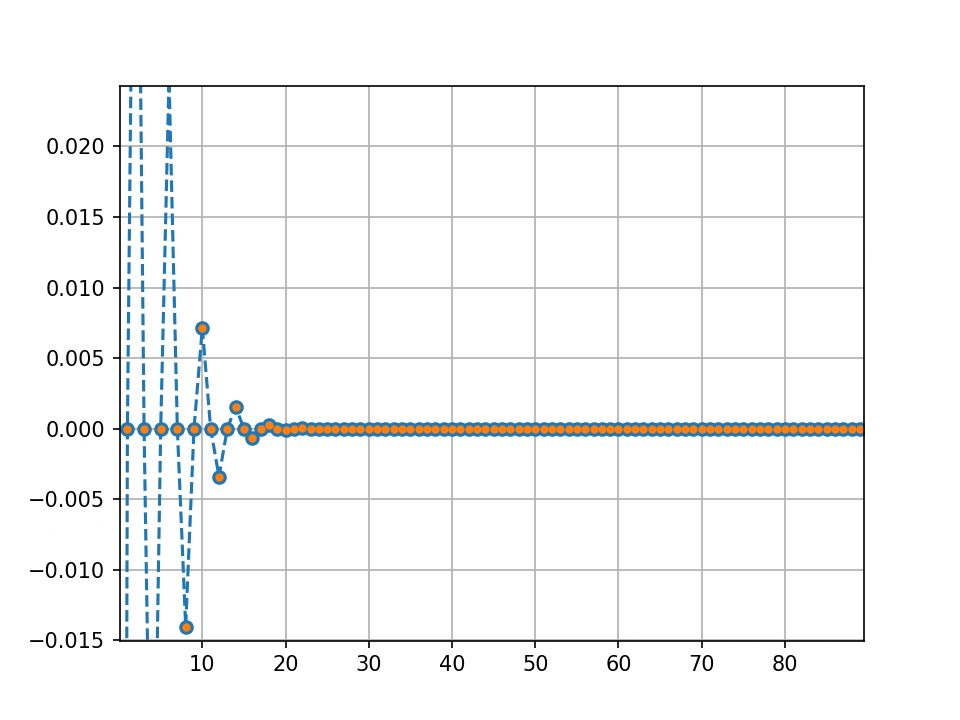

In [574]:
%matplotlib notebook
plt.figure()
plt.grid()
plt.plot(get_div_v_force_fur_by_velo(P_fur, Z_fur), 'o--')
plt.plot(get_div_v_force_fur(P_fur, Z_fur), '.')

## linear analys

In [634]:
%matplotlib inline
@interact(k=(0,N))
def plot_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1/50
    delta_P = get_int_field(delta_P_fur*(-1j))
    plt.figure()
    plt.plot(P,Z,'--')
    plt.plot(P+delta_P, Z)

interactive(children=(IntSlider(value=50, description='k'), Output()), _dom_classes=('widget-interact',))

In [635]:
%matplotlib inline
@interact(k=(0,N))
def plot_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1/50
    delta_Z = get_int_field(delta_Z_fur)
    plt.figure()
    plt.plot(P,Z,'--')
    plt.plot(P, Z+delta_Z)

interactive(children=(IntSlider(value=50, description='k'), Output()), _dom_classes=('widget-interact',))

In [636]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_force_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1/50
    H,force = get_H_force_from_ar(P_fur, Z_fur)
    H_,force_ = get_H_force_from_ar(P_fur+delta_P_fur, Z_fur)
    dH = H_-H; dforce = force_-force
    plt.figure()
    plt.plot(dH)
    plt.plot(dforce)

interactive(children=(IntSlider(value=49, description='k', max=99), Output()), _dom_classes=('widget-interact'…

In [1008]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_force_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1/50
    H,force = get_H_force_from_ar(P_fur, Z_fur)
    H_,force_ = get_H_force_from_ar(P_fur, Z_fur+delta_Z_fur)
    dH = H_-H; dforce = force_-force
    plt.figure()
    plt.plot(dH)
    plt.plot(dforce)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1026]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_force_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1/1000
    H,force = get_H_force_from_ar(P_fur, Z_fur)
    H_,force_ = get_H_force_from_ar(P_fur+delta_P_fur, Z_fur)
    dH = H_-H; dforce = force_-force
    plt.figure()
    plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.vlines(k,0,1e1, color='red')
    plt.xlim(0, 3*N)
    plt.yscale('log')
    plt.ylim(1e-8, 1e2)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1028]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_force_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-4
    H,force = get_H_force_from_ar(P_fur, Z_fur)
    H_,force_ = get_H_force_from_ar(P_fur, Z_fur+delta_Z_fur)
    dH = H_-H; dforce = force_-force
    plt.figure()
    plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.vlines(k,0,1e1, color='red')
    plt.xlim(0, 3*N)
    plt.yscale('log')
    plt.ylim(1e-8, 1e2)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1076]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-4
    
    v_P_fur, v_Z_fur = get_velo_h_fur_full(P_fur, Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_h_fur_full(P_fur+delta_P_fur, Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur), '.--')
    plt.plot(np.abs(dv_Z_fur), '.--')
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-6, 1e1)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1126]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-3
    
    v_P_fur, v_Z_fur = get_velo_h_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_h_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], 'o')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], 'o')
    
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-5
    
    v_P_fur, v_Z_fur = get_velo_h_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_h_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], '.')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], '.')
    
    
    plt.vlines(k,0,1e3, color='red')
    plt.vlines(N-1,0,1e3, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-2, 1e4)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1128]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_div_velo_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-4
    
    div_v_fur = get_div_v_force_fur(P_fur-delta_P_fur, Z_fur)
    div_v_fur_ = get_div_v_force_fur(P_fur+delta_P_fur, Z_fur)
    ddiv_v_fur = div_v_fur_ - div_v_fur;
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(ddiv_v_fur)/np.abs(ddiv_v_fur).max(), 'o')
    
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-5
    
    div_v_fur = get_div_v_force_fur(P_fur-delta_P_fur, Z_fur)
    div_v_fur_ = get_div_v_force_fur(P_fur+delta_P_fur, Z_fur)
    ddiv_v_fur = div_v_fur_ - div_v_fur;
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(ddiv_v_fur)/np.abs(ddiv_v_fur).max(), '.')
    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1+N_ext_sigma,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-6, 1e1)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1129]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_div_velo_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-4
    
    div_v_fur = get_div_v_force_fur(P_fur, Z_fur-delta_Z_fur)
    div_v_fur_ = get_div_v_force_fur(P_fur, Z_fur+delta_Z_fur)
    ddiv_v_fur = div_v_fur_ - div_v_fur;
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(ddiv_v_fur)/np.abs(ddiv_v_fur).max(), 'o')
    
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-5
    
    div_v_fur = get_div_v_force_fur(P_fur, Z_fur-delta_Z_fur)
    div_v_fur_ = get_div_v_force_fur(P_fur, Z_fur+delta_Z_fur)
    ddiv_v_fur = div_v_fur_ - div_v_fur;
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(ddiv_v_fur)/np.abs(ddiv_v_fur).max(), '.')
    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1+N_ext_sigma,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-6, 1e1)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1079]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_div_velo_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=2e-5
    
    div_v_fur = get_div_v_force_fur_by_velo(P_fur, Z_fur)
    div_v_fur_ = get_div_v_force_fur_by_velo(P_fur+delta_P_fur, Z_fur)
    ddiv_v_fur = div_v_fur_ - div_v_fur;
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(ddiv_v_fur), '.--')
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-6, 1e1)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1131]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_sigma_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-3
    
    sigma_fur = get_sigma_fur_from_arr(P_fur-delta_P_fur, Z_fur)
    sigma_fur_ = get_sigma_fur_from_arr(P_fur+delta_P_fur, Z_fur)
    dsigma_fur = sigma_fur_ - sigma_fur;
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dsigma_fur)/np.abs(dsigma_fur).max(), 'o')
    
    
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-5
    
    sigma_fur = get_sigma_fur_from_arr(P_fur-delta_P_fur, Z_fur)
    sigma_fur_ = get_sigma_fur_from_arr(P_fur+delta_P_fur, Z_fur)
    dsigma_fur = sigma_fur_ - sigma_fur;
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dsigma_fur)/np.abs(dsigma_fur).max(), '.')    
    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-5, 2e0)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1133]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_sigma_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-3
    
    sigma_fur = get_sigma_fur_from_arr(P_fur, Z_fur-delta_Z_fur)
    sigma_fur_ = get_sigma_fur_from_arr(P_fur, Z_fur+delta_Z_fur)
    dsigma_fur = sigma_fur_ - sigma_fur;
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dsigma_fur)/np.abs(dsigma_fur).max(), 'o')
    
    
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-5
    
    sigma_fur = get_sigma_fur_from_arr(P_fur, Z_fur-delta_Z_fur)
    sigma_fur_ = get_sigma_fur_from_arr(P_fur, Z_fur+delta_Z_fur)
    dsigma_fur = sigma_fur_ - sigma_fur;
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dsigma_fur)/np.abs(dsigma_fur).max(), '.')    
    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1+N_ext_sigma,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-5, 2e0)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1134]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-3
    
    v_P_fur, v_Z_fur = get_velo_fur_full(P_fur-delta_P_fur, Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_fur_full(P_fur+delta_P_fur, Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/np.abs(dv_P_fur).max(), 'o')
    plt.plot(np.abs(dv_Z_fur)/np.abs(dv_Z_fur).max(), 'o')
    
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-5
    
    v_P_fur, v_Z_fur = get_velo_fur_full(P_fur-delta_P_fur, Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_fur_full(P_fur+delta_P_fur, Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/np.abs(dv_P_fur).max(), '.')
    plt.plot(np.abs(dv_Z_fur)/np.abs(dv_Z_fur).max(), '.')    

    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-5, 2e0)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1137]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-3
    
    v_P_fur, v_Z_fur = get_velo_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], 'o')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], 'o')
    
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-5
    
    v_P_fur, v_Z_fur = get_velo_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], '.')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], '.')    

    
    plt.vlines(k,0,1e3, color='red')
    plt.vlines(N-1,0,1e3, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-3, 2e3)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1139]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_normal_delta_P(k):
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-3
    
    v_P_fur, v_Z_fur = get_velo_normal_fur_full(P_fur-delta_P_fur, Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_normal_fur_full(P_fur+delta_P_fur, Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/np.abs(dv_P_fur).max(), 'o')
    plt.plot(np.abs(dv_Z_fur)/np.abs(dv_Z_fur).max(), 'o')
    
    delta_P_fur = np.zeros(N)
    delta_P_fur[k]=1e-5
    
    v_P_fur, v_Z_fur = get_velo_normal_fur_full(P_fur-delta_P_fur, Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_normal_fur_full(P_fur+delta_P_fur, Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/np.abs(dv_P_fur).max(), '.')
    plt.plot(np.abs(dv_Z_fur)/np.abs(dv_Z_fur).max(), '.')    

    
    plt.vlines(k,0,1e1, color='red')
    plt.vlines(N-1,0,1e1, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-5, 2e0)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [1140]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_velo_normal_delta_Z(k):
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-3
    
    v_P_fur, v_Z_fur = get_velo_normal_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_normal_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    plt.figure()
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], 'o')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], 'o')
    
    delta_Z_fur = np.zeros(N)
    delta_Z_fur[k]=1e-5
    
    v_P_fur, v_Z_fur = get_velo_normal_fur_full(P_fur, Z_fur-delta_Z_fur)
    v_P_fur_, v_Z_fur_ = get_velo_normal_fur_full(P_fur, Z_fur+delta_Z_fur)
    dv_P_fur = v_P_fur_ - v_P_fur; dv_Z_fur = v_Z_fur_ - v_Z_fur
    
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dH), norm='forward')),'.--')
    #plt.plot(np.abs(np.fft.rfft(get_ext_array(dforce), norm='forward')),'.--')
    plt.plot(np.abs(dv_P_fur)/delta_Z_fur[k], '.')
    plt.plot(np.abs(dv_Z_fur)/delta_Z_fur[k], '.')    

    
    plt.vlines(k,0,1e3, color='red')
    plt.vlines(N-1,0,1e3, color='black')
    plt.xlim(0, n_int)
    plt.yscale('log')
    plt.ylim(1e-3, 2e3)

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

In [36]:
def get_normal_delta_PZ(P_fur, Z_fur, normal_delta_fur):
    normal_delta = get_int_field(normal_delta_fur)
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)    
    V = np.sqrt(P1**2+Z1**2)  
    
    normal_delta_P = get_int_field(normal_delta_fur)*(-Z1/V)
    normal_delta_Z = get_int_field(normal_delta_fur)*(P1/V)
    
    return normal_delta_P,normal_delta_Z

def get_normal_delta_PZ_fur(P_fur, Z_fur, normal_delta_fur):
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur, Z_fur, normal_delta_fur)
    normal_delta_P_fur = np.real(np.fft.rfft(get_ext_array(normal_delta_P, 'p'), norm='forward')[:n_int]/(-1j))
    normal_delta_Z_fur = np.fft.rfft(get_ext_array(normal_delta_Z, 'z'), norm='forward')[:n_int].real
    return normal_delta_P_fur, normal_delta_Z_fur

In [37]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_delta_n(k):
    normal_delta_fur = np.zeros(N)
    normal_delta_fur[k] = 1/50
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur, Z_fur, normal_delta_fur)
    plt.figure()
    plt.plot(P,Z,'--')
    plt.plot(P+normal_delta_P, Z+normal_delta_Z)

interactive(children=(IntSlider(value=17, description='k', max=35), Output()), _dom_classes=('widget-interact'…

## example

<IPython.core.display.Javascript object>


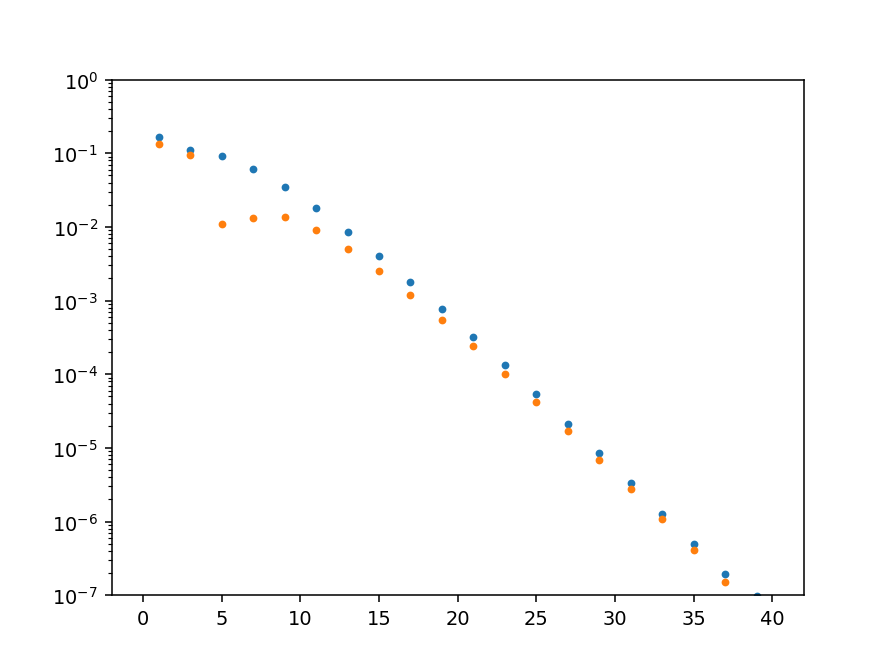

/tmp/ipykernel_5295/3809236376.py:25: RuntimeWarning: invalid value encountered in subtract
  K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\


(1e-07, 1.0)

In [29]:
plt.figure()
velo_h_rho, velo_h_z = get_velo_h(P_fur, Z_fur)
plt.plot(np.abs(np.fft.rfft(get_ext_array(velo_h_rho,'p'), norm='forward')),'.')
plt.plot(np.abs(np.fft.rfft(get_ext_array(velo_h_z,'z'), norm='forward')),'.')

plt.yscale('symlog', linthresh=1e-6)
plt.yscale('log')
plt.ylim(1e-7,1e0)

<IPython.core.display.Javascript object>


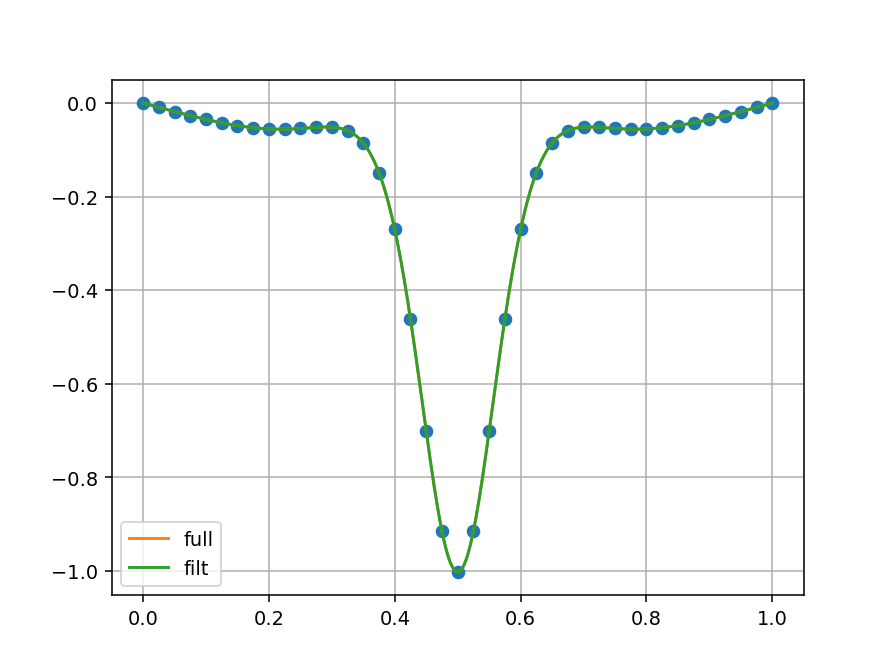

In [30]:
plt.figure()
plt.plot(tau_int, velo_h_rho,'o')

plt.plot(Tau_int, get_int_field(np.fft.rfft(get_ext_array(velo_h_rho, 'p'), norm='forward')[:n_int]), label='full')
plt.plot(Tau_int, get_int_field(np.fft.rfft(get_ext_array(velo_h_rho, 'p'), norm='forward')[:N]), label='filt')

#plt.plot(Tau_int, get_int_field(get_ext_array(velo_h_rho, 'p')), label='filt')

plt.grid()
plt.legend()
#plt.plot(velo_h_z,'o')


<IPython.core.display.Javascript object>


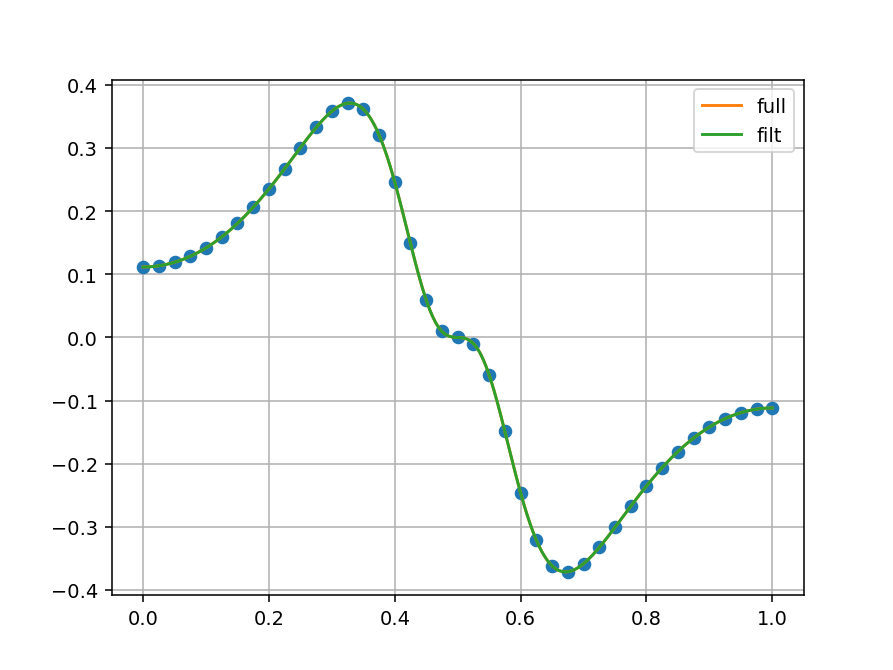

In [31]:
plt.figure()
plt.plot(tau_int, velo_h_z,'o')

plt.plot(Tau_int, get_int_field(np.fft.rfft(get_ext_array(velo_h_z, 'z'), norm='forward')[:n_int]), label='full')
plt.plot(Tau_int, get_int_field(np.fft.rfft(get_ext_array(velo_h_z, 'z'), norm='forward')[:N]), label='filt')

#plt.plot(Tau_int, get_int_field(get_ext_array(velo_h_rho, 'p')), label='filt')

plt.grid()
plt.legend()
#plt.plot(velo_h_z,'o')


<IPython.core.display.Javascript object>


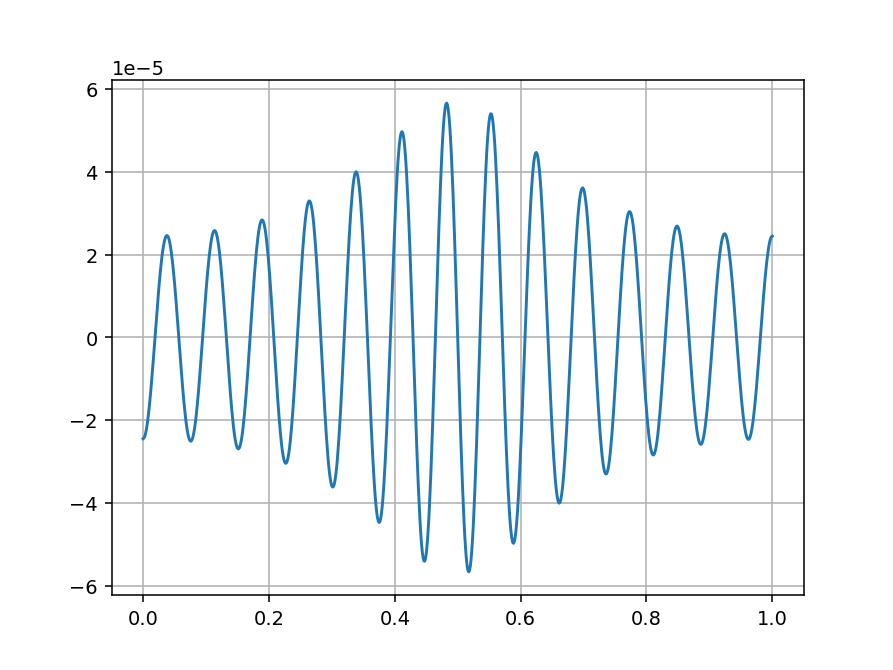

<IPython.core.display.Javascript object>


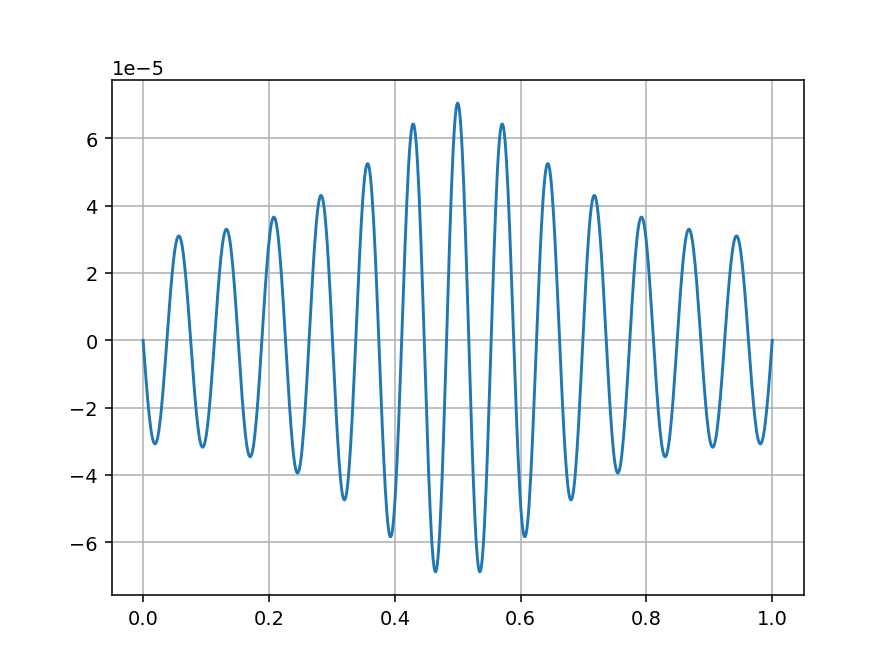

In [32]:
plt.figure()
plt.plot(Tau_int, 
        get_int_field(np.fft.rfft(get_ext_array(velo_h_z, 'z'), norm='forward')[:N])-\
        get_int_field(np.fft.rfft(get_ext_array(velo_h_z, 'z'), norm='forward')[:n_int])
        )

plt.grid()

plt.figure()
plt.plot(Tau_int, 
        get_int_field(np.fft.rfft(get_ext_array(velo_h_rho, 'p'), norm='forward')[:N])-\
        get_int_field(np.fft.rfft(get_ext_array(velo_h_rho, 'p'), norm='forward')[:n_int])
        )

plt.grid()

<IPython.core.display.Javascript object>


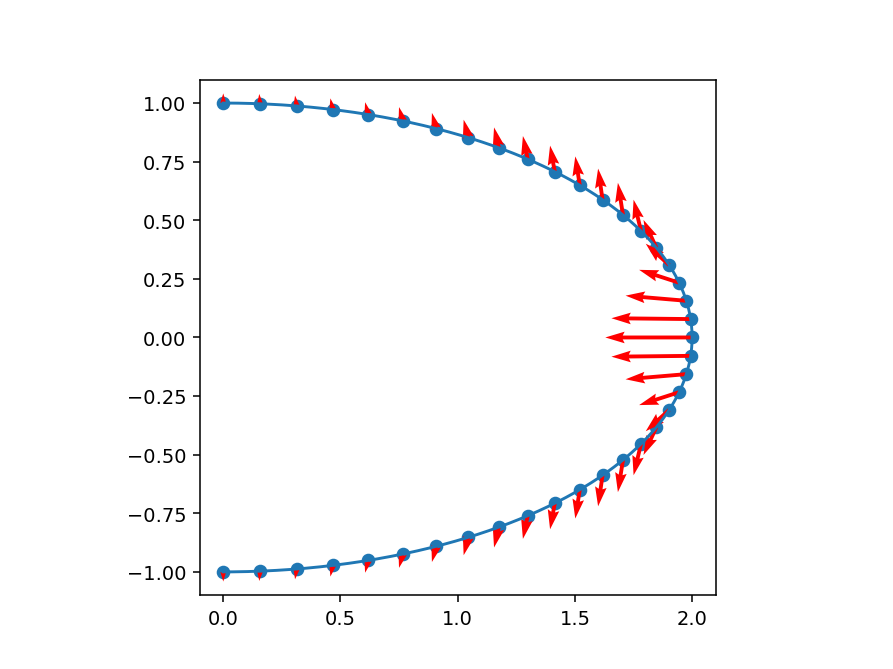

(-0.09999999999999999, 2.0999999999999996, -1.1, 1.1)

In [33]:
plt.figure()
Z_int = Z[::N_int//n_int]
P_int = P[::N_int//n_int]
    
plt.scatter(P_int, Z_int)
plt.plot(P, Z)
Qnow = plt.quiver(P_int, Z_int, velo_h_rho, velo_h_z, color='red')
plt.axis('scaled')

### Jacibian

In [93]:
def get_velo_h_fur_1d(pz):
    P_fur = np.zeros(N)
    P_fur[1:N]=pz[:N-1]
    Z_fur = pz[N-1:]
    veloP, veloZ = get_velo_fur(P_fur, Z_fur)
    return np.concatenate([veloP[1:N], veloZ])

In [94]:
import numdifftools as nd

In [95]:
jfun_h = nd.Jacobian(get_velo_h_fur_1d, step=5e-5)

jac_h = jfun_h(np.concatenate([P_fur[1:N],Z_fur]))

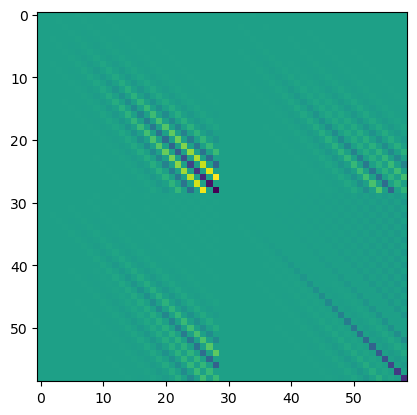

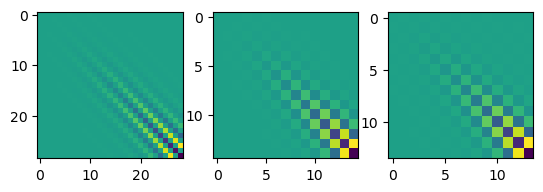

<Figure size 640x480 with 0 Axes>

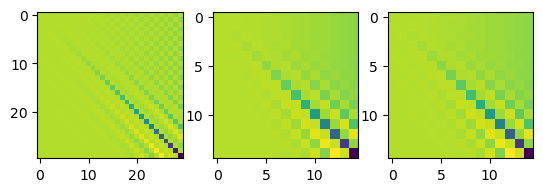

In [106]:
plt.figure()
plt.imshow(jac_h)

fig, axs = plt.subplots(1,3)

axs[0].imshow(jac_h[:N-1,:N-1])
axs[1].imshow(jac_h[:N-1:2,:N-1:2])
axs[2].imshow(jac_h[1:N-1:2,1:N-1:2])


plt.figure()

fig, axs = plt.subplots(1,3)

axs[0].imshow(jac_h[N-1:,N-1:])
axs[1].imshow(jac_h[N-1::2,N-1::2])
axs[2].imshow(jac_h[N::2,N::2])


In [107]:
w_full,vr_full =sc.linalg.eig(jac_h)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-4]
w_full_real = np.real(w_full_real)
np.sort(w_full_real)

array([-3.37115201e+03, -3.00567591e+03, -1.93465075e+03, -1.70992544e+03,
       -1.30564644e+03, -1.15125632e+03, -9.77507582e+02, -8.60879550e+02,
       -7.63220408e+02, -6.66613949e+02, -5.82963317e+02, -5.01731514e+02,
       -4.28879376e+02, -3.62758443e+02, -3.03810325e+02, -2.51569136e+02,
       -2.05658038e+02, -1.65692284e+02, -1.31225515e+02, -1.01908281e+02,
       -7.72396877e+01, -5.69489573e+01, -4.04194458e+01, -2.75489394e+01,
       -1.74816975e+01, -1.04514687e+01, -5.16084870e+00, -2.41078239e+00,
       -1.63707808e-01, -1.14997330e-01, -1.11189896e-01, -1.06870955e-01,
       -1.03429510e-01, -1.00446209e-01, -9.00773186e-02, -7.86008956e-02,
       -7.46405435e-02, -7.45361614e-02, -6.83650706e-02, -6.58347351e-02,
       -6.31650784e-02, -6.27768866e-02, -5.96727931e-02, -5.93780973e-02,
       -3.99005038e-02, -2.76739755e-02,  0.00000000e+00])

In [113]:
w_full[np.abs(np.imag(w_full))>1e-4]

array([-0.28625584+0.29425344j, -0.28625584-0.29425344j,
        0.23197408+0.27015078j,  0.23197408-0.27015078j,
       -0.19400544+0.12826692j, -0.19400544-0.12826692j,
       -0.2640882 +0.19257342j, -0.2640882 -0.19257342j,
        0.0028257 +0.0839935j ,  0.0028257 -0.0839935j ,
       -0.08505429+0.00425514j, -0.08505429-0.00425514j])

<IPython.core.display.Javascript object>


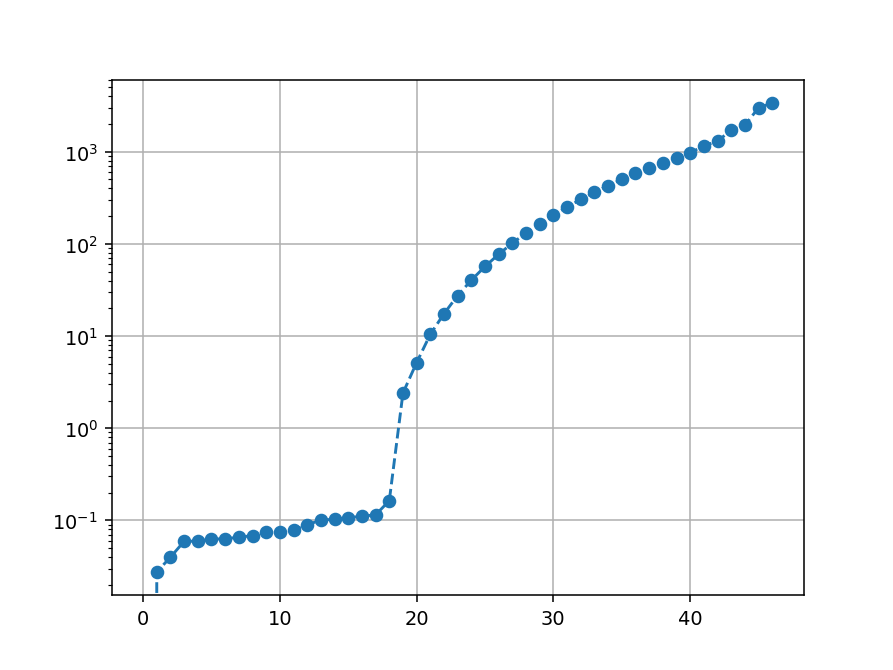

In [110]:
%matplotlib notebook
plt.figure()
plt.plot(-np.sort(w_full_real)[::-1],'o--')

plt.grid()
plt.axhline(0, color='k')
#plt.ylim(-1,10)
plt.yscale('log')

<IPython.core.display.Javascript object>


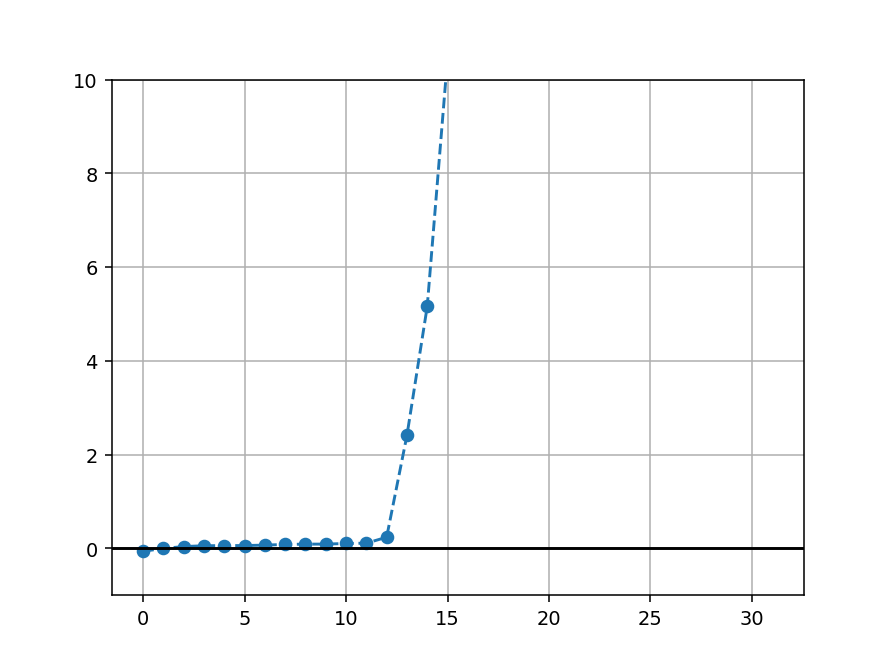

(-1.0, 10.0)

In [191]:
%matplotlib notebook
plt.figure()
plt.plot(-np.sort(w_full_real)[::-1],'o--')
plt.grid()
plt.axhline(0, color='k')
plt.ylim(-1,10)

In [111]:
%matplotlib inline
@interact_manual(m=(0,50))
def plot_eig_j(m):
    plt.figure()
    
    w_m = (np.sort(w_full_real)[::-1])[m]
    plt.title(f'w={w_m}')
    index_m = np.argmin(np.abs(w_full - w_m))
    print(w_full[index_m])
    v_m = np.real(vr_full[:, index_m])
    plt.plot(w_m*v_m,'.--')
    plt.plot(Div_v_sum_oper_fur[:N,:N] @ v_m,'o--')
    
#     v_tau = get_P_with0(v_m[:N-1])*P1_ar_j + v_m[N-1:]*Z1_ar_j
#     v_tau /= V_ar_j
    
#     v_n = -Z1_ar_j*get_P_with0(v_m[:N-1]) + P1_ar_j*v_m[N-1:]
#     v_n /= V_ar_j
#     plt.figure()
#     plt.plot(v_n, 'o--',label=r'$v_n$')
#     plt.plot(v_tau, 'o--',label=r'$v_\tau$')
#     plt.legend()

interactive(children=(IntSlider(value=25, description='m', max=50), Button(description='Run Interact', style=B…

### Jacobian with normal delta

In [612]:
P, P1,P2,P3,P4 = get_int_fields(get_ext_array(P_ar, 'p'))
P[0]=0; P[-1]=0; P2[0]=0;P2[-1]=0; P4[0]=0;P4[-1]=0;
Z, Z1,Z2,Z3,Z4 = get_int_fields(get_ext_array(Z_ar, 'z'))
Z1[0]=0; Z1[-1]=0; Z3[0]=0;Z3[-1]=0

V = np.sqrt(P1**2+Z1**2)

In [613]:
P1_ar = P1[::N_int//N]
Z1_ar = Z1[::N_int//N]
V_ar = V[::N_int//N]

In [614]:
P1_int = P1[::N_int//n_int]
Z1_int = Z1[::N_int//n_int]
V_int = V[::N_int//n_int]

$$
\mathbf{\tau }  =\frac{1}{v}  \begin{pmatrix}
P_{\tau } & Z_{\tau }
\end{pmatrix} , \mathbf{l}  = \frac{1}{v}\begin{pmatrix}
-Z_{\tau } & P_{\tau }
\end{pmatrix}
$$


In [615]:
def get_velo_h_normal(delta_n):
    delta_P_ar = delta_n*(-Z1_ar/V_ar)
    delta_Z_ar = delta_n*(P1_ar/V_ar)
    
    velo_h_rho, velo_h_z = get_velo_h(P_ar+delta_P_ar, Z_ar+delta_Z_ar)
    velo_h_rho_filt = get_N_field(get_ext_array(velo_h_rho,'p'))
    velo_h_z_filt = get_N_field(get_ext_array(velo_h_z,'z'))
    
    velo_norm = -Z1_ar/V_ar* velo_h_rho_filt + P1_ar/V_ar* velo_h_z_filt
    return velo_norm

In [616]:
def get_velo_h_normal_full(delta_n):
    delta_P_ar = delta_n*(-Z1_ar/V_ar)
    delta_Z_ar = delta_n*(P1_ar/V_ar)
    
    velo_h_rho, velo_h_z = get_velo_h(P_ar+delta_P_ar, Z_ar+delta_Z_ar)
    print(velo_h_rho.shape)
    velo_norm = -Z1_int/V_int* velo_h_rho + P1_int/V_int* velo_h_z
    return velo_norm

In [320]:
import numdifftools as nd

In [321]:
jfun_h_n = nd.Jacobian(get_velo_h_normal, step=1e-6)

jac_h_n = jfun_h_n(np.zeros(N+1))

<IPython.core.display.Javascript object>


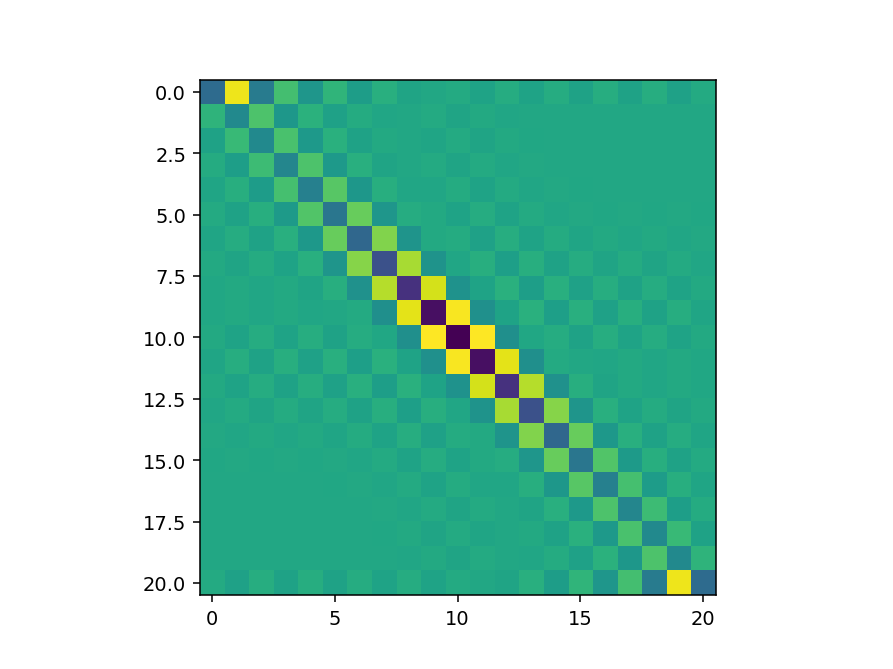

In [322]:
plt.figure()
plt.imshow(jac_h_n)

In [323]:
w_full,vr_full =sc.linalg.eig(jac_h_n)
print(w_full)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-4]
w_full_real = np.real(w_full_real)
np.sort(w_full_real)

[-8.51447629e+02+0.j -7.05710411e+02+0.j -4.47296301e+02+0.j
 -3.63871903e+02+0.j -2.94132740e+02+0.j -2.48759865e+02+0.j
 -2.02552234e+02+0.j -1.65968456e+02+0.j -1.31006856e+02+0.j
 -1.01947257e+02+0.j -7.72321010e+01+0.j -5.69751092e+01+0.j
 -4.03983274e+01+0.j -2.75858364e+01+0.j -1.74177647e+01+0.j
 -1.05044805e+01+0.j -5.02963064e+00+0.j -2.48166229e+00+0.j
  3.73598783e-01+0.j -1.19779298e-01+0.j -3.43624093e-01+0.j]


array([-8.51447629e+02, -7.05710411e+02, -4.47296301e+02, -3.63871903e+02,
       -2.94132740e+02, -2.48759865e+02, -2.02552234e+02, -1.65968456e+02,
       -1.31006856e+02, -1.01947257e+02, -7.72321010e+01, -5.69751092e+01,
       -4.03983274e+01, -2.75858364e+01, -1.74177647e+01, -1.05044805e+01,
       -5.02963064e+00, -2.48166229e+00, -3.43624093e-01, -1.19779298e-01,
        3.73598783e-01])

In [274]:
w_full,vr_full =sc.linalg.eig(jac_h_n)
print(w_full)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-4]
w_full_real = np.real(w_full_real)
np.sort(w_full_real)

[-8.51446040e+02+0.j -7.05709145e+02+0.j -4.47295506e+02+0.j
 -3.63871268e+02+0.j -2.94132249e+02+0.j -2.48759511e+02+0.j
 -2.02552000e+02+0.j -1.65968298e+02+0.j -1.31006754e+02+0.j
 -1.01947192e+02+0.j -7.72320629e+01+0.j -5.69750878e+01+0.j
 -4.03983165e+01+0.j -2.75858313e+01+0.j -1.74177625e+01+0.j
 -1.05044797e+01+0.j -5.02963046e+00+0.j -2.48166226e+00+0.j
  3.73598753e-01+0.j -1.19779315e-01+0.j -3.43624099e-01+0.j]


array([-8.51446040e+02, -7.05709145e+02, -4.47295506e+02, -3.63871268e+02,
       -2.94132249e+02, -2.48759511e+02, -2.02552000e+02, -1.65968298e+02,
       -1.31006754e+02, -1.01947192e+02, -7.72320629e+01, -5.69750878e+01,
       -4.03983165e+01, -2.75858313e+01, -1.74177625e+01, -1.05044797e+01,
       -5.02963046e+00, -2.48166226e+00, -3.43624099e-01, -1.19779315e-01,
        3.73598753e-01])

<IPython.core.display.Javascript object>


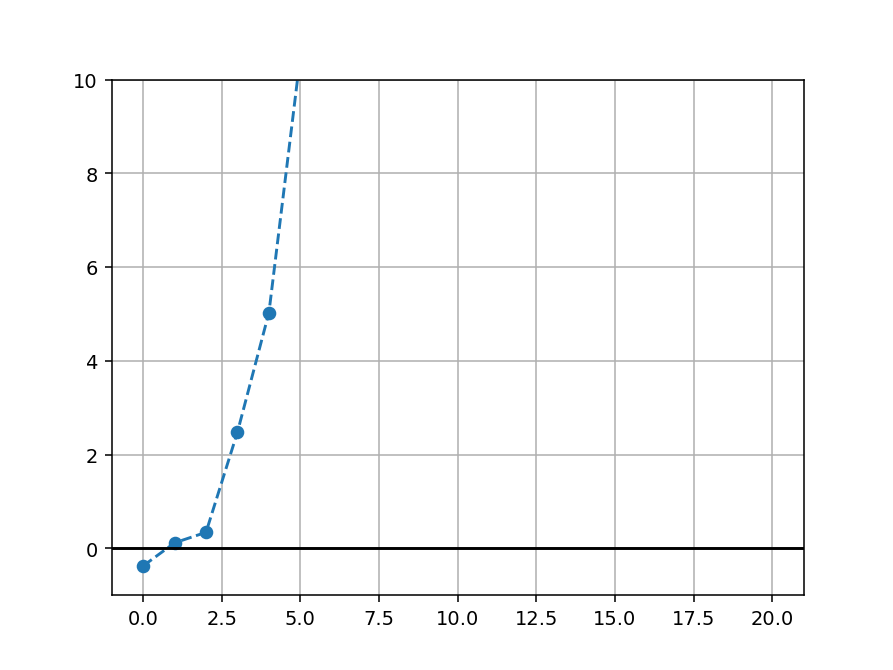

(-1.0, 10.0)

In [324]:
%matplotlib notebook
plt.figure()
plt.plot(-np.sort(w_full_real)[::-1],'o--')
# plt.plot(-np.sort(w_full_real_30_300)[::-1],'o--')

plt.grid()
plt.axhline(0, color='k')
plt.ylim(-1,10)

In [325]:
%matplotlib inline
@interact_manual(m=(0,50))
def plot_eig_j(m):
    plt.figure()
    
    w_m = (-np.sort(w_full_real)[::-1])[m]
    plt.title(f'w={w_m}')
    index_m = np.argmin(np.abs(w_full - w_m))
    v_m = np.real(vr_full[:, m])
    plt.plot(v_m,'.--')
    
#     v_tau = get_P_with0(v_m[:N-1])*P1_ar_j + v_m[N-1:]*Z1_ar_j
#     v_tau /= V_ar_j
    
#     v_n = -Z1_ar_j*get_P_with0(v_m[:N-1]) + P1_ar_j*v_m[N-1:]
#     v_n /= V_ar_j
#     plt.figure()
#     plt.plot(v_n, 'o--',label=r'$v_n$')
#     plt.plot(v_tau, 'o--',label=r'$v_\tau$')
#     plt.legend()
;

interactive(children=(IntSlider(value=25, description='m', max=50), Button(description='Run Interact', style=B…

''

<Figure size 640x480 with 0 Axes>

In [326]:
up_part = np.eye(N+1, dtype=int)
down_part = np.fliplr(np.eye(N+1, dtype=int))[1:-1]
extender_z = np.concatenate((up_part, down_part))
extender_p = np.concatenate((up_part, -down_part))

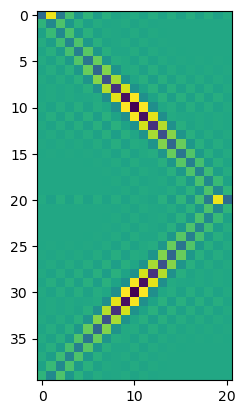

In [327]:
plt.figure()
plt.imshow(extender_z @ jac_h_n)

In [328]:
jac_h_n_fur = np.fft.rfft(extender_z @ jac_h_n, norm='forward', axis=0) @ np.fft.irfft(np.eye(N+1), axis=0, norm='forward', n=2*N)[:N+1,:]

In [274]:
w_full,vr_full =sc.linalg.eig(jac_h_n)
print(w_full)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-4]
w_full_real = np.real(w_full_real)
np.sort(w_full_real)

[-8.51446040e+02+0.j -7.05709145e+02+0.j -4.47295506e+02+0.j
 -3.63871268e+02+0.j -2.94132249e+02+0.j -2.48759511e+02+0.j
 -2.02552000e+02+0.j -1.65968298e+02+0.j -1.31006754e+02+0.j
 -1.01947192e+02+0.j -7.72320629e+01+0.j -5.69750878e+01+0.j
 -4.03983165e+01+0.j -2.75858313e+01+0.j -1.74177625e+01+0.j
 -1.05044797e+01+0.j -5.02963046e+00+0.j -2.48166226e+00+0.j
  3.73598753e-01+0.j -1.19779315e-01+0.j -3.43624099e-01+0.j]


array([-8.51446040e+02, -7.05709145e+02, -4.47295506e+02, -3.63871268e+02,
       -2.94132249e+02, -2.48759511e+02, -2.02552000e+02, -1.65968298e+02,
       -1.31006754e+02, -1.01947192e+02, -7.72320629e+01, -5.69750878e+01,
       -4.03983165e+01, -2.75858313e+01, -1.74177625e+01, -1.05044797e+01,
       -5.02963046e+00, -2.48166226e+00, -3.43624099e-01, -1.19779315e-01,
        3.73598753e-01])

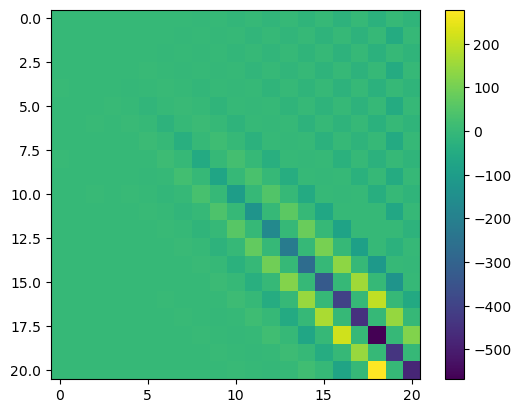

In [329]:
plt.figure()
plt.imshow(jac_h_n_fur.real)
plt.colorbar()

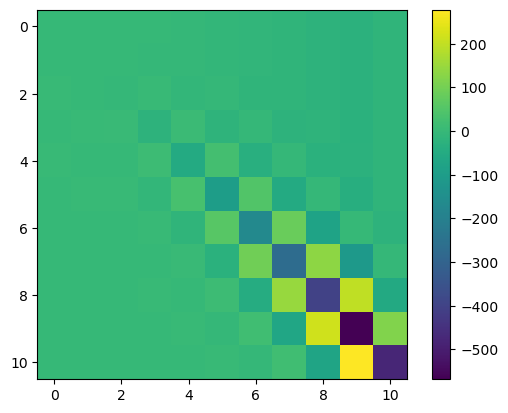

In [330]:
plt.figure()
plt.imshow(jac_h_n_fur.real[::2,::2])
plt.colorbar()

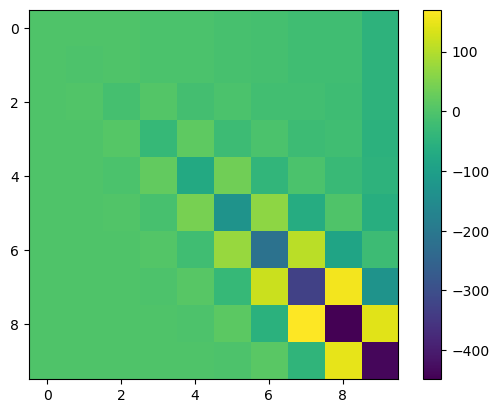

In [345]:
plt.figure()
plt.imshow(jac_h_n_fur.real[1::2,1::2])
plt.colorbar()

In [344]:
w_k,_ =sc.linalg.eig(jac_h_n_fur.real[::2,::2])
w_k.real

array([-8.51447629e+02, -4.47296301e+02, -2.94132740e+02, -2.02552234e+02,
       -1.31006856e+02, -7.72321010e+01, -4.03983274e+01, -1.74177647e+01,
       -5.02963064e+00,  3.73598783e-01, -1.19779298e-01])

In [348]:
w_k,_ =sc.linalg.eig(jac_h_n_fur.real[::2,::2][-9:,-9:])
w_k.real

array([-851.44775447, -447.29823135, -294.12293513, -202.57275211,
         -5.19990204,  -17.38641303,  -40.41135192, -130.98452756,
        -77.25395072])

In [347]:
w_k,_ =sc.linalg.eig(jac_h_n_fur.real[1::2,1::2][-5:,-5:])
w_k.real

array([-705.40751674, -359.42724298,  -97.8704218 , -150.14737134,
       -250.67786312])

In [436]:
np.fft.rfft(get_ext_array(Z_ar))

array([-1.11022302e-16+0.00000000e+00j,  2.00000000e+01-6.66133815e-16j,
        6.90533041e-16+2.19833563e-16j, -3.31983947e-16+4.92920449e-16j,
        1.61792770e-16-1.30428371e-15j,  1.70478510e-16-2.35513869e-16j,
        5.07635351e-16-1.09237794e-15j, -1.01774247e-16-9.00727448e-17j,
       -1.30496709e-16+6.64274160e-17j,  1.38941716e-16-1.09928807e-15j,
       -2.22044605e-16+1.11022302e-16j, -1.38941716e-16-6.55198865e-16j,
        4.55725532e-16+3.07599860e-16j, -2.79294459e-16+8.36633742e-17j,
       -6.35461407e-17+6.83978903e-16j, -6.14567720e-16-2.35513869e-16j,
       -6.05881980e-16+4.72073130e-16j,  9.18899322e-16+3.31256631e-17j,
       -1.22160853e-15-1.72524898e-16j, -1.77635684e-15-2.22044605e-16j,
       -3.33066907e-16+0.00000000e+00j])

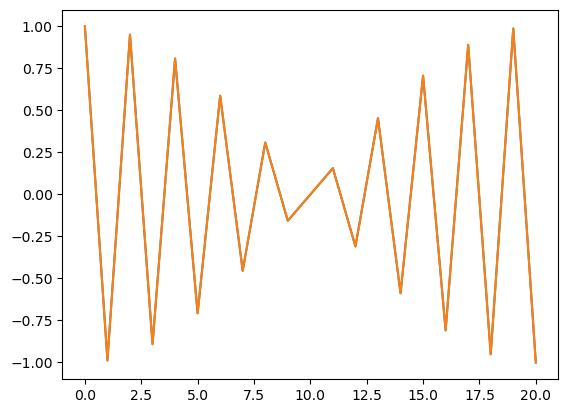

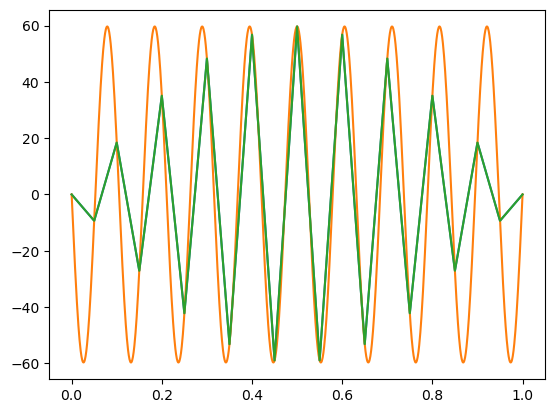

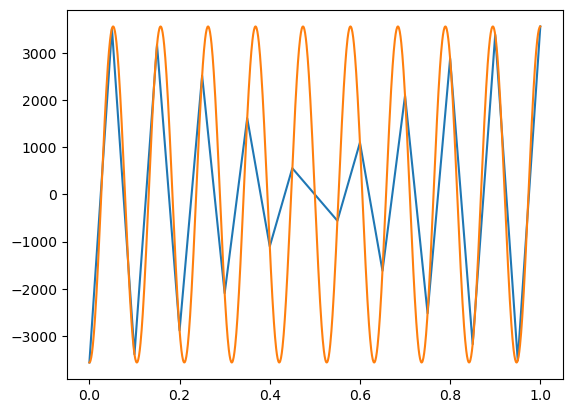

In [465]:
k=19
test_f = np.cos(np.pi*tau_N*k)
plt.plot(test_f)
plt.plot(np.fft.irfft(np.fft.rfft(get_ext_array(test_f), norm='forward'), norm='forward')[:N+1])

plt.figure()

der_oper = 1j*np.pi*np.arange(N+1)

plt.plot(tau_N, -np.sin(np.pi*tau_N*k)*(np.pi*k))
plt.plot(Tau_int,-np.sin(np.pi*Tau_int*k)*(np.pi*k))

plt.plot(tau_N, np.fft.irfft(der_oper*np.fft.rfft(get_ext_array(test_f), norm='forward'), norm='forward')[:N+1])

plt.figure()
plt.plot(tau_N, np.fft.irfft(der_oper**2*np.fft.rfft(get_ext_array(test_f), norm='forward'), norm='forward')[:N+1])
plt.plot(Tau_int,-np.cos(np.pi*Tau_int*k)*(np.pi*k)**2)


<IPython.core.display.Javascript object>


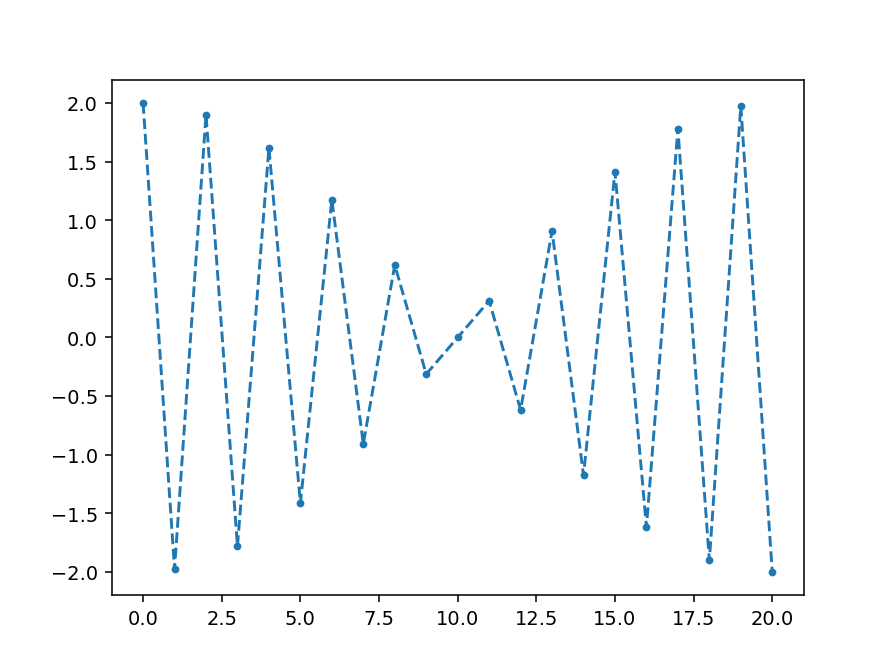

In [627]:
k=19
delta_k = np.zeros(N+1)
delta_k[k]=1.
delta_n_k = np.fft.irfft(delta_k, n=2*N, norm='forward')[0:N+1]
plt.figure()
plt.plot(delta_n_k,'.--')

<IPython.core.display.Javascript object>


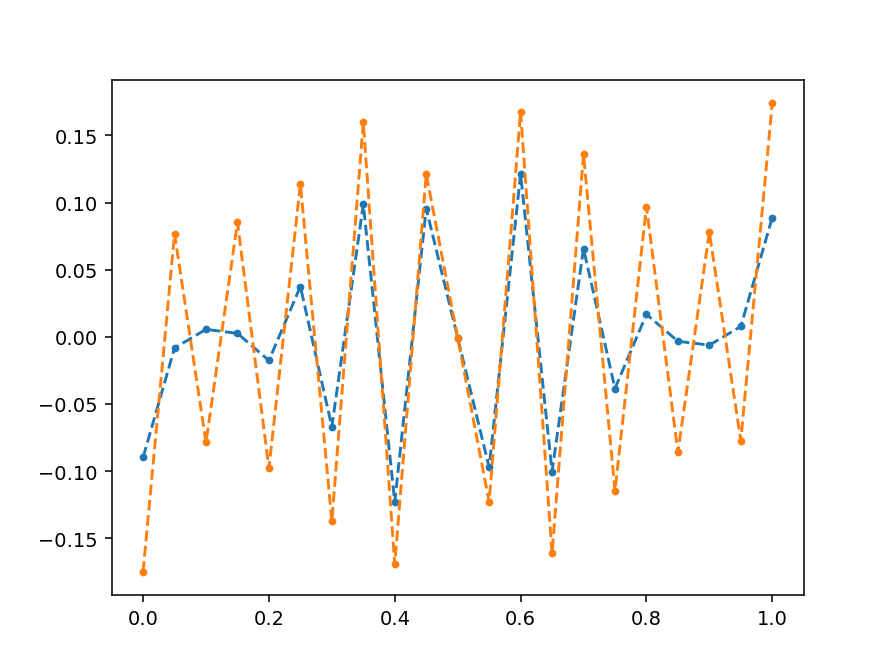

(21,)
(21,)


/tmp/ipykernel_89112/1385853270.py:28: RuntimeWarning: invalid value encountered in multiply
  -Z1.reshape(1,-1)*G_rhorho_tilde_mesh
/tmp/ipykernel_89112/1385853270.py:27: RuntimeWarning: invalid value encountered in subtract
  K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\


<IPython.core.display.Javascript object>


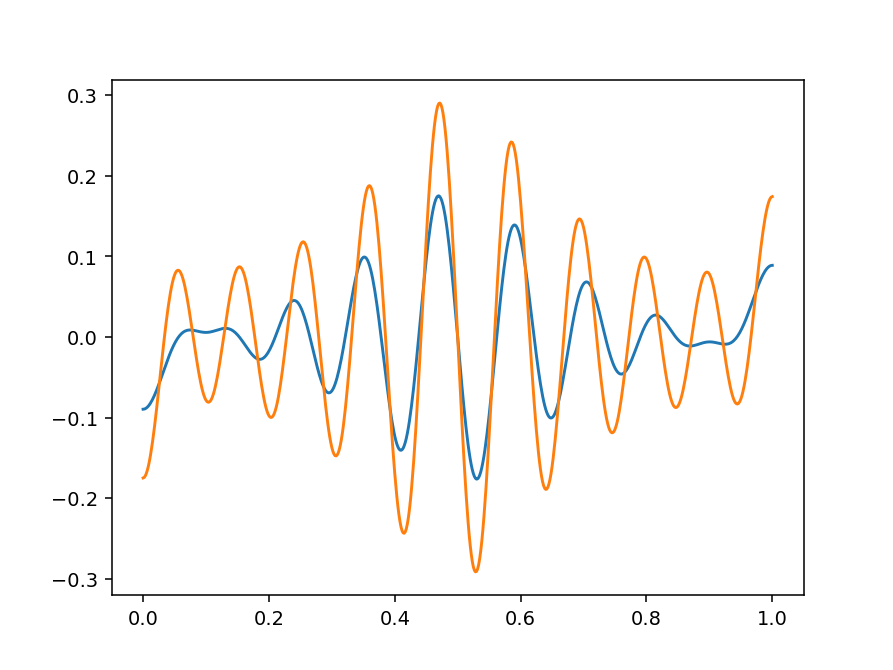

In [628]:
plt.figure()
delta_velo = get_velo_h_normal(delta_n_k*1e-4)-get_velo_h_normal(delta_n_k*0)
#delta_velo = get_N_field(get_ext_array(delta_velo))
plt.plot(tau_N, delta_velo,'.--')

delta_velo_full = get_velo_h_normal_full(delta_n_k*1e-4)-get_velo_h_normal_full(delta_n_k*0)
plt.plot(tau_int, delta_velo_full,'.--')

plt.figure()
delta_velo_cont = np.fft.irfft(np.fft.rfft(get_ext_array(delta_velo), norm='forward'),n=2*N_int, norm='forward')[:N_int+1]

plt.plot(Tau_int, delta_velo_cont)


delta_velo_cont = np.fft.irfft(np.fft.rfft(get_ext_array(delta_velo_full), norm='forward')[:N_int],n=2*N_int, norm='forward')[:N_int+1]

plt.plot(Tau_int, delta_velo_cont)

<IPython.core.display.Javascript object>


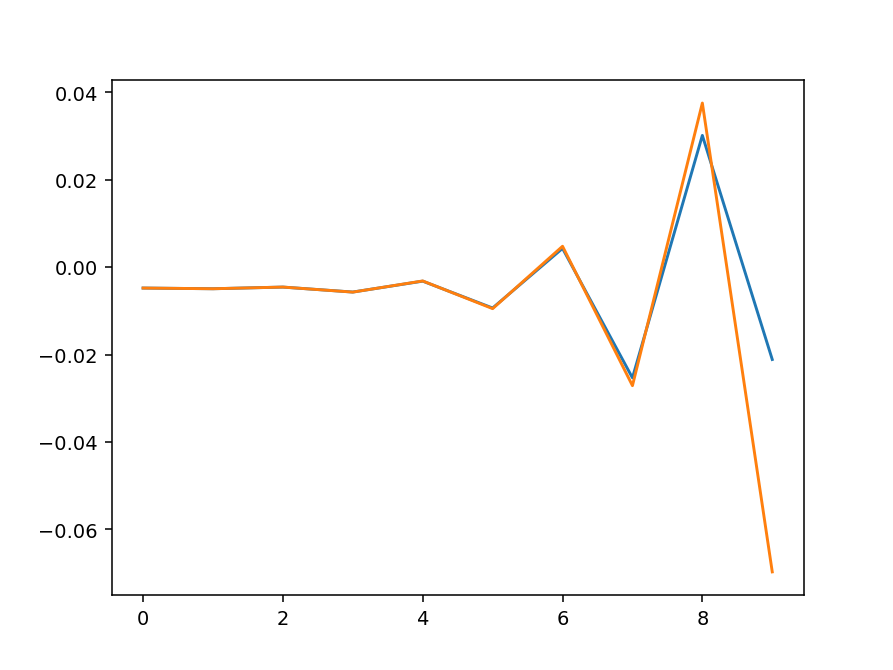

In [629]:
plt.figure()
plt.plot(np.fft.rfft(get_ext_array(delta_velo), norm='forward')[1::2])
plt.plot(np.fft.rfft(get_ext_array(delta_velo_full), norm='forward')[1::2])

## Helfrick dynamics

In [135]:
sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_h_fur_1d(pz), (0., 10), np.concatenate([P_fur[1:N], Z_fur]), 
                                   method='BDF', atol=1e-8, rtol=1e-5);

/tmp/ipykernel_141999/3809236376.py:25: RuntimeWarning: invalid value encountered in subtract
  K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\
/tmp/ipykernel_141999/3809236376.py:26: RuntimeWarning: invalid value encountered in multiply
  -Z1.reshape(1,-1)*G_rhorho_tilde_mesh


In [116]:
R_Vol0 = (3*Vol0/4/np.pi)**(1/3)
R_Vol0

1.5874010519619075

In [118]:
theta = np.linspace(0,np.pi,500)
P_Vol0 = R_Vol0*np.sin(theta)
Z_Vol0 = R_Vol0*np.cos(theta)

Text(0.5, 1.0, 'form')

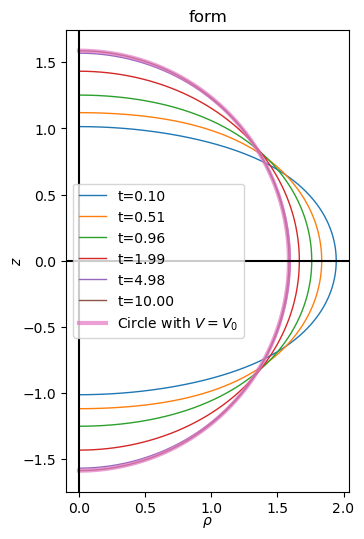

In [119]:
plt.figure(figsize=(6,6))
for t_j in [0.1,0.5, 1,2,5,10]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_bdf.t-t_j))
    
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_bdf.y[:N-1,j]
    Z_fur_j =sol_bdf.y[N-1:,j] 
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1, label=f't={sol_bdf.t[j]:.2f}')


plt.plot(P_Vol0,Z_Vol0, lw=3, label=r'Circle with $V=V_0$', alpha=0.7)    
    
    
plt.axis('scaled')
plt.legend()
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

<IPython.core.display.Javascript object>


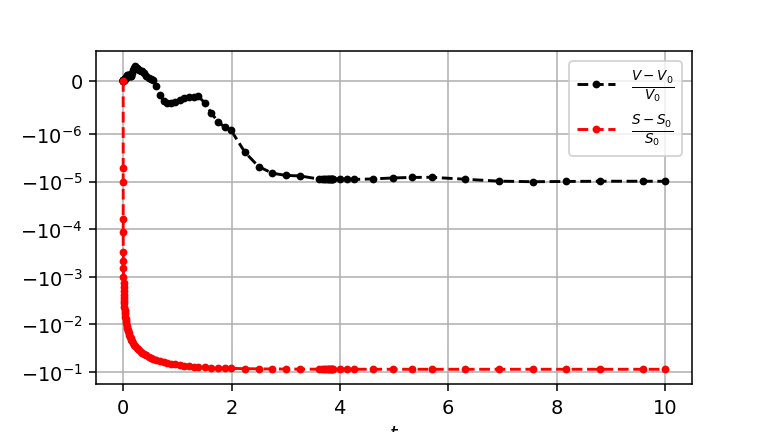

In [120]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur, Z_fur)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_bdf.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_bdf.y[:N-1,j]
    Z_fur_j =sol_bdf.y[N-1:,j] 
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_bdf.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_bdf.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-6)

<IPython.core.display.Javascript object>


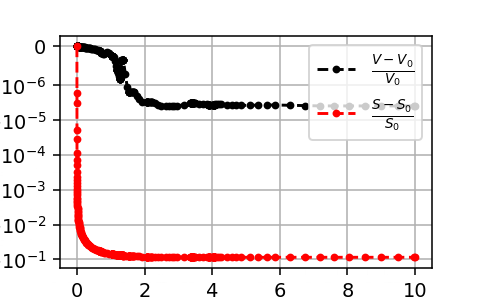

In [136]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur, Z_fur)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_bdf.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_bdf.y[:N-1,j]
    Z_fur_j =sol_bdf.y[N-1:,j] 
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_bdf.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_bdf.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-6)

<IPython.core.display.Javascript object>


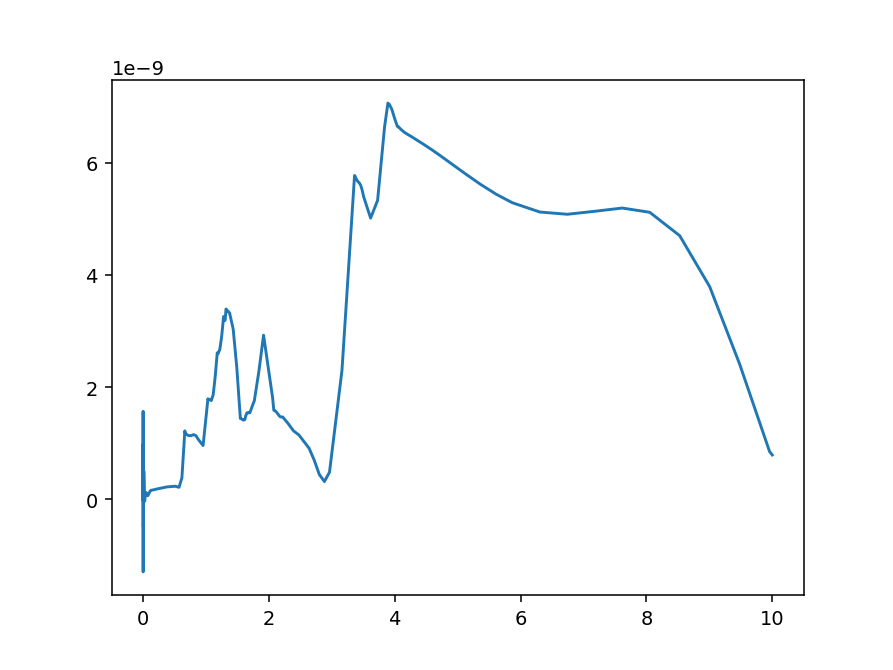

In [154]:
plt.figure()
j=26
plt.plot(sol_bdf.t, sol_bdf.y[j,:])

In [121]:
%matplotlib inline
@interact_manual(j=(0,len(sol_bdf.t)-1))
def plot_fields_j(j):
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_bdf.y[:N-1,j]
    Z_fur_j =sol_bdf.y[N-1:,j] 
    plt.figure()
    plt.title(f't={sol_bdf.t[j]:.3f}')
    plt.plot(np.abs(Z_fur_j),'.--',ms=15, label=r'$Z_k$')
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_force_from_ar(P_fur_j, Z_fur_j)), norm='forward')),'.--',ms=15, label=r'$f_k$')
    
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_velo_h(P_fur_j, Z_fur_j)[1]), norm='forward')),'.--',ms=15, label=r'$v^z_k$')
    
    
    plt.xlim(0,N*2)
    plt.ylim(1e-10, 1e2)
    
    plt.legend()
    plt.yscale('log')

interactive(children=(IntSlider(value=46, description='j', max=93), Button(description='Run Interact', style=B…

### RK dinamic

In [155]:
sol_rk = sc.integrate.solve_ivp(lambda t,pz: get_velo_h_fur_1d(pz), (0., 2), np.concatenate([P_fur[1:N], Z_fur]), 
                                   method='RK45');

/tmp/ipykernel_141999/3809236376.py:25: RuntimeWarning: invalid value encountered in subtract
  K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\
/tmp/ipykernel_141999/3809236376.py:26: RuntimeWarning: invalid value encountered in multiply
  -Z1.reshape(1,-1)*G_rhorho_tilde_mesh


In [116]:
R_Vol0 = (3*Vol0/4/np.pi)**(1/3)
R_Vol0

1.5874010519619075

In [118]:
theta = np.linspace(0,np.pi,500)
P_Vol0 = R_Vol0*np.sin(theta)
Z_Vol0 = R_Vol0*np.cos(theta)

<IPython.core.display.Javascript object>


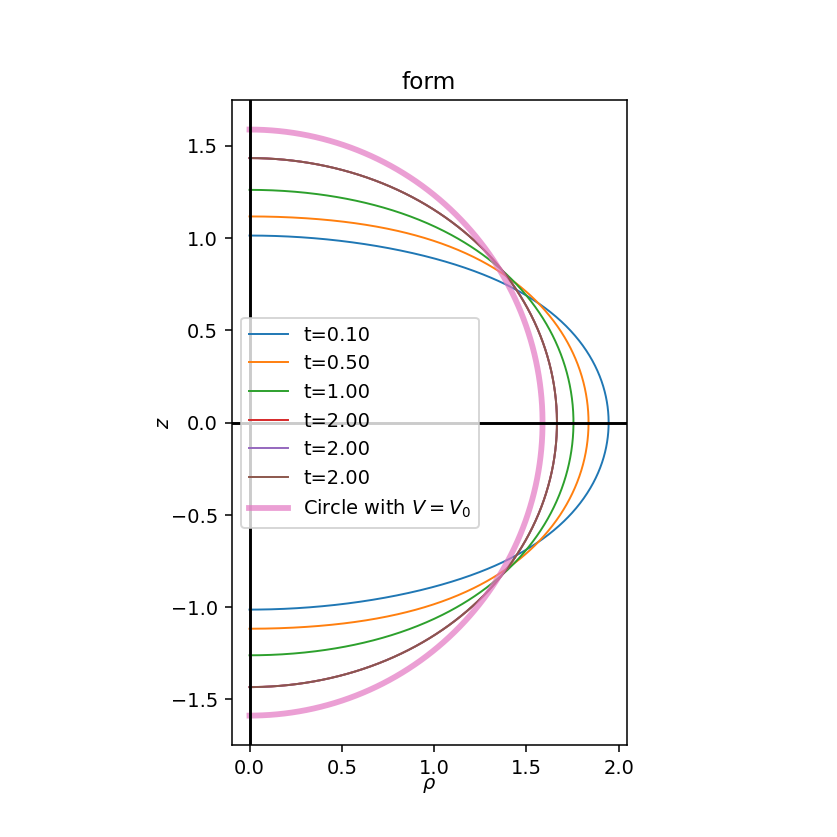

Text(0.5, 1.0, 'form')

In [156]:
plt.figure(figsize=(6,6))
for t_j in [0.1,0.5, 1,2,5,10]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_rk.t-t_j))
    
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_rk.y[:N-1,j]
    Z_fur_j =sol_rk.y[N-1:,j] 
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1, label=f't={sol_rk.t[j]:.2f}')


plt.plot(P_Vol0,Z_Vol0, lw=3, label=r'Circle with $V=V_0$', alpha=0.7)    
    
    
plt.axis('scaled')
plt.legend()
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

<IPython.core.display.Javascript object>


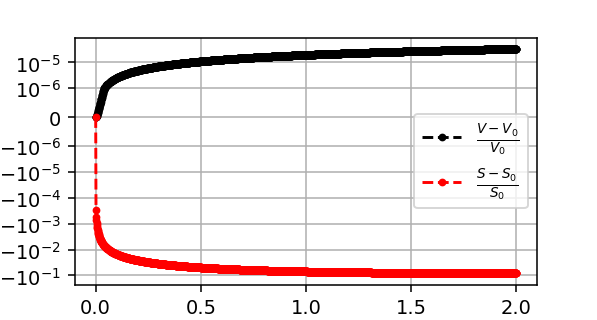

In [157]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur, Z_fur)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_rk.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_rk.y[:N-1,j]
    Z_fur_j =sol_rk.y[N-1:,j] 
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_rk.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_rk.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-6)

<IPython.core.display.Javascript object>


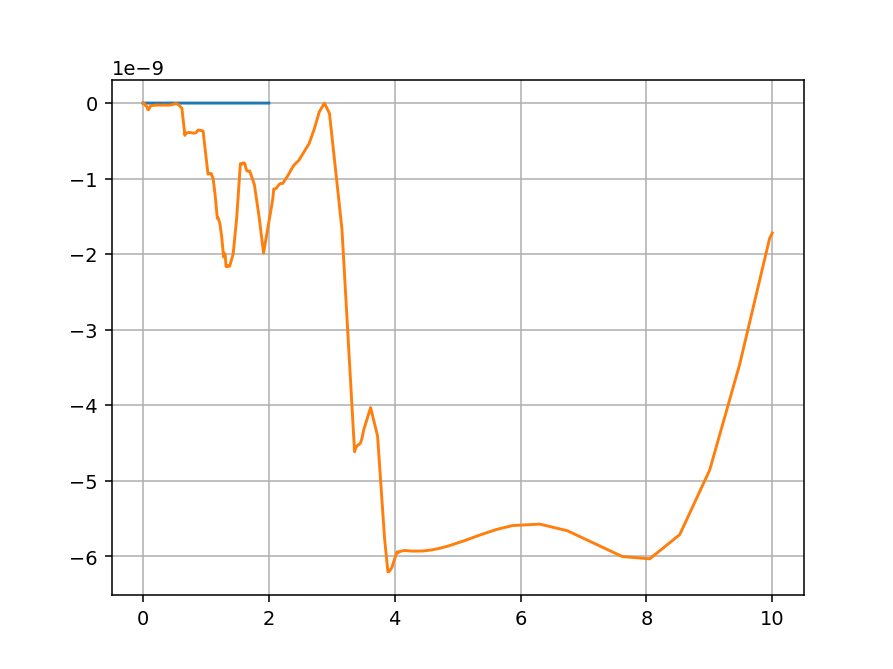

In [179]:
plt.figure()
j=23
plt.plot(sol_rk.t, sol_rk.y[j,:])
plt.plot(sol_bdf.t, sol_bdf.y[j,:])
plt.grid()

### Radau

In [189]:
sol_rad = sc.integrate.solve_ivp(lambda t,pz: get_velo_h_fur_1d(pz), (0., 2), np.concatenate([P_fur[1:N], Z_fur]), 
                                   method='Radau', atol=1e-7, rtol=1e-4);

/tmp/ipykernel_141999/3809236376.py:25: RuntimeWarning: invalid value encountered in subtract
  K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\
/tmp/ipykernel_141999/3809236376.py:26: RuntimeWarning: invalid value encountered in multiply
  -Z1.reshape(1,-1)*G_rhorho_tilde_mesh


In [116]:
R_Vol0 = (3*Vol0/4/np.pi)**(1/3)
R_Vol0

1.5874010519619075

In [118]:
theta = np.linspace(0,np.pi,500)
P_Vol0 = R_Vol0*np.sin(theta)
Z_Vol0 = R_Vol0*np.cos(theta)

<IPython.core.display.Javascript object>


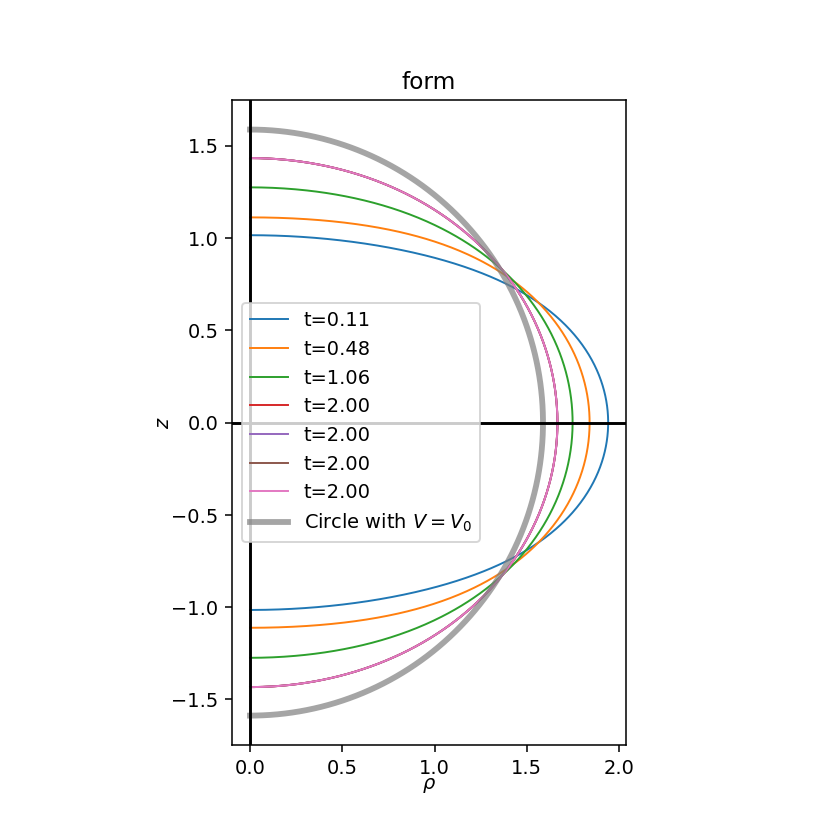

Text(0.5, 1.0, 'form')

In [190]:
plt.figure(figsize=(6,6))
for t_j in [0.1,0.5, 1,2,4,8,10]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_rad.t-t_j))
    
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_rad.y[:N-1,j]
    Z_fur_j =sol_rad.y[N-1:,j] 
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1, label=f't={sol_rad.t[j]:.2f}')


plt.plot(P_Vol0,Z_Vol0, lw=3, label=r'Circle with $V=V_0$', alpha=0.7)    
    
    
plt.axis('scaled')
plt.legend()
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

<IPython.core.display.Javascript object>


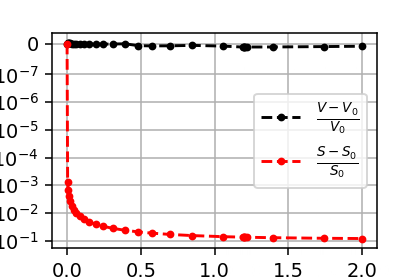

In [192]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur, Z_fur)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_rad.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_rad.y[:N-1,j]
    Z_fur_j =sol_rad.y[N-1:,j] 
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_rad.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_rad.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-7)

<IPython.core.display.Javascript object>


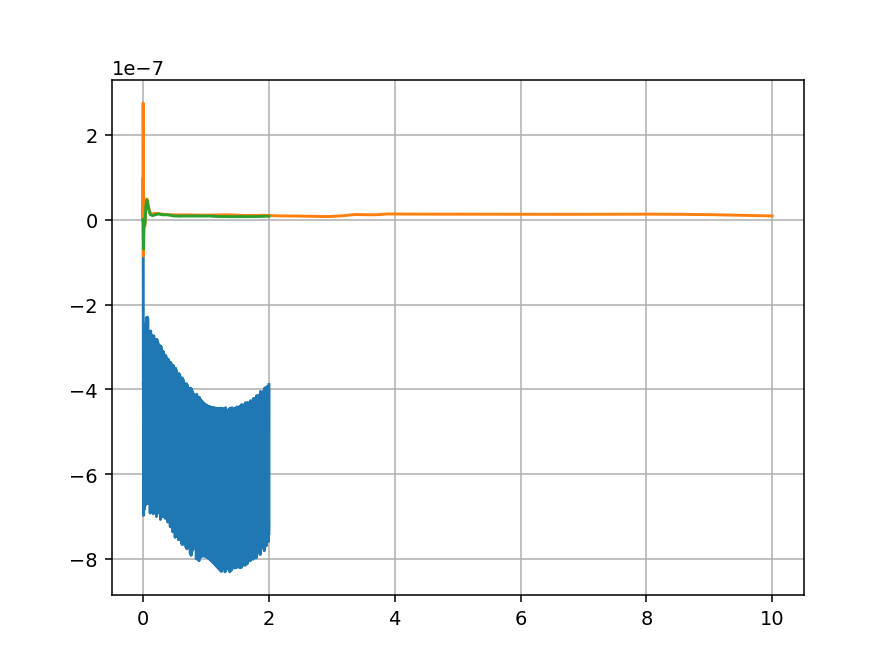

In [210]:
plt.figure()
j=18
plt.plot(sol_rk.t, sol_rk.y[j,:])
plt.plot(sol_bdf.t, sol_bdf.y[j,:])
plt.plot(sol_rad.t, sol_rad.y[j,:])

plt.grid()

## Helfrick normal dynamics

$$
\mathbf{\tau }  =\frac{1}{v}  \begin{pmatrix}
P_{\tau } & Z_{\tau }
\end{pmatrix} , \mathbf{l}  = \frac{1}{v}\begin{pmatrix}
-Z_{\tau } & P_{\tau }
\end{pmatrix}
$$


In [412]:
def get_velo_h_normal_1d(pz):
    P_ar = np.zeros(N+1)
    P_ar[1:N]=pz[:N-1]
    Z_ar = pz[N-1:]
    velo_h_rho, velo_h_z = get_velo_h(P_ar, Z_ar)
    velo_h_rho_filt = get_N_field(get_ext_array(velo_h_rho,'p'))
    velo_h_z_filt = get_N_field(get_ext_array(velo_h_z,'z'))
    
    P, P1,P2,P3,P4 = get_int_fields(get_ext_array(P_ar, 'p'))
    P[0]=0; P[-1]=0; P2[0]=0;P2[-1]=0; P4[0]=0;P4[-1]=0;
    Z, Z1,Z2,Z3,Z4 = get_int_fields(get_ext_array(Z_ar, 'z'))
    Z1[0]=0; Z1[-1]=0; Z3[0]=0;Z3[-1]=0
    
    Z1_ar = Z1[::N_int//N];P1_ar = P1[::N_int//N]
    V_ar = np.sqrt(Z1_ar**2+P1_ar**2)
    velo_norm = -Z1_ar/V_ar* velo_h_rho_filt + P1_ar/V_ar* velo_h_z_filt

    return np.concatenate([(velo_norm*(-Z1_ar/V_ar))[1:N], velo_norm*(P1_ar/V_ar)])

In [413]:
sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_h_normal_1d(pz), (0., 100), np.concatenate([P_ar[1:-1], Z_ar]), 
                                   method='BDF', atol=1e-8, rtol=1e-5);

/tmp/ipykernel_89112/1385853270.py:27: RuntimeWarning: invalid value encountered in subtract
  K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\
/tmp/ipykernel_89112/1385853270.py:28: RuntimeWarning: invalid value encountered in multiply
  -Z1.reshape(1,-1)*G_rhorho_tilde_mesh


In [395]:
R_Vol0 = (3*Vol0/4/np.pi)**(1/3)
R_Vol0

theta = np.linspace(0,np.pi,500)
P_Vol0 = R_Vol0*np.sin(theta)
Z_Vol0 = R_Vol0*np.cos(theta)

Text(0.5, 1.0, 'form')

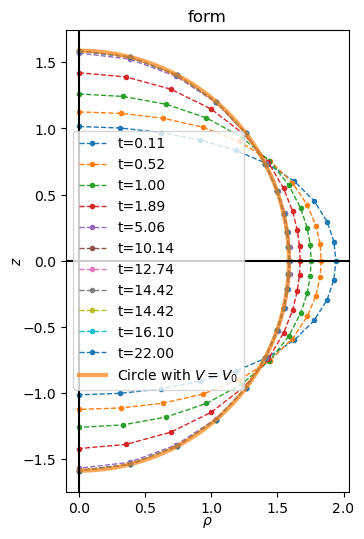

In [396]:
plt.figure(figsize=(6,6))
for t_j in [0.1,0.5, 1,2,5,10,13,15,15,17,20]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_bdf.t-t_j))
    plt.plot(np.concatenate([[0.],sol_bdf.y[:N-1,j],[0.]]), sol_bdf.y[N-1:,j],'.--',
             lw=1, ms=6, label=f't={sol_bdf.t[j]:.2f}')


plt.plot(P_Vol0,Z_Vol0, lw=3, label=r'Circle with $V=V_0$', alpha=0.7)    
    
    
plt.axis('scaled')
plt.legend()
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

In [397]:
def get_P_with0(P_red):
    return np.concatenate([[0], P_red, [0]])

<IPython.core.display.Javascript object>


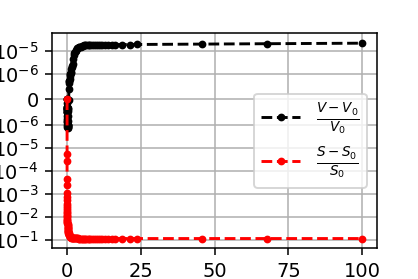

In [414]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_ar, Z_ar)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_bdf.t)):
    Vol,Sqr,_ = get_VolSqr(get_P_with0(sol_bdf.y[:N-1,j]), sol_bdf.y[N-1:,j])
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_bdf.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_bdf.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-6)

In [415]:
%matplotlib inline
@interact_manual(j=(0,len(sol_bdf.t)-1))
def plot_fields_j(j):
    P_j, Z_j = get_P_with0(sol_bdf.y[:N-1,j]), sol_bdf.y[N-1:,j]
    plt.figure()
    plt.title(f't={sol_bdf.t[j]:.3f}')
    plt.plot(np.abs(np.fft.rfft(get_ext_array(Z_j), norm='forward')),'.--',ms=15, label=r'$Z_k$')
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_force_from_ar(P_j, Z_j)), norm='forward')),'.--',ms=15, label=r'$f_k$')
    
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_velo_h(P_j, Z_j)[1]), norm='forward')),'.--',ms=15, label=r'$v^z_k$')
    
    
    plt.xlim(0,N*2)
    plt.ylim(1e-10, 1e2)
    
    plt.legend()
    plt.yscale('log')

interactive(children=(IntSlider(value=41, description='j', max=83), Button(description='Run Interact', style=B…

In [417]:
sol_rk = sc.integrate.solve_ivp(lambda t,pz: get_velo_h_normal_1d(pz), (0., 2), np.concatenate([P_ar[1:-1], Z_ar]), 
                                   method='RK45', atol=1e-8, rtol=1e-5);

/tmp/ipykernel_89112/1385853270.py:27: RuntimeWarning: invalid value encountered in subtract
  K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\
/tmp/ipykernel_89112/1385853270.py:28: RuntimeWarning: invalid value encountered in multiply
  -Z1.reshape(1,-1)*G_rhorho_tilde_mesh


Text(0.5, 1.0, 'form')

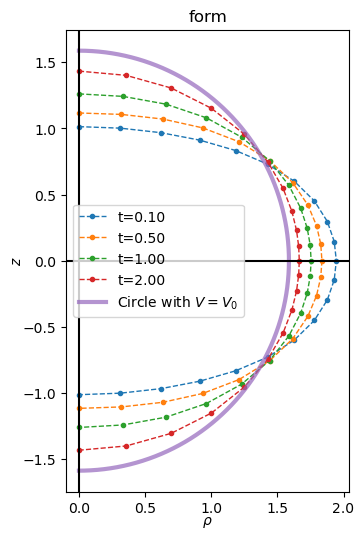

In [418]:
plt.figure(figsize=(6,6))
for t_j in [0.1,0.5, 1,2]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_rk.t-t_j))
    plt.plot(np.concatenate([[0.],sol_rk.y[:N-1,j],[0.]]), sol_rk.y[N-1:,j],'.--',
             lw=1, ms=6, label=f't={sol_rk.t[j]:.2f}')


plt.plot(P_Vol0,Z_Vol0, lw=3, label=r'Circle with $V=V_0$', alpha=0.7)    
    
    
plt.axis('scaled')
plt.legend()
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

<IPython.core.display.Javascript object>


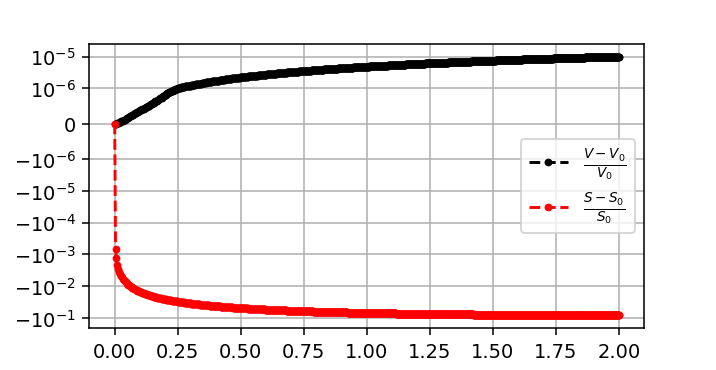

In [419]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_ar, Z_ar)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_rk.t)):
    Vol,Sqr,_ = get_VolSqr(get_P_with0(sol_rk.y[:N-1,j]), sol_rk.y[N-1:,j])
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_rk.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_rk.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-6)

In [420]:
%matplotlib inline
@interact_manual(j=(0,len(sol_rk.t)-1))
def plot_fields_j(j):
    P_j, Z_j = get_P_with0(sol_rk.y[:N-1,j]), sol_rk.y[N-1:,j]
    plt.figure()
    plt.title(f't={sol_rk.t[j]:.3f}')
    plt.plot(np.abs(np.fft.rfft(get_ext_array(Z_j), norm='forward')),'.--',ms=15, label=r'$Z_k$')
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_force_from_ar(P_j, Z_j)), norm='forward')),'.--',ms=15, label=r'$f_k$')
    
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_velo_h(P_j, Z_j)[1]), norm='forward')),'.--',ms=15, label=r'$v^z_k$')
    
    
    plt.xlim(0,N*2)
    plt.ylim(1e-10, 1e2)
    
    plt.legend()
    plt.yscale('log')

interactive(children=(IntSlider(value=572, description='j', max=1144), Button(description='Run Interact', styl…

## Surface tension work

In [143]:
N_ext_sigma = 8 #Number of harmonic to describe sigma#

In [35]:
def get_div_v_oper_fur(P, P1, P2, Z, Z1, Z2, H):
    """
    Return div_v_i[sigma_j]
    """
    ### fileds ###
    V = np.sqrt(P1**2+Z1**2)
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    ### kernals G ###
    G_tilde_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tilde_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tilde_mesh[0,1]
    G_zz_tilde_mesh     = G_tilde_mesh[1,1]
    G_zrho_tilde_mesh   = G_tilde_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    
    ### kernals dG (tilde) ###
    d_rhoG, d_zG = get_dG_tilde(P, P_int, Z, Z_int)
        
    d_rhoG_rhorho = d_rhoG[0,0]; d_rhoG_rhoz = d_rhoG[0,1]
    d_rhoG_zrho   = d_rhoG[1,0]; d_rhoG_zz   = d_rhoG[1,1]
    
    d_zG_rhorho = d_zG[0,0]; d_zG_rhoz = d_zG[0,1]
    d_zG_zrho   = d_zG[1,0]; d_zG_zz   = d_zG[1,1]

    
    ### vector kernals ###
    D_rho = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zrho+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_int).reshape(-1,1)*(G_rhorho_tilde_mesh)
    D_z = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zz+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_int).reshape(-1,1)*(G_rhoz_tilde_mesh)

    D_z[0,:] = D_z_axis_part(Z_int[0]-Z, P); D_z[-1,:] = D_z_axis_part(Z_int[-1]-Z, P)
    D_rho[0,:] = D_rho_axis_part(Z_int[0]-Z, P);D_rho[-1,:] = D_rho_axis_part(Z_int[-1]-Z, P)
    D_z[0,0] = np.pi*Z2_int[0]/P1_int[0]**2;D_z[-1,-1] = np.pi*Z2_int[-1]/P1_int[-1]**2

    ### normal and tau response ###
    D_n = -Z1.reshape(1,-1)*D_rho + P1.reshape(1,-1)*D_z
    D_tau = P1.reshape(1,-1)*D_rho + Z1.reshape(1,-1)*D_z

    D_n[0,0] = -Z2_int[0]*2*np.pi/P1_int[0]+P1_int[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_int[-1]*2*np.pi/P1_int[-1]+P1_int[-1]*D_z[-1,-1]


    D_tau[1:-1][Kron[1:-1]]=0
    D_n[1:-1][Kron[1:-1]]=0

    ### singular part of tau ###
    D_tau_ln = (P1_int/P_int).reshape(-1,1)*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    D_tau_ln[0,:]=0;D_tau_ln[-1,:]=0

    D_tau_0 = (P1_int*P2_int+Z1_int*Z2_int)/V_int**2 - 3*P1_int*Z1_int**2/P_int/V_int**2
    D_tau_0[0]=0;D_tau_0[-1]=0

    D_tau_ov = 2/(-dtau_int)
    D_tau_ov[0]=0;D_tau_ov[-1]=0

    D_tau_sing = D_tau_ln + D_tau_ov
    D_tau_sing[1:-1][Kron[1:-1]]=0

    ### Weigted opers ###

    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))
    I_ov = 2*np.log((1-tau_int)/tau_int)



    Int_D_tau_reg_oper = D_tau * weights_simp.reshape(1,-1)
    Int_D_tau_reg_oper[0,0]=0;Int_D_tau_reg_oper[-1,-1]=0

    Int_D_tau_reg_sing_oper = -np.diag(D_tau_sing @ weights_simp)
    Int_D_tau_reg_0_oper = np.diag(D_tau_0*weights_simp[::N_int//n_int])
    Int_D_tau_reg_der_oper = 2*np.diag(weights_simp[::N_int//n_int])



    Int_D_tau_reg_der_oper[0,0] = 2*np.pi*weights_simp[0];Int_D_tau_reg_der_oper[-1,-1] = 2*np.pi*weights_simp[-1]


    Int_D_tau_sing_oper = np.diag(P1_int/P_int*I_ln + I_ov)
    Int_D_tau_sing_oper[0]=0;Int_D_tau_sing_oper[-1]=0


    def get_div_v(sigma_fur):
        sigma, sigma1,sigma2,_,_ = get_int_fields(sigma_fur)

        tan_force = sigma1/V
        norm_force = -H*sigma

        tan_force_der_int = (sigma2/V)[::N_int//n_int]-\
                                    sigma1[::N_int//n_int]*((P1_int*P2_int+Z1_int*Z2_int)/V_int**3)

        Div_v_tau = Int_D_tau_reg_oper      @ tan_force +\
                    Int_D_tau_reg_sing_oper @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_0_oper    @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_der_oper  @ tan_force_der_int+\
                    Int_D_tau_sing_oper     @ tan_force[::N_int//n_int]

        Div_v_n = D_n * weights_simp.reshape(1,-1)      @ norm_force -\
                         (D_n @ weights_simp) * norm_force[::N_int//n_int]


        Div_v_sum = Div_v_n + Div_v_tau
        Div_v_sum /= 8*np.pi
        return Div_v_sum
    Div_v_sum_oper = np.apply_along_axis(get_div_v, 0,np.eye(N+N_ext_sigma))

    Div_v_sum_oper_fur = np.fft.rfft(np.apply_along_axis(get_ext_array,0,Div_v_sum_oper), norm='forward', axis=0).real

In [36]:
def get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force):
    """
    Return sigma_fur 
    """
    ### fileds ###
    V = np.sqrt(P1**2+Z1**2)
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    ### kernals G ###
    G_tilde_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tilde_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tilde_mesh[0,1]
    G_zz_tilde_mesh     = G_tilde_mesh[1,1]
    G_zrho_tilde_mesh   = G_tilde_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    
    ### kernals dG (tilde) ###
    d_rhoG, d_zG = get_dG_tilde(P, P_int, Z, Z_int)
        
    d_rhoG_rhorho = d_rhoG[0,0]; d_rhoG_rhoz = d_rhoG[0,1]
    d_rhoG_zrho   = d_rhoG[1,0]; d_rhoG_zz   = d_rhoG[1,1]
    
    d_zG_rhorho = d_zG[0,0]; d_zG_rhoz = d_zG[0,1]
    d_zG_zrho   = d_zG[1,0]; d_zG_zz   = d_zG[1,1]

    ### vector kernals ###
    D_rho = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zrho+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_int).reshape(-1,1)*(G_rhorho_tilde_mesh)
    D_z = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zz+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_int).reshape(-1,1)*(G_rhoz_tilde_mesh)

    D_z[0,:] = D_z_axis_part(Z_int[0]-Z, P); D_z[-1,:] = D_z_axis_part(Z_int[-1]-Z, P)
    D_rho[0,:] = D_rho_axis_part(Z_int[0]-Z, P);D_rho[-1,:] = D_rho_axis_part(Z_int[-1]-Z, P)
    D_z[0,0] = np.pi*Z2_int[0]/P1_int[0]**2;D_z[-1,-1] = np.pi*Z2_int[-1]/P1_int[-1]**2

    ### normal and tau response ###
    D_n = -Z1.reshape(1,-1)*D_rho + P1.reshape(1,-1)*D_z
    D_tau = P1.reshape(1,-1)*D_rho + Z1.reshape(1,-1)*D_z

    D_n[0,0] = -Z2_int[0]*2*np.pi/P1_int[0]+P1_int[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_int[-1]*2*np.pi/P1_int[-1]+P1_int[-1]*D_z[-1,-1]


    D_tau[1:-1][Kron[1:-1]]=0
    D_n[1:-1][Kron[1:-1]]=0

    ### singular part of tau ###
    D_tau_ln = (P1_int/P_int).reshape(-1,1)*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    D_tau_ln[0,:]=0;D_tau_ln[-1,:]=0

    D_tau_0 = (P1_int*P2_int+Z1_int*Z2_int)/V_int**2 - 3*P1_int*Z1_int**2/P_int/V_int**2
    D_tau_0[0]=0;D_tau_0[-1]=0

    D_tau_ov = 2/(-dtau_int)
    D_tau_ov[0]=0;D_tau_ov[-1]=0

    D_tau_sing = D_tau_ln + D_tau_ov
    D_tau_sing[1:-1][Kron[1:-1]]=0

    ### Weigted opers ###

    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))
    I_ov = 2*np.log((1-tau_int)/tau_int)



    Int_D_tau_reg_oper = D_tau * weights_simp.reshape(1,-1)
    Int_D_tau_reg_oper[0,0]=0;Int_D_tau_reg_oper[-1,-1]=0

    Int_D_tau_reg_sing_oper = -np.diag(D_tau_sing @ weights_simp)
    Int_D_tau_reg_0_oper = np.diag(D_tau_0*weights_simp[::N_int//n_int])
    Int_D_tau_reg_der_oper = 2*np.diag(weights_simp[::N_int//n_int])



    Int_D_tau_reg_der_oper[0,0] = 2*np.pi*weights_simp[0];Int_D_tau_reg_der_oper[-1,-1] = 2*np.pi*weights_simp[-1]


    Int_D_tau_sing_oper = np.diag(P1_int/P_int*I_ln + I_ov)
    Int_D_tau_sing_oper[0]=0;Int_D_tau_sing_oper[-1]=0


    def get_div_v(sigma_fur):
        sigma, sigma1,sigma2,_,_ = get_int_fields(sigma_fur)

        tan_force = sigma1/V
        norm_force = -H*sigma

        tan_force_der_int = (sigma2/V)[::N_int//n_int]-\
                                    sigma1[::N_int//n_int]*((P1_int*P2_int+Z1_int*Z2_int)/V_int**3)

        Div_v_tau = Int_D_tau_reg_oper      @ tan_force +\
                    Int_D_tau_reg_sing_oper @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_0_oper    @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_der_oper  @ tan_force_der_int+\
                    Int_D_tau_sing_oper     @ tan_force[::N_int//n_int]

        Div_v_n = D_n * weights_simp.reshape(1,-1)      @ norm_force -\
                         (D_n @ weights_simp) * norm_force[::N_int//n_int]


        Div_v_sum = Div_v_n + Div_v_tau
        Div_v_sum /= 8*np.pi
        return Div_v_sum
    Div_v_sum_oper = np.apply_along_axis(get_div_v, 0,np.eye(N+N_ext_sigma))
    Div_v_sum_oper_fur = np.fft.rfft(np.apply_along_axis(get_ext_array,0,Div_v_sum_oper), norm='forward', axis=0).real
    
    
    ### find div_v from helfrih force ###
    Div_v_force = D_n * weights_simp.reshape(1,-1)      @ force -\
                         (D_n @ weights_simp) * force[::N_int//n_int]
    Div_v_force /= 8*np.pi
    Div_v_force_fur =  np.fft.rfft(get_ext_array(Div_v_force), norm='forward').real
    
    sigma_fur = sc.linalg.solve(Div_v_sum_oper_fur[:N+N_ext_sigma,:],-Div_v_force_fur[:N+N_ext_sigma])
    return sigma_fur

In [37]:
def get_div_v_from_force(P, P1, P2, Z, Z1, Z2, norm_force, tan_force):
    """
    Return div_v induced by force 
    """
    ### fileds ###
    V = np.sqrt(P1**2+Z1**2)
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    ### kernals G ###
    G_tilde_mesh = get_all_G_tilde(P, P_int, Z, Z_int)
    G_rhorho_tilde_mesh = G_tilde_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tilde_mesh[0,1]
    G_zz_tilde_mesh     = G_tilde_mesh[1,1]
    G_zrho_tilde_mesh   = G_tilde_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    
    ### kernals dG (tilde) ###
    d_rhoG, d_zG = get_dG_tilde(P, P_int, Z, Z_int)
        
    d_rhoG_rhorho = d_rhoG[0,0]; d_rhoG_rhoz = d_rhoG[0,1]
    d_rhoG_zrho   = d_rhoG[1,0]; d_rhoG_zz   = d_rhoG[1,1]
    
    d_zG_rhorho = d_zG[0,0]; d_zG_rhoz = d_zG[0,1]
    d_zG_zrho   = d_zG[1,0]; d_zG_zz   = d_zG[1,1]

    ### vector kernals ###
    D_rho = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zrho+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_int).reshape(-1,1)*(G_rhorho_tilde_mesh)
    D_z = (P1_int**2/V_int**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_int**2/V_int**2).reshape(-1,1)*d_zG_zz+\
            (P1_int*Z1_int/V_int**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_int).reshape(-1,1)*(G_rhoz_tilde_mesh)

    D_z[0,:] = D_z_axis_part(Z_int[0]-Z, P); D_z[-1,:] = D_z_axis_part(Z_int[-1]-Z, P)
    D_rho[0,:] = D_rho_axis_part(Z_int[0]-Z, P);D_rho[-1,:] = D_rho_axis_part(Z_int[-1]-Z, P)
    D_z[0,0] = np.pi*Z2_int[0]/P1_int[0]**2;D_z[-1,-1] = np.pi*Z2_int[-1]/P1_int[-1]**2

    ### normal and tau response ###
    D_n = -Z1.reshape(1,-1)*D_rho + P1.reshape(1,-1)*D_z
    D_tau = P1.reshape(1,-1)*D_rho + Z1.reshape(1,-1)*D_z

    D_n[0,0] = -Z2_int[0]*2*np.pi/P1_int[0]+P1_int[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_int[-1]*2*np.pi/P1_int[-1]+P1_int[-1]*D_z[-1,-1]


    D_tau[1:-1][Kron[1:-1]]=0
    D_n[1:-1][Kron[1:-1]]=0

    ### singular part of tau ###
    D_tau_ln = (P1_int/P_int).reshape(-1,1)*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    D_tau_ln[0,:]=0;D_tau_ln[-1,:]=0

    D_tau_0 = (P1_int*P2_int+Z1_int*Z2_int)/V_int**2 - 3*P1_int*Z1_int**2/P_int/V_int**2
    D_tau_0[0]=0;D_tau_0[-1]=0

    D_tau_ov = 2/(-dtau_int)
    D_tau_ov[0]=0;D_tau_ov[-1]=0

    D_tau_sing = D_tau_ln + D_tau_ov
    D_tau_sing[1:-1][Kron[1:-1]]=0

    ### Weigted opers ###

    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))
    I_ov = 2*np.log((1-tau_int)/tau_int)



    Int_D_tau_reg_oper = D_tau * weights_simp.reshape(1,-1)
    Int_D_tau_reg_oper[0,0]=0;Int_D_tau_reg_oper[-1,-1]=0

    Int_D_tau_reg_sing_oper = -np.diag(D_tau_sing @ weights_simp)
    Int_D_tau_reg_0_oper = np.diag(D_tau_0*weights_simp[::N_int//n_int])
    Int_D_tau_reg_der_oper = 2*np.diag(weights_simp[::N_int//n_int])



    Int_D_tau_reg_der_oper[0,0] = 2*np.pi*weights_simp[0];Int_D_tau_reg_der_oper[-1,-1] = 2*np.pi*weights_simp[-1]


    Int_D_tau_sing_oper = np.diag(P1_int/P_int*I_ln + I_ov)
    Int_D_tau_sing_oper[0]=0;Int_D_tau_sing_oper[-1]=0


    def get_div_v(sigma_fur):
        sigma, sigma1,sigma2,_,_ = get_int_fields(sigma_fur)

        tan_force = sigma1/V
        norm_force = -H*sigma

        tan_force_der_int = (sigma2/V)[::N_int//n_int]-\
                                    sigma1[::N_int//n_int]*((P1_int*P2_int+Z1_int*Z2_int)/V_int**3)

        Div_v_tau = Int_D_tau_reg_oper      @ tan_force +\
                    Int_D_tau_reg_sing_oper @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_0_oper    @ tan_force[::N_int//n_int]+\
                    Int_D_tau_reg_der_oper  @ tan_force_der_int+\
                    Int_D_tau_sing_oper     @ tan_force[::N_int//n_int]

        Div_v_n = D_n * weights_simp.reshape(1,-1)      @ norm_force -\
                         (D_n @ weights_simp) * norm_force[::N_int//n_int]


        Div_v_sum = Div_v_n + Div_v_tau
        Div_v_sum /= 8*np.pi
        return Div_v_sum
    Div_v_sum_oper = np.apply_along_axis(get_div_v, 0,np.eye(N+N_ext_sigma))
    Div_v_sum_oper_fur = np.fft.rfft(np.apply_along_axis(get_ext_array,0,Div_v_sum_oper), norm='forward', axis=0).real
    
    
    ### find div_v from helfrih force ###
    Div_v_force = D_n * weights_simp.reshape(1,-1)      @ force -\
                         (D_n @ weights_simp) * force[::N_int//n_int]
    Div_v_force /= 8*np.pi
    Div_v_force_fur =  np.fft.rfft(get_ext_array(Div_v_force), norm='forward').real
    
    sigma_fur = sc.linalg.solve(Div_v_sum_oper_fur[:N+N_ext_sigma,:],-Div_v_force_fur[:N+N_ext_sigma])
    return sigma_fur

In [38]:
def get_sigma_fur_from_arr(P_fur, Z_fur):
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)

    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### find surface tension ###
    sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)
    return sigma_fur

## Main function

In [39]:
def get_velo_from_forces(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4, norm_force, tan_force):
    """
    Return velocity induced by normal force and tangent
    """
    
    ### fields prepare ###
    V = np.sqrt(P1**2+Z1**2)
    V_int = V[::N_int//n_int]
    Z_int = Z[::N_int//n_int]
    P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int]
    P1_int = P1[::N_int//n_int]
    
    norm_force_int = norm_force[::N_int//n_int]
    tan_force_int = tan_force[::N_int//n_int]
    
    
    ### kernals G ###
    G_tild_mesh = get_all_G_tilde(P, P_int, Z, Z_int)

    G_rhorho_tilde_mesh = G_tild_mesh[0,0]
    G_rhoz_tilde_mesh   = G_tild_mesh[0,1]
    G_zz_tilde_mesh     = G_tild_mesh[1,1]
    G_zrho_tilde_mesh   = G_tild_mesh[1,0]
    
    ### Axis expression ###
    G_zz_tilde_mesh[0,0]=2*np.pi;G_zz_tilde_mesh[-1,-1]=2*np.pi
    G_zrho_tilde_mesh[0,0]=0;G_zrho_tilde_mesh[-1,-1]=0
    
    ### Normal kernals ###
    K_rho =  P1.reshape(1,-1)*G_rhoz_tilde_mesh\
                     -Z1.reshape(1,-1)*G_rhorho_tilde_mesh    
    K_rho[Kron]=0
    K_rho[0]=0; K_rho[-1]=0

    K_z =  P1.reshape(1,-1)*G_zz_tilde_mesh\
                     -Z1.reshape(1,-1)*G_zrho_tilde_mesh
    K_z[1:-1][Kron[1:-1]]=0

    ### normal response ###
    V_rho_norm = K_rho @ (weights_simp*norm_force) - (norm_force_int.reshape(-1,1)*K_rho) @ weights_simp
    V_rho_norm /= 8*np.pi
    
    V_z_norm = K_z @ (weights_simp*norm_force) - (norm_force_int.reshape(-1,1)*K_z) @ weights_simp
    V_z_norm /= 8*np.pi
    

    ### tan response ###
    
    K_rhotau = Z1.reshape(1,-1)*G_rhoz_tilde_mesh+\
               P1.reshape(1,-1)*G_rhorho_tilde_mesh
    K_rhotau[Kron]=0

    K_rhotau_ln = P1_int.reshape(-1,1)*2*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    K_rhotau_ln[Kron]=0
    
    K_rhotau_0 = -4*P1_int
    
    I_ln = (1+tau_int*np.log(8*P_int/V_int/tau_int)+
                      (1-tau_int)*np.log(8*P_int/V_int/(1-tau_int)))

    
    I_K_rhotau_ln = 2*P1_int*I_ln

    
    K_ztau = Z1.reshape(1,-1)*G_zz_tilde_mesh+\
               P1.reshape(1,-1)*G_zrho_tilde_mesh
    K_ztau[1:-1][Kron[1:-1]]=0
    
    K_ztau_ln = Z1_int.reshape(-1,1)*2*\
                        np.log(8*(P_int/V_int).reshape(-1,1)/np.abs(dtau_int))
    K_ztau_ln[0,:]=0;K_ztau_ln[-1,:]=0
    K_ztau_ln[1:-1][Kron[1:-1]]=0
    
    K_ztau_0 = 2*Z1_int
    K_ztau_0[0]=0; K_ztau_0[-1]=0
    
    
    I_K_ztau_ln = 2*Z1_int*I_ln
    I_K_ztau_ln[0]=0;I_K_ztau_ln[-1]=0
    
    
    
    V_z_tan = K_ztau @ (weights_simp*tan_force)\
                    -(K_ztau_ln @ weights_simp) * tan_force_int\
                    +K_ztau_0*tan_force_int*weights_simp[::N_int//n_int]\
                    +I_K_ztau_ln*(tan_force_int)
    V_z_tan /= 8*np.pi
    
    V_rho_tan = K_rhotau @ (weights_simp*tan_force)\
                    -(K_rhotau_ln @ weights_simp) * tan_force_int\
                    +K_rhotau_0*tan_force_int*weights_simp[::N_int//n_int]\
                    +I_K_rhotau_ln*(tan_force_int)
    V_rho_tan[0]=0;V_rho_tan[-1]=0
    
    V_rho_tan /= 8*np.pi
    #print(V_z_tan, V_z_norm)
    return V_rho_tan+V_rho_norm, V_z_tan+V_z_norm

In [40]:
def get_velo(P_fur, Z_fur):
    """
    Find full velocity at n_int points
    """
    ### find fields ###
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)

    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### find surface tension ###
    sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)
    sigma, sigma1,_,_,_ = get_int_fields(sigma_fur)
    tan_force_sigma = sigma1/V
    norm_force_sigma = -H*sigma
    
    V_rho, V_z = get_velo_from_forces(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4, force+norm_force_sigma, tan_force_sigma)

    return V_rho, V_z

In [41]:
def get_velo_fur(P_fur, Z_fur):
    """
    Find N furier components of velocity 
    """
    V_rho, V_z = get_velo(P_fur, Z_fur)
    
    V_rho_fur = np.fft.rfft(get_ext_array(V_rho,'p'), norm='forward')[:N]
    V_z_fur = np.fft.rfft(get_ext_array(V_z,'z'), norm='forward')[:N]
    return (V_rho_fur/(-1j)).real, V_z_fur.real

In [42]:
def get_velo_fur_full(P_fur, Z_fur):
    """
    Find all n_int furier components of velocity 
    """
    V_rho, V_z = get_velo(P_fur, Z_fur)
    
    V_rho_fur = np.fft.rfft(get_ext_array(V_rho,'p'), norm='forward')
    V_z_fur = np.fft.rfft(get_ext_array(V_z,'z'), norm='forward')
    return (V_rho_fur/(-1j)).real, V_z_fur.real

In [43]:
def get_velo_normal_fur_full(P_fur, Z_fur): 
    """
    Find all n_int furier components from normal velocity 
    """
    V_rho, V_z = get_velo(P_fur, Z_fur)
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int] 
    V_int = V[::N_int//n_int]

    V_normal = V_rho*(-Z1_int/V_int)+V_z*(P1_int/V_int)
    V_rho_normal = V_normal*(-Z1_int/V_int)
    V_z_normal = V_normal*(P1_int/V_int)
    
    V_rho_normal_fur = np.fft.rfft(get_ext_array(V_rho_normal,'p'), norm='forward')
    V_z_normal_fur = np.fft.rfft(get_ext_array(V_z_normal,'z'), norm='forward')
    return (V_rho_normal_fur/(-1j)).real, V_z_normal_fur.real

In [44]:
def get_velo_normal_fur(P_fur, Z_fur): 
    """
    Find N furier components from normal velocity 
    """    
    V_rho, V_z = get_velo(P_fur, Z_fur)
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    V_normal = V_rho*(-Z1_int/V_int)+V_z*(P1_int/V_int)
    V_rho_normal = V_normal*(-Z1_int/V_int)
    V_z_normal = V_normal*(P1_int/V_int)
    
    V_rho_normal_fur = np.fft.rfft(get_ext_array(V_rho_normal,'p'), norm='forward')
    V_z_normal_fur = np.fft.rfft(get_ext_array(V_z_normal,'z'), norm='forward')
    return (V_rho_normal_fur/(-1j)).real[:N], V_z_normal_fur.real[:N]

In [45]:
def get_velo_norm_fur(P_fur, Z_fur): 
    """
    Find N furier components of normal velocity 
    """
    V_rho, V_z = get_velo(P_fur, Z_fur)
    
    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur)
    V = np.sqrt(P1**2+Z1**2)
    
    Z_int = Z[::N_int//n_int];P_int = P[::N_int//n_int]
    Z1_int = Z1[::N_int//n_int];P1_int = P1[::N_int//n_int]
    Z2_int = Z2[::N_int//n_int];P2_int = P2[::N_int//n_int]
    V_int = V[::N_int//n_int]

    V_normal = V_rho*(-Z1_int/V_int)+V_z*(P1_int/V_int)

    V_normal_fur = np.fft.rfft(get_ext_array(V_normal,'z'), norm='forward')
    return V_normal_fur.real[:N]

## Dynamic

In [851]:
def get_velo_fur_1d(pz):
    P_fur = np.zeros(N)
    P_fur[1:N]=pz[:N-1]
    Z_fur = pz[N-1:]
    veloP, veloZ = get_velo_fur(P_fur, Z_fur)
    return np.concatenate([veloP[1:N], veloZ])

In [423]:
sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_fur_1d(pz), (0., 2), np.concatenate([P_fur[1:N], Z_fur]), 
                                   method='BDF', atol=1e-8, rtol=1e-5);

<IPython.core.display.Javascript object>


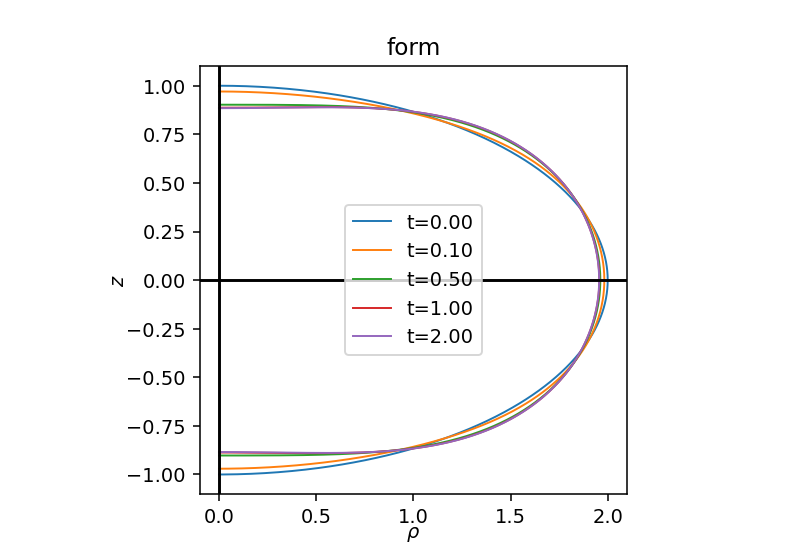

Text(0.5, 1.0, 'form')

In [441]:
plt.figure(figsize=(4,4))
for t_j in [0.,0.1,0.5, 1,2]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_bdf.t-t_j))
    
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_bdf.y[:N-1,j]
    Z_fur_j =sol_bdf.y[N-1:,j] 
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1, label=f't={sol_bdf.t[j]:.2f}')


    
    
plt.axis('scaled')
plt.legend()
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

<IPython.core.display.Javascript object>


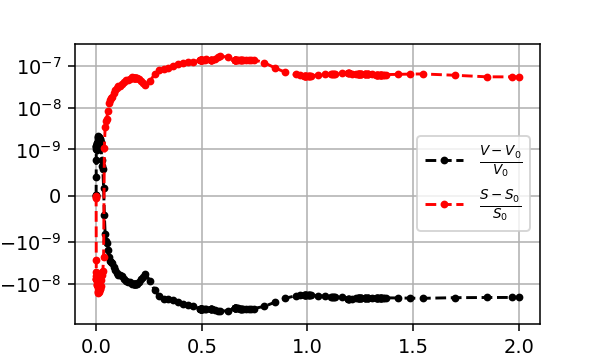

In [426]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur, Z_fur)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_bdf.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_bdf.y[:N-1,j]
    Z_fur_j =sol_bdf.y[N-1:,j] 
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_bdf.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_bdf.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-9)

<IPython.core.display.Javascript object>


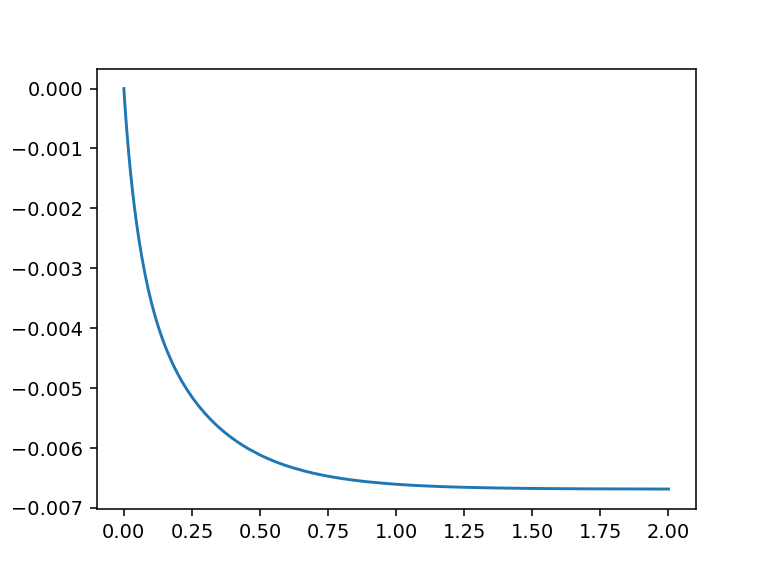

In [442]:
plt.figure()
j=4
plt.plot(sol_bdf.t, sol_bdf.y[j,:])

In [536]:
sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_fur_1d(pz), (0., 20), np.concatenate([2*P_fur[1:N], Z_fur]), 
                                   method='BDF', atol=1e-7, rtol=1e-4, max_step=1e-2);

<IPython.core.display.Javascript object>


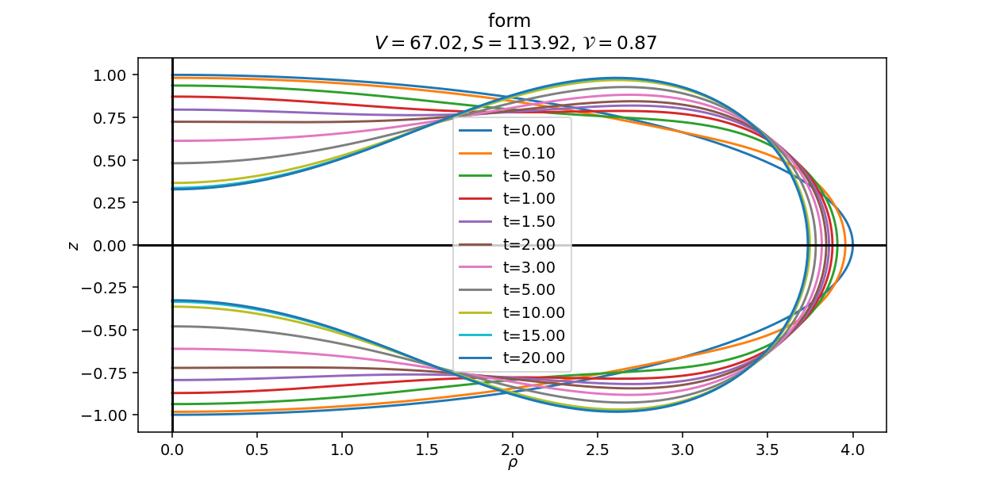

Text(0.5, 1.0, 'form \n $V=67.02, S=113.92$, $\\mathcal{V}=$$0.87$')

In [538]:
plt.figure(figsize=(4,4))
for t_j in [0.,0.1,0.5, 1,1.5,2,3,5,10,15,20]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_bdf.t-t_j))
    
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_bdf.y[:N-1,j]
    Z_fur_j =sol_bdf.y[N-1:,j] 
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1.5, label=f't={sol_bdf.t[j]:.2f}')


    
    
plt.axis('scaled')
plt.legend()
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
Vol0, Sqr0,Vcal0 = get_VolSqr(2*P_fur, Z_fur)

plt.title(fr'form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.2f}$')

<IPython.core.display.Javascript object>


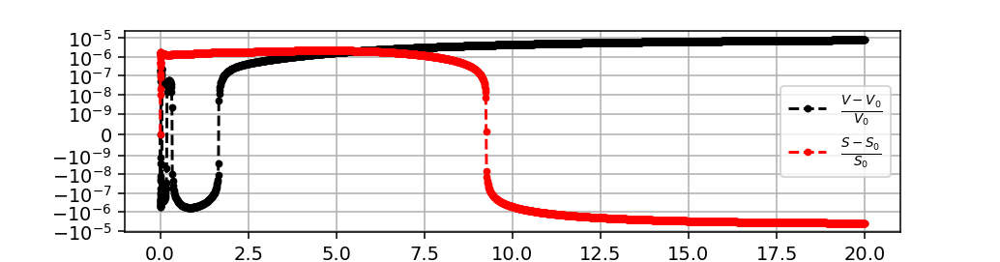

In [539]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(2*P_fur, Z_fur)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_bdf.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1:N] = sol_bdf.y[:N-1,j]
    Z_fur_j =sol_bdf.y[N-1:,j] 
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_bdf.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_bdf.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-9)

<IPython.core.display.Javascript object>


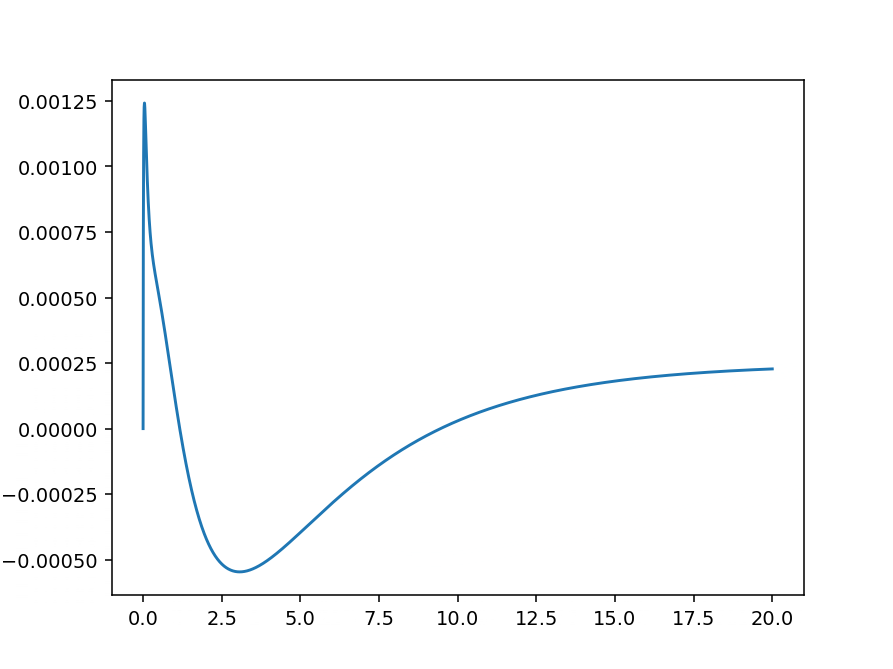

In [552]:
plt.figure()
j=10
plt.plot(sol_bdf.t, sol_bdf.y[j,:])

### Symmetric dynamic

In [918]:
def get_velo_fur_sym_1d(pz_sym):
    P_fur = np.zeros(N)
    P_fur[1::2]=pz_sym[:N//2]
    Z_fur = np.zeros(N)
    Z_fur[1::2]=pz_sym[N//2:]
    veloP, veloZ = get_velo_fur(P_fur, Z_fur)
    return np.concatenate([veloP[1::2], veloZ[1::2]])

#### Prepare initial state

In [999]:
P_fur0 = P_fur
Z_fur0 = Z_fur.copy()
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
V_cal0

0.8721972398478537

In [946]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur0)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur0)
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 

### find surface tension ###
sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)

<IPython.core.display.Javascript object>


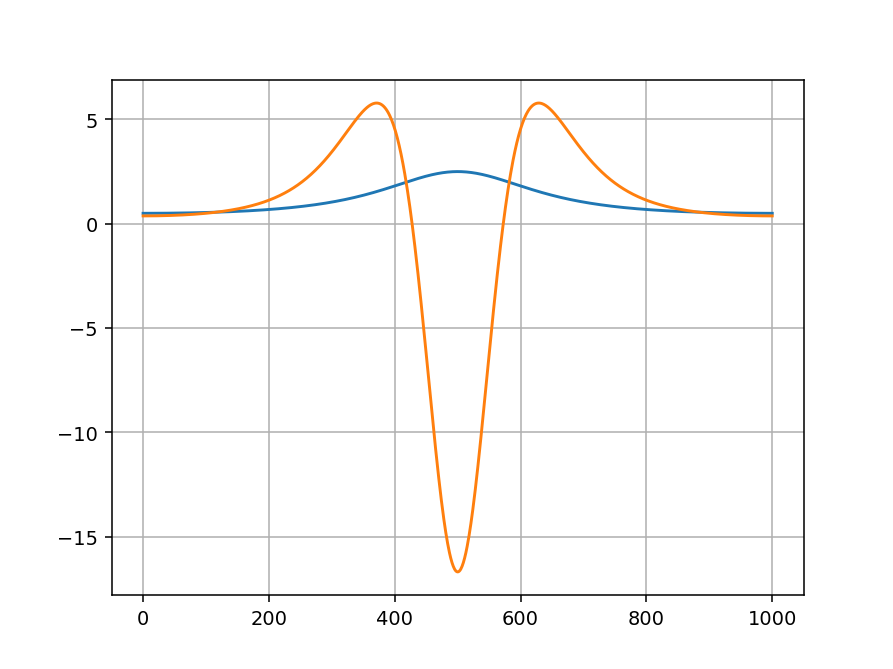

<IPython.core.display.Javascript object>


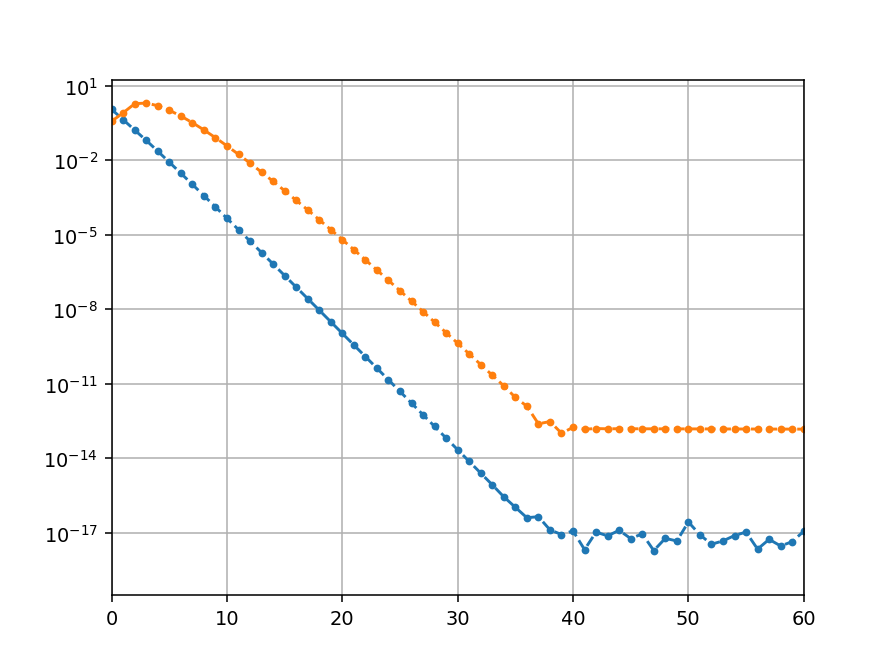

In [947]:
%matplotlib notebook
plt.plot(H)
plt.plot(force)
plt.grid()

plt.figure()
plt.plot(np.abs(np.fft.rfft(get_ext_array(H), norm='forward'))[::2], '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(force), norm='forward'))[::2], '.--')

plt.yscale('log')
plt.xlim(0,2*N)
plt.grid()

In [948]:
jfun = nd.Jacobian(get_velo_fur_sym_1d, step=2e-5)

jac = jfun(np.concatenate([P_fur0[1::2], Z_fur0[1::2]]))

<IPython.core.display.Javascript object>


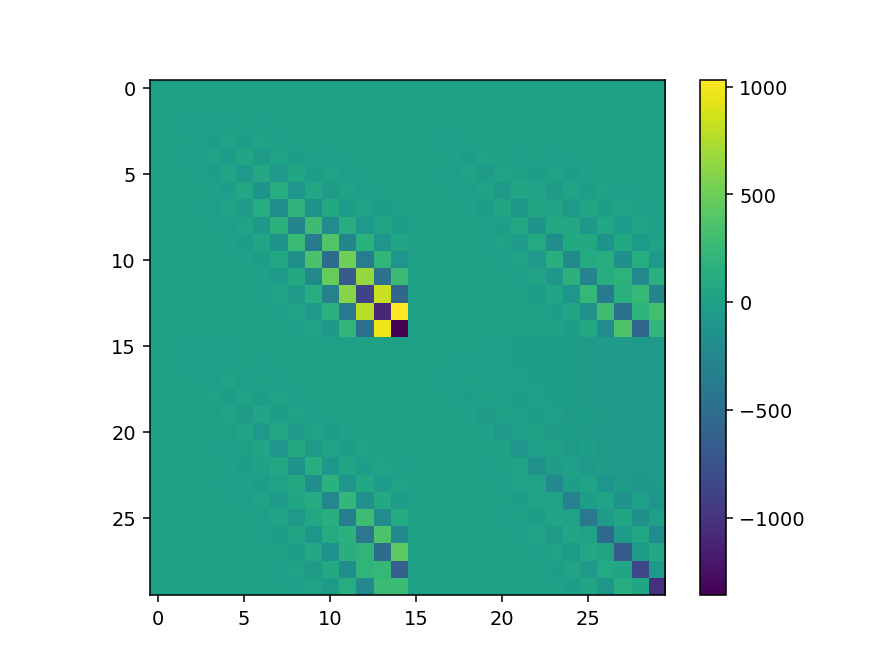

<IPython.core.display.Javascript object>


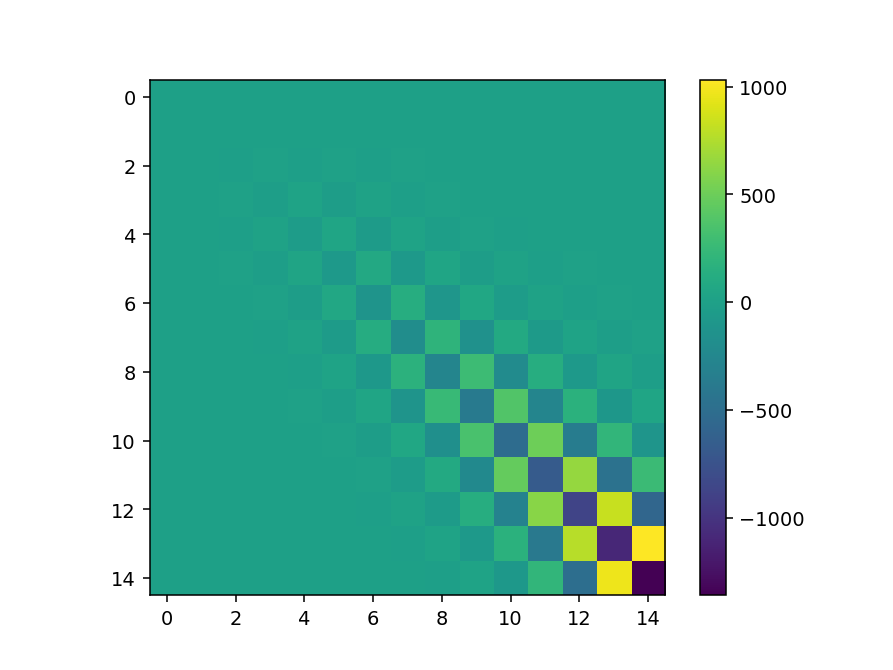

<IPython.core.display.Javascript object>


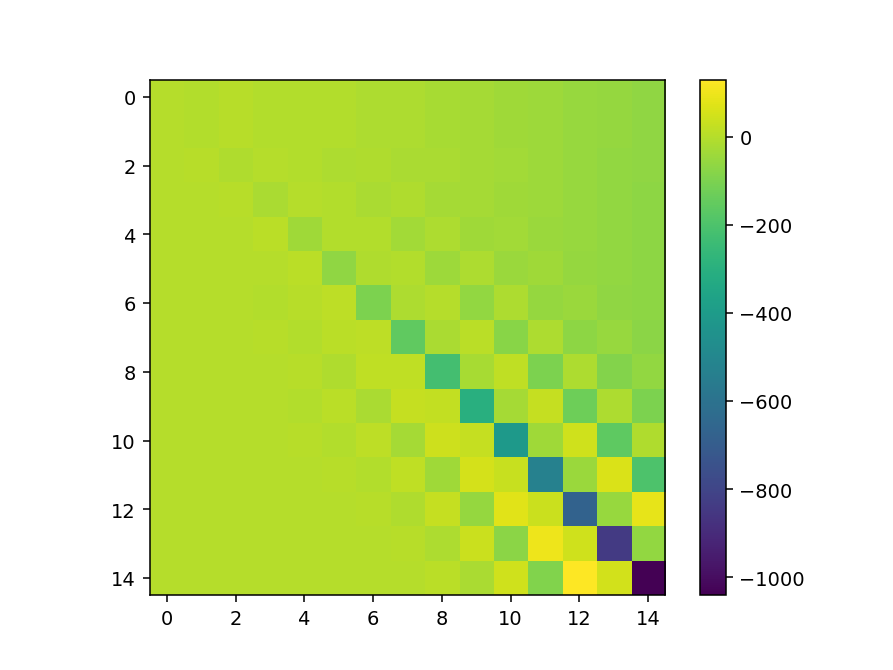

In [958]:
%matplotlib notebook
plt.figure()
plt.imshow(jac)
plt.colorbar()

plt.figure()
plt.imshow(jac[:N//2,:N//2])
plt.colorbar()

plt.figure()
plt.imshow(jac[N//2:,N//2:])
plt.colorbar()

In [951]:
w_full,vr_full =sc.linalg.eig(jac)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-5]
w_full_real = np.real(w_full_real)
print(w_full[np.abs(np.imag(w_full))>1e-5])
np.sort(w_full_real)

[ 0.34170465+0.14166655j  0.34170465-0.14166655j -0.07763557+0.11602928j
 -0.07763557-0.11602928j -0.08084395+0.03103415j -0.08084395-0.03103415j
 -0.04639979+0.02094933j -0.04639979-0.02094933j -0.01764154+0.01230915j
 -0.01764154-0.01230915j  0.00308815+0.00240001j  0.00308815-0.00240001j
 -0.00186249+0.0071013j  -0.00186249-0.0071013j ]


array([-3.35751451e+03, -1.92387080e+03, -1.29576402e+03, -9.66130100e+02,
       -7.51261402e+02, -5.71996443e+02, -4.19000158e+02, -2.95014916e+02,
       -1.97931313e+02, -1.24547954e+02, -7.15744246e+01, -3.57135009e+01,
       -1.36916223e+01, -2.16284361e+00, -8.92021219e-01,  2.30115033e-01])

In [952]:
w_full[np.real(w_full)>0]

array([0.34170465+0.14166655j, 0.34170465-0.14166655j,
       0.23011503+0.j        , 0.00308815+0.00240001j,
       0.00308815-0.00240001j])

<IPython.core.display.Javascript object>


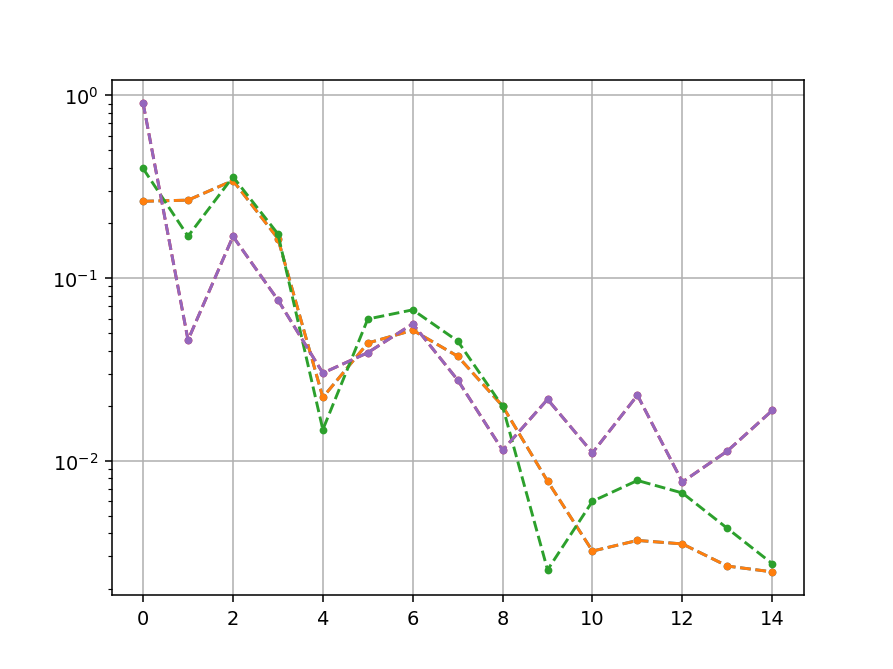

(0.34170464954200275+0.14166655124421704j)
(0.34170464954200275-0.14166655124421704j)
(0.23011503257858035+0j)
(0.0030881458173028682+0.0024000127253038374j)
(0.0030881458173028682-0.0024000127253038374j)


In [954]:
plt.figure()
for w_m in w_full[np.real(w_full)>0]:
    index_m = np.argmin(np.abs(w_full - w_m))
    print(w_full[index_m])
    v_m = np.abs(vr_full[:, index_m])
    plt.plot(v_m[:N//2],'.--')
    #plt.plot(v_m[N//2:],'.--')
    
plt.grid()
plt.yscale('log')

In [928]:
%matplotlib inline
@interact_manual(m=(0,20))
def plot_eig_j(m):
    plt.figure()
    
    w_m = (np.sort(w_full_real)[::-1])[m]
    plt.title(f'w={w_m}')
    index_m = np.argmin(np.abs(w_full - w_m))
    print(w_full[index_m])
    v_m = np.real(vr_full[:, index_m])
    plt.plot(v_m[:N//2],'.--')
    plt.plot(v_m[N//2:],'.--')
    plt.grid()
#     v_tau = get_P_with0(v_m[:N-1])*P1_ar_j + v_m[N-1:]*Z1_ar_j
#     v_tau /= V_ar_j
    
#     v_n = -Z1_ar_j*get_P_with0(v_m[:N-1]) + P1_ar_j*v_m[N-1:]
#     v_n /= V_ar_j
#     plt.figure()
#     plt.plot(v_n, 'o--',label=r'$v_n$')
#     plt.plot(v_tau, 'o--',label=r'$v_\tau$')
#     plt.legend()

interactive(children=(IntSlider(value=10, description='m', max=20), Button(description='Run Interact', style=B…

#### solve ivp

In [1000]:
sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_fur_sym_1d(pz), (0., 10), np.concatenate([P_fur0[1::2], Z_fur0[1::2]]), 
                                   method='BDF', atol=1e-7, rtol=5e-5, max_step=1e-2);

KeyboardInterrupt: 

Text(0.5, 1.0, 'form \n $V=16.76, S=34.69$, $\\mathcal{V}=$$0.872$')

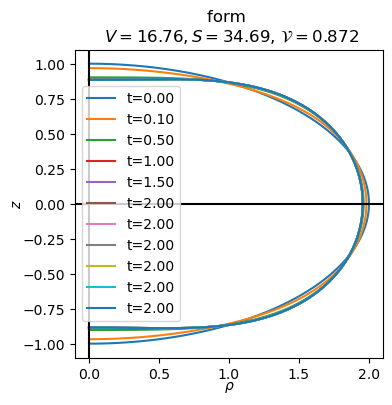

In [931]:
plt.figure(figsize=(4,4))
for t_j in [0.,0.1,0.5, 1,1.5,2,3,5,10]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_bdf.t-t_j))
    

    
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1.5, label=f't={sol_bdf.t[j]:.2f}')


    
    
plt.axis('scaled')
plt.legend(ncol=2)
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)

plt.title(fr'form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

In [ ]:
%matplotlib notebook




fig, ax = plt.subplots(figsize=(5,2))
ax.grid()

j=0
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_bdf.y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_bdf.y[N//2:,j]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)

line, = ax.plot(P,Z,lw=1.5)

ax.axis('scaled')
ax.axvline(0, color='k')
ax.axhline(0, color='k')

def animate(i):
    j=5*i
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    line.set_ydata(Z);line.set_xdata(P)  # update the data.
    ax.set_title(f't={sol_bdf.t[j]:.2f}')
    return line,


ani = animation.FuncAnimation(
    fig, animate, interval=20, save_count=220)

# To save the animation, use e.g.
#
#ani.save(f"dyno_{2.4}.mp4")
#
# or
#
writer = animation.FFMpegWriter(
     fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie_{0.501}.mp4", writer=writer)

plt.show()

_____________________

In [932]:
j=-1
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_bdf.y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_bdf.y[N//2:,j]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)
Z[0]

0.8845403277051754

<IPython.core.display.Javascript object>


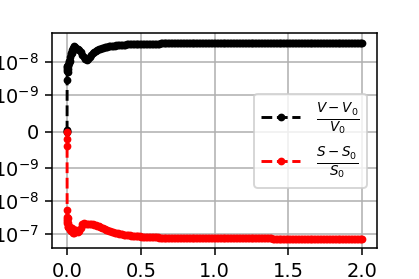

In [933]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_bdf.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_bdf.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_bdf.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-9)

In [935]:
@interact(k=(0,N))
def plot_sol_k(k):
    j=k
    plt.figure()
    plt.plot(sol_bdf.t, sol_bdf.y[j,:])
    
    plt.figure()
    plt.plot(sol_bdf.t[1:], np.abs((sol_bdf.y[j,1:]-sol_bdf.y[j,:-1])/(sol_bdf.t[1:]-sol_bdf.t[:-1])))
    plt.yscale('log')
    plt.grid()

interactive(children=(IntSlider(value=15, description='k', max=30), Output()), _dom_classes=('widget-interact'…

<IPython.core.display.Javascript object>


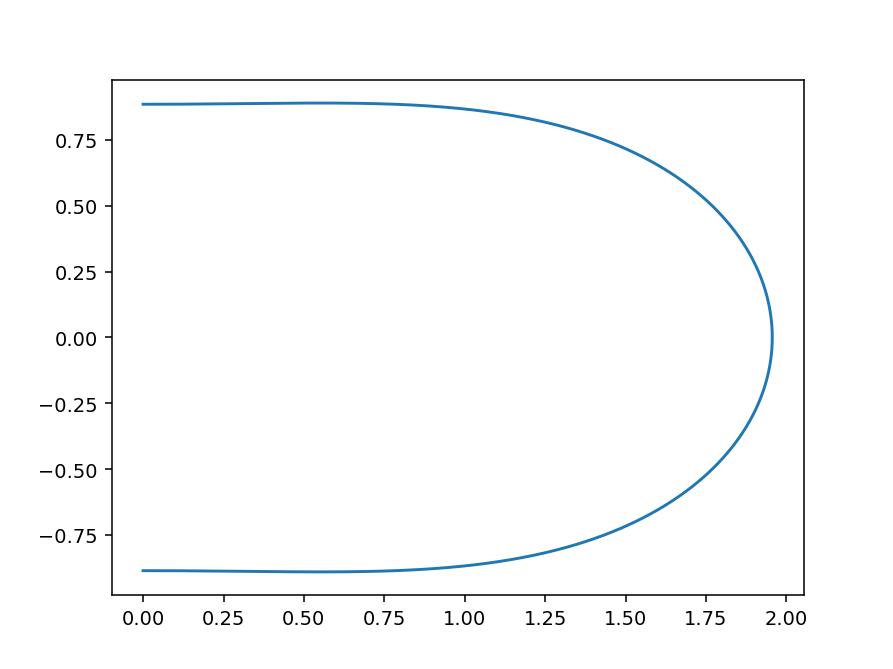

In [936]:
j=-1
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_bdf.y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_bdf.y[N//2:,j]


P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 

### find surface tension ###
sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)

plt.figure()
plt.plot(P,Z)

<IPython.core.display.Javascript object>


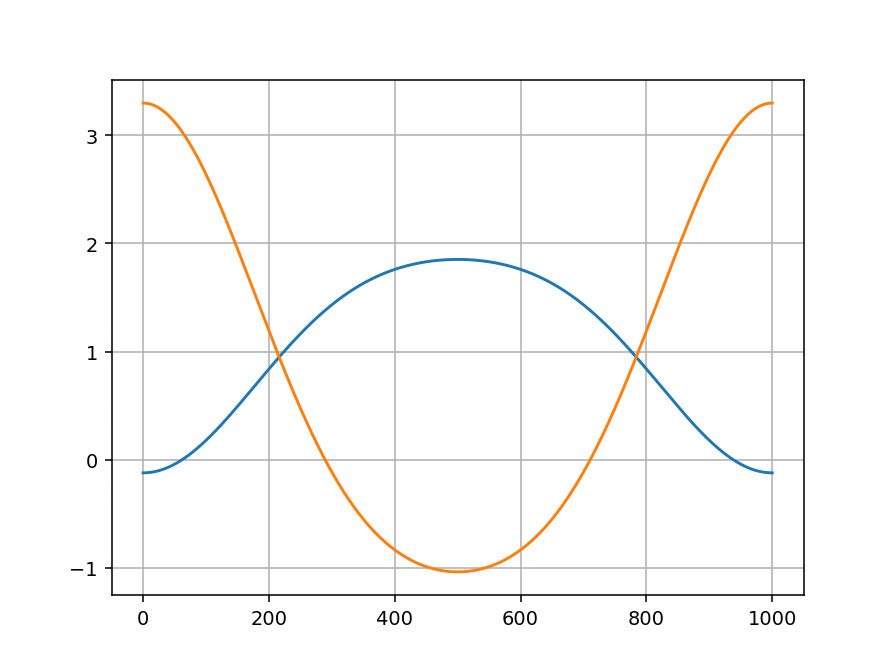

<IPython.core.display.Javascript object>


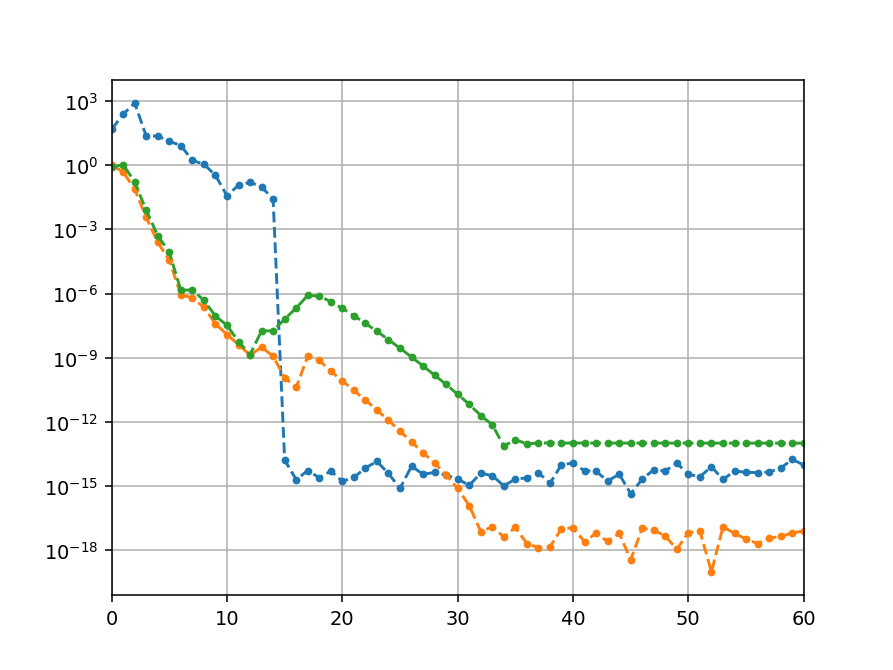

(0.0, 60.0)

In [937]:
%matplotlib notebook
plt.plot(H)
plt.plot(force)
plt.grid()

plt.figure()

plt.plot(np.abs(np.fft.rfft(get_ext_array(Z4), norm='forward'))[1::2], '.--')

plt.plot(np.abs(np.fft.rfft(get_ext_array(H), norm='forward'))[::2], '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(force), norm='forward'))[::2], '.--')

plt.yscale('log')
plt.grid()
plt.xlim(0,2*N)

In [938]:
jfun = nd.Jacobian(get_velo_fur_sym_1d, step=2e-5)

jac = jfun(sol_bdf.y[:,j])

<IPython.core.display.Javascript object>


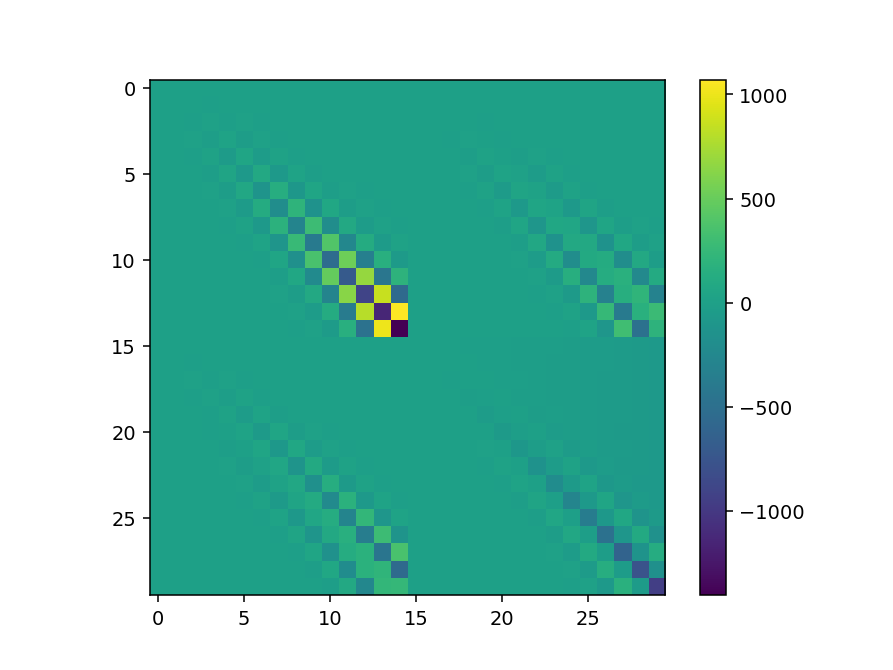

In [939]:
%matplotlib notebook
plt.figure()
plt.imshow(jac)
plt.colorbar()

In [940]:
jac[0,0]

-0.1529038284370373

In [941]:
w_full,vr_full =sc.linalg.eig(jac)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-5]
w_full_real = np.real(w_full_real)
print(w_full[np.abs(np.imag(w_full))>1e-5])
np.sort(w_full_real)

[1.43655065e-05+1.16558033e-05j 1.43655065e-05-1.16558033e-05j
 5.73815271e-06+1.50657580e-05j 5.73815271e-06-1.50657580e-05j]


array([-3.26069639e+03, -1.83619604e+03, -1.24560692e+03, -9.73493921e+02,
       -7.60326449e+02, -5.78089912e+02, -4.24603680e+02, -2.99723312e+02,
       -2.01791623e+02, -1.27696055e+02, -7.41581164e+01, -3.78841001e+01,
       -1.55690852e+01, -1.39590897e+01, -3.89951025e+00, -2.84174146e-03,
       -1.45238042e-03, -6.71353510e-04, -3.70056302e-04, -1.35698209e-04,
       -9.84269368e-05, -5.28981327e-05, -1.74508085e-05, -5.32618974e-06,
        4.43582512e-09,  1.15256883e-04])

In [894]:
w_full,vr_full =sc.linalg.eig(jac[0:N//2,0:N//2])
w_full_real = w_full[np.abs(np.imag(w_full))<1e-5]
w_full_real = np.real(w_full_real)
print(w_full[np.abs(np.imag(w_full))>1e-5])
np.sort(w_full_real)

[]


array([-1.10911554e+04, -4.38973300e+03, -2.03560677e+03, -1.01303870e+03,
       -5.18420062e+02, -2.65613822e+02, -1.33734926e+02, -6.53418189e+01,
       -3.10595358e+01, -1.59619000e+01, -1.19368792e+01, -9.39254670e+00,
       -5.85389223e+00, -4.26746354e+00, -3.17529192e+00, -2.06082758e+00,
       -1.45573230e+00, -9.93769072e-01, -6.32177039e-01, -3.96281464e-01,
       -2.19751150e-01, -1.04989850e-01, -4.18601598e-02, -1.27316778e-02,
        1.80895661e-03])

<IPython.core.display.Javascript object>


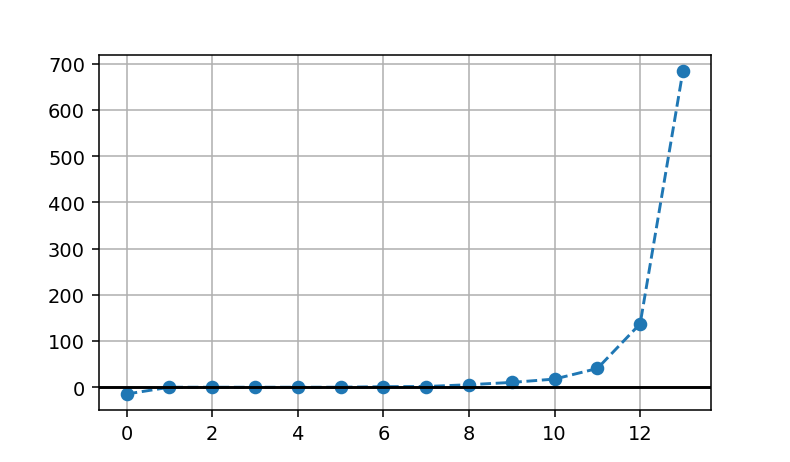

In [757]:
%matplotlib notebook
plt.figure()
plt.plot(-np.sort(w_full_real)[::-1],'o--')

plt.grid()
plt.axhline(0, color='k')
#plt.ylim(-1,10)
#plt.yscale('log')

In [942]:
%matplotlib inline
@interact_manual(m=(0,20))
def plot_eig_j(m):
    plt.figure()
    
    w_m = (np.sort(w_full_real)[::-1])[m]
    plt.title(f'w={w_m}')
    index_m = np.argmin(np.abs(w_full - w_m))
    print(w_full[index_m])
    v_m = np.real(vr_full[:, index_m])
    plt.plot(v_m[:N//2],'.--')
    plt.plot(v_m[N//2:],'.--')
    plt.grid()
#     v_tau = get_P_with0(v_m[:N-1])*P1_ar_j + v_m[N-1:]*Z1_ar_j
#     v_tau /= V_ar_j
    
#     v_n = -Z1_ar_j*get_P_with0(v_m[:N-1]) + P1_ar_j*v_m[N-1:]
#     v_n /= V_ar_j
#     plt.figure()
#     plt.plot(v_n, 'o--',label=r'$v_n$')
#     plt.plot(v_tau, 'o--',label=r'$v_\tau$')
#     plt.legend()

interactive(children=(IntSlider(value=10, description='m', max=20), Button(description='Run Interact', style=B…

________________________________

In [596]:
P_fur0 = P_fur*2.2
Z_fur0 = Z_fur.copy()
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
V_cal0

0.5462396686958905

In [597]:
sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_fur_sym_1d(pz), (0., 20), np.concatenate([P_fur0[1::2], Z_fur0[1::2]]), 
                                   method='BDF', atol=1e-7, rtol=1e-4, max_step=1e-2);

<IPython.core.display.Javascript object>


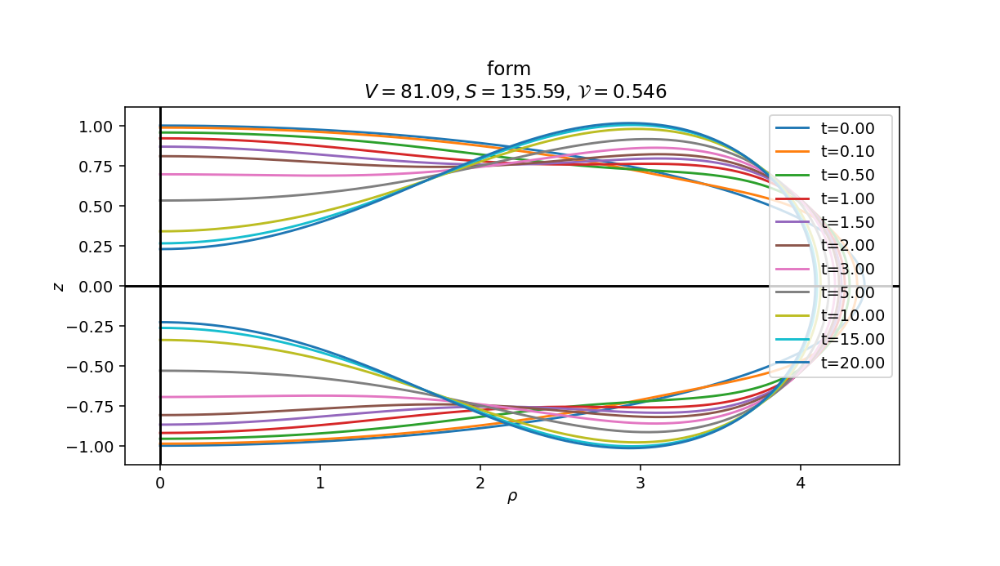

Text(0.5, 1.0, 'form \n $V=81.09, S=135.59$, $\\mathcal{V}=$$0.546$')

In [599]:
plt.figure(figsize=(4,4))
for t_j in [0.,0.1,0.5, 1,1.5,2,3,5,10,15,20]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_bdf.t-t_j))
    

    
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1.5, label=f't={sol_bdf.t[j]:.2f}')


    
    
plt.axis('scaled')
plt.legend(loc='upper right')
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)

plt.title(fr'form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

In [609]:
j=-1
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_bdf.y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_bdf.y[N//2:,j]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)
print(sol_bdf.y[:,-1])
Z[0]

[ 2.11712337e+00  3.17423999e-02 -2.71134120e-02  1.45631752e-02
  2.57166233e-03 -4.56435684e-05 -3.13517210e-04 -1.08455386e-04
 -1.16088724e-05  3.70099850e-06  4.07117665e-01 -2.10379070e-01
 -9.00552243e-02  6.46108422e-03  6.09627526e-04  4.50011532e-04
 -1.57848617e-04  6.35371947e-05  2.73424127e-05  2.52617012e-05]


0.2283247727886749

<IPython.core.display.Javascript object>


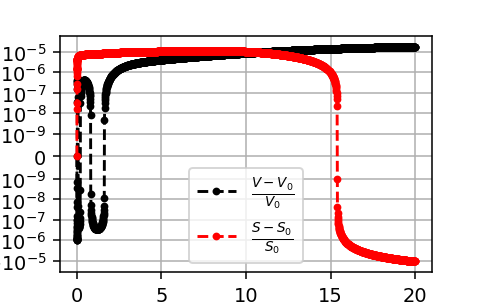

In [601]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_bdf.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_bdf.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_bdf.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-9)

<IPython.core.display.Javascript object>


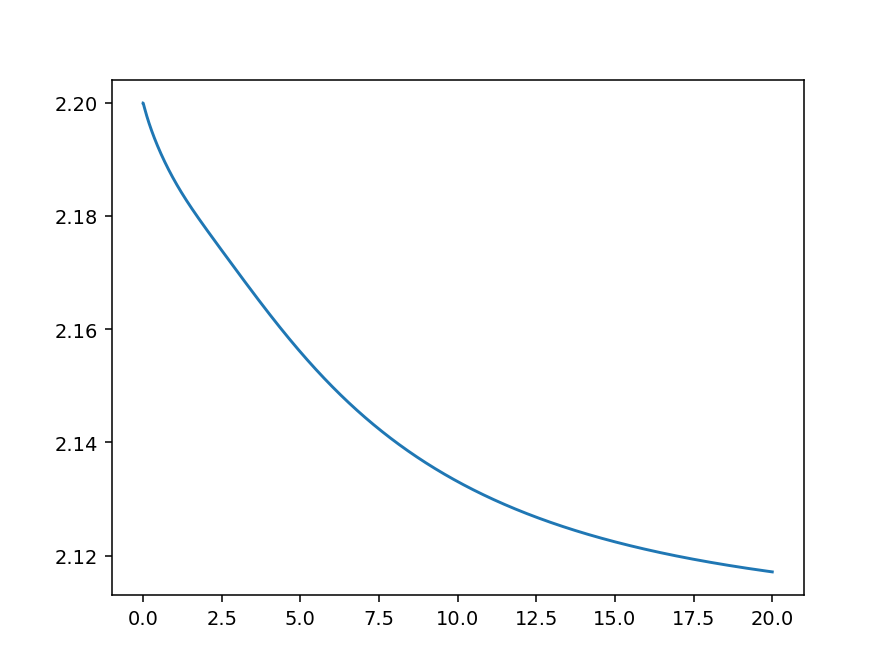

In [607]:
plt.figure()
j=0
plt.plot(sol_bdf.t, sol_bdf.y[j,:])

In [610]:
P_fur0 = P_fur*2.3
Z_fur0 = Z_fur.copy()
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
V_cal0

0.5280140515001072

In [628]:
sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_fur_sym_1d(pz), (0., 40), np.concatenate([P_fur0[1::2], Z_fur0[1::2]]), 
                                   method='BDF', atol=1e-7, rtol=1e-4, max_step=1e-2);

<IPython.core.display.Javascript object>


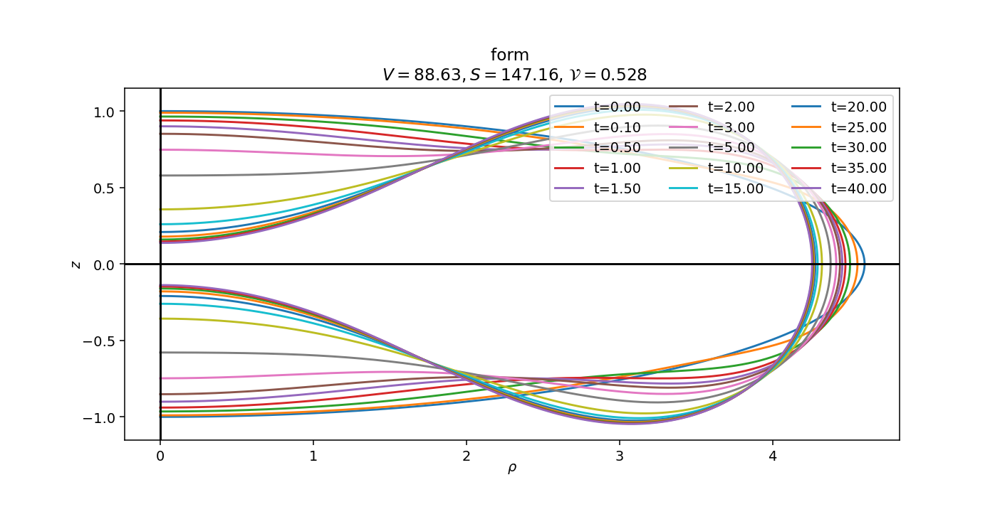

Text(0.5, 1.0, 'form \n $V=88.63, S=147.16$, $\\mathcal{V}=$$0.528$')

In [630]:
plt.figure(figsize=(8,5))
for t_j in [0.,0.1,0.5, 1,1.5,2,3,5,10,15,20, 25, 30,35,40]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_bdf.t-t_j))
    

    
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1.5, label=f't={sol_bdf.t[j]:.2f}')


    
    
plt.axis('scaled')
plt.legend(ncols=3,loc='upper right')
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)

plt.title(fr'form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

In [636]:
j=-1
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_bdf.y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_bdf.y[N//2:,j]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)
print(sol_bdf.y[:,-1])
Z[0]

[ 2.20305310e+00  3.19546208e-02 -2.91348064e-02  1.62778574e-02
  3.03773656e-03 -1.89077770e-04 -6.37926614e-04 -3.92144626e-04
 -6.89134082e-05  2.93439103e-05  3.96166227e-01 -2.33408673e-01
 -1.01143693e-01  6.13857109e-03  5.96766451e-04  4.51305522e-04
 -1.28558247e-04  1.06379259e-04  9.37431582e-05  1.03198070e-04]


0.137950532403334

<IPython.core.display.Javascript object>


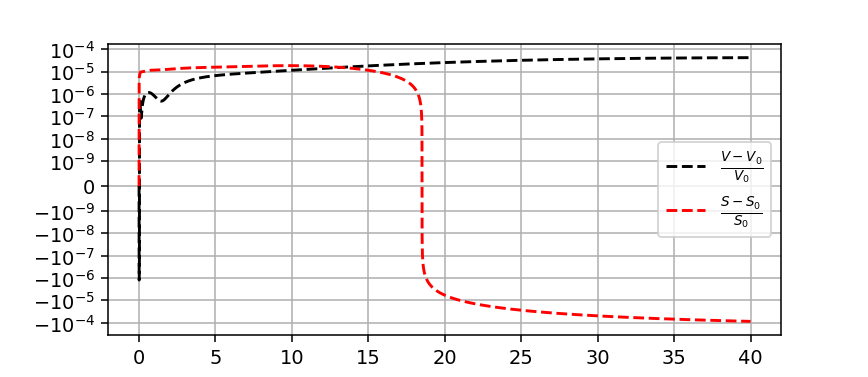

In [639]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_bdf.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_bdf.t, Vol_ar/Vol0-1,'--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_bdf.t, Sqr_ar/Sqr0-1,'--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-9)

<IPython.core.display.Javascript object>


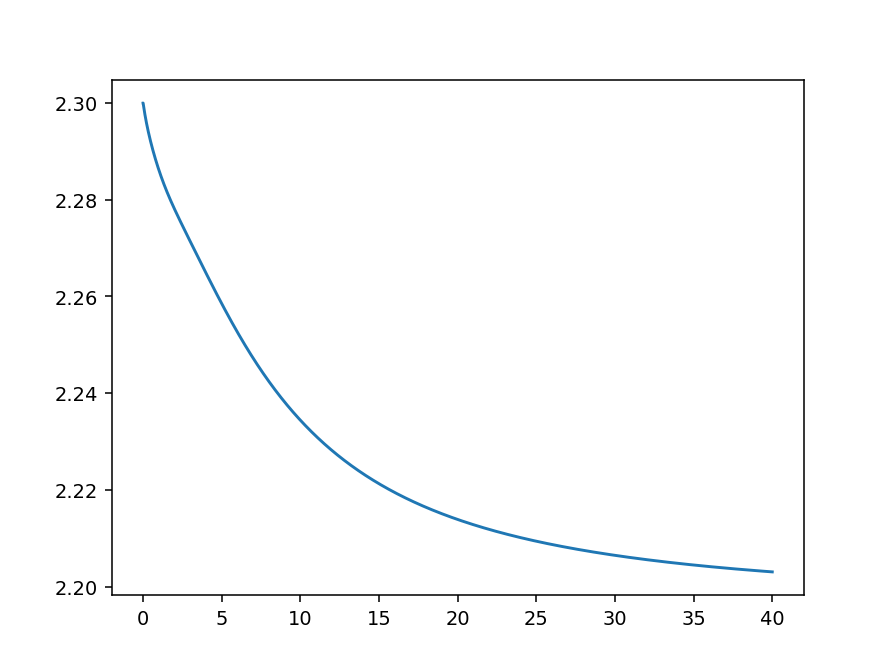

In [640]:
plt.figure()
j=0
plt.plot(sol_bdf.t, sol_bdf.y[j,:])

In [644]:
P_fur0 = P_fur*2.4
Z_fur0 = Z_fur.copy()
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
V_cal0

0.5108413648154675

In [703]:
sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_fur_sym_1d(pz), (0., 50), np.concatenate([P_fur0[1::2], Z_fur0[1::2]]), 
                                   method='BDF', atol=1e-7, rtol=1e-4, max_step=5e-2);

In [684]:
%matplotlib inline
@interact(j=(1,len(sol_bdf.t)))
def plot_moment_j(j):
    plt.figure(figsize=(8,5))
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1.5, label=f't={sol_bdf.t[j]:.2f}')


    
    
    plt.axis('scaled')
    plt.legend(ncols=3,loc='upper right')
    plt.axvline(0, color='k')
    plt.axhline(0, color='k')
    
    plt.xlabel(r'$\rho$', labelpad=-1)
    plt.ylabel(r'$z$', labelpad=-1)
    Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
    
    plt.title(fr'form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

interactive(children=(IntSlider(value=529, description='j', max=1058, min=1), Output()), _dom_classes=('widget…

<Figure size 800x500 with 0 Axes>

<Figure size 800x500 with 0 Axes>

<IPython.core.display.Javascript object>


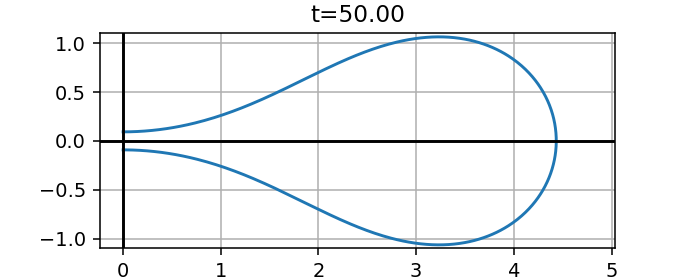

In [724]:
%matplotlib notebook



import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(5,2))
ax.grid()

j=0
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_bdf.y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_bdf.y[N//2:,j]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)

line, = ax.plot(P,Z,lw=1.5)

ax.axis('scaled')
ax.axvline(0, color='k')
ax.axhline(0, color='k')

def animate(i):
    j=5*i
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    line.set_ydata(Z);line.set_xdata(P)  # update the data.
    ax.set_title(f't={sol_bdf.t[j]:.2f}')
    return line,


ani = animation.FuncAnimation(
    fig, animate, interval=20, save_count=212)

# To save the animation, use e.g.
#
#ani.save(f"dyno_{2.4}.mp4")
#
# or
#
writer = animation.FFMpegWriter(
     fps=15, metadata=dict(artist='Me'), bitrate=1800)
ani.save("movie_{0.511}.mp4", writer=writer)

plt.show()

<IPython.core.display.Javascript object>


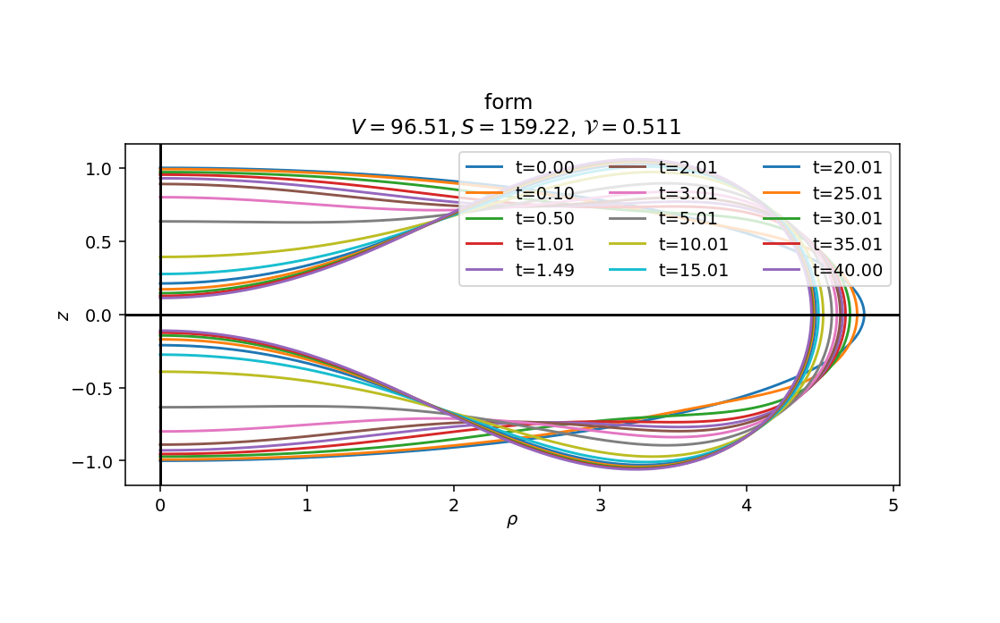

Text(0.5, 1.0, 'form \n $V=96.51, S=159.22$, $\\mathcal{V}=$$0.511$')

In [686]:
plt.figure(figsize=(8,5))
for t_j in [0.,0.1,0.5, 1,1.5,2,3,5,10,15,20, 25, 30,35,40]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_bdf.t-t_j))
    

    
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1.5, label=f't={sol_bdf.t[j]:.2f}')


    
    
plt.axis('scaled')
plt.legend(ncols=3,loc='upper right')
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)

plt.title(fr'form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

In [707]:
j=-1
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_bdf.y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_bdf.y[N//2:,j]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)
print(sol_bdf.y[:,-1])
Z[0]

[ 2.29506364e+00  3.27358740e-02 -3.04912440e-02  1.74513507e-02
  2.58422032e-03 -8.30844116e-04 -1.23907805e-03 -9.13521497e-04
 -2.01925668e-04  7.62948924e-05  3.88684055e-01 -2.48179050e-01
 -1.05348761e-01  8.41242725e-03  1.14760513e-03  5.88674014e-04
  5.76239327e-05  2.61882963e-04  2.18474103e-04  2.61641507e-04]


0.09220914626238619

<IPython.core.display.Javascript object>


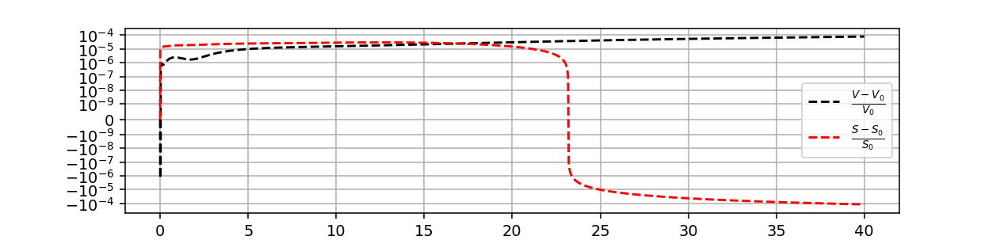

In [688]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_bdf.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_bdf.t, Vol_ar/Vol0-1,'--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_bdf.t, Sqr_ar/Sqr0-1,'--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-9)

<IPython.core.display.Javascript object>


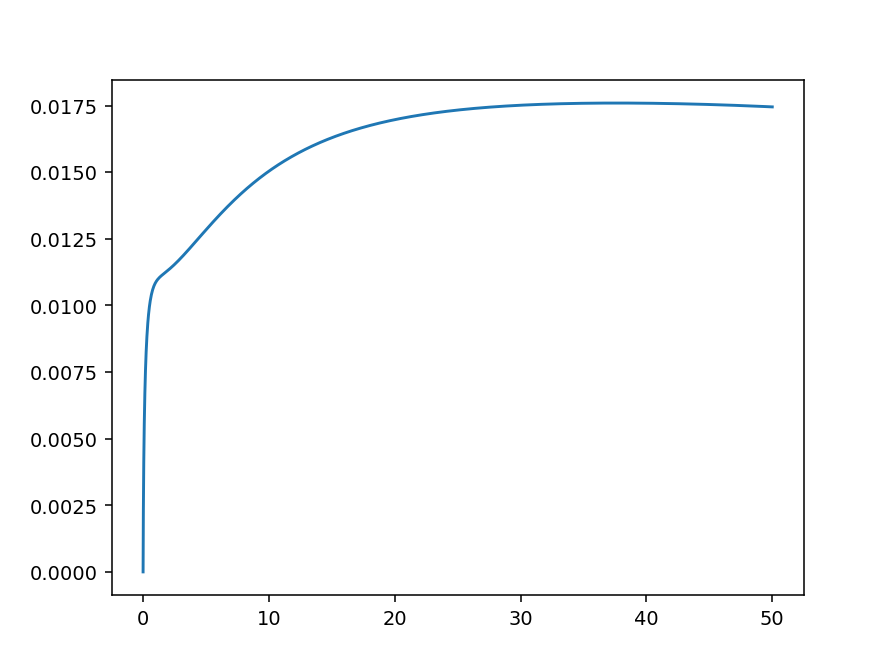

<IPython.core.display.Javascript object>


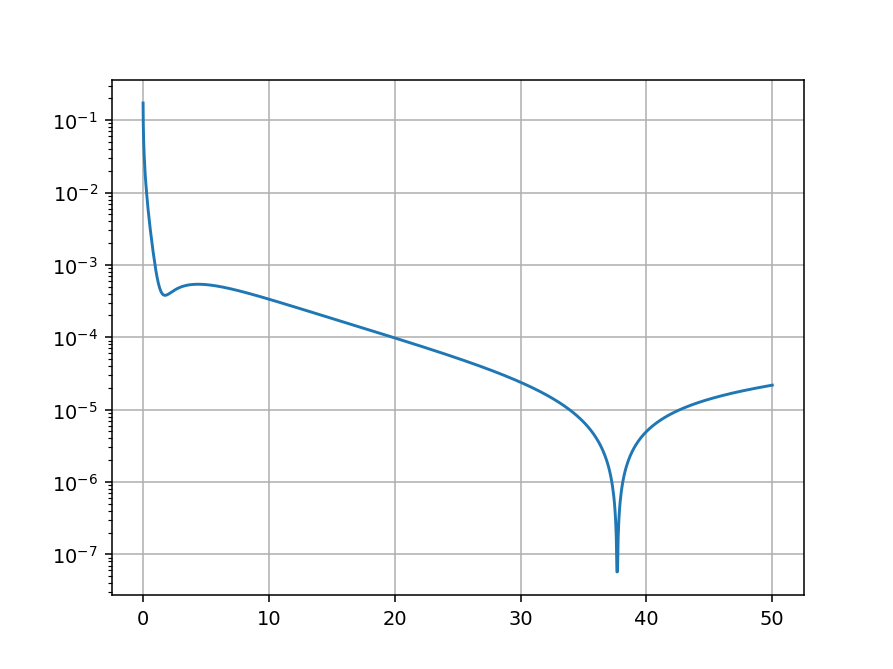

In [723]:
plt.figure()
j=3
plt.plot(sol_bdf.t, sol_bdf.y[j,:])

plt.figure()
plt.plot(sol_bdf.t[1:], np.abs((sol_bdf.y[j,1:]-sol_bdf.y[j,:-1])/(sol_bdf.t[1:]-sol_bdf.t[:-1])))
plt.yscale('log')
plt.grid()

In [855]:
P_fur0 = P_fur*2.46
Z_fur0 = Z_fur.copy()
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
V_cal0

0.5010114023003863

In [856]:



P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur0)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur0)
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 

### find surface tension ###
sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)

<IPython.core.display.Javascript object>


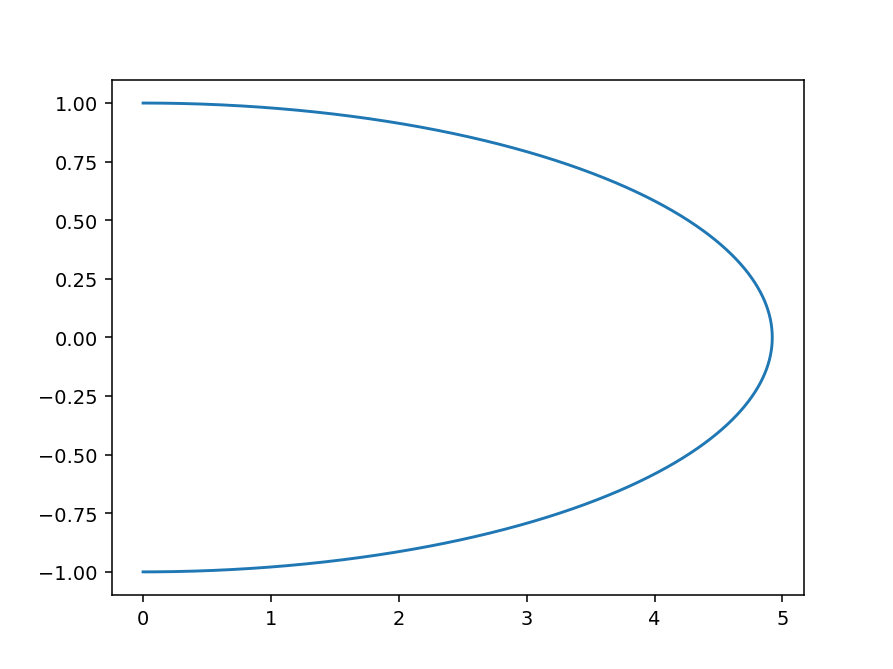

In [857]:
plt.figure()
plt.plot(P,Z)

<IPython.core.display.Javascript object>


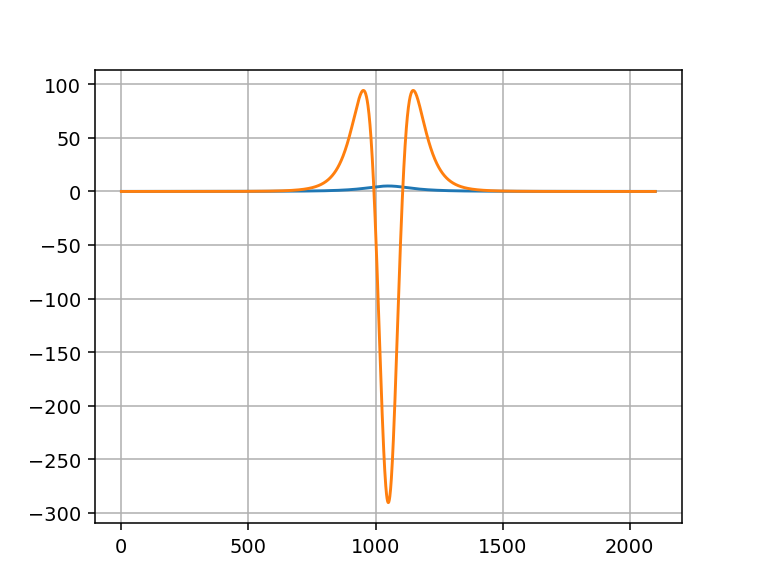

<IPython.core.display.Javascript object>


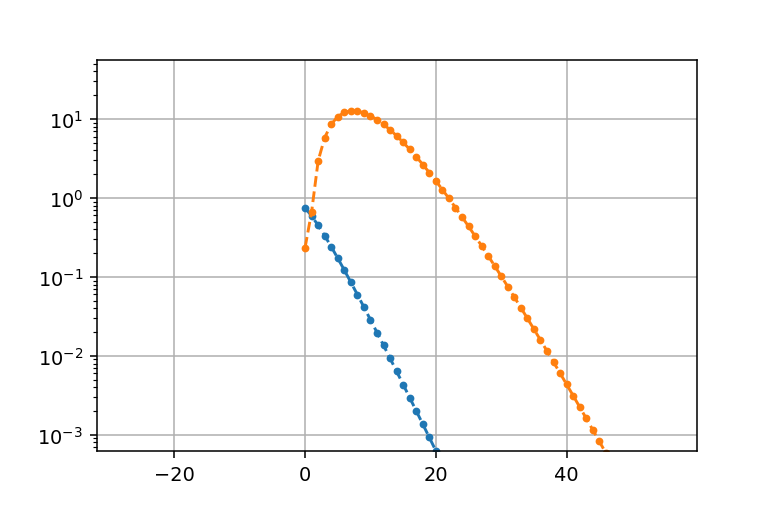

In [858]:
%matplotlib notebook
plt.plot(H)
plt.plot(force)
plt.grid()

plt.figure()
plt.plot(np.abs(np.fft.rfft(get_ext_array(H), norm='forward'))[::2], '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(force), norm='forward'))[::2], '.--')

plt.yscale('log')
plt.grid()

In [859]:
jfun = nd.Jacobian(get_velo_fur_sym_1d, step=2e-5)

jac = jfun(np.concatenate([P_fur0[1::2], Z_fur0[1::2]]))

<IPython.core.display.Javascript object>


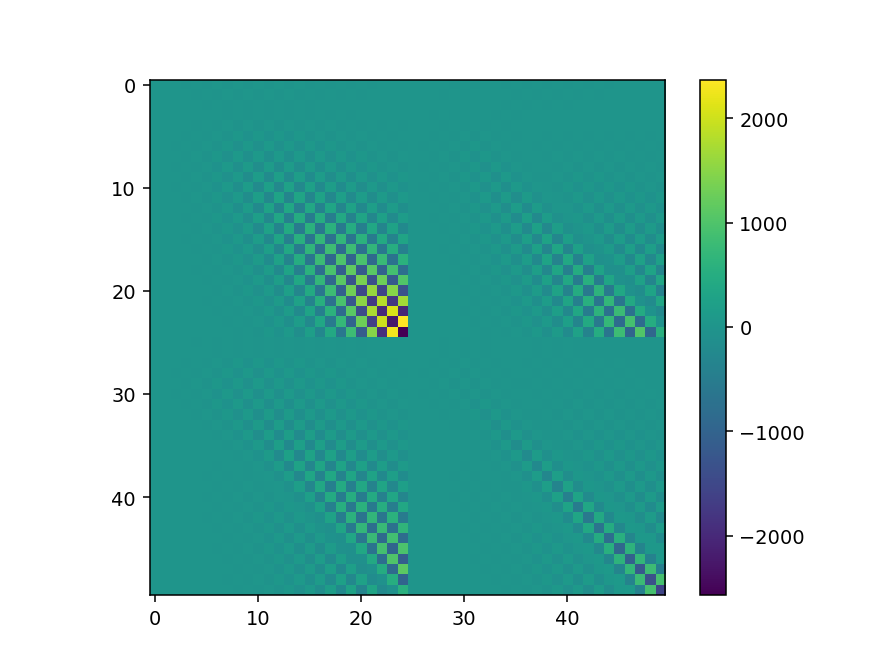

In [860]:
%matplotlib notebook
plt.figure()
plt.imshow(jac)
plt.colorbar()

In [861]:
w_full,vr_full =sc.linalg.eig(jac)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-5]
w_full_real = np.real(w_full_real)
print(w_full[np.abs(np.imag(w_full))>1e-5])
np.sort(w_full_real)

[-1.17313804e+00+1.65455802e+00j -1.17313804e+00-1.65455802e+00j
 -3.67692504e-01+1.19837927e-01j -3.67692504e-01-1.19837927e-01j
  7.56345883e-03+2.33616216e-03j  7.56345883e-03-2.33616216e-03j
  3.85524493e-03+1.28573222e-03j  3.85524493e-03-1.28573222e-03j
  2.30642184e-03+1.06018733e-03j  2.30642184e-03-1.06018733e-03j
 -2.90977328e-04+3.20042351e-04j -2.90977328e-04-3.20042351e-04j
  1.76893444e-04+4.32679577e-04j  1.76893444e-04-4.32679577e-04j
  9.67842294e-04+7.44599429e-04j  9.67842294e-04-7.44599429e-04j]


array([-1.26020224e+04, -5.88015883e+03, -3.15786170e+03, -1.79996592e+03,
       -1.09450253e+03, -7.11341240e+02, -4.92367175e+02, -3.61403271e+02,
       -2.81097207e+02, -2.29948512e+02, -1.90158740e+02, -1.54487284e+02,
       -1.23232511e+02, -9.64089950e+01, -7.37187705e+01, -5.48301625e+01,
       -3.94092967e+01, -2.71184212e+01, -1.76129401e+01, -1.05315895e+01,
       -5.46890998e+00, -1.83527551e+00, -6.69090196e-01, -4.42441933e-01,
       -2.33796607e-01, -8.00834930e-02, -3.52892190e-02, -1.54691806e-02,
       -2.70917668e-03,  5.49993155e-03,  1.78105339e-02,  1.40812148e+00,
        5.63271890e+00,  8.70400819e+00])

In [862]:
sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_fur_sym_1d(pz), (0., 10), np.concatenate([P_fur0[1::2], Z_fur0[1::2]]), 
                                   method='BDF', atol=1e-7, rtol=1e-4, max_step=1e-2);

In [863]:
len(sol_bdf.t)/5

210.4

In [864]:
%matplotlib inline
@interact(j=(1,len(sol_bdf.t)))
def plot_moment_j(j):
    plt.figure(figsize=(8,5))
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1.5, label=f't={sol_bdf.t[j]:.2f}')


    
    
    plt.axis('scaled')
    plt.legend(ncols=3,loc='upper right')
    plt.axvline(0, color='k')
    plt.axhline(0, color='k')
    
    plt.xlabel(r'$\rho$', labelpad=-1)
    plt.ylabel(r'$z$', labelpad=-1)
    Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
    
    plt.title(fr'form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

interactive(children=(IntSlider(value=526, description='j', max=1052, min=1), Output()), _dom_classes=('widget…

<Figure size 800x500 with 0 Axes>

<IPython.core.display.Javascript object>


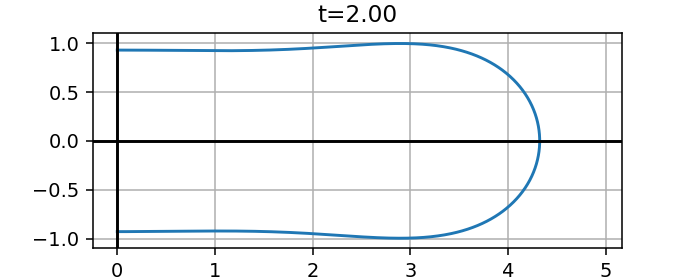

In [818]:
%matplotlib notebook



import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(5,2))
ax.grid()

j=0
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_bdf.y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_bdf.y[N//2:,j]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)

line, = ax.plot(P,Z,lw=1.5)

ax.axis('scaled')
ax.axvline(0, color='k')
ax.axhline(0, color='k')

def animate(i):
    j=5*i
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    line.set_ydata(Z);line.set_xdata(P)  # update the data.
    ax.set_title(f't={sol_bdf.t[j]:.2f}')
    return line,


ani = animation.FuncAnimation(
    fig, animate, interval=20, save_count=220)

# To save the animation, use e.g.
#
#ani.save(f"dyno_{2.4}.mp4")
#
# or
#
writer = animation.FFMpegWriter(
     fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie_{0.501}.mp4", writer=writer)

plt.show()

In [819]:
j=-1
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_bdf.y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_bdf.y[N//2:,j]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)
print(sol_bdf.y[:,-1])
Z[0]

[ 2.27510946e+00  7.89599884e-02 -2.24304891e-02  1.15468259e-02
 -9.22591674e-04 -1.06772304e-03 -3.27447199e-05  5.87703721e-05
 -2.05785141e-06  1.05400458e-05  1.26907045e-06  1.53435955e-06
 -5.63816175e-07  1.97652650e-07 -2.23199255e-07  1.07598019e-07
 -9.85097172e-08  2.02100478e-09 -7.88467241e-10 -2.71196584e-08
  5.49195472e-01 -7.29195917e-02 -3.60837606e-02  2.18969858e-02
  1.99619915e-03  4.40304301e-04  1.44444586e-05  1.31192066e-04
 -6.51447142e-05  1.36737630e-05 -1.33857274e-05  5.22878614e-06
 -3.12256083e-06  1.78357331e-06 -8.61421341e-07  4.75704079e-07
 -1.88306292e-07  4.92491078e-08  2.94865608e-09 -9.33194660e-09]


0.9292194955801774

In [820]:
get_velo_fur_sym_1d(sol_bdf.y[:,-1])

array([-6.69315572e-02,  1.23969776e-02, -1.10492358e-03,  9.16626573e-04,
        2.72097528e-03,  7.40444373e-05, -3.59821655e-04, -1.06285326e-04,
       -2.74603328e-05, -1.02633596e-05,  1.67724260e-06,  2.51840904e-06,
        1.45317096e-06,  4.15929363e-07,  1.17087682e-07, -3.66307231e-08,
       -3.34895409e-08, -2.73580282e-08,  1.45404764e-08,  7.05054321e-09,
        2.28748186e-02, -1.37295439e-02, -2.78560214e-02, -9.00791473e-03,
        7.75332069e-04,  4.00587155e-04,  1.21636402e-04,  1.53212711e-04,
        6.42355040e-05,  8.46274370e-06, -1.10379423e-06, -2.20188236e-06,
       -1.16011919e-06, -4.79518810e-07, -4.79591364e-08, -4.38137685e-09,
        5.54358646e-08, -1.61462172e-08,  2.18478169e-08, -2.61863377e-09])

<IPython.core.display.Javascript object>


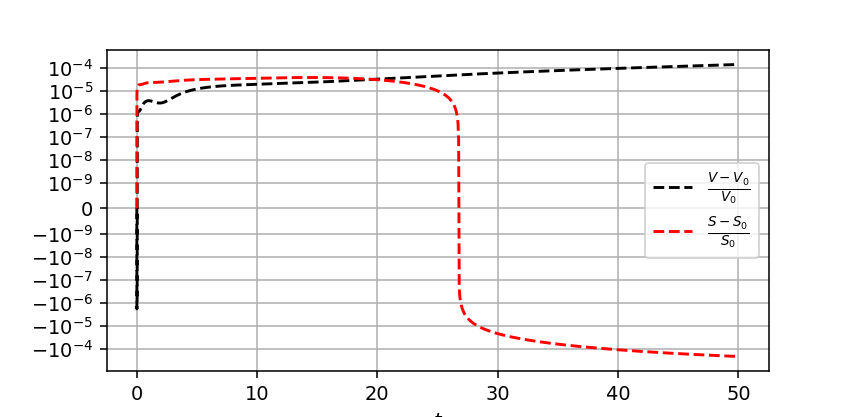

In [731]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_bdf.t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_bdf.t, Vol_ar/Vol0-1,'--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_bdf.t, Sqr_ar/Sqr0-1,'--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-9)

<IPython.core.display.Javascript object>


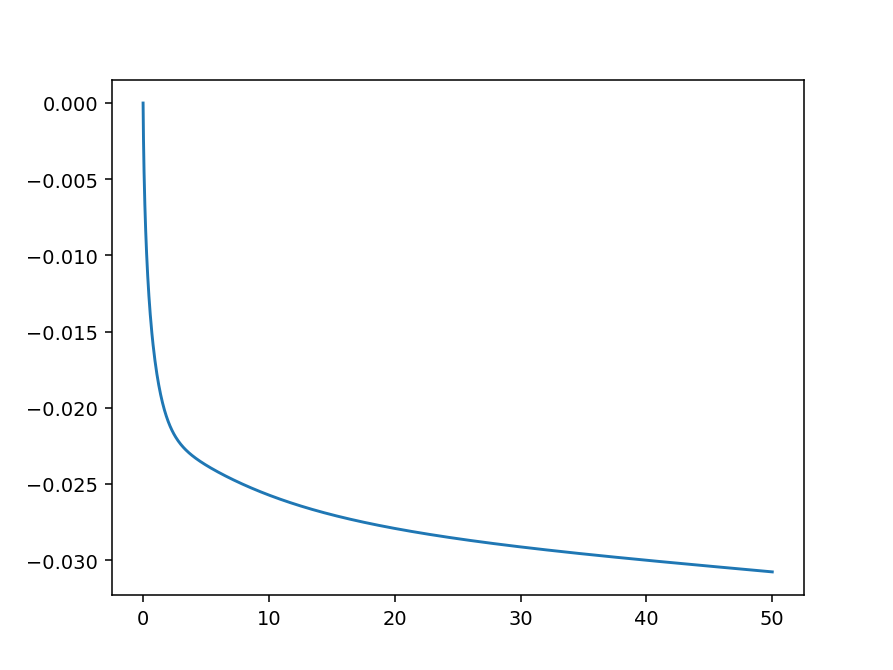

<IPython.core.display.Javascript object>


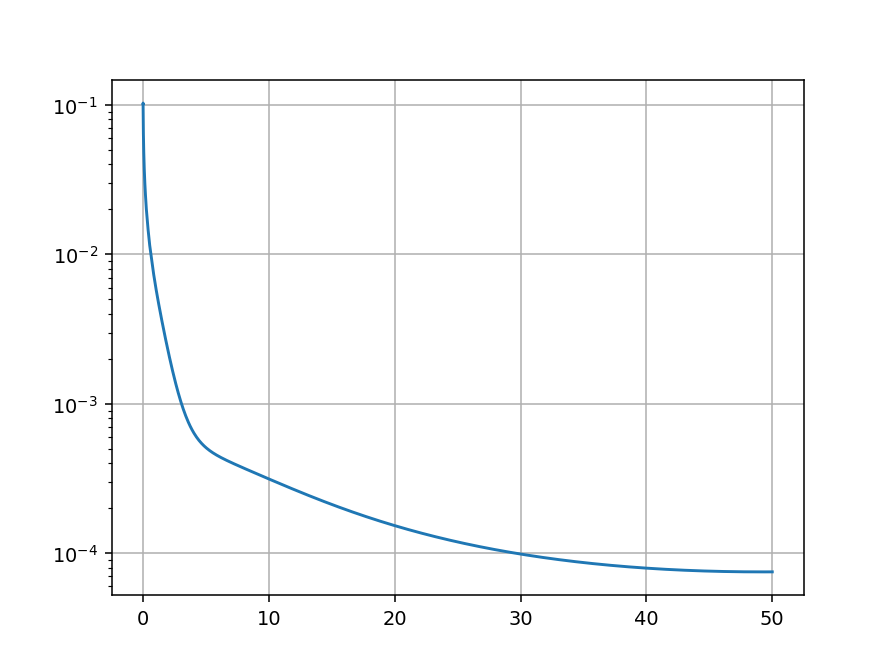

In [735]:
plt.figure()
j=2
plt.plot(sol_bdf.t, sol_bdf.y[j,:])

plt.figure()
plt.plot(sol_bdf.t[1:], np.abs((sol_bdf.y[j,1:]-sol_bdf.y[j,:-1])/(sol_bdf.t[1:]-sol_bdf.t[:-1])))
plt.yscale('log')
plt.grid()

<IPython.core.display.Javascript object>


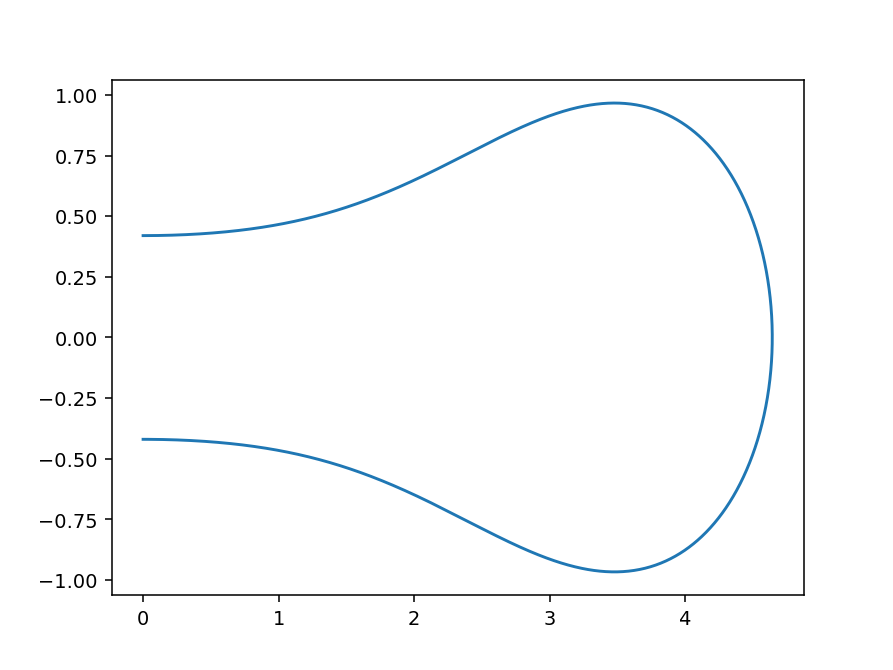

In [890]:
j=-1
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_bdf.y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_bdf.y[N//2:,j]


P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 

### find surface tension ###
sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)

plt.figure()
plt.plot(P,Z)

<IPython.core.display.Javascript object>


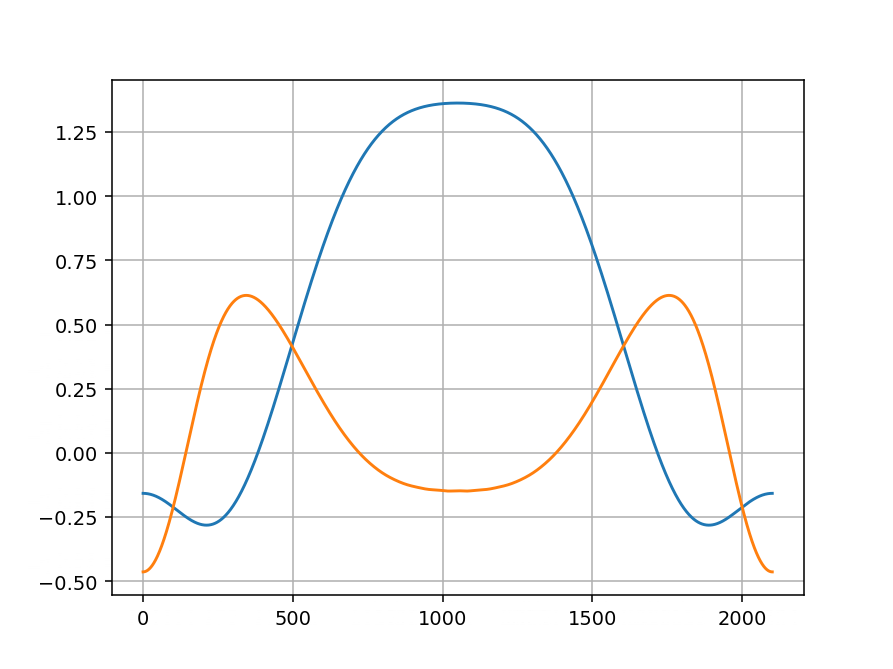

<IPython.core.display.Javascript object>


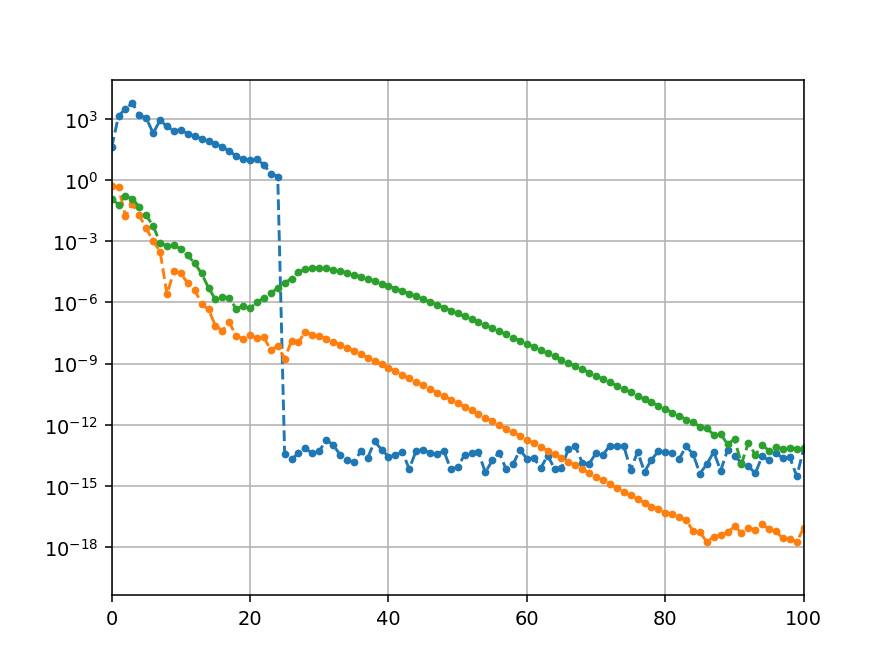

(0.0, 100.0)

In [891]:
%matplotlib notebook
plt.plot(H)
plt.plot(force)
plt.grid()

plt.figure()

plt.plot(np.abs(np.fft.rfft(get_ext_array(Z4), norm='forward'))[1::2], '.--')

plt.plot(np.abs(np.fft.rfft(get_ext_array(H), norm='forward'))[::2], '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(force), norm='forward'))[::2], '.--')

plt.yscale('log')
plt.grid()
plt.xlim(0,2*N)

In [892]:
jfun = nd.Jacobian(get_velo_fur_sym_1d, step=2e-5)

jac = jfun(sol_bdf.y[:,j])

<IPython.core.display.Javascript object>


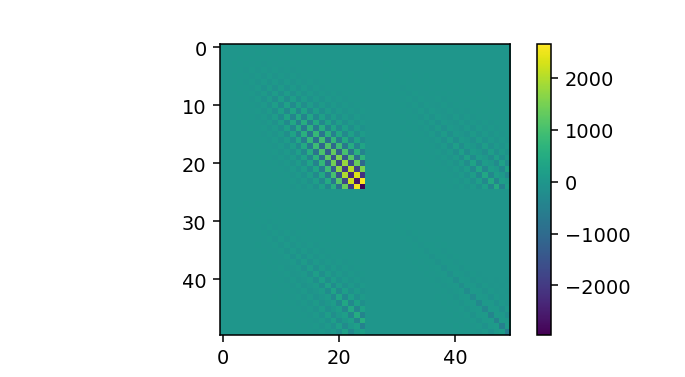

In [869]:
%matplotlib notebook
plt.figure()
plt.imshow(jac)
plt.colorbar()

In [893]:
jac[0,0]

-0.1056038847948912

In [895]:
w_full,vr_full =sc.linalg.eig(jac)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-5]
w_full_real = np.real(w_full_real)
print(w_full[np.abs(np.imag(w_full))>1e-5])
np.sort(w_full_real)

[-4.12560896e+01+8.82286378e-05j -4.12560896e+01-8.82286378e-05j
  5.36576459e-03+5.21764885e-03j  5.36576459e-03-5.21764885e-03j
  1.37697290e-03+3.11126223e-03j  1.37697290e-03-3.11126223e-03j
 -8.31726836e-04+3.48937413e-05j -8.31726836e-04-3.48937413e-05j
  1.45247070e-03+1.07115761e-03j  1.45247070e-03-1.07115761e-03j
  8.58148544e-04+5.77856593e-04j  8.58148544e-04-5.77856593e-04j
  6.11989183e-04+1.61384997e-04j  6.11989183e-04-1.61384997e-04j
  1.09463654e-03+3.00726227e-04j  1.09463654e-03-3.00726227e-04j
  1.51927796e-03+4.42201386e-04j  1.51927796e-03-4.42201386e-04j
  1.68545022e-03+1.20058020e-04j  1.68545022e-03-1.20058020e-04j]


array([-1.12212202e+04, -4.68833976e+03, -2.40961603e+03, -1.42300529e+03,
       -9.34275326e+02, -6.53919397e+02, -4.73261675e+02, -3.55427715e+02,
       -2.79642805e+02, -2.29425858e+02, -1.90277525e+02, -1.55350640e+02,
       -1.24588384e+02, -9.80944248e+01, -7.55890106e+01, -5.67489208e+01,
       -2.87877590e+01, -1.90379334e+01, -1.16951271e+01, -6.45098621e+00,
       -2.98516463e+00, -9.78123376e-01, -3.47458365e-01, -2.53146244e-01,
       -1.40133656e-01, -1.28538311e-05,  1.03131933e-04,  5.05050905e-04,
        1.69981786e-03,  1.93361670e-03])

In [894]:
w_full,vr_full =sc.linalg.eig(jac[0:N//2,0:N//2])
w_full_real = w_full[np.abs(np.imag(w_full))<1e-5]
w_full_real = np.real(w_full_real)
print(w_full[np.abs(np.imag(w_full))>1e-5])
np.sort(w_full_real)

[]


array([-1.10911554e+04, -4.38973300e+03, -2.03560677e+03, -1.01303870e+03,
       -5.18420062e+02, -2.65613822e+02, -1.33734926e+02, -6.53418189e+01,
       -3.10595358e+01, -1.59619000e+01, -1.19368792e+01, -9.39254670e+00,
       -5.85389223e+00, -4.26746354e+00, -3.17529192e+00, -2.06082758e+00,
       -1.45573230e+00, -9.93769072e-01, -6.32177039e-01, -3.96281464e-01,
       -2.19751150e-01, -1.04989850e-01, -4.18601598e-02, -1.27316778e-02,
        1.80895661e-03])

<IPython.core.display.Javascript object>


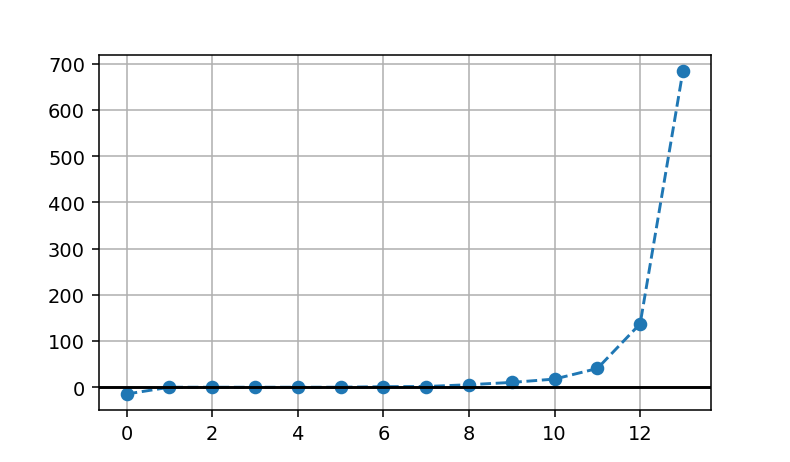

In [757]:
%matplotlib notebook
plt.figure()
plt.plot(-np.sort(w_full_real)[::-1],'o--')

plt.grid()
plt.axhline(0, color='k')
#plt.ylim(-1,10)
#plt.yscale('log')

In [880]:
%matplotlib inline
@interact_manual(m=(0,20))
def plot_eig_j(m):
    plt.figure()
    
    w_m = (np.sort(w_full_real)[::-1])[m]
    plt.title(f'w={w_m}')
    index_m = np.argmin(np.abs(w_full - w_m))
    print(w_full[index_m])
    v_m = np.real(vr_full[:, index_m])
    plt.plot(v_m[:N//2],'.--')
    plt.plot(v_m[N//2:],'.--')
    plt.grid()
#     v_tau = get_P_with0(v_m[:N-1])*P1_ar_j + v_m[N-1:]*Z1_ar_j
#     v_tau /= V_ar_j
    
#     v_n = -Z1_ar_j*get_P_with0(v_m[:N-1]) + P1_ar_j*v_m[N-1:]
#     v_n /= V_ar_j
#     plt.figure()
#     plt.plot(v_n, 'o--',label=r'$v_n$')
#     plt.plot(v_tau, 'o--',label=r'$v_\tau$')
#     plt.legend()

interactive(children=(IntSlider(value=10, description='m', max=20), Button(description='Run Interact', style=B…

## Symmetric dynamic normal

In [439]:
def get_velo_norm_fur_sym_1d(pz_sym):
    P_fur = np.zeros(N)
    P_fur[1::2]=pz_sym[:N//2]
    Z_fur = np.zeros(N)
    Z_fur[1::2]=pz_sym[N//2:]
    veloP, veloZ = get_velo_normal_fur(P_fur, Z_fur)
    return np.concatenate([veloP[1::2], veloZ[1::2]])

In [440]:
j_sym_fun = nd.Jacobian(get_velo_norm_fur_sym_1d, step=1e-5)

In [441]:
def get_normal_velo_normal_delta(P_fur, Z_fur, normal_delta_fur):
    delta_P_fur,delta_Z_fur  = get_normal_delta_PZ_fur(P_fur, Z_fur, normal_delta_fur)
    velo_norm_fur = get_velo_norm_fur(P_fur+delta_P_fur[:N], Z_fur+delta_Z_fur[:N])
    return velo_norm_fur

#### Prepare initial state

In [442]:
a=4.8

In [443]:
P_fur0 = P_fur*a/2
Z_fur0 = Z_fur.copy()
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
V_cal0

0.5108413648557738

In [444]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur0)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur0)
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 

### find surface tension ###
sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)

In [445]:
t_ = get_velo(P_fur0, Z_fur0)

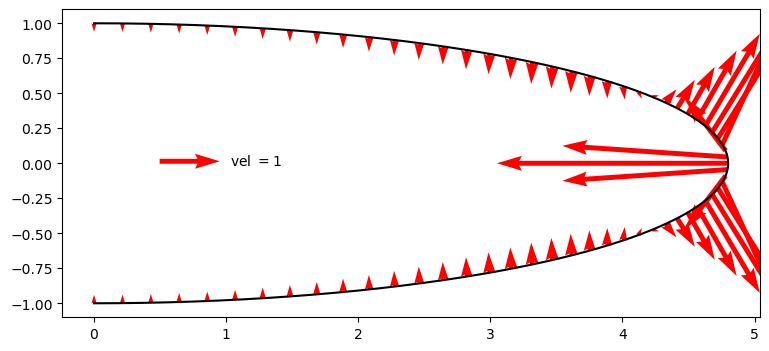

In [446]:
fig = plt.figure(figsize = (9,4))
ax = fig.add_subplot(1, 1, 1)

#ax.scatter(p0, z0,s=6)
#qk = ax.quiverkey(Q, 0.4, 0.5, 100, r'$v=100$', labelpos='E',
#                  coordinates='figure')
plt.plot(P, Z,'k')

Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], t_[0],t_[1], color='red')
qk = ax.quiverkey(Qnow, 0.3, 0.5, 1, r'vel $=1$', labelpos='E',
                  coordinates='figure')

#Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], 
#                 (force/V*(-Z1))[::N_int//n_int],(force/V*P1)[::N_int//n_int], color='blue')
#qk = ax.quiverkey(Qnow, 0.8, 0.8, 10, r'f $=10$', labelpos='E',
#                  coordinates='figure')

<IPython.core.display.Javascript object>


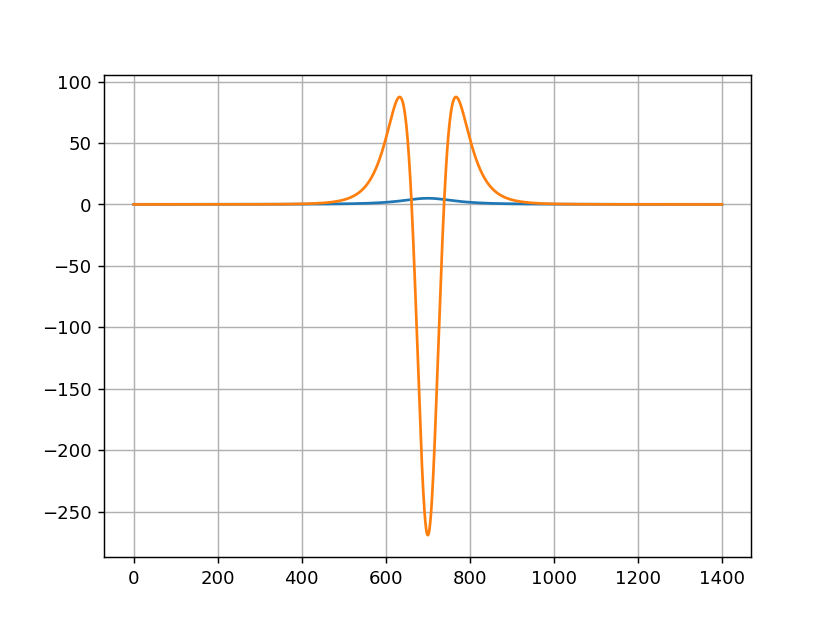

<IPython.core.display.Javascript object>


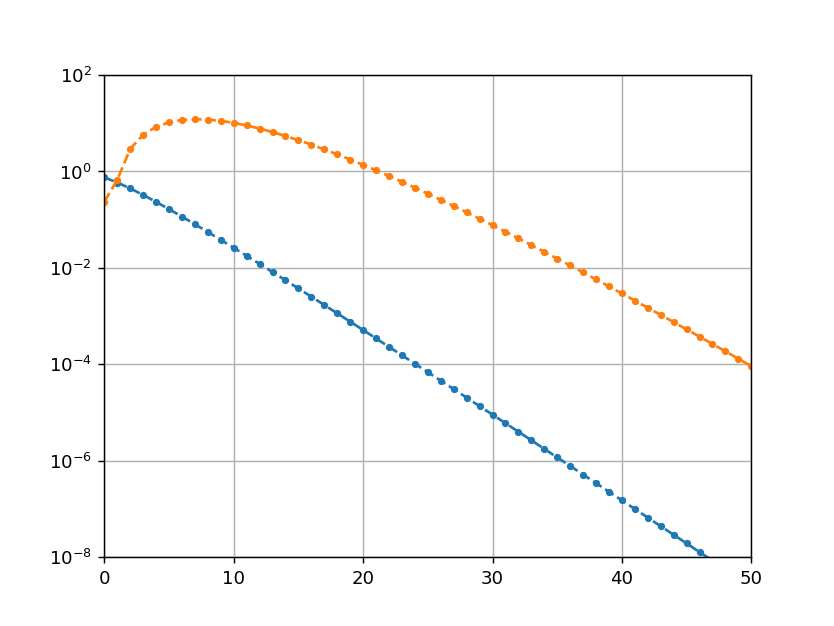

In [447]:
%matplotlib notebook
plt.plot(H)
plt.plot(force)
plt.grid()

plt.figure()
plt.plot(np.abs(np.fft.rfft(get_ext_array(H), norm='forward'))[::2], '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(force), norm='forward'))[::2], '.--')

plt.yscale('log')
plt.xlim(0,N)
plt.ylim(1e-8,1e2)

plt.grid()

<IPython.core.display.Javascript object>


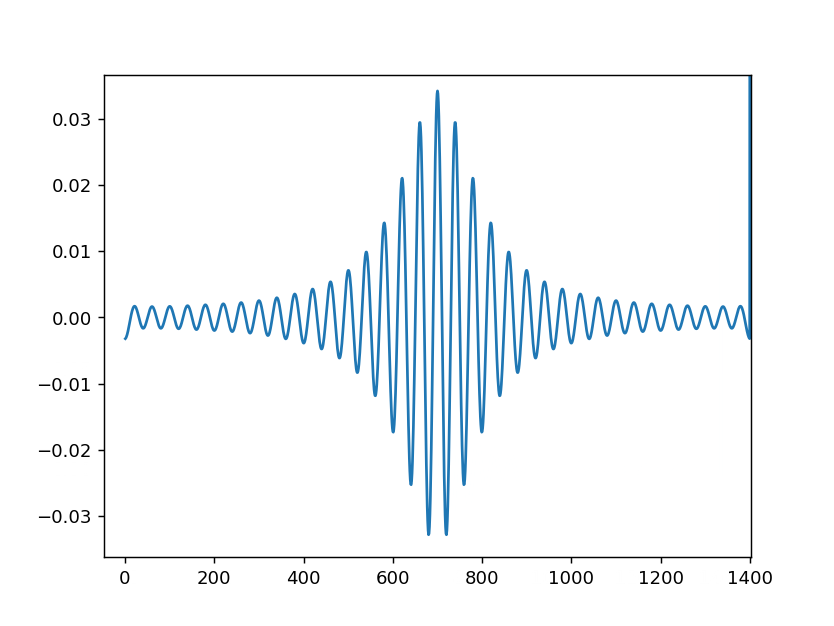

In [456]:
V_P_fur, V_Z_fur = get_velo_fur_full(P_fur0, Z_fur0)
der_oper = 1j*np.pi*np.arange(V_P_fur.shape[0])


V_rho = np.fft.irfft(V_P_fur*(-1j), norm='forward', n=2*N_int)[:N_int+1]
V_rho1 = np.fft.irfft(V_P_fur*(-1j)*der_oper, norm='forward', n=2*N_int)[:N_int+1]

V_z = np.fft.irfft(V_Z_fur, norm='forward', n=2*N_int)[:N_int+1]
V_z1 = np.fft.irfft(V_Z_fur*der_oper, norm='forward', n=2*N_int)[:N_int+1]

div_V = P1/V**2*V_rho1 + Z1/V**2*V_z1+V_rho/P


plt.figure()
plt.plot(div_V)

In [448]:
jac = j_sym_fun(np.concatenate([P_fur0[1::2], Z_fur0[1::2]]))

In [452]:
w_full,vr_full =sc.linalg.eig(jac)
print(w_full.min())

(-12365.908927502765+0j)


In [453]:
np.sort((w_full))[::-1][:5]

array([12.49088892+0.j        ,  3.27706224+1.19982825j,
        3.27706224-1.19982825j,  0.74738577+0.91026494j,
        0.74738577-0.91026494j])

#### Intagrate bdf

In [457]:
t_max = 300

In [479]:
atol = 5e-6
rtol = atol/10

In [480]:
sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_norm_fur_sym_1d(pz), (0., t_max), np.concatenate([P_fur0[1::2], Z_fur0[1::2]]), 
                                   method='BDF', jac=lambda t,pz:j_sym_fun(pz),atol=atol,rtol=rtol);

In [481]:
sol_bdf

  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  5.473e-06 ...  2.687e+02  3.000e+02]
        y: [[ 2.400e+00  2.400e+00 ...  2.331e+00  2.331e+00]
            [ 0.000e+00 -1.597e-07 ...  5.296e-02  5.299e-02]
            ...
            [ 0.000e+00  1.330e-08 ...  1.317e-07  7.605e-08]
            [ 0.000e+00 -9.568e-09 ...  7.788e-08  5.172e-08]]
      sol: None
 t_events: None
 y_events: None
     nfev: 313
     njev: 25
      nlu: 51

In [482]:
np.save(f'dyn_bdf_a={a}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', [sol_bdf.t, sol_bdf.y])

In [483]:
sol_t = sol_bdf.t
sol_y = sol_bdf.y

#### Intagrate radau

In [ ]:
sol_rad = sc.integrate.solve_ivp(lambda t,pz: get_velo_norm_fur_sym_1d(pz), (0., t_max), np.concatenate([P_fur0[1::2], Z_fur0[1::2]]), 
                                       method='Radau', jac=lambda t,pz:j_sym_fun(pz),atol=atol,rtol=rtol);

In [224]:
t_max = 100

In [225]:
a_list = [1e-5, 2e-5,5e-5,1e-4,2e-4,5e-4,1e-3]

In [237]:
for atol in tqdm(a_list):
    rtol = atol/10

    sol_rad = sc.integrate.solve_ivp(lambda t,pz: get_velo_norm_fur_sym_1d(pz), (0., t_max), np.concatenate([P_fur0[1::2], Z_fur0[1::2]]), 
                                       method='Radau', jac=lambda t,pz:j_sym_fun(pz),atol=atol,rtol=rtol);

    np.save(f'dyn_rad_a={a}_to_t={t_max}_N={N}_n_int={n_int}_RAD_atol={atol:.2e}.npy', {'t':sol_rad.t,'y':sol_rad.y})

  0%|          | 0/7 [00:00<?, ?it/s]

ValueError: array must not contain infs or NaNs

In [242]:
sol_t = sol_rad.t
sol_y = sol_rad.y

0.001

In [241]:
np.max(sol_rad.y)

2.0000619106837494

#### Integrate rk

In [309]:
max_step = 1e-4
t_max = 2

In [244]:
sol_rk = sc.integrate.solve_ivp(lambda t,pz: get_velo_norm_fur_sym_1d(pz), (0., t_max), np.concatenate([P_fur0[1::2], Z_fur0[1::2]]), 
                                   method='RK45', max_step=max_step);

In [245]:
sol_rk

  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  1.000e-04 ...  2.000e+00  2.000e+00]
        y: [[ 2.000e+00  2.000e+00 ...  1.985e+00  1.985e+00]
            [ 0.000e+00 -1.272e-06 ...  1.735e-02  1.735e-02]
            ...
            [ 0.000e+00  1.583e-06 ... -9.784e-07 -9.784e-07]
            [ 0.000e+00 -1.110e-06 ... -2.181e-07 -2.181e-07]]
      sol: None
 t_events: None
 y_events: None
     nfev: 120008
     njev: 0
      nlu: 0

In [246]:
sol_t = sol_rk.t
sol_y = sol_rk.y

In [310]:
np.save(f'dyn_rk_a={a}_to_t={t_max}_N={N}_n_int={n_int}_max_step={max_step:.2e}.npy', {'t':sol_rk.t,'y':sol_rk.y})

#### Continue integrate

In [ ]:
t_start = sol_t[-1]
pz_start = sol_y[:,-1]


t_end = 80

sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_norm_fur_sym_1d(pz), 
                                 (t_start, t_end), pz_start, 
                                   method='BDF', jac=lambda t,pz:j_sym_fun(pz),atol=1e-4, rtol=1e-4, max_step=5e-3);

## State analys

<IPython.core.display.Javascript object>


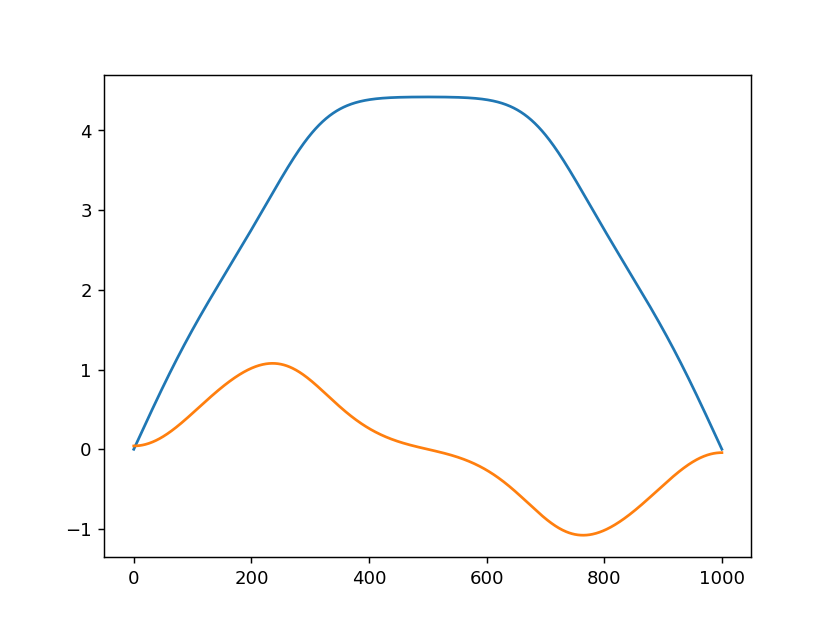

<IPython.core.display.Javascript object>


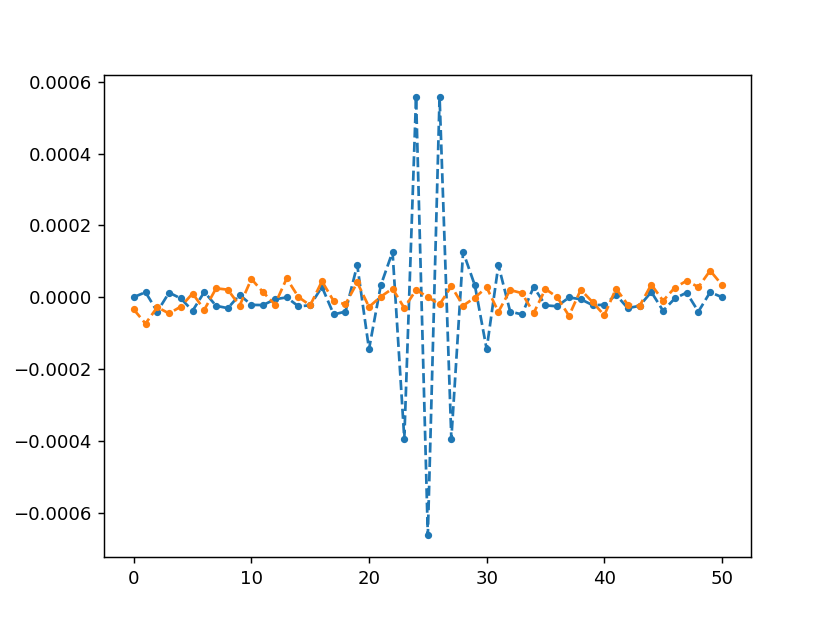

<IPython.core.display.Javascript object>


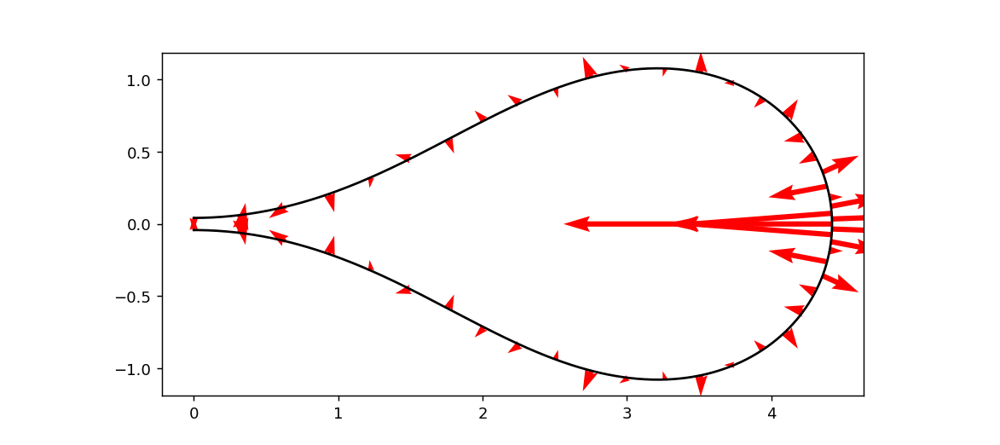

9.585402301865344e-06

In [395]:
t_j = t_max
j = np.argmin(np.abs(sol_t-t_j))
#j=-1
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_y[N//2:,j]


P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
P[0]=0;P[-1]=0;

Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 

### find surface tension ###
sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)



t_ = get_velo(P_fur_j, Z_fur_j)

plt.figure()
plt.plot(P)
plt.plot(Z)


plt.figure()
plt.plot(t_[0],'.--')
plt.plot(t_[1],'.--')

fig = plt.figure(figsize = (9,4))
ax = fig.add_subplot(1, 1, 1)

#ax.scatter(p0, z0,s=6)
#qk = ax.quiverkey(Q, 0.4, 0.5, 100, r'$v=100$', labelpos='E',
#                  coordinates='figure')
plt.plot(P, Z,'k')
plt.axis('scaled')
Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], t_[0],t_[1], color='red')
#qk = ax.quiverkey(Qnow, 0.3, 0.5, 1, r'vel $=1$', labelpos='E',
#                  coordinates='figure')
#Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], 
#                 (force/V*(-Z1))[::N_int//n_int],(force/V*P1)[::N_int//n_int], color='blue')
#qk = ax.quiverkey(Qnow, 0.8, 0.8, 10, r'f $=10$', labelpos='E',
#                  coordinates='figure')

np.abs(get_velo_norm_fur_sym_1d(sol_y[:,j])).max()

In [396]:
V = np.sqrt(P1**2+Z1**2)
H1 = H1_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
H2 = H2_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
H2[0] = H1[0];H2[-1] = H1[-1]


K = H1*H2
H = H1+H2

laplH1 = laplH1_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
laplH1[0] = 2*(-P1[0]**2*Z4[0]+4*P1[0]*P3[0]*Z2[0]+3*Z2[0]**3)/np.abs(P1[0])**5/P1[0]
laplH1[-1] = 2*(-P1[-1]**2*Z4[-1]+4*P1[-1]*P3[-1]*Z2[-1]+3*Z2[-1]**3)/np.abs(P1[-1])**5/P1[-1]

laplH2 = laplH2_wol_lam(P,P1,P2,P3,P4, Z,Z1,Z2,Z3,Z4)
laplH2[0]=laplH1[0]/3
laplH2[-1]=laplH1[-1]/3

laplH = laplH1+laplH2

force =  H**3/2 - 2*H*K + laplH

In [397]:
H1_x =         (-3*(P2*Z1 - P1*Z2)*(2*P1*P2 + 2*Z1*Z2))/(2.*(P1**2 + Z1**2)**2.5) + (P3*Z1 - P1*Z3)/(P1**2 + Z1**2)**1.5


In [398]:
H1_xx =         ((15*(P2*Z1 - P1*Z2)*(2*P1*P2 + 2*Z1*Z2)**2)/
        (4.*(P1**2 + Z1**2)**3.5) - 
       (3*(2*P1*P2 + 2*Z1*Z2)*(P3*Z1 - P1*Z3))/
        (P1**2 + Z1**2)**2.5 - 
       (3*(P2*Z1 - P1*Z2)*
          (2*P2**2 + 2*P1*P3 + 2*Z2**2 + 2*Z1*Z3))/
        (2.*(P1**2 + Z1**2)**2.5) + 
       (P4*Z1 + P3*Z2 - P2*Z3 - P1*Z4)/(P1**2 + Z1**2)**1.5)

<IPython.core.display.Javascript object>


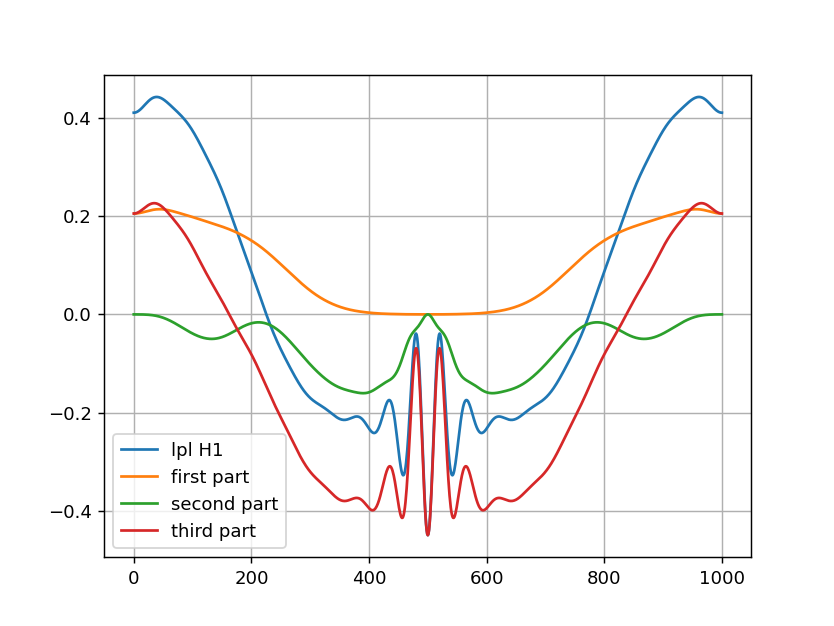

In [399]:
plt.figure()
#plt.plot(V,label='V')
#plt.plot(H1,label='H1')

#plt.plot(K,label='K')
plt.plot(laplH1,label='lpl H1')

#plt.plot(H1_x,label='d_x H1')
#plt.plot(H1_xx/V**2,label='d_xx H1')

plt.plot(P1/V**2*H1_x/P,label='first part')

plt.plot(H1_x*(P2*P1+Z2*Z1)/V**4,label='second part')

plt.plot(H1_xx/V**2,label='third part')

#plt.plot(H1_x/V,label='second part')


plt.grid()
#plt.plot(H**3/2 - 2*H*K)
plt.legend()

<IPython.core.display.Javascript object>


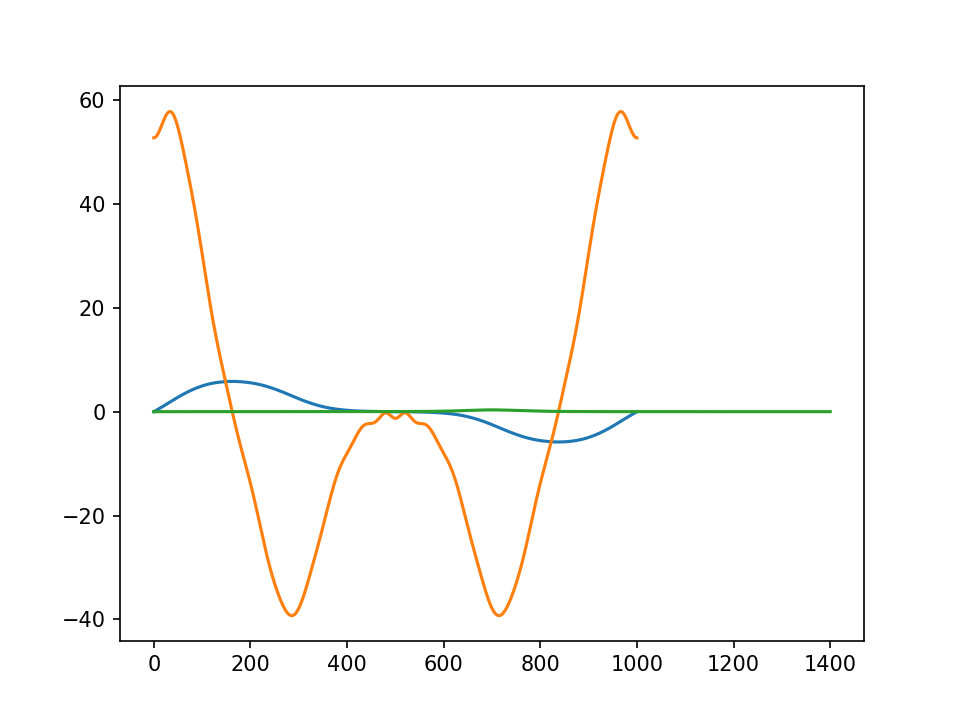

ValueError: operands could not be broadcast together with shapes (1001,) (1401,) 

In [490]:
plt.figure()
#plt.plot(V,label='V')
#plt.plot(H1,label='H1')

#plt.plot(K,label='K')

plt.plot(H1_x,label='d_x H1')
plt.plot(H1_xx,label='d_xx H1')
plt.plot(1/V**2,label='1/V^2')



plt.plot(H1_xx/V**2,label='third part')

#plt.plot(H1_x/V,label='second part')


plt.grid()
#plt.plot(H**3/2 - 2*H*K)
plt.legend()

<IPython.core.display.Javascript object>


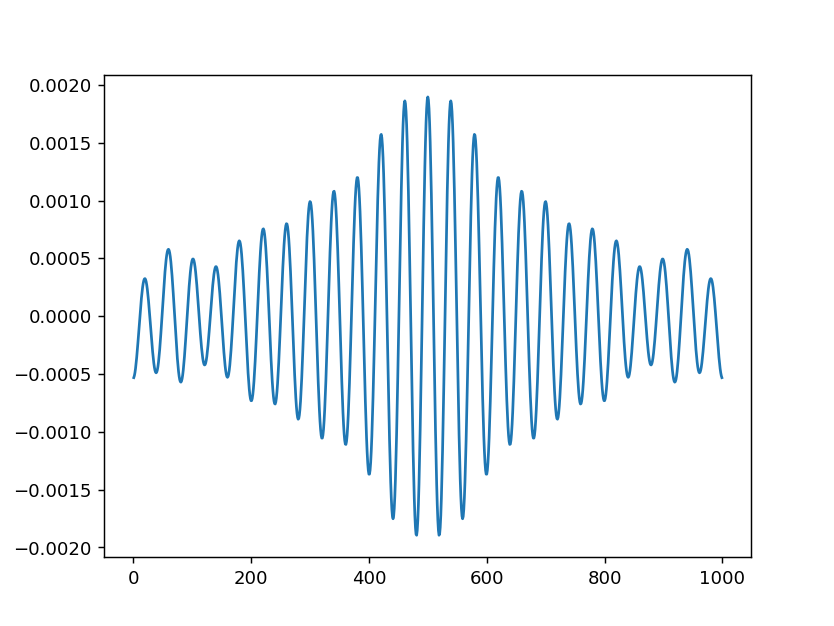

In [401]:
V_P_fur, V_Z_fur = get_velo_fur_full(P_fur_j, Z_fur_j)
der_oper = 1j*np.pi*np.arange(V_P_fur.shape[0])


V_rho = np.fft.irfft(V_P_fur*(-1j), norm='forward', n=2*N_int)[:N_int+1]
V_rho1 = np.fft.irfft(V_P_fur*(-1j)*der_oper, norm='forward', n=2*N_int)[:N_int+1]

V_z = np.fft.irfft(V_Z_fur, norm='forward', n=2*N_int)[:N_int+1]
V_z1 = np.fft.irfft(V_Z_fur*der_oper, norm='forward', n=2*N_int)[:N_int+1]

div_V = P1/V**2*V_rho1 + Z1/V**2*V_z1+V_rho/P


plt.figure()
plt.plot(div_V)

<IPython.core.display.Javascript object>


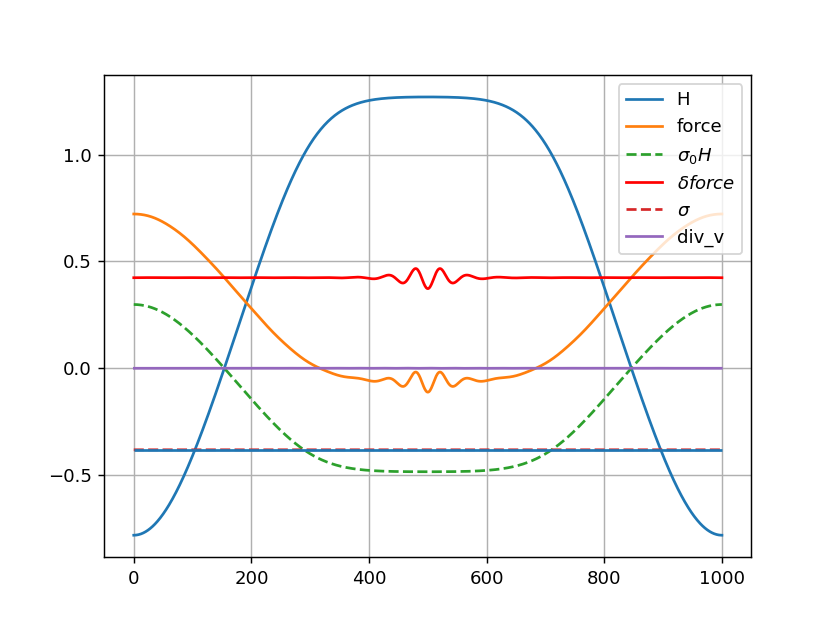

In [361]:
%matplotlib notebook
plt.figure()
plt.plot(H, label='H')
plt.plot(force, label='force')
plt.plot(sigma_fur[0]*H,'--', label=r'$\sigma_0 H$')
plt.plot(force-sigma_fur[0]*H,'-', color='red', label=r'$\delta force$')
sigma_ = np.fft.irfft(sigma_fur, norm='forward',n=2*N_int+1)[:N_int+1]
plt.plot(sigma_,'--', label=r'$\sigma$')
plt.hlines(sigma_fur[0],0,N_int)

plt.plot(div_V, label='div_v')
plt.legend()
plt.grid()

<IPython.core.display.Javascript object>


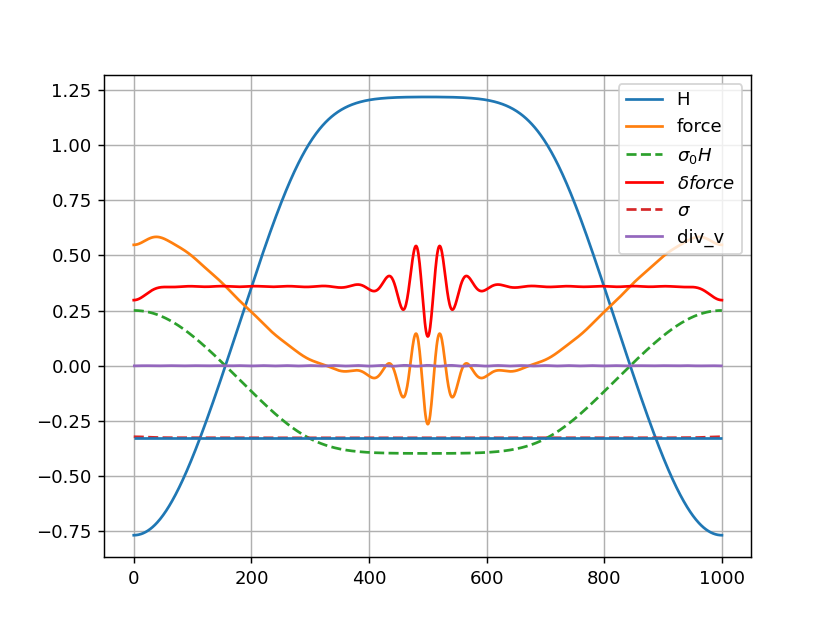

In [402]:
%matplotlib notebook
plt.figure()
plt.plot(H, label='H')
plt.plot(force, label='force')
plt.plot(sigma_fur[0]*H,'--', label=r'$\sigma_0 H$')
plt.plot(force-sigma_fur[0]*H,'-', color='red', label=r'$\delta force$')
sigma_ = np.fft.irfft(sigma_fur, norm='forward',n=2*N_int+1)[:N_int+1]
plt.plot(sigma_,'--', label=r'$\sigma$')
plt.hlines(sigma_fur[0],0,N_int)

plt.plot(div_V, label='div_v')
plt.legend()
plt.grid()

<IPython.core.display.Javascript object>


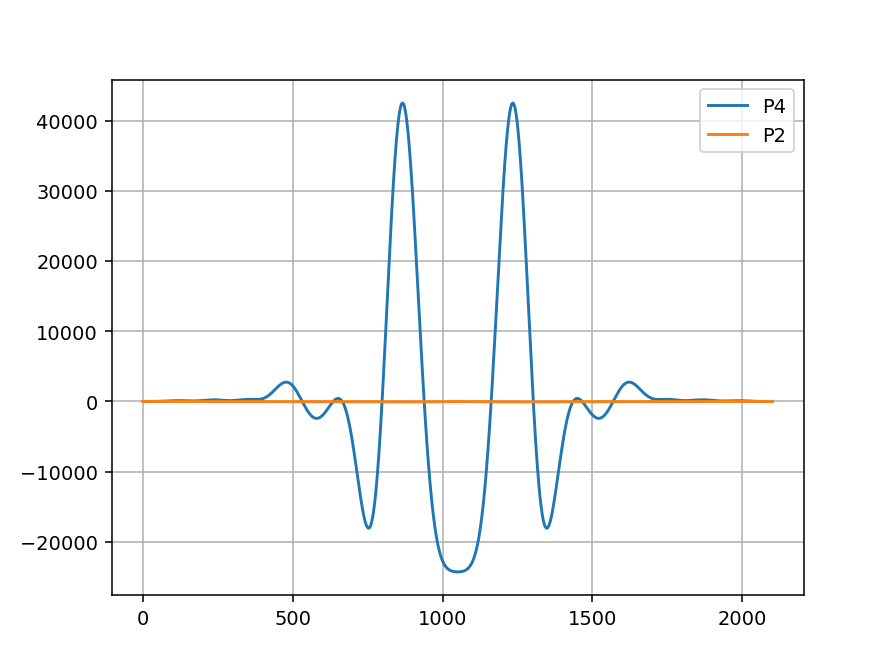

In [781]:
%matplotlib notebook
plt.figure()
plt.plot(P4, label='P4')
plt.plot(P2, label='P2')

plt.legend()
plt.grid()

In [403]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_delta_n(k):
    normal_delta_fur = np.zeros(N)
    normal_delta_fur[k] = 1/50
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur_j, Z_fur_j, normal_delta_fur)
    plt.figure()

    plt.plot(P,Z,'--')
    plt.plot(P+normal_delta_P, Z+normal_delta_Z)
    plt.axis('scaled')

interactive(children=(IntSlider(value=14, description='k', max=29), Output()), _dom_classes=('widget-interact'…

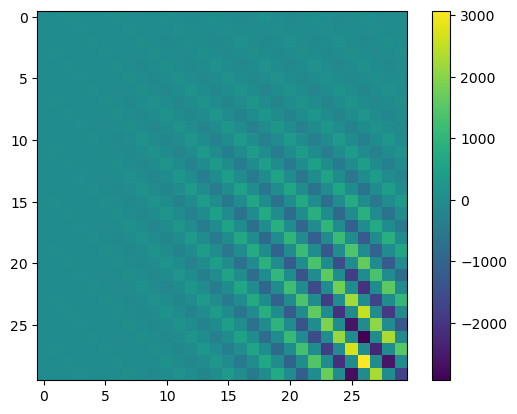

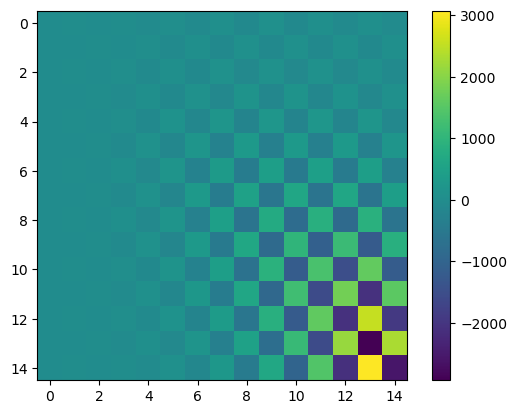

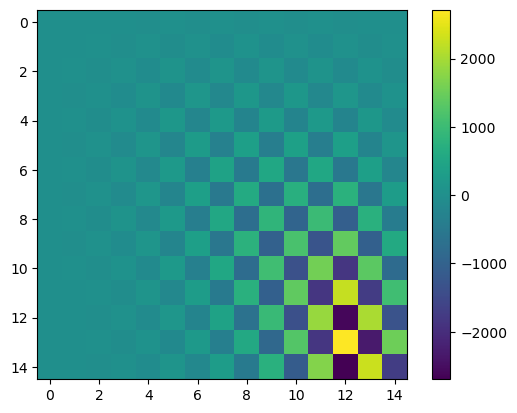

In [404]:
jac = jac_norm_fun(np.zeros(N))

plt.figure()
plt.imshow(jac)
plt.colorbar()
plt.figure()
plt.imshow(jac[::2,::2])
plt.colorbar()
plt.figure()
plt.imshow(jac[1::2,1::2])
plt.colorbar()

In [405]:
w_full,vr_full =sc.linalg.eig(jac)
np.sort(w_full)[::-1]

array([ 2.82280787e-05+0.j,  2.30356606e-06+0.j, -1.55629605e-06+0.j,
       -5.89636691e-04+0.j, -1.43323318e-02+0.j, -4.94778239e-01+0.j,
       -9.06466912e-01+0.j, -1.72559401e+00+0.j, -2.81298357e+00+0.j,
       -4.20387369e+00+0.j, -6.06672597e+00+0.j, -8.33323258e+00+0.j,
       -1.10065980e+01+0.j, -1.45537093e+01+0.j, -1.79792539e+01+0.j,
       -2.39146727e+01+0.j, -2.74893954e+01+0.j, -3.61279416e+01+0.j,
       -3.97198261e+01+0.j, -5.19281213e+01+0.j, -5.28294398e+01+0.j,
       -7.10376878e+01+0.j, -1.23322526e+02+0.j, -1.37264459e+02+0.j,
       -4.26628220e+02+0.j, -4.43339150e+02+0.j, -1.84908603e+03+0.j,
       -1.85983981e+03+0.j, -1.01181862e+04+0.j, -1.01971905e+04+0.j])

In [406]:
w_sym,vr_sym =sc.linalg.eig(jac[::2,::2])
np.sort(w_sym)[::-1]

array([ 2.82280792e-05+0.j, -1.55629686e-06+0.j, -1.43323318e-02+0.j,
       -4.94778239e-01+0.j, -1.72559401e+00+0.j, -4.20387369e+00+0.j,
       -8.33323258e+00+0.j, -1.45537093e+01+0.j, -2.39146727e+01+0.j,
       -3.61279416e+01+0.j, -5.28294398e+01+0.j, -1.23322526e+02+0.j,
       -4.26628220e+02+0.j, -1.84908603e+03+0.j, -1.01971905e+04+0.j])

In [407]:
w_asym,vr_asym =sc.linalg.eig(jac[1::2,1::2])
np.sort(w_asym)[::-1]

array([ 2.30356618e-06+0.j, -5.89636691e-04+0.j, -9.06466912e-01+0.j,
       -2.81298357e+00+0.j, -6.06672597e+00+0.j, -1.10065980e+01+0.j,
       -1.79792539e+01+0.j, -2.74893954e+01+0.j, -3.97198261e+01+0.j,
       -5.19281213e+01+0.j, -7.10376878e+01+0.j, -1.37264459e+02+0.j,
       -4.43339150e+02+0.j, -1.85983981e+03+0.j, -1.01181862e+04+0.j])

In [367]:
@interact(m=(0,6))
def plot_m_pert_sym(m):
    w_m = np.sort(w_sym)[::-1][m]
    index_m = np.argmin(np.abs(w_sym - w_m))
    v_m = np.real(vr_sym[:, index_m])
    plt.figure()
    plt.plot(v_m, '.--',label=f'w={w_m.real:.2e}')
    
    plt.legend(loc='upper right')
    plt.grid()
    
    delta_norm_fur = np.zeros(N)
    delta_norm_fur[::2]=v_m/50
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur_j, Z_fur_j, delta_norm_fur)
    plt.figure()
    plt.plot(P,Z,'--')
    plt.plot(P+normal_delta_P, Z+normal_delta_Z)

interactive(children=(IntSlider(value=3, description='m', max=6), Output()), _dom_classes=('widget-interact',)…

In [408]:
@interact(m=(0,6))
def plot_m_pert_asym(m):
    w_m = np.sort(w_asym)[::-1][m]
    index_m = np.argmin(np.abs(w_asym - w_m))
    v_m = np.real(vr_asym[:, index_m])
    plt.figure()
    plt.plot(v_m, '.--',label=f'w={w_m.real:.2e}')
    
    plt.legend(loc='upper right')
    plt.grid()
    
    delta_norm_fur = np.zeros(N)
    delta_norm_fur[1::2]=v_m/50
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur_j, Z_fur_j, delta_norm_fur)
    plt.figure()
    plt.plot(P,Z,'--')
    plt.plot(P+normal_delta_P, Z+normal_delta_Z)

interactive(children=(IntSlider(value=3, description='m', max=6), Output()), _dom_classes=('widget-interact',)…

## Dynamic analys

In [94]:
sol = np.load(f'dyn_bdf_a={a}_to_t={t_max}_N={N}_n_int={n_int}.npy', allow_pickle=True)
sol_t = sol[0]
sol_y = sol[1]

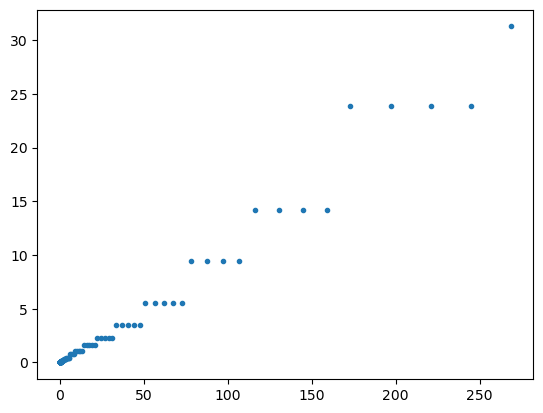

In [484]:
plt.figure()
plt.plot(sol_t[:-1], sol_t[1:]-sol_t[:-1],'.')

<IPython.core.display.Javascript object>


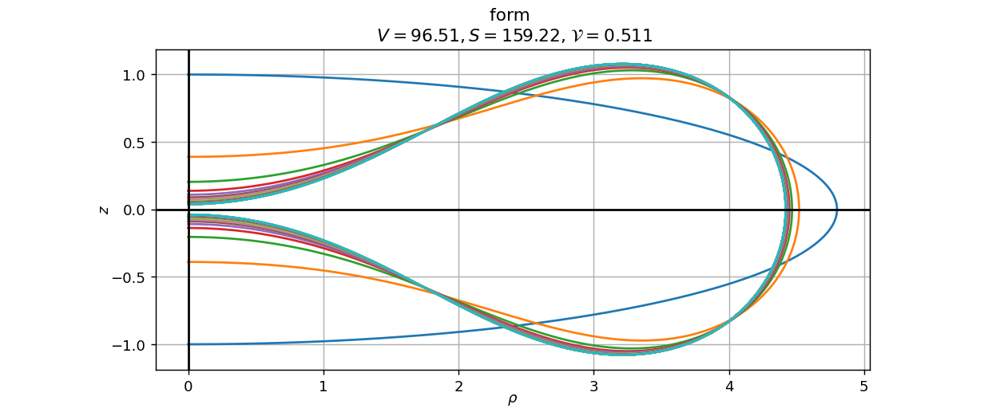

Text(0.5, 1.0, 'form \n $V=96.51, S=159.22$, $\\mathcal{V}=$$0.511$')

In [485]:
%matplotlib notebook
plt.figure(figsize=(a*2,4))
for t_j in np.linspace(0,t_max,30):#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_y[N//2:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1.5, label=f't={sol_t[j]:.2f}')


    
    
plt.axis('scaled')
#plt.legend(ncol=2)
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
plt.grid()
plt.title(fr'form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


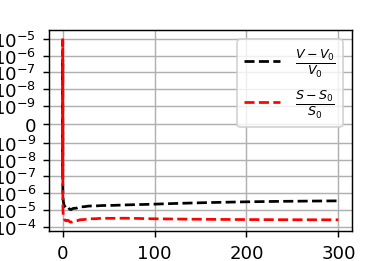

In [486]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_y[N//2:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_t, Vol_ar/Vol0-1,'--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_t, Sqr_ar/Sqr0-1,'--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-9)

In [487]:
%matplotlib inline
@interact(k=(0,N//2-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1,2, figsize=(8,3))
    axs[0].plot(sol_t, sol_y[k,:])
    axs[0].plot(sol_t, sol_y[k+N//2,:])
    axs[0].grid()
    axs[0].legend(['P_k','Z_k'])
    axs[1].plot(sol_t[1:], np.abs((sol_y[k,1:]-sol_y[k,:-1])/(sol_t[1:]-sol_t[:-1])))
    axs[1].plot(sol_t[1:], np.abs((sol_y[k+N//2,1:]-sol_y[k+N//2,:-1])/(sol_t[1:]-sol_t[:-1])))
    axs[1].set_yscale('log')
    axs[1].set_ylim(1e-11,1e0)
    axs[1].set_ylabel(r'$|\partial_t|$')
    axs[1].grid()

interactive(children=(IntSlider(value=12, description='k', max=24), Output()), _dom_classes=('widget-interact'…

In [254]:
%matplotlib inline
@interact(k=(0,N//2-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1,2, figsize=(8,3))
    axs[0].plot(sol_t, sol_y[k,:])
    axs[0].plot(sol_t, sol_y[k+N//2,:])
    axs[0].grid()
    axs[0].legend(['P_k','Z_k'])
    axs[1].plot(sol_t[1:], np.abs((sol_y[k,1:]-sol_y[k,:-1])/(sol_t[1:]-sol_t[:-1])))
    axs[1].plot(sol_t[1:], np.abs((sol_y[k+N//2,1:]-sol_y[k+N//2,:-1])/(sol_t[1:]-sol_t[:-1])))
    axs[1].set_yscale('log')
    axs[1].set_ylabel(r'$|\partial_t|$')
    axs[1].grid()
    axs[0].set_xscale('log')

interactive(children=(IntSlider(value=7, description='k', max=14), Output()), _dom_classes=('widget-interact',…

### $\sigma(t)$

In [470]:
sigma_arr =[]
#t_range = np.linspace(0,t_max,50)

t_range = sol_t[::max(1,len(sol_t)//50)]

for t_j in tqdm(t_range):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_y[N//2:,j]

    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
    V = np.sqrt(P1**2+Z1**2)
    
    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    ### find surface tension ###
    sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)
    sigma_arr.append(sigma_fur[:5])
sigma_arr=np.array(sigma_arr)

  0%|          | 0/95 [00:00<?, ?it/s]

Text(0.5, 1.0, '$\\mathcal{V}=$$0.511$')

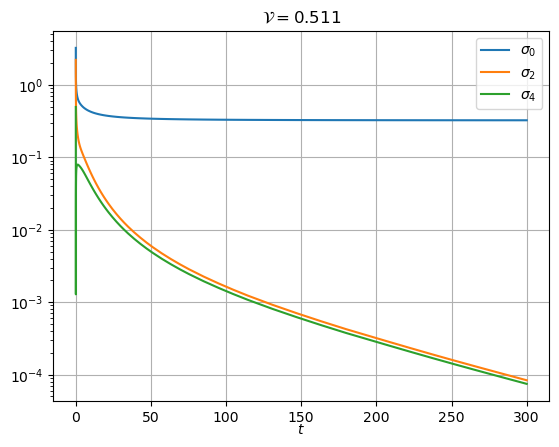

In [471]:
plt.figure()
plt.plot(t_range, np.abs(sigma_arr[:,0]), label=r'$\sigma_0$')
plt.plot(t_range,np.abs(sigma_arr[:,2]), label=r'$\sigma_2$')
plt.plot(t_range,np.abs(sigma_arr[:,4]), label=r'$\sigma_4$')

plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.title(r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

Text(0.5, 1.0, '$\\mathcal{V}=$$0.511$')

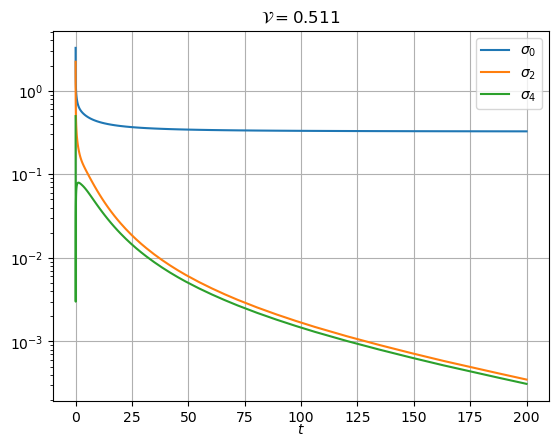

In [388]:
plt.figure()
plt.plot(t_range, np.abs(sigma_arr[:,0]), label=r'$\sigma_0$')
plt.plot(t_range,np.abs(sigma_arr[:,2]), label=r'$\sigma_2$')
plt.plot(t_range,np.abs(sigma_arr[:,4]), label=r'$\sigma_4$')

plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.title(r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

Text(0.5, 1.0, '$\\mathcal{V}=$$0.537$')

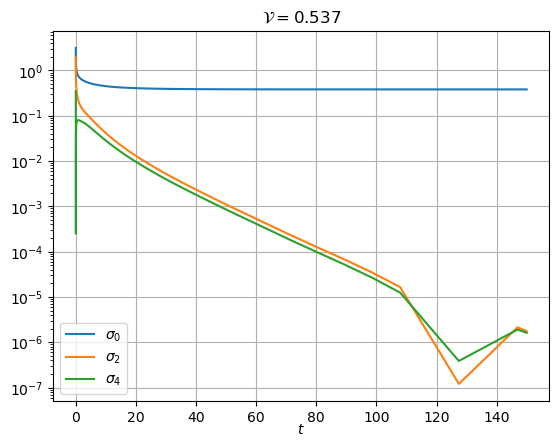

In [341]:
plt.figure()
plt.plot(t_range, np.abs(sigma_arr[:,0]), label=r'$\sigma_0$')
plt.plot(t_range,np.abs(sigma_arr[:,2]), label=r'$\sigma_2$')
plt.plot(t_range,np.abs(sigma_arr[:,4]), label=r'$\sigma_4$')

plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.title(r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

### Neck

In [472]:
neck_arr =[]
#t_range = np.linspace(0,t_max,50)

t_range = sol_t

for t_j in tqdm(t_range):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_y[N//2:,j]

    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
    V = np.sqrt(P1**2+Z1**2)

    neck_arr.append(Z[0])
neck_arr=np.array(neck_arr)

  0%|          | 0/95 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


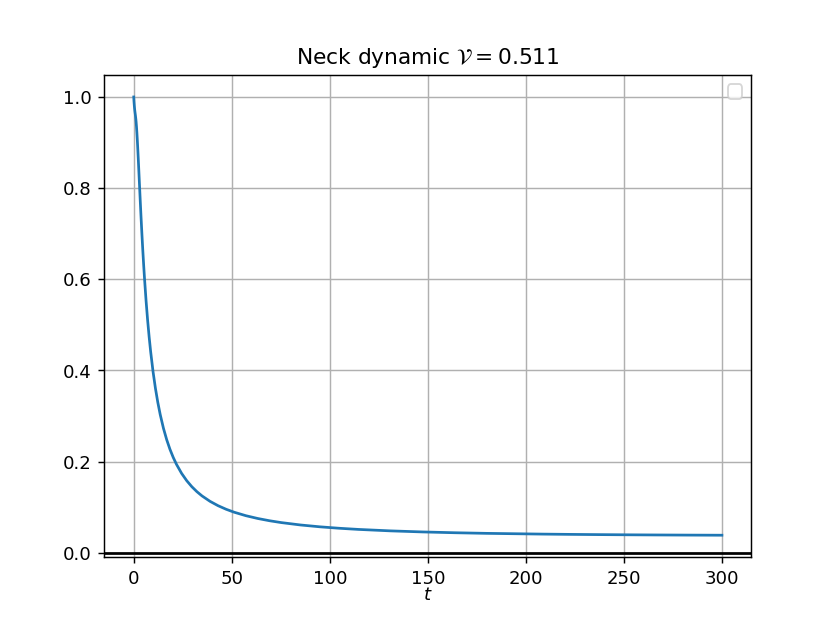

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Text(0.5, 1.0, 'Neck dynamic $\\mathcal{V}=$$0.511$')

In [473]:
%matplotlib notebook
plt.figure()
plt.plot(t_range, neck_arr)

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
plt.axhline(0,color='k')
#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.title(r'Neck dynamic $\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


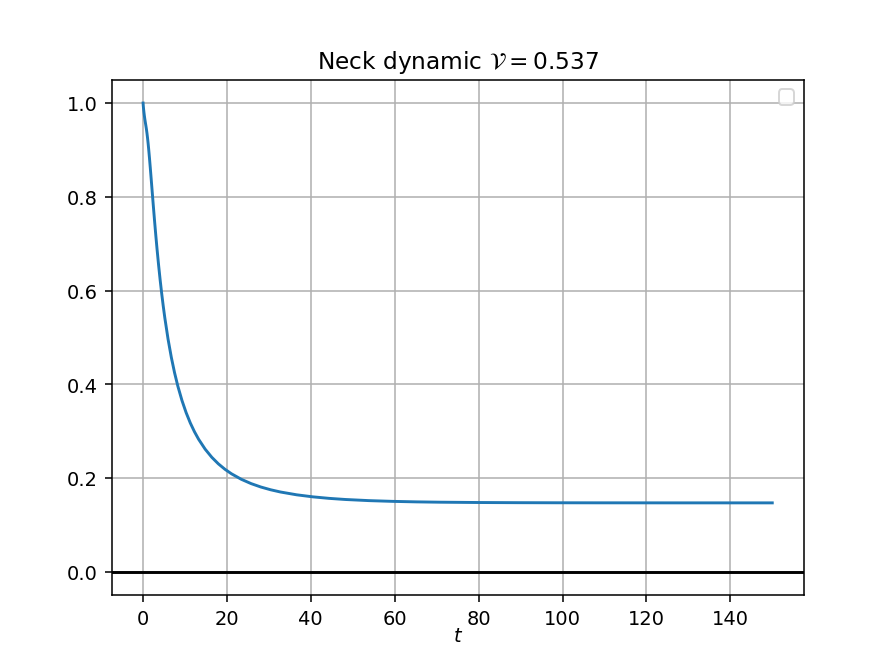

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Text(0.5, 1.0, 'Neck dynamic $\\mathcal{V}=$$0.537$')

In [343]:
%matplotlib notebook
plt.figure()
plt.plot(t_range, neck_arr)

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
plt.axhline(0,color='k')
#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.title(r'Neck dynamic $\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


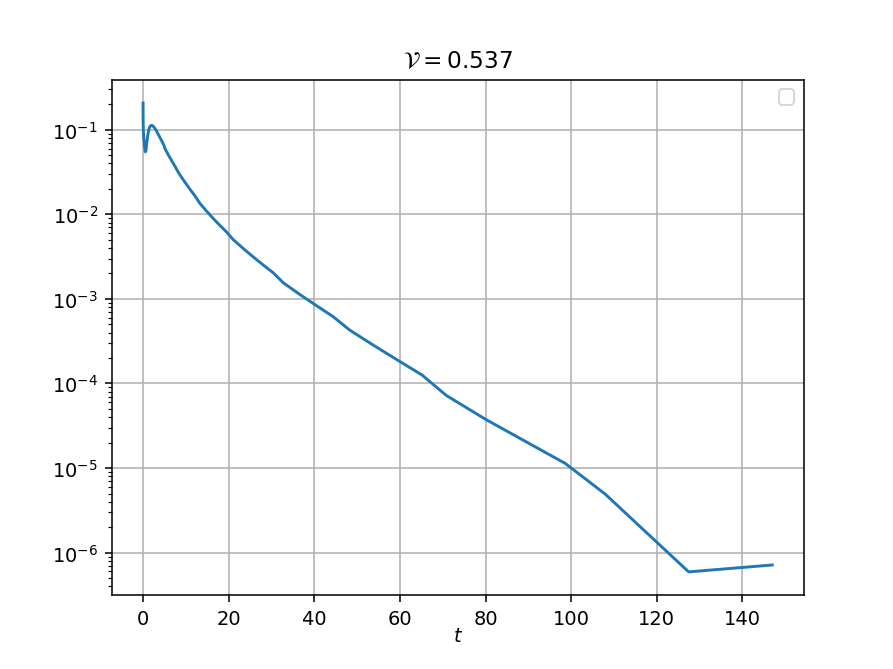

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Text(0.5, 1.0, '$\\mathcal{V}=$$0.537$')

In [344]:
plt.figure()
plt.plot(t_range[:-1], np.abs((neck_arr[1:]-neck_arr[:-1])/(t_range[1:]-t_range[:-1])))

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
plt.yscale('log')
plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
plt.axhline(0,color='k')
#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.title(r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


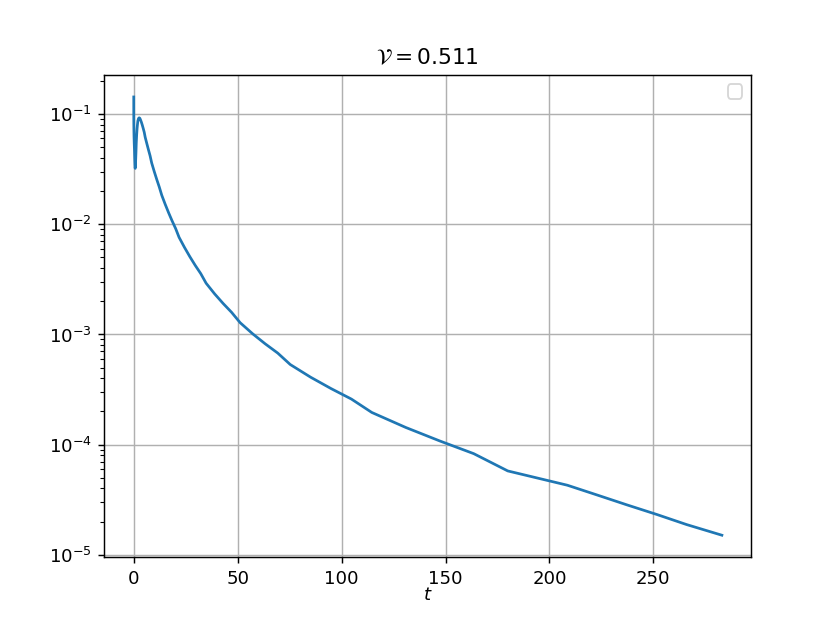

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Text(0.5, 1.0, '$\\mathcal{V}=$$0.511$')

In [474]:
plt.figure()
plt.plot(t_range[:-1], np.abs((neck_arr[1:]-neck_arr[:-1])/(t_range[1:]-t_range[:-1])))

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
plt.yscale('log')
plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
plt.axhline(0,color='k')
#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.title(r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

### force

In [475]:
force_arr =[]
force_fur_arr =[]

t_range = sol_t[::]
#t_range = sol_t[::10]
for t_j in tqdm(t_range):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_y[N//2:,j]

    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
    V = np.sqrt(P1**2+Z1**2)
    
    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    force_fur = np.fft.rfft(get_ext_array(force), norm='forward')[::2]
    force_arr.append(force)
    force_fur_arr.append(force_fur)
force_arr=np.array(force_arr)
force_fur_arr=np.array(force_fur_arr)

  0%|          | 0/95 [00:00<?, ?it/s]

In [476]:
%matplotlib inline
@interact(i=(0,len(t_range)-1,1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(force_arr[i],lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=47, description='i', max=94), Output()), _dom_classes=('widget-interact'…

In [393]:
%matplotlib inline
@interact(i=(0,len(t_range)-1,1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(force_arr[i],lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=45, description='i', max=91), Output()), _dom_classes=('widget-interact'…

In [144]:
%matplotlib inline
@interact(i=(0,len(t_range)-1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(force_fur_arr[i],'.--',lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')
    ax.set_xlim(0, 2*N)
    ax.set_yscale('symlog', linthresh=1e-9)

interactive(children=(IntSlider(value=21, description='i', max=42), Output()), _dom_classes=('widget-interact'…

In [488]:
%matplotlib inline
@interact(i=(0,len(t_range)-1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(np.abs(force_fur_arr[i]),'.--',lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')
    ax.set_xlim(0, 2*N)
    ax.set_ylim(1e-8, 1e2)
    ax.set_yscale('log')
    

interactive(children=(IntSlider(value=47, description='i', max=94), Output()), _dom_classes=('widget-interact'…

<IPython.core.display.Javascript object>


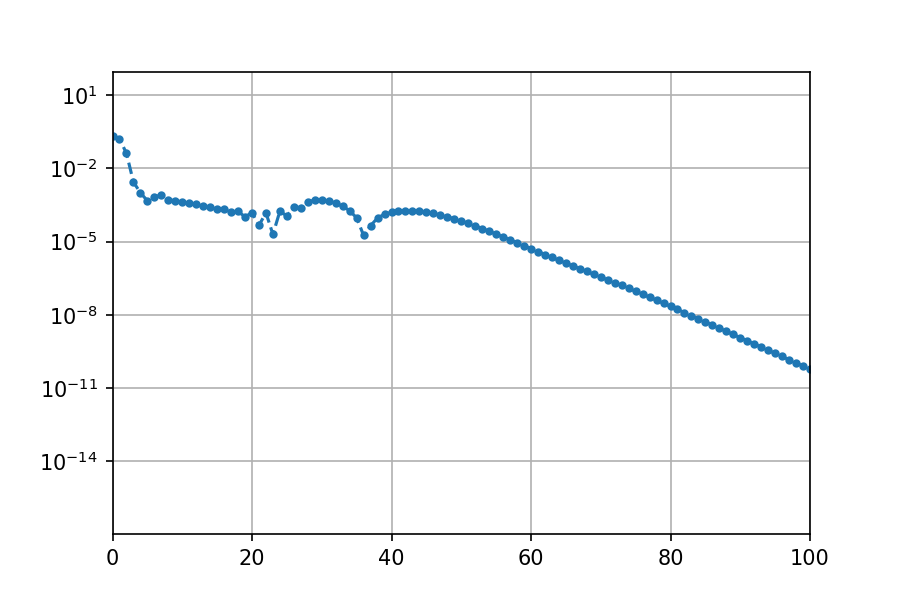

In [489]:
#N_frames = 50*10

%matplotlib notebook



import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(6,4))
ax.grid()



line, = ax.plot(np.abs(force_fur_arr[0]),'.--',lw=1.5)
ax.set_yscale('log')
#ax.axis('scaled')
ax.set_xlim(0, 2*N)
#ax.axvline(0, color='k')
#ax.axhline(0, color='k')
#ax.set_title(f'a={a}')
def animate(i):

    line.set_ydata(np.abs(force_fur_arr[i]))  # update the data.
    
    return line,


ani = animation.FuncAnimation(
    fig, animate)

# To save the animation, use e.g.
#
#ani.save(f"dyno_{2.4}.mp4")
#
# or
#
#writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie_{0.511}.mp4", writer=writer)

plt.show()

### Spectrum

In [478]:
len(sol_t)

95

In [348]:
sym_spec_arr =[]
#t_range = np.linspace(0,t_max,50)
asym_spec_arr =[]
t_range = sol_t[::len(sol_t)//50]

t_range = sol_t[::len(sol_t)//50]

for t_j in tqdm(t_range):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_y[N//2:,j]
    
    jac_norm_fun = nd.Jacobian(lambda normal_delta_fur:
                            get_normal_velo_normal_delta(P_fur_j, Z_fur_j, normal_delta_fur), step=1e-6)
    jac = jac_norm_fun(np.zeros(N))

    w_sym,vr_sym =sc.linalg.eig(jac[::2,::2])
    sym_spec_arr.append(np.sort(w_sym)[::-1][:4])
    
    w_asym,vr_asym =sc.linalg.eig(jac[1::2,1::2])
    asym_spec_arr.append(np.sort(w_asym)[::-1][:4])
    
sym_spec_arr=np.array(sym_spec_arr)
asym_spec_arr=np.array(asym_spec_arr)

  0%|          | 0/89 [00:00<?, ?it/s]

In [349]:
np.save(f'spec_dyn_bdf_a={a}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', [sym_spec_arr, asym_spec_arr])

<IPython.core.display.Javascript object>


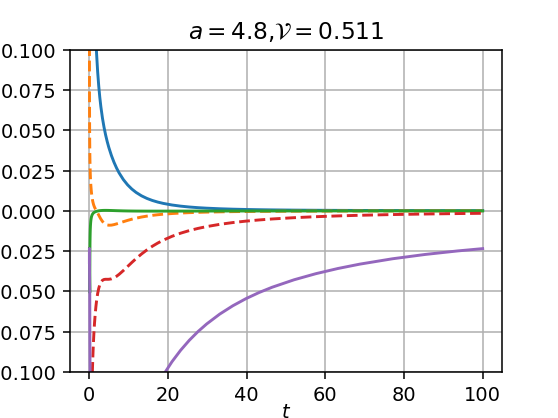

Text(0.5, 1.0, '$a=4.8$,$\\mathcal{V}=$$0.511$')

In [474]:
%matplotlib notebook
plt.figure(figsize=(4,3))
for m in [0,1,2]:
    plt.plot(t_range, sym_spec_arr[:,m])
    plt.plot(t_range, asym_spec_arr[:,m],'--')

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
#plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
plt.ylabel(r'$\lambda$', labelpad=-1)

#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.ylim(-1e-1,1e-1)
plt.title(fr'$a={a}$,'+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


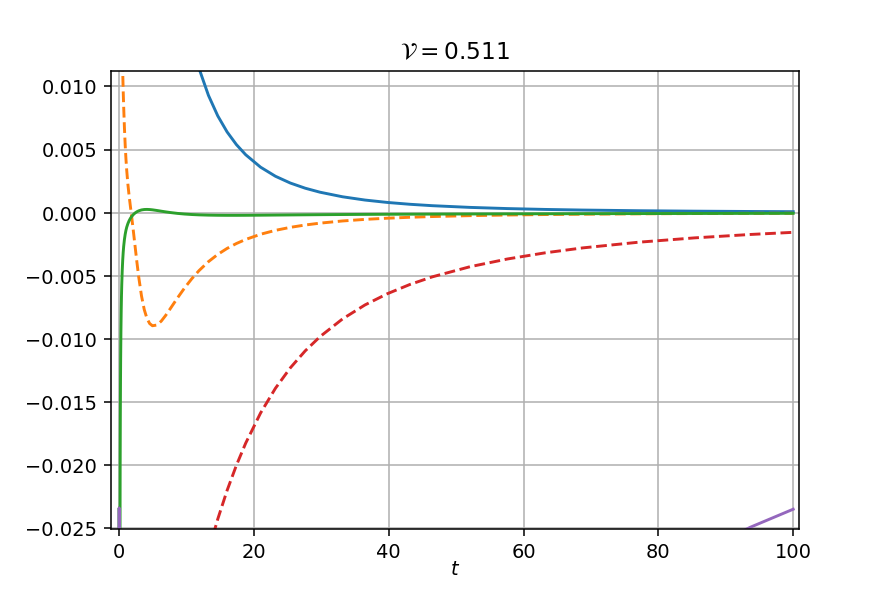

Text(0.5, 1.0, '$\\mathcal{V}=$$0.511$')

In [467]:
%matplotlib notebook
plt.figure()
for m in [0,1,2]:
    plt.plot(t_range, sym_spec_arr[:,m])
    plt.plot(t_range, asym_spec_arr[:,m],'--')

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
#plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.title(r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


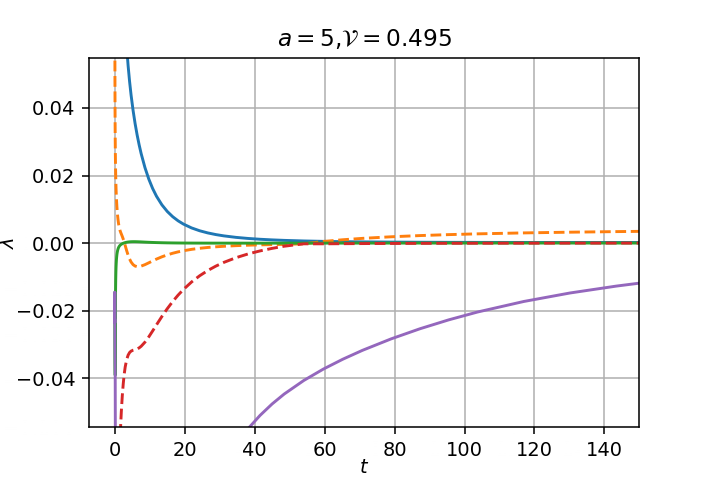

/home/maxkway/anaconda3/lib/python3.8/site-packages/matplotlib/cbook/__init__.py:1369: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


Text(0.5, 1.0, '$a=5$,$\\mathcal{V}=$$0.495$')

In [509]:
%matplotlib notebook
plt.figure(figsize=(4,3))
for m in [0,1,2]:
    plt.plot(t_range, sym_spec_arr[:,m])
    plt.plot(t_range, asym_spec_arr[:,m],'--')

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
#plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
plt.ylabel(r'$\lambda$', labelpad=-1)

#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.ylim(-1e-1,1e-1)
plt.title(fr'$a={a}$,'+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


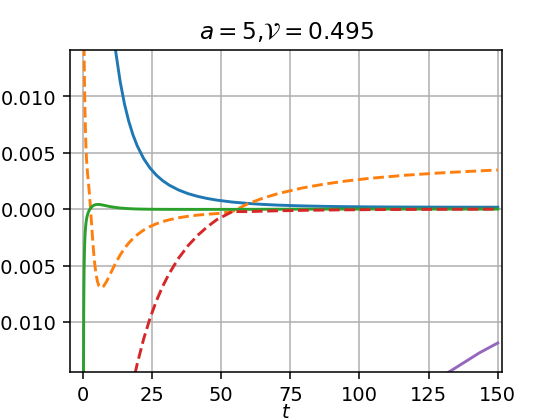

Text(0.5, 1.0, '$a=5$,$\\mathcal{V}=$$0.495$')

In [510]:
%matplotlib notebook
plt.figure(figsize=(4,3))
for m in [0,1,2]:
    plt.plot(t_range, sym_spec_arr[:,m])
    plt.plot(t_range, asym_spec_arr[:,m],'--')

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
#plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
plt.ylabel(r'$\lambda$', labelpad=-1)

#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.ylim(-1e-1,1e-1)
plt.title(fr'$a={a}$,'+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


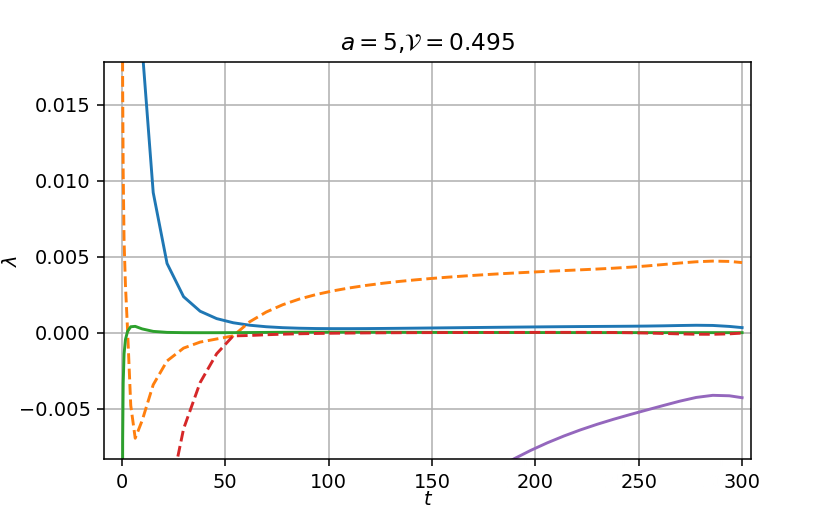

/home/maxkway/anaconda3/lib/python3.8/site-packages/matplotlib/cbook/__init__.py:1369: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


Text(0.5, 1.0, '$a=5$,$\\mathcal{V}=$$0.495$')

In [610]:
%matplotlib notebook
plt.figure(figsize=(4,3))
for m in [0,1,2]:
    plt.plot(t_range, sym_spec_arr[:,m])
    plt.plot(t_range, asym_spec_arr[:,m],'--')

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
#plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
plt.ylabel(r'$\lambda$', labelpad=-1)

#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.ylim(-1e-1,1e-1)
plt.title(fr'$a={a}$,'+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


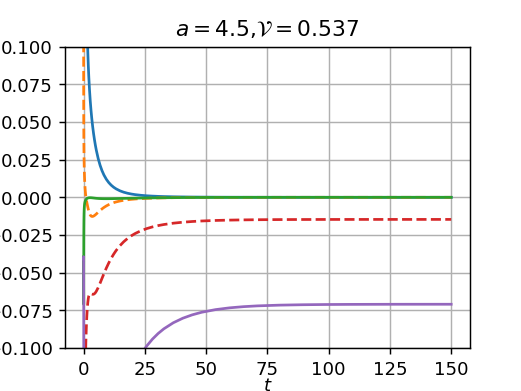

/home/maxkway/anaconda3/lib/python3.8/site-packages/matplotlib/cbook/__init__.py:1369: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


Text(0.5, 1.0, '$a=4.5$,$\\mathcal{V}=$$0.537$')

In [350]:
%matplotlib notebook
plt.figure(figsize=(4,3))
for m in [0,1,2]:
    plt.plot(t_range, sym_spec_arr[:,m])
    plt.plot(t_range, asym_spec_arr[:,m],'--')

#plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
#plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
plt.ylabel(r'$\lambda$', labelpad=-1)

#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.ylim(-1e-1,1e-1)
plt.title(fr'$a={a}$,'+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

## Animate

<IPython.core.display.Javascript object>


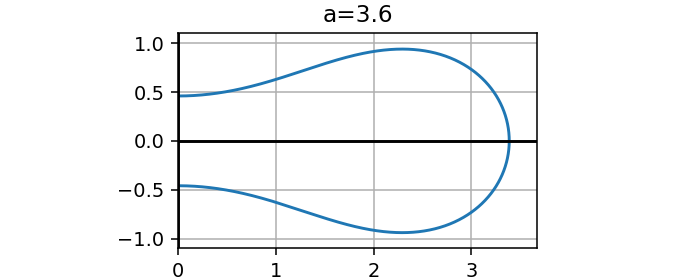

In [521]:
N_frames = 50*10
t_frames = np.linspace(0,10,N_frames)

%matplotlib notebook



import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(5,2))
ax.grid()

j=0
P_fur_j = np.zeros(N)
P_fur_j[1::2]=sol_y[:N//2,j]
Z_fur_j = np.zeros(N)
Z_fur_j[1::2]=sol_y[N//2:,j]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)

line, = ax.plot(P,Z,lw=1.5)

ax.axis('scaled')
ax.set_xlim(0, a*1.02)
ax.axvline(0, color='k')
ax.axhline(0, color='k')
ax.set_title(f'a={a}')
def animate(i):
    t_ = t_frames[i]
    index_t = np.argmin(np.abs(sol_t-t_))
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_bdf.y[:N//2,index_t]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_bdf.y[N//2:,index_t]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    line.set_ydata(Z);line.set_xdata(P)  # update the data.
    
    return line,


ani = animation.FuncAnimation(
    fig, animate, interval=5/N_frames, save_count=N_frames)

# To save the animation, use e.g.
#
#ani.save(f"dyno_{2.4}.mp4")
#
# or
#
#writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie_{0.511}.mp4", writer=writer)

plt.show()

In [522]:
ani.save(f"dyn_bdf_a={a}_to_t=10_N={N}_n_int={n_int}.gif")
ani.save(f"dyn_bdf_a={a}_to_t=10_N={N}_n_int={n_int}.mp4", dpi=1000)

## Comparing different tolerance Bdf

In [ ]:
t_max = 60
atol_list=[1e-3,1e-4,1e-5,5e-6,1e-6]

In [265]:
a=4
atol_list_bdf = [1e-5, 2e-5,5e-5,1e-4,2e-4,5e-4,1e-3]
t_max = 100

<IPython.core.display.Javascript object>


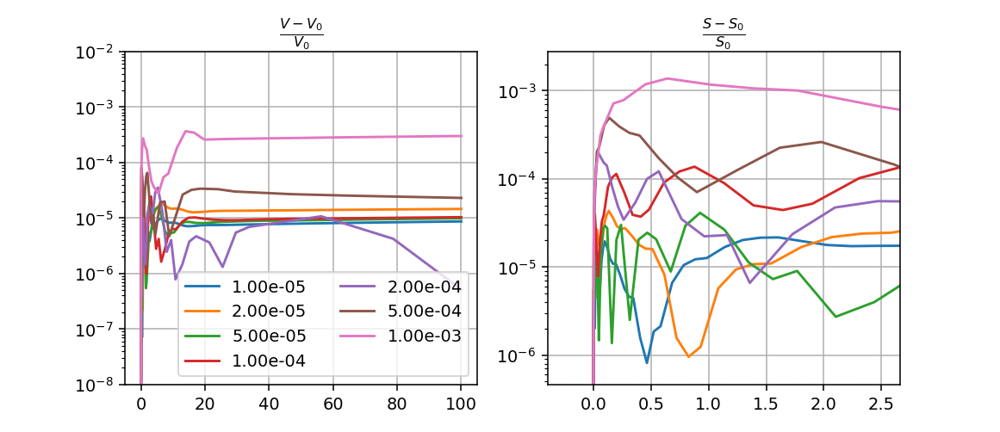

In [268]:

fig,axs = plt.subplots(1,2,figsize=(8,4))
axs[0].grid()
axs[1].grid()
for atol in atol_list_bdf:
    sol = np.load(f'dyn_bdf_a={a}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', allow_pickle=True)

    sol_t = sol[0]
    sol_y = sol[1]
    
    Vol_ar=[]
    Sqr_ar=[]
    for j in range(len(sol_t)):
        P_fur_j = np.zeros(N)
        P_fur_j[1::2]=sol_y[:N//2,j]
        Z_fur_j = np.zeros(N)
        Z_fur_j[1::2]=sol_y[N//2:,j]
        
        Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
        Vol_ar.append(Vol)
        Sqr_ar.append(Sqr)
    Vol_ar=np.array(Vol_ar)
    Sqr_ar=np.array(Sqr_ar)   
    axs[0].plot(sol_t, np.abs(Vol_ar/Vol0-1),'-', label=fr'{atol:.2e}')
    axs[1].plot(sol_t, np.abs(Sqr_ar/Sqr0-1),'-')
axs[0].set_title(r'$\frac{V-V_0}{V_0}$')
axs[1].set_title(r'$\frac{S-S_0}{S_0}$')
axs[0].set_yscale('log')
axs[1].set_yscale('log')
axs[0].set_ylim(1e-7,1e-2)
axs[1].set_ylim(1e-7,1e-2)

axs[0].legend(ncol=2)
#plt.xlabel(r'$t$')
#plt.yscale('log')

In [272]:
%matplotlib notebook
@interact(k=(0,N//2-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1,2, figsize=(8,3))
    for atol in atol_list_bdf:
        sol = np.load(f'dyn_bdf_a={a}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', allow_pickle=True)
    
        sol_t = sol[0]
        sol_y = sol[1]
        
        axs[0].plot(sol_t, sol_y[k,:], label=fr'{atol:.2e}')
        axs[1].plot(sol_t, sol_y[k+N//2,:])
        axs[0].grid()
        axs[1].grid()
        
    axs[0].legend(ncol=2)

interactive(children=(IntSlider(value=7, description='k', max=14), Output()), _dom_classes=('widget-interact',…

## Comparing different tolerance radau

In [273]:
a=4
atol_list_radau = [1e-5, 2e-5,5e-5,1e-4,2e-4,5e-4]
t_max = 100

<IPython.core.display.Javascript object>


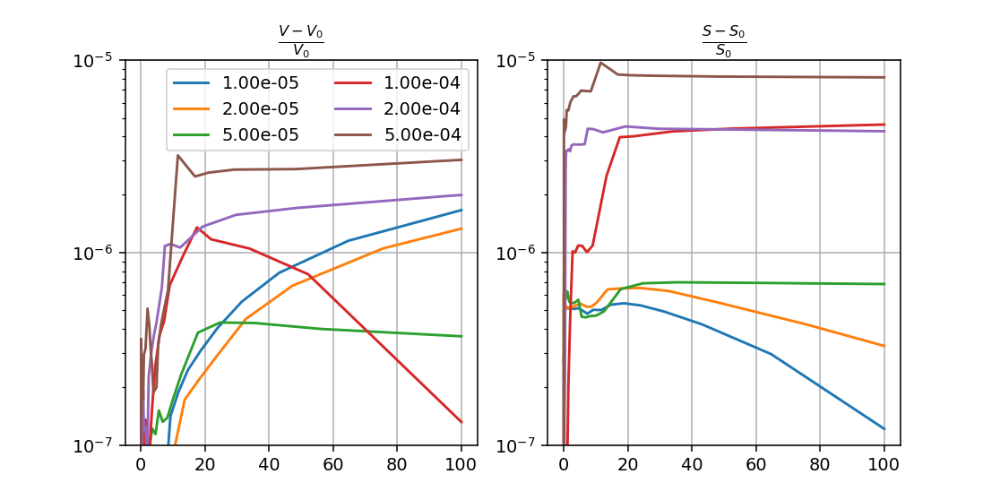

In [294]:
fig,axs = plt.subplots(1,2,figsize=(8,4))
axs[0].grid()
axs[1].grid()
for atol in atol_list_radau:
    sol = np.load(f'dyn_rad_a={a}_to_t={t_max}_N={N}_n_int={n_int}_RAD_atol={atol:.2e}.npy', allow_pickle=True).item()
    sol_t = sol['t']
    sol_y = sol['y']
    
    Vol_ar=[]
    Sqr_ar=[]
    for j in range(len(sol_t)):
        P_fur_j = np.zeros(N)
        P_fur_j[1::2]=sol_y[:N//2,j]
        Z_fur_j = np.zeros(N)
        Z_fur_j[1::2]=sol_y[N//2:,j]
        
        Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
        Vol_ar.append(Vol)
        Sqr_ar.append(Sqr)
    Vol_ar=np.array(Vol_ar)
    Sqr_ar=np.array(Sqr_ar)   
    axs[0].plot(sol_t, np.abs(Vol_ar/Vol0-1),'-', label=fr'{atol:.2e}')
    axs[1].plot(sol_t, np.abs(Sqr_ar/Sqr0-1),'-')
axs[0].set_title(r'$\frac{V-V_0}{V_0}$')
axs[1].set_title(r'$\frac{S-S_0}{S_0}$')
axs[0].set_yscale('log')
axs[1].set_yscale('log')
axs[0].set_ylim(1e-7,1e-5)
axs[1].set_ylim(1e-7,1e-5)

axs[0].legend(ncol=2)
#plt.xlabel(r'$t$')
#plt.yscale('log')

In [295]:
%matplotlib notebook
@interact(k=(0,N//2-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1,2, figsize=(8,3))
    for atol in atol_list_radau:
        sol = np.load(f'dyn_rad_a={a}_to_t={t_max}_N={N}_n_int={n_int}_RAD_atol={atol:.2e}.npy', allow_pickle=True).item()
        sol_t = sol['t']
        sol_y = sol['y']
        axs[0].plot(sol_t, sol_y[k,:], label=fr'{atol:.2e}')
        axs[1].plot(sol_t, sol_y[k+N//2,:])
        axs[0].grid()
        axs[1].grid()
        
    axs[0].legend(ncol=2)

interactive(children=(IntSlider(value=7, description='k', max=14), Output()), _dom_classes=('widget-interact',…

## Comparing different scheme

<IPython.core.display.Javascript object>


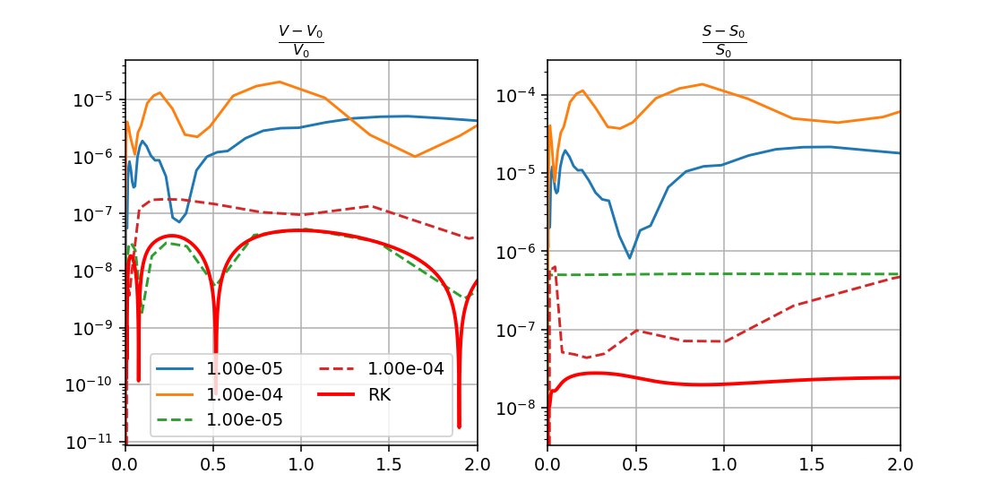

(0.0, 2.0)

In [313]:
a=4
atol_list_bdf = [1e-5,1e-4]
atol_list_radau = [1e-5,1e-4]

t_max = 100

fig,axs = plt.subplots(1,2,figsize=(8,4))
axs[0].grid()
axs[1].grid()
### BDF ###
for atol in atol_list_bdf:
    sol = np.load(f'dyn_bdf_a={a}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', allow_pickle=True)

    sol_t = sol[0]
    sol_y = sol[1]
    
    Vol_ar=[]
    Sqr_ar=[]
    for j in range(len(sol_t)):
        P_fur_j = np.zeros(N)
        P_fur_j[1::2]=sol_y[:N//2,j]
        Z_fur_j = np.zeros(N)
        Z_fur_j[1::2]=sol_y[N//2:,j]
        
        Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
        Vol_ar.append(Vol)
        Sqr_ar.append(Sqr)
    Vol_ar=np.array(Vol_ar)
    Sqr_ar=np.array(Sqr_ar)   
    axs[0].plot(sol_t, np.abs(Vol_ar/Vol0-1),'-', label=fr'{atol:.2e}')
    axs[1].plot(sol_t, np.abs(Sqr_ar/Sqr0-1),'-')


### Radau ###
for atol in atol_list_radau:
    sol = np.load(f'dyn_rad_a={a}_to_t={t_max}_N={N}_n_int={n_int}_RAD_atol={atol:.2e}.npy', allow_pickle=True).item()
    sol_t = sol['t']
    sol_y = sol['y']
    
    Vol_ar=[]
    Sqr_ar=[]
    for j in range(len(sol_t)):
        P_fur_j = np.zeros(N)
        P_fur_j[1::2]=sol_y[:N//2,j]
        Z_fur_j = np.zeros(N)
        Z_fur_j[1::2]=sol_y[N//2:,j]
        
        Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
        Vol_ar.append(Vol)
        Sqr_ar.append(Sqr)
    Vol_ar=np.array(Vol_ar)
    Sqr_ar=np.array(Sqr_ar)   
    axs[0].plot(sol_t, np.abs(Vol_ar/Vol0-1),'--', label=fr'{atol:.2e}')
    axs[1].plot(sol_t, np.abs(Sqr_ar/Sqr0-1),'--')


### RK ###    
t_max = 2
max_step = 1e-4
sol = np.load(f'dyn_rk_a={a}_to_t={t_max}_N={N}_n_int={n_int}_max_step={max_step:.2e}.npy', allow_pickle=True).item()
sol_t = sol['t'][::10]
sol_y = sol['y'][:,::10]
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_y[N//2:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
axs[0].plot(sol_t, np.abs(Vol_ar/Vol0-1),'-',color='red',lw=2, label=fr'RK')
axs[1].plot(sol_t, np.abs(Sqr_ar/Sqr0-1),'-',color='red',lw=2)

axs[0].legend(ncol=2)
#plt.xlabel(r'$t$')
#plt.yscale('log')
axs[0].set_title(r'$\frac{V-V_0}{V_0}$')
axs[1].set_title(r'$\frac{S-S_0}{S_0}$')
axs[0].set_yscale('log')
axs[1].set_yscale('log')
#axs[0].set_ylim(1e-7,1e-4)
#axs[1].set_ylim(1e-7,1e-4)
axs[0].set_xlim(0, t_max)
axs[1].set_xlim(0, t_max)


In [319]:
%matplotlib inline
@interact(k=(0,N//2-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1,2, figsize=(8,3))
    t_max=100
    for atol in atol_list_bdf:
        sol = np.load(f'dyn_bdf_a={a}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', allow_pickle=True)
    
        sol_t = sol[0]
        sol_y = sol[1]
        
        axs[0].plot(sol_t, sol_y[k,:], label=fr'{atol:.2e}')
        axs[1].plot(sol_t, sol_y[k+N//2,:])
        
    for atol in atol_list_radau:
        sol = np.load(f'dyn_rad_a={a}_to_t={t_max}_N={N}_n_int={n_int}_RAD_atol={atol:.2e}.npy', allow_pickle=True).item()
        sol_t = sol['t']
        sol_y = sol['y']    

        axs[0].plot(sol_t, sol_y[k,:], '--',label=fr'{atol:.2e}')
        axs[1].plot(sol_t, sol_y[k+N//2,:],'--')        
    ### RK ###    
    t_max = 2
    max_step = 1e-4
    sol = np.load(f'dyn_rk_a={a}_to_t={t_max}_N={N}_n_int={n_int}_max_step={max_step:.2e}.npy', allow_pickle=True).item()
    sol_t = sol['t'][::10]
    sol_y = sol['y'][:,::10]
    axs[0].plot(sol_t, sol_y[k,:], '-',lw=2,color='red',label=fr'RK')
    axs[1].plot(sol_t, sol_y[k+N//2,:],'-',lw=2,color='red',)    
    
    axs[0].grid()
    axs[1].grid()
        
    axs[0].set_xlim(0, t_max)
    axs[1].set_xlim(0, t_max)
    axs[0].legend(ncol=2)

interactive(children=(IntSlider(value=7, description='k', max=14), Output()), _dom_classes=('widget-interact',…

In [ ]:
%matplotlib inline
@interact(k=(0,N//2-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1,2, figsize=(8,3))
    t_max=100
    for atol in atol_list_bdf:
        sol = np.load(f'dyn_bdf_a={a}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', allow_pickle=True)
    
        sol_t = sol[0]
        sol_y = sol[1]
        
        axs[0].plot(sol_t, sol_y[k,:], label=fr'{atol:.2e}')
        axs[1].plot(sol_t, sol_y[k+N//2,:])
        
    for atol in atol_list_radau:
        sol = np.load(f'dyn_rad_a={a}_to_t={t_max}_N={N}_n_int={n_int}_RAD_atol={atol:.2e}.npy', allow_pickle=True).item()
        sol_t = sol['t']
        sol_y = sol['y']    

        axs[0].plot(sol_t, sol_y[k,:], '--',label=fr'{atol:.2e}')
        axs[1].plot(sol_t, sol_y[k+N//2,:],'--')        
        
    axs[0].grid()
    axs[1].grid()
        
    axs[0].legend(ncol=2)

## Spectrum dependence

In [391]:
def get_normal_velo_normal_delta(P_fur, Z_fur, normal_delta_fur):
    delta_P_fur, delta_Z_fur  = get_normal_delta_PZ_fur(P_fur, Z_fur, normal_delta_fur)
    velo_norm_fur = get_velo_norm_fur(P_fur+delta_P_fur[:N], Z_fur+delta_Z_fur[:N])
    return velo_norm_fur

In [473]:

data_a = {4.8:{'t_max':60},4.7:{'t_max':50},4.6:{'t_max':40}, 4.4:{'t_max':30},4.2:{'t_max':20},4:{'t_max':15}}
for key in tqdm(data_a.keys()):
    t_max = data_a[key]['t_max']
    sol = np.load(f'dyn_bdf_a={key}_to_t={t_max}_N={N}_n_int={n_int}.npy', allow_pickle=True)
    sol_t = sol[0]
    sol_y = sol[1]
    sol=sol_y[:,-1]
    data_a[key]['sol'] = sol
    
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol[:N//2]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol[N//2:]


    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
    V = np.sqrt(P1**2+Z1**2)
    
    max_speed = np.abs(get_velo_norm_fur_sym_1d(sol)).max()
    data_a[key]['max_speed'] = max_speed
    
    
    jac_norm_func = nd.Jacobian(lambda normal_delta_fur:
                            get_normal_velo_normal_delta(P_fur_j, Z_fur_j, normal_delta_fur), step=1e-6)

    jac = jac_norm_func(np.zeros(N))
    
    w_full,vr_full =sc.linalg.eig(jac)
    data_a[key]['spec'] = np.sort(w_full.real)[::-1][:7]
    

  0%|          | 0/6 [00:00<?, ?it/s]

In [474]:
a_list = list(data_a.keys())
spec_arr = np.array([data_a[key]['spec'] for key in data_a.keys()])

<IPython.core.display.Javascript object>


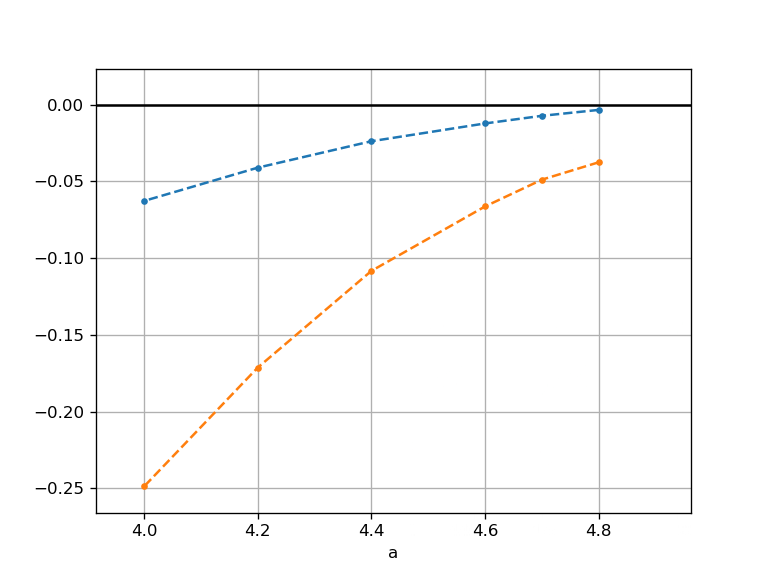

Text(0.5, 0, 'a')

In [476]:
%matplotlib notebook
plt.figure()
plt.plot(a_list, spec_arr[:,3],'.--')
plt.plot(a_list, spec_arr[:,4],'.--')
plt.plot(a_list, spec_arr[:,5],'.--')
plt.plot(a_list, spec_arr[:,6],'.--')
plt.grid()
plt.axhline(0, color='k')
plt.xlabel('a')

## Asymetric dynamic

In [780]:
def get_velo_norm_fur_1d(pz):
    P_fur = np.zeros(N)
    P_fur[1:] = pz[:N-1]
    Z_fur = pz[N-1:]
    #print(P_fur, Z_fur)
    veloP, veloZ = get_velo_normal_fur(P_fur, Z_fur)
    #print(veloP, veloZ)
    return np.concatenate([veloP[1:], veloZ])

In [781]:
j_fun = nd.Jacobian(get_velo_norm_fur_1d, step=1e-6)

In [782]:
def get_normal_velo_normal_delta(P_fur, Z_fur, normal_delta_fur):
    delta_P_fur,delta_Z_fur  = get_normal_delta_PZ_fur(P_fur, Z_fur, normal_delta_fur)
    velo_norm_fur = get_velo_norm_fur(P_fur+delta_P_fur[:N], Z_fur+delta_Z_fur[:N])
    return velo_norm_fur

### Prepare state

In [1177]:
p1=1
z1=0.4
z2=-0.5
z3=-0.15

In [217]:
p1=1
z1=0.35
z2=-0.5
z3 = -0.2

In [591]:
p1=1
p2=-0.1
z1=0.13
z2=-0.3
z3=-0.04

In [592]:
P_fur0 = np.zeros(N);
P_fur0[1]=p1
P_fur0[2]=p2
P_fur0 /= 2

Z_fur0 = np.zeros(N);
Z_fur0[1]=z1
Z_fur0[2]=z2
Z_fur0[3]=z3
Z_fur0 /= 2

In [593]:
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
V_cal0

0.4152931682156925

In [594]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur0)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur0)
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 

### find surface tension ###
sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)

<IPython.core.display.Javascript object>


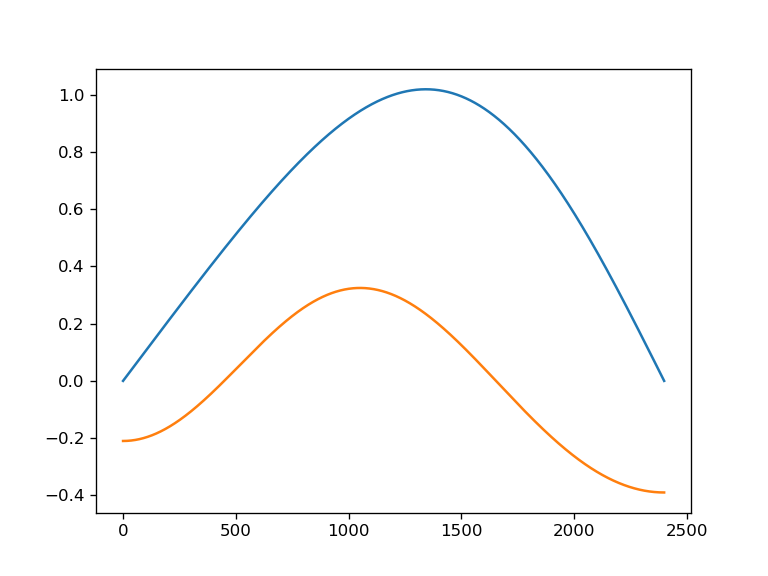

In [595]:
plt.figure()
plt.plot(P)
plt.plot(Z)

<IPython.core.display.Javascript object>


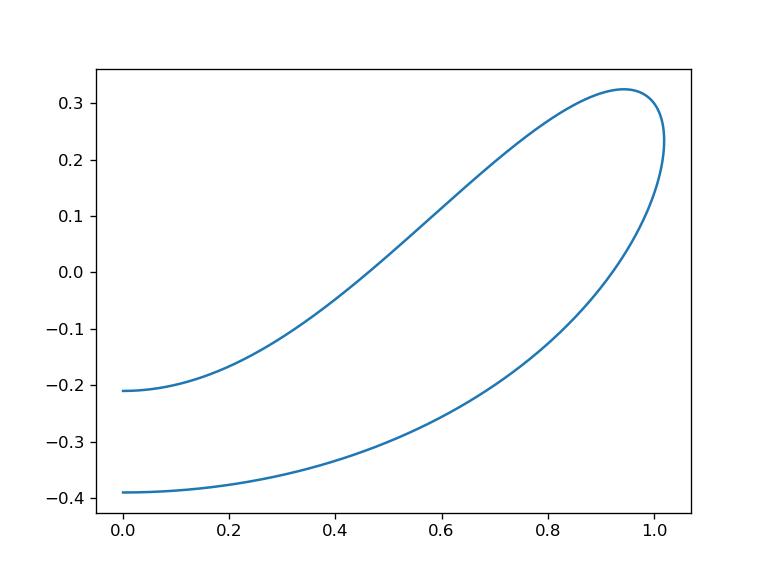

In [596]:
plt.figure()
plt.plot(P,Z)

In [597]:
t_ = get_velo(P_fur0, Z_fur0)

<IPython.core.display.Javascript object>


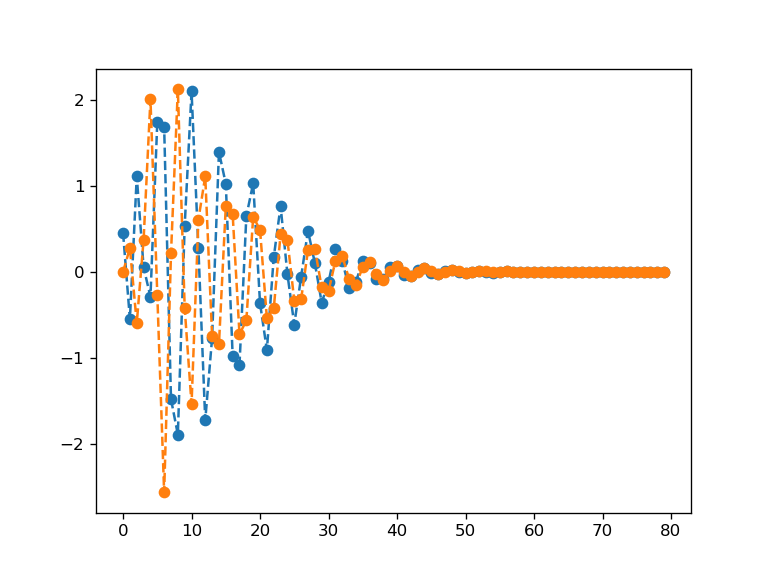

<IPython.core.display.Javascript object>


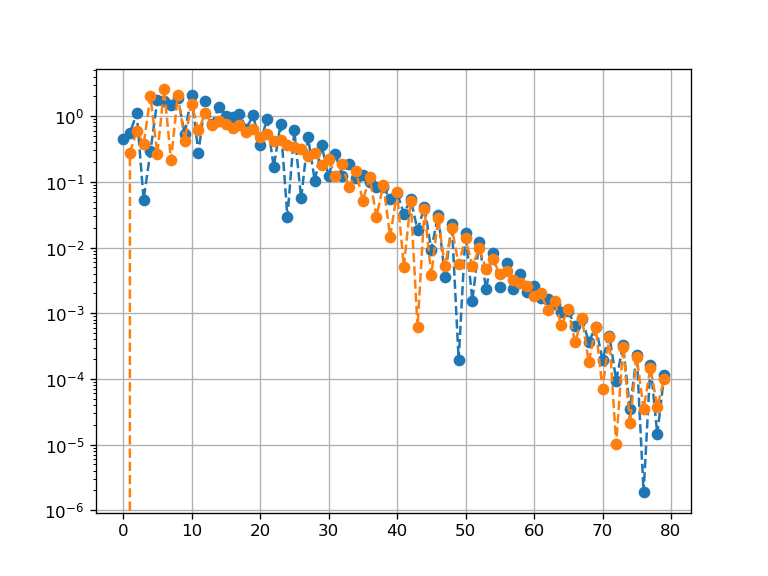

<IPython.core.display.Javascript object>


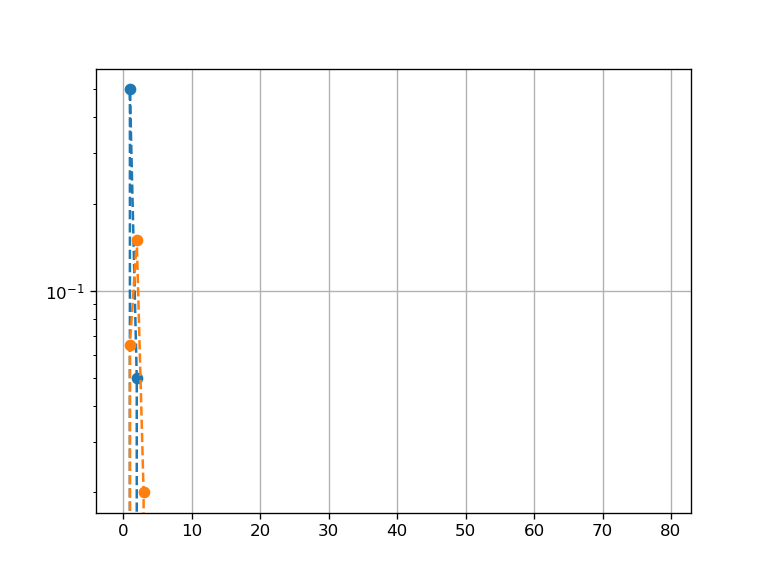

In [598]:
V_rho_fur, V_z_fur = get_velo_fur(P_fur0, Z_fur0)
plt.figure()
plt.plot(V_z_fur,'o--')
plt.plot(V_rho_fur,'o--')

plt.figure()
plt.plot(np.abs(V_z_fur),'o--')
plt.plot(np.abs(V_rho_fur),'o--')
plt.grid()
plt.yscale('log')

plt.figure()
plt.plot(np.abs(P_fur0),'o--')
plt.plot(np.abs(Z_fur0),'o--')
plt.grid()
plt.yscale('log')

<IPython.core.display.Javascript object>


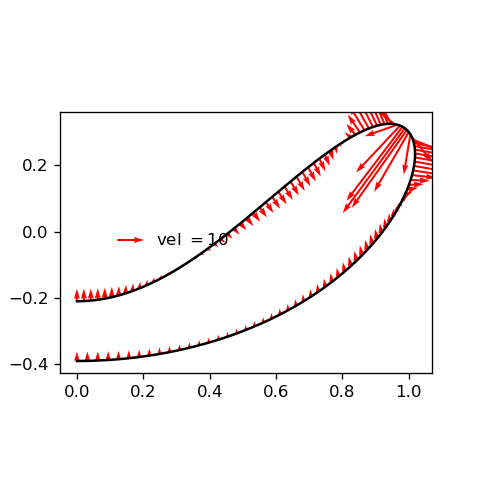

(-0.05095503025710762,
 1.0700556353992576,
 -0.4257375160077049,
 0.360487836161802)

In [599]:
fig = plt.figure(figsize = (4,4))
ax = fig.add_subplot(1, 1, 1)

#ax.scatter(p0, z0,s=6)
#qk = ax.quiverkey(Q, 0.4, 0.5, 100, r'$v=100$', labelpos='E',
#                  coordinates='figure')
plt.plot(P, Z,'k')

Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], t_[0],t_[1], color='red')
qk = ax.quiverkey(Qnow, 0.3, 0.5, 10, r'vel $=10$', labelpos='E',
                  coordinates='figure')
ax.axis('scaled')
#Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], 
#                 (force/V*(-Z1))[::N_int//n_int],(force/V*P1)[::N_int//n_int], color='blue')
#qk = ax.quiverkey(Qnow, 0.8, 0.8, 10, r'f $=10$', labelpos='E',
#                  coordinates='figure')

<IPython.core.display.Javascript object>


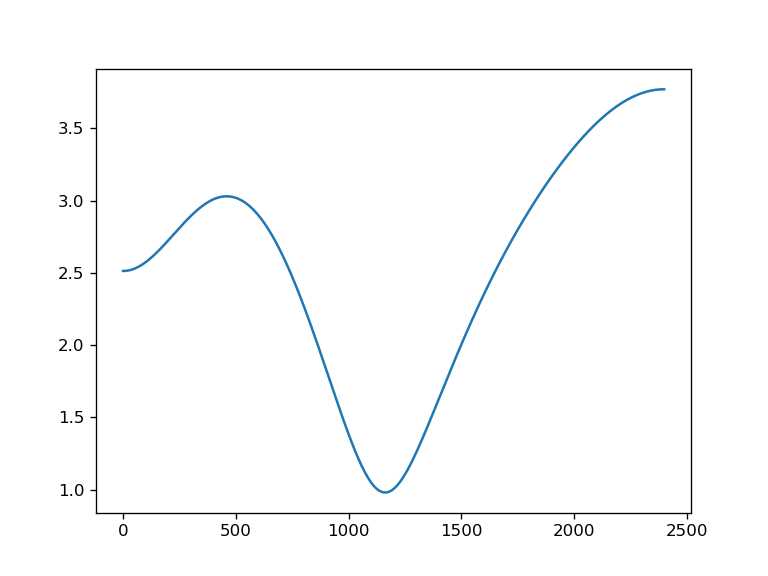

In [600]:
plt.figure()
plt.plot(V)

In [601]:
def get_plot_field(field, tp='z'):
    field_fur = np.fft.rfft(get_ext_array(field,tp), norm='forward')
    field_fur_ext = np.zeros(N_int)+0j
    field_fur_ext[:field_fur.shape[0]-1] = field_fur[:field_fur.shape[0]-1]
    field_fur_ext[field_fur.shape[0]-1] = field_fur[field_fur.shape[0]-1]/2
    field_N_int = np.fft.irfft(field_fur_ext, n=2*N_int,norm='forward')[:N_int+1]
    return field_N_int

<IPython.core.display.Javascript object>


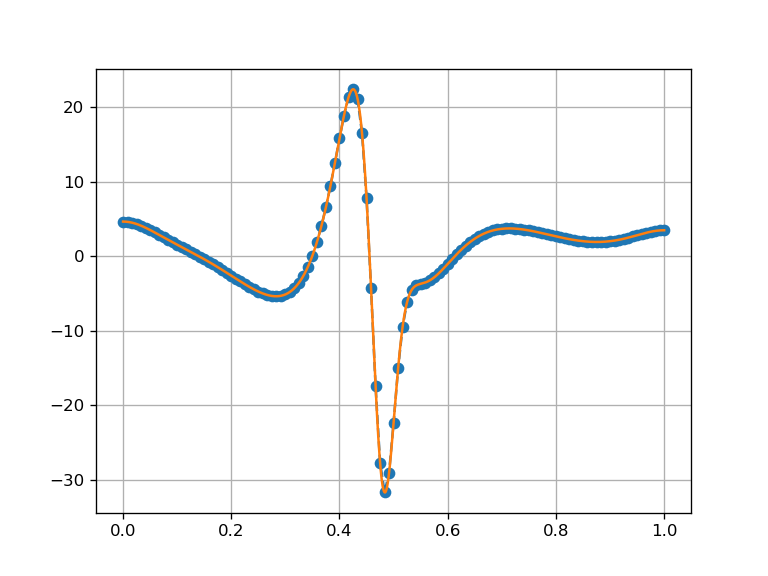

<IPython.core.display.Javascript object>


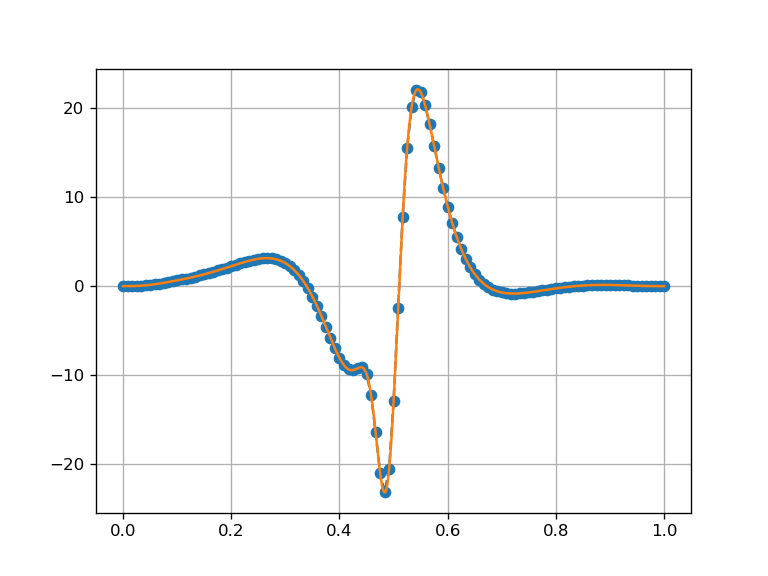

In [602]:
%matplotlib notebook
V_rho, V_z = get_velo(P_fur0, Z_fur0)
plt.figure()
plt.plot(tau_int, V_z,'o--')
plt.plot(Tau_int, get_plot_field(V_z, tp='z'),'-')
plt.grid()

plt.figure()
plt.plot(tau_int, V_rho,'o--')
plt.plot(Tau_int, get_plot_field(V_rho, tp='p'),'-')
plt.grid()
#plt.plot(Tau_int, force)

<IPython.core.display.Javascript object>


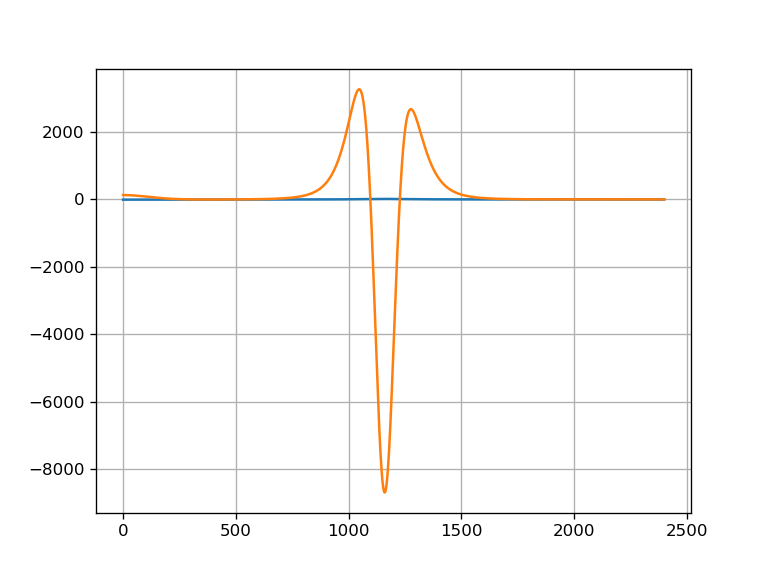

<IPython.core.display.Javascript object>


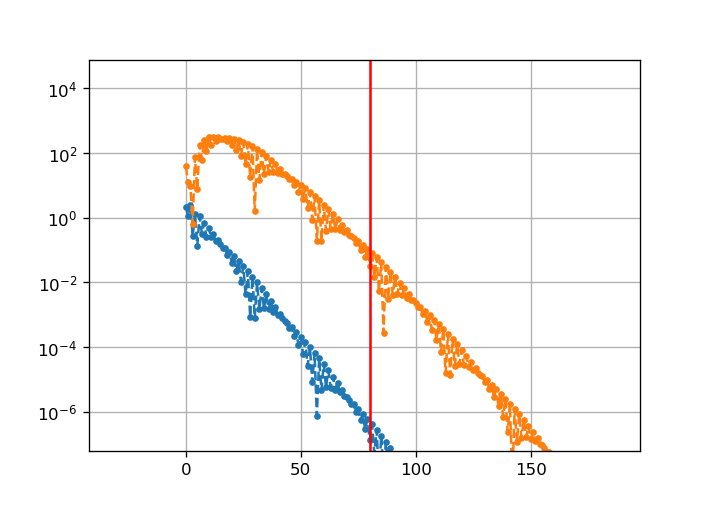

In [603]:
%matplotlib notebook
plt.figure()
plt.plot(H)
plt.plot(force)
plt.grid()




plt.figure()
plt.plot(np.abs(np.fft.rfft(get_ext_array(H), norm='forward')), '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(force), norm='forward')), '.--')

plt.yscale('log')
plt.axvline(N,color='red')
plt.xlim(0,4*N)
plt.ylim(1e-8,1e2)

plt.grid()

<IPython.core.display.Javascript object>


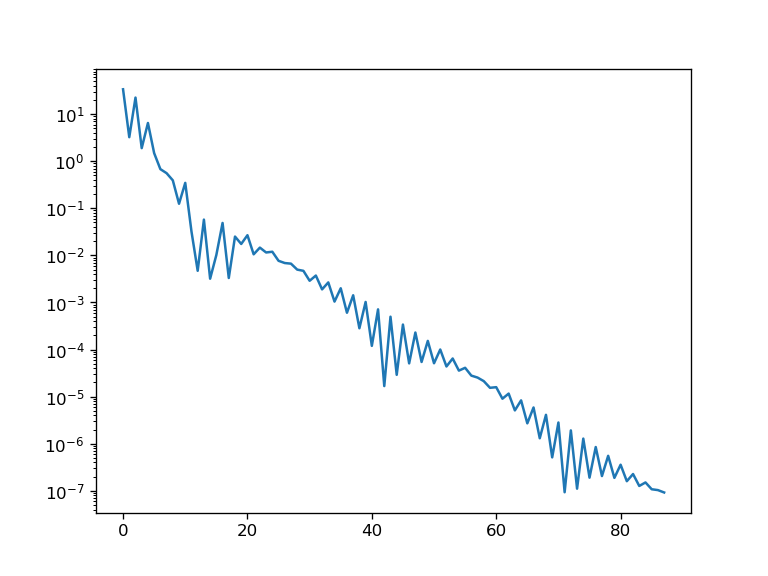

In [604]:
plt.figure()
plt.plot(np.abs(
get_sigma_fur_from_arr(P_fur0, Z_fur0)))
plt.yscale('log')

In [605]:
jac = j_fun(np.concatenate([P_fur0[1::], Z_fur0]))

<IPython.core.display.Javascript object>


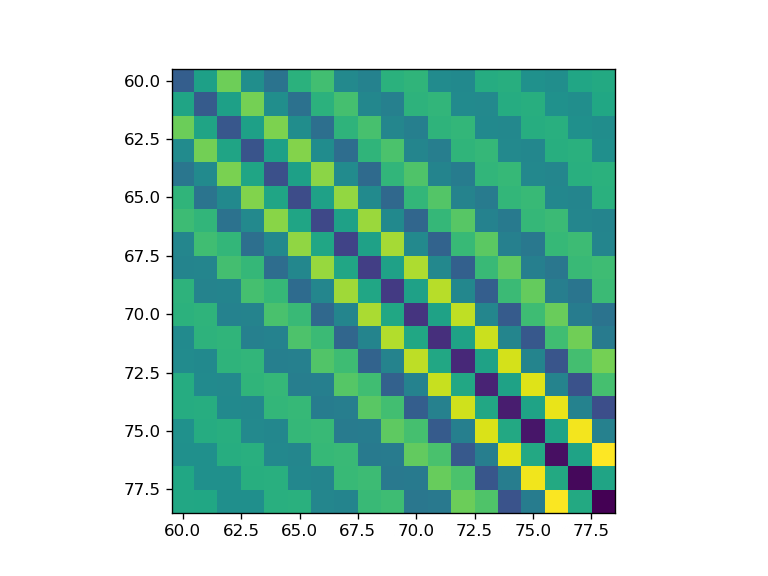

In [606]:
plt.figure()
plt.imshow(jac[:N-1,:N-1])

In [607]:
sc.linalg.eigvals(jac[N-15:N-1,N-15:N-1])

array([-1079683.16880898+0.j, -1012408.63001077+0.j,
        -303897.65457917+0.j,  -246460.40197339+0.j,
         -98734.27943633+0.j,   -62946.10137648+0.j,
         -57233.3796658 +0.j,    -2016.6201211 +0.j,
          -9044.26234683+0.j,   -12467.64354195+0.j,
         -24907.62533928+0.j,   -40855.28397637+0.j,
         -32296.75518095+0.j,   -82679.82954619+0.j])

In [608]:
w_full,vr_full =sc.linalg.eig(jac)
print(f'{w_full.min():.2e}')

-2.04e+06+0.00e+00j


In [609]:
np.sort((w_full))[::-1][:15]

array([424.89761228 +0.j        , 155.12907797 +0.j        ,
       143.63192753+16.3455036j , 143.63192753-16.3455036j ,
       132.21373717 +0.j        , 110.55941975 +0.j        ,
        80.46331055+31.02814201j,  80.46331055-31.02814201j,
        70.20121718 +0.j        ,  53.48679685 +0.j        ,
        29.69708585+15.15051375j,  29.69708585-15.15051375j,
        19.30349424+14.45151801j,  19.30349424-14.45151801j,
         9.15266179+11.40674671j])

In [162]:
jac_norm_fun = nd.Jacobian(lambda normal_delta_fur:
                        get_normal_velo_normal_delta(P_fur0, Z_fur0, normal_delta_fur), step=1e-6)

In [163]:
jac_norm = jac_norm_fun(np.zeros(N))

In [164]:
w,vr =sc.linalg.eig(jac_norm)

In [165]:
np.sort((w))[::-1][:5]

array([435.42335387+0.j        ,   6.87626536+0.j        ,
        -0.948907  +0.j        , -13.00761916+9.92717849j,
       -13.00761916-9.92717849j])

In [166]:
print(f'{w.min():.2e}')
print(f'{1/w.min():.2e}')

-1.26e+06+0.00e+00j
-7.94e-07-0.00e+00j


_____________________

In [89]:
steps = np.arange(N)
steps[0] = 1
steps = 1/steps**3

In [90]:
jac_norm_fun_steps = nd.Jacobian(lambda normal_delta_fur:
                        get_normal_velo_normal_delta(P_fur0, Z_fur0, normal_delta_fur), 
                                 step=1e-4*steps)

In [91]:
jac_norm_steps = jac_norm_fun_steps(np.zeros(N))

In [92]:
w_steps,vr_steps =sc.linalg.eig(jac_norm_steps)

In [93]:
np.sort((w_steps))[::-1][:5]

array([435.42372361+0.j        ,   6.87626895+0.j        ,
        -0.94889678+0.j        , -13.00762968+9.92720796j,
       -13.00762968-9.92720796j])

In [94]:
print(f'{w_steps.min():.2e}')
print(f'{1/w_steps.min():.2e}')

-4.31e+06+0.00e+00j
-2.32e-07-0.00e+00j


___________________________

In [81]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_delta_n(k):
    normal_delta_fur = np.zeros(N)
    normal_delta_fur[k] = 1/50
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur0, Z_fur0, normal_delta_fur)
    plt.figure()

    plt.plot(P,Z,'--')
    plt.plot(P+normal_delta_P, Z+normal_delta_Z)
    plt.axis('scaled')

interactive(children=(IntSlider(value=49, description='k', max=99), Output()), _dom_classes=('widget-interact'…

In [84]:
@interact(m=(0,20))
def plot_m_pert(m):
    w_m = np.sort(w)[::-1][m]
    index_m = np.argmin(np.abs(w - w_m))
    v_m = np.real(vr[:, index_m])
    plt.figure()
    plt.plot(v_m, '.--',label=f'w={w_m.real:.2e}')
    
    plt.legend(loc='upper right')
    plt.grid()
    
    delta_norm_fur = np.zeros(N)
    delta_norm_fur[:]=v_m/100
    normal_delta_P,normal_delta_Z = get_normal_delta_PZ(P_fur0, Z_fur0, delta_norm_fur)
    plt.figure()
    plt.plot(P,Z,'--')
    plt.plot(P+normal_delta_P, Z+normal_delta_Z)

interactive(children=(IntSlider(value=10, description='m', max=20), Output()), _dom_classes=('widget-interact'…

In [85]:
%load_ext line_profiler

In [86]:
%lprun -f get_sigma_fur get_velo_norm_fur_1d(np.concatenate([P_fur0[1::], Z_fur0]))

### Intagrate

In [647]:
t_max = 0.8

In [648]:
%timeit get_velo_norm_fur_1d(np.concatenate([P_fur0[1::], Z_fur0]))

296 ms ± 27.6 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


__________________________________________________

#### rk

In [181]:
ev = 0
def fun(t,pz):
    global ev
    if ev % 1000 == 0:
        print(t)
    ev+=1
    return get_velo_norm_fur_1d(pz)

In [207]:
max_step=2e-7

In [182]:
sol_rk = sc.integrate.solve_ivp(fun, (0., t_max), np.concatenate([P_fur0[1::], Z_fur0]), 
                                   method='RK23', max_step=max_step);

0.0
6.659999999999994e-05
0.00013330000000000156
0.00019995000000000318
0.0002666000000000048
0.0003333000000000064
0.00039995000000000807
0.00046660000000000966
0.0005333000000000113
0.0005999500000000128
0.0006666000000000145
0.0007333000000000161
0.0007999500000000177
0.0008666000000000193
0.000933300000000021
0.0009999500000000099
0.0010665999999999753
0.0011332999999999409
0.0011999499999999063
0.0012665999999998717
0.0013332999999998373
0.0013999499999998027
0.0014665999999997682
0.0015332999999997337
0.0015999499999996992
0.0016665999999996646
0.0017332999999996302
0.0017999499999995956
0.001866599999999561
0.0019332999999995266
0.001999949999999543
0.0020665999999995807
0.0021332999999996187
0.002199949999999656
0.002266599999999694
0.002333299999999732
0.0023999499999997694
0.0024665999999998072
0.0025332999999998452
0.0025999499999998827
0.0026665999999999205
0.0027332999999999585
0.002799949999999996
0.002866600000000034
0.002933300000000072
0.002999950000000109
0.0030666000

In [183]:
sol_rk

  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  2.000e-07 ...  5.000e-03  5.000e-03]
        y: [[ 5.000e-01  5.000e-01 ...  4.995e-01  4.995e-01]
            [-5.000e-02 -5.000e-02 ... -5.038e-02 -5.038e-02]
            ...
            [ 0.000e+00  5.627e-11 ...  2.799e-11  2.799e-11]
            [ 0.000e+00  1.131e-10 ... -1.711e-12 -1.711e-12]]
      sol: None
 t_events: None
 y_events: None
     nfev: 75005
     njev: 0
      nlu: 0

In [190]:
sol_t = sol_rk.t.copy()[::20]
sol_y = sol_rk.y.copy()[:,::20]

In [214]:
np.save(f'dyn_rk_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_rk_max_step={max_step:.2e}.npy', {'t':sol_t,'y':sol_y})

#### BDF

In [641]:
atol = 1e-11
rtol = atol/10

In [940]:
ev = 0
def fun(t,pz):
    global ev
    if ev % 100 == 0:
        print(t)
    ev+=1
    return get_velo_norm_fur_1d(pz)

In [650]:
sol_bdf = sc.integrate.solve_ivp(fun, (0., t_max), np.concatenate([P_fur0[1::], Z_fur0]), 
                                   method='BDF', jac=lambda t,pz:j_fun(pz),atol=atol,rtol=rtol);

0.0
4.885305925464005e-05
0.00044259670067463167
0.002144917648409158
0.007997813649088803
0.02371224602759832
0.05505054708512256
0.11003949304853856
0.18314564219313617
0.30298022454886836
0.48547244721805105
0.6366955957951341
0.7387389297329783
0.799092657520079


In [651]:
sol_bdf

  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  8.667e-10 ...  7.991e-01  8.000e-01]
        y: [[ 5.000e-01  5.000e-01 ...  4.185e-01  4.183e-01]
            [-5.000e-02 -5.000e-02 ... -5.848e-02 -5.848e-02]
            ...
            [ 0.000e+00  1.880e-14 ... -2.232e-05 -2.256e-05]
            [ 0.000e+00 -1.199e-13 ... -9.834e-06 -1.006e-05]]
      sol: None
 t_events: None
 y_events: None
     nfev: 1308
     njev: 124
      nlu: 207

In [652]:
sol_t = sol_bdf.t.copy()
sol_y = sol_bdf.y.copy()

In [653]:
np.save(f'dyn_bdf_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', {'t':sol_t,'y':sol_y})

In [653]:
np.save(f'dyn_bdf_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', {'t':sol_t,'y':sol_y})

#### radau

In [557]:
t_max=1e-2

In [567]:
atol = 1e-13
rtol = atol/10

In [474]:
max_step=1e-3

In [895]:
ev = 0
def fun(t,pz):
    global ev
    if ev % 500 == 0:
        print(t)
    ev+=1
    return get_velo_norm_fur_1d(pz)

In [569]:
sol_rad = sc.integrate.solve_ivp(fun, (0., t_max), np.concatenate([P_fur0[1::], Z_fur0]), 
                                   method='Radau', jac=lambda t,pz:j_fun(pz),atol=atol,rtol=rtol);

/home/maxkway/anaconda3/envs/mem-model/lib/python3.11/site-packages/scipy/integrate/_ivp/common.py:47: UserWarning: At least one element of `rtol` is too small. Setting `rtol = np.maximum(rtol, 2.220446049250313e-14)`.
  warn("At least one element of `rtol` is too small. "


0.0
4.889099829981713e-05
0.00023753644271632047
0.0006970174246033977
0.0016925579100379865
0.003555725105707072
0.00684601874209876


In [417]:
sol_rad = sc.integrate.solve_ivp(fun, (0., t_max), np.concatenate([P_fur0[1::], Z_fur0]), 
                                   method='Radau', jac=lambda t,pz:j_fun(pz),atol=atol,rtol=rtol, max_step=max_step);

0.0
0.002683713508663691
0.03910739870426098
0.09995234767853935
0.16010739870426108
0.22595234767853944
0.2925972966528178
0.35895234767853956


In [560]:
sol_rad

  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 0.000e+00  8.982e-07 ...  9.777e-03  1.000e-02]
        y: [[ 5.000e-01  5.000e-01 ...  4.990e-01  4.990e-01]
            [-5.000e-02 -5.000e-02 ... -5.059e-02 -5.060e-02]
            ...
            [ 0.000e+00 -8.475e-14 ... -3.356e-13 -3.252e-13]
            [ 0.000e+00 -3.050e-14 ... -1.536e-13 -1.342e-13]]
      sol: None
 t_events: None
 y_events: None
     nfev: 1158
     njev: 8
      nlu: 78

In [570]:
sol_t = sol_rad.t.copy()
sol_y = sol_rad.y.copy()

In [982]:
sol_t_last = sol_t.copy()
sol_y_last = sol_t.copy()

In [888]:
np.save(f'dyn_rad_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_rad_atol={atol:.2e}.npy', {'t':sol_t,'y':sol_y})

#### Lsoda

In [610]:
t_max=1e-2

In [622]:
atol = 1e-9
rtol = atol/10

In [474]:
max_step=1e-3

In [623]:
ev = 0
def fun(t,pz):
    global ev
    if ev % 500 == 0:
        print(t)
    ev+=1
    return get_velo_norm_fur_1d(pz)

In [625]:
sol_ls = sc.integrate.solve_ivp(fun, (0., t_max), np.concatenate([P_fur0[1::], Z_fur0]), 
                                   method='LSODA', jac=lambda t,pz:j_fun(pz),atol=atol,rtol=rtol);

In [626]:
sol_t = sol_ls.t.copy()
sol_y = sol_ls.y.copy()

In [562]:
np.save(f'dyn_rad_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_rad_atol={atol:.2e}.npy', {'t':sol_t,'y':sol_y})

#### Continue

In [923]:
t_max=0.8

In [924]:
sol = np.load(
    f'dyn_bdf_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={120}_BDF_atol={atol:.2e}.npy', allow_pickle=True).item()
sol_t = sol['t']
sol_y = sol['y']    

FileNotFoundError: [Errno 2] No such file or directory: 'dyn_bdf_p1=1.000_p2=-0.100_z1=0.130_z2=-0.300_to_t=0.8_N=100_n_int=120_BDF_atol=1.00e-11.npy'

In [935]:
t_j=0.1
j=np.argmin(np.abs(t_j-sol_t))

In [936]:
t_start = sol_t[j]
pz_start = sol_y[:,j]

In [937]:
P_fur = np.zeros(N)
P_fur[1:80] = pz_start[:80-1]
Z_fur = np.zeros(N)

Z_fur[:80] = pz_start[80-1:]

In [939]:
pz_start=np.concatenate([P_fur[1:],Z_fur])

In [938]:
t_end = 0.4

In [893]:
max_step=1e-3

In [794]:
sol_bdf = sc.integrate.solve_ivp(fun, 
          (t_start, t_end), pz_start, 
           method='BDF', jac=lambda t,pz:j_fun(pz),atol=atol, rtol=rtol, max_step=max_step);

0.09990299052484966
0.3073783922862111


In [795]:
sol_t = np.concatenate((sol_t[:j], sol_bdf.t))
sol_y = np.concatenate((sol_y[:,:j], sol_bdf.y), axis=1)

In [941]:
sol_rad = sc.integrate.solve_ivp(fun, 
          (t_start, t_end), pz_start, 
           method='Radau', jac=lambda t,pz:j_fun(pz),atol=atol, rtol=rtol);

0.09990299052484966
0.1134085975817034
0.12370725509625843
0.13378057066713664
0.14687165270807095
0.1585991894627676
0.17158628071898674
0.18753794894768902
0.20133143147563318
0.21183176150725397
0.2262821951508643
0.23886948227520027
0.2561093947914113
0.25970967286134167
0.28052852223893326
0.2853130314704104
0.29091374899649153
0.3013529558434423
0.30876078624520226
0.318043926598215
0.326075113573858
0.3336495168613456
0.3431911429828813
0.3550897878120852
0.35941254836036085
0.37214528117998985
0.37648923868558126
0.3869106219520993
0.3950419570339412


In [942]:
sol_t = sol_rad.t.copy()
sol_y = sol_rad.y.copy()

In [943]:
np.save(f'dyn_rad_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_from_{t_start:.2e}_to_t={t_max}_N={N}_n_int={n_int}_rad_atol={atol:.2e}.npy', {'t':sol_t,'y':sol_y})

In [897]:
sol_t = np.concatenate((sol_t[:j], sol_rad.t))
sol_y = np.concatenate((sol_y[:,:j], sol_rad.y), axis=1)

In [743]:
sol_bdf = sc.integrate.solve_ivp(lambda t,pz: get_velo_norm_fur_1d(pz), 
          (t_start, t_end), pz_start, 
           method='BDF', jac=lambda t,pz:j_fun(pz),atol=atol, rtol=rtol);

In [744]:
sol_bdf

  message: The solver successfully reached the end of the integration interval.
  success: True
   status: 0
        t: [ 1.000e+00  1.000e+00 ...  1.963e+01  2.000e+01]
        y: [[ 1.001e+00  1.001e+00 ...  9.981e-01  9.981e-01]
            [-8.303e-03 -8.306e-03 ... -2.039e-02 -2.039e-02]
            ...
            [ 1.354e-08  1.354e-08 ...  7.666e-08  7.721e-08]
            [ 5.369e-09  5.370e-09 ...  1.558e-08  1.372e-08]]
      sol: None
 t_events: None
 y_events: None
     nfev: 325
     njev: 34
      nlu: 95

In [749]:
sol_t = np.concatenate((sol_t, sol_bdf.t))
sol_y = np.concatenate((sol_y, sol_bdf.y), axis=1)

In [848]:
np.save(f'dyn_bdf_p1={p1:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_end}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', {'t':sol_t,'y':sol_y})

In [849]:
t_max = t_end

### Dynamic analys

<IPython.core.display.Javascript object>


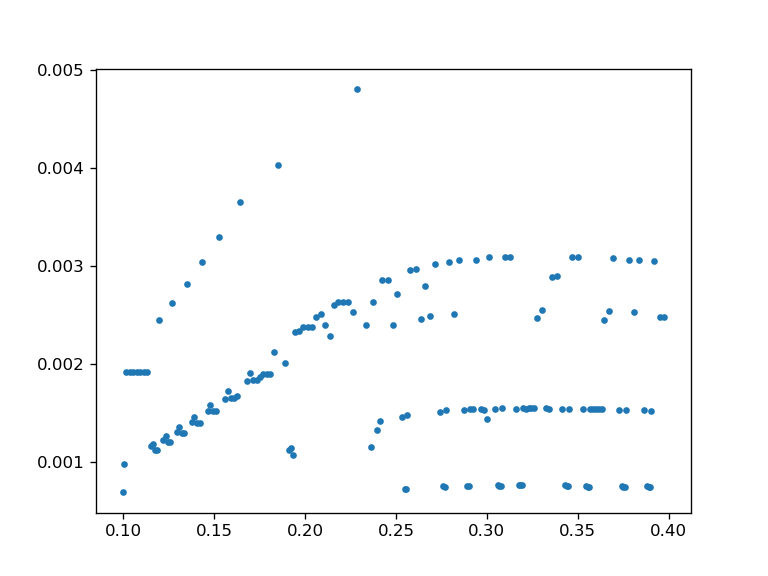

In [962]:
plt.figure()
plt.plot(sol_t[:-1], sol_t[1:]-sol_t[:-1],'.')

<IPython.core.display.Javascript object>


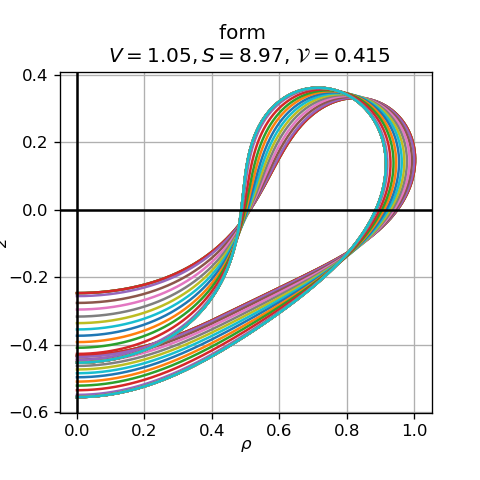

Text(0.5, 1.0, 'form \n $V=1.05, S=8.97$, $\\mathcal{V}=$$0.415$')

In [945]:
%matplotlib notebook
plt.figure(figsize=(4,4))
for t_j in np.linspace(0,t_max,30):#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1.5, label=f't={sol_t[j]:.2f}')


    
    
plt.axis('scaled')
#plt.legend(ncol=2)
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
plt.grid()
plt.title(fr'form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


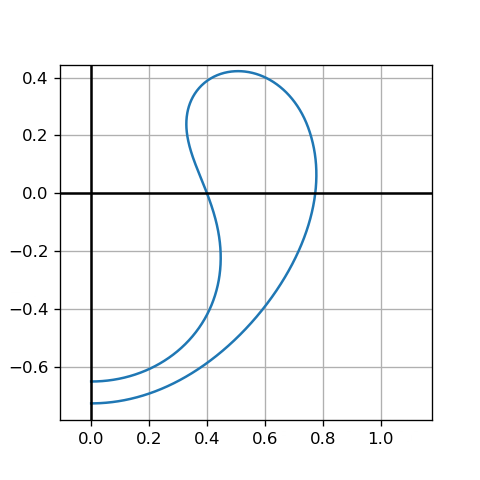

/tmp/ipykernel_7502/2298259793.py:38: UserWarning: frames=None which we can infer the length of, did not pass an explicit *save_count* and passed cache_frame_data=True.  To avoid a possibly unbounded cache, frame data caching has been disabled. To suppress this warning either pass `cache_frame_data=False` or `save_count=MAX_FRAMES`.
  ani = animation.FuncAnimation(


In [656]:
%matplotlib notebook

import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(4,4))
ax.grid()

### Initial state ###
i=0
P_fur_j = np.zeros(N)
P_fur_j[1::]=sol_y[:N-1,i]
Z_fur_j=sol_y[N-1:,i]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)


line, = ax.plot(P,Z,lw=1.5)

ax.axis('scaled')
ax.set_ylim(Z.min()*1.5, Z.max()*1.5)
ax.axvline(0, color='k')
ax.axhline(0, color='k')
#ax.set_title(f'V={a}')

def animate(i):
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,i]
    Z_fur_j=sol_y[N-1:,i]

    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    line.set_ydata(Z);line.set_xdata(P)  # update the data.

    return line,


ani = animation.FuncAnimation(
    fig, animate)

# To save the animation, use e.g.
#
#ani.save(f"dyno_{2.4}.mp4")
#
# or
#
#writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie_{0.511}.mp4", writer=writer)

plt.show()

<IPython.core.display.Javascript object>


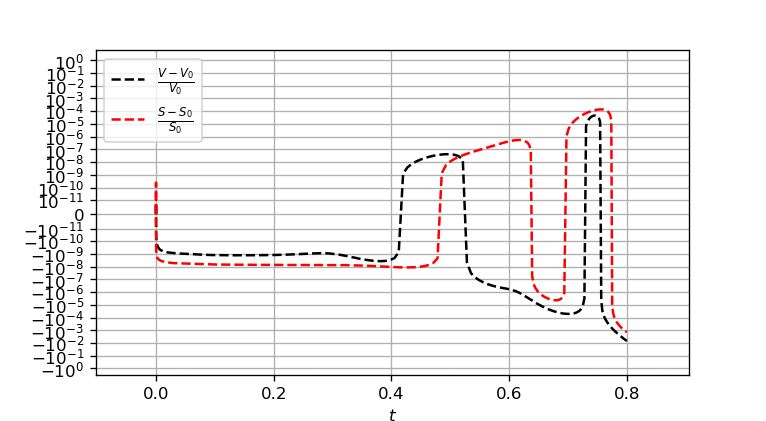

In [657]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_t, Vol_ar/Vol0-1,'--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_t, Sqr_ar/Sqr0-1,'--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-11)

<IPython.core.display.Javascript object>


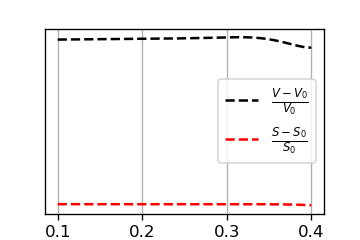

In [963]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_t, Vol_ar/Vol0-1,'--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_t, Sqr_ar/Sqr0-1,'--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-11)

<IPython.core.display.Javascript object>


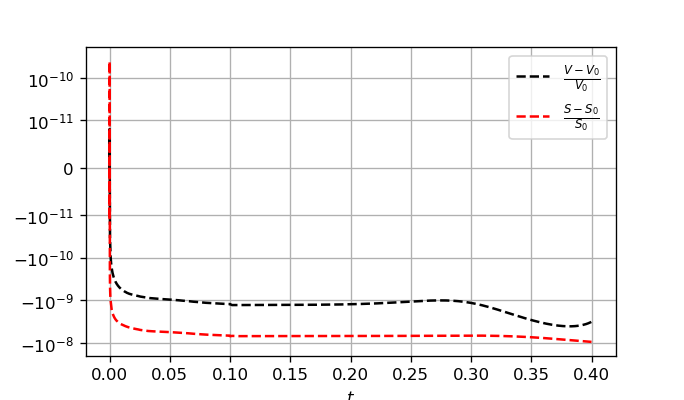

In [798]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_t, Vol_ar/Vol0-1,'--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_t, Sqr_ar/Sqr0-1,'--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-11)

<IPython.core.display.Javascript object>


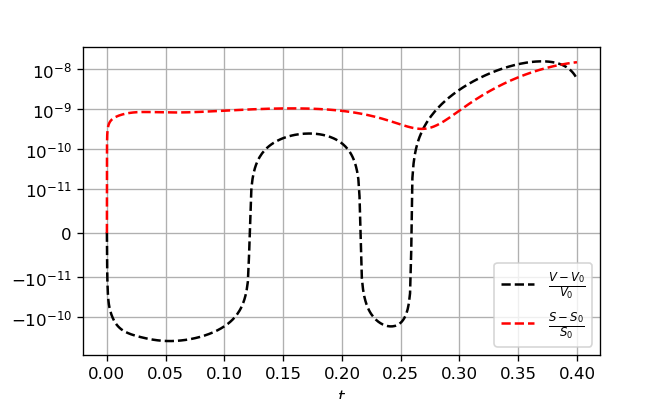

In [423]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_t, Vol_ar/Vol0-1,'--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_t, Sqr_ar/Sqr0-1,'--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-11)

<IPython.core.display.Javascript object>


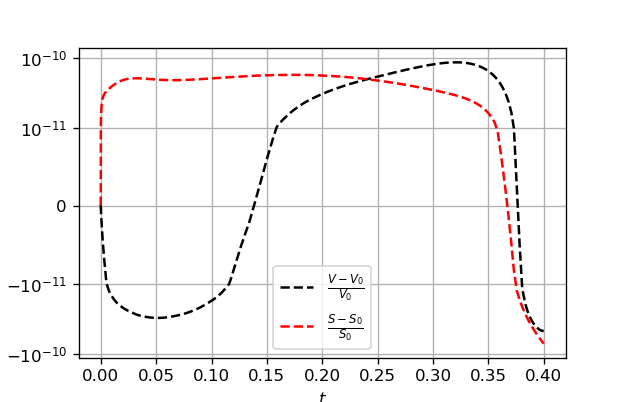

In [500]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_t, Vol_ar/Vol0-1,'--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_t, Sqr_ar/Sqr0-1,'--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-11)

In [947]:
%matplotlib inline
@interact(i=(0,len(sol_t)-1,1))
def plot_PZ_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,i]
    Z_fur_j=sol_y[N-1:,i]

    ax.plot(np.abs(P_fur_j),'.--',lw=1.5)
    ax.plot(np.abs(Z_fur_j),'.--',lw=1.5)
    ax.set_title(f't={sol_t[i]}')
    #ax.axis('scaled')
    ax.set_xlim(0, N)
    ax.set_ylim(1e-12, 1e0)
    ax.set_yscale('log')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=81, description='i', max=162), Output()), _dom_classes=('widget-interact…

In [948]:
%matplotlib inline


@interact(k=(0, N-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1, 2, figsize=(8, 3))
    fig.tight_layout(pad=3.0)
    axs[0].plot(sol_t, sol_y[k+N-1, :], label=fr'Z[{k}]')
    axs[1].plot(sol_t[1:], np.abs(
        (sol_y[k+N-1, 1:]-sol_y[k+N-1, :-1])/(sol_t[1:]-sol_t[:-1])))
    if k > 0:
        axs[0].plot(sol_t, sol_y[k-1, :], label=fr'P[{k}]')
        axs[1].plot(sol_t[1:], np.abs(
            (sol_y[k-1, 1:]-sol_y[k-1, :-1])/(sol_t[1:]-sol_t[:-1])))

    axs[0].grid()
    axs[0].legend()

    axs[1].set_yscale('log')
    #axs[1].set_ylim(1e-11, 1e0)
    axs[1].set_ylabel(r'$|\partial_t|$')
    axs[1].grid()

interactive(children=(IntSlider(value=49, description='k', max=99), Output()), _dom_classes=('widget-interact'…

In [661]:
%matplotlib inline


@interact(k=(0, N-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1, 2, figsize=(8, 3))
    fig.tight_layout(pad=3.0)
    axs[0].plot(sol_t, sol_y[k+N-1, :], label=fr'Z[{k}]')
    axs[1].plot(sol_t[1:], np.abs(
        (sol_y[k+N-1, 1:]-sol_y[k+N-1, :-1])/(sol_t[1:]-sol_t[:-1])))
    if k > 0:
        axs[0].plot(sol_t, sol_y[k-1, :], label=fr'P[{k}]')
        axs[1].plot(sol_t[1:], np.abs(
            (sol_y[k-1, 1:]-sol_y[k-1, :-1])/(sol_t[1:]-sol_t[:-1])))

    axs[0].grid()
    axs[0].legend()

    axs[1].set_yscale('log')
    #axs[1].set_ylim(1e-11, 1e0)
    axs[1].set_ylabel(r'$|\partial_t|$')
    axs[1].grid()

interactive(children=(IntSlider(value=39, description='k', max=79), Output()), _dom_classes=('widget-interact'…

In [799]:
%matplotlib inline


@interact(k=(0, N-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1, 2, figsize=(8, 3))
    fig.tight_layout(pad=3.0)
    axs[0].plot(sol_t, sol_y[k+N-1, :], label=fr'Z[{k}]')
    axs[1].plot(sol_t[1:], np.abs(
        (sol_y[k+N-1, 1:]-sol_y[k+N-1, :-1])/(sol_t[1:]-sol_t[:-1])))
    if k > 0:
        axs[0].plot(sol_t, sol_y[k-1, :], label=fr'P[{k}]')
        axs[1].plot(sol_t[1:], np.abs(
            (sol_y[k-1, 1:]-sol_y[k-1, :-1])/(sol_t[1:]-sol_t[:-1])))

    axs[0].grid()
    axs[0].legend()

    axs[1].set_yscale('log')
    #axs[1].set_ylim(1e-11, 1e0)
    axs[1].set_ylabel(r'$|\partial_t|$')
    axs[1].grid()

interactive(children=(IntSlider(value=39, description='k', max=79), Output()), _dom_classes=('widget-interact'…

In [901]:
%matplotlib inline


@interact(k=(0, N-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1, 2, figsize=(8, 3))
    fig.tight_layout(pad=3.0)
    axs[0].plot(sol_t, sol_y[k+N-1, :], label=fr'Z[{k}]')
    axs[1].plot(sol_t[1:], np.abs(
        (sol_y[k+N-1, 1:]-sol_y[k+N-1, :-1])/(sol_t[1:]-sol_t[:-1])))
    if k > 0:
        axs[0].plot(sol_t, sol_y[k-1, :], label=fr'P[{k}]')
        axs[1].plot(sol_t[1:], np.abs(
            (sol_y[k-1, 1:]-sol_y[k-1, :-1])/(sol_t[1:]-sol_t[:-1])))

    axs[0].grid()
    axs[0].legend()

    axs[1].set_yscale('log')
    #axs[1].set_ylim(1e-11, 1e0)
    axs[1].set_ylabel(r'$|\partial_t|$')
    axs[1].grid()

interactive(children=(IntSlider(value=39, description='k', max=79), Output()), _dom_classes=('widget-interact'…

In [481]:
%matplotlib inline


@interact(k=(0, N-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1, 2, figsize=(8, 3))
    fig.tight_layout(pad=3.0)
    axs[0].plot(sol_t, sol_y[k+N-1, :], label=fr'Z[{k}]')
    axs[1].plot(sol_t[1:], np.abs(
        (sol_y[k+N-1, 1:]-sol_y[k+N-1, :-1])/(sol_t[1:]-sol_t[:-1])))
    if k > 0:
        axs[0].plot(sol_t, sol_y[k-1, :], label=fr'P[{k}]')
        axs[1].plot(sol_t[1:], np.abs(
            (sol_y[k-1, 1:]-sol_y[k-1, :-1])/(sol_t[1:]-sol_t[:-1])))

    axs[0].grid()
    axs[0].legend()
    axs[1].set_yscale('log')
    #axs[1].set_ylim(1e-11, 1e0)
    axs[1].set_ylabel(r'$|\partial_t|$')
    axs[1].grid()

interactive(children=(IntSlider(value=34, description='k', max=69), Output()), _dom_classes=('widget-interact'…

#### $\sigma(t)$

In [504]:
sigma_arr =[]
#t_range = np.linspace(0,t_max,50)
H_arr = []
force_arr = []
t_range = sol_t[::max(1,len(sol_t)//50)]

for t_j in tqdm(t_range):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]

    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
    V = np.sqrt(P1**2+Z1**2)
    
    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    H_arr.append(H)
    force_arr.append(force)
    ### find surface tension ###
    sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)
    sigma_arr.append(sigma_fur)
sigma_arr=np.array(sigma_arr)
H_arr=np.array(H_arr)
force_arr=np.array(force_arr)


  0%|          | 0/58 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


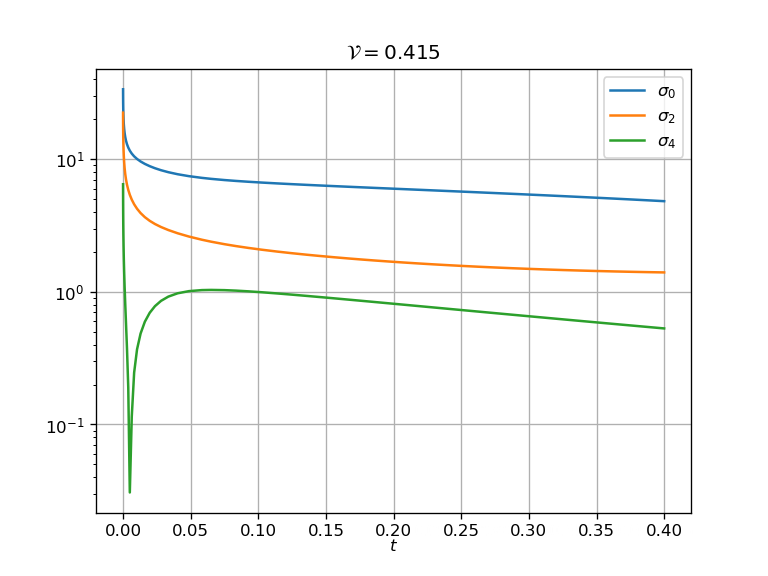

Text(0.5, 1.0, '$\\mathcal{V}=$$0.415$')

In [505]:
plt.figure()
plt.plot(t_range, np.abs(sigma_arr[:,0]), label=r'$\sigma_0$')
plt.plot(t_range,np.abs(sigma_arr[:,2]), label=r'$\sigma_2$')
plt.plot(t_range,np.abs(sigma_arr[:,4]), label=r'$\sigma_4$')

plt.yscale('log')
#plt.plot(t_range,sigma_arr[:,1], label=r'$\sigma_1$')
plt.grid()
plt.legend()
plt.xlabel(r'$t$', labelpad=-1)
#plt.ylabel(r'$z$', labelpad=-1)
#Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
#
plt.title(r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

In [363]:
%matplotlib inline
@interact(i=(0,len(t_range)-1,1))
def plot_sigma_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(np.abs(sigma_arr[i]),'o--',lw=1.5)
    ax.set_yscale('log')
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=25, description='i', max=51), Output()), _dom_classes=('widget-interact'…

In [949]:
force_arr =[]
force_fur_arr =[]

t_range = sol_t[::]
#t_range = sol_t[::10]
for t_j in tqdm(t_range):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]

    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
    V = np.sqrt(P1**2+Z1**2)
    
    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    force_fur = np.fft.rfft(get_ext_array(force), norm='forward')
    force_arr.append(force)
    force_fur_arr.append(force_fur)
force_arr=np.array(force_arr)
force_fur_arr=np.array(force_fur_arr)

  0%|          | 0/163 [00:00<?, ?it/s]

In [950]:
%matplotlib notebook
@interact(i=(0,len(t_range)-1,1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(force_arr[i],lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=81, description='i', max=162), Output()), _dom_classes=('widget-interact…

In [903]:
%matplotlib notebook
@interact(i=(0,len(t_range)-1,1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(force_arr[i],lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=303, description='i', max=606), Output()), _dom_classes=('widget-interac…

In [867]:
%matplotlib notebook
@interact(i=(0,len(t_range)-1,1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(force_arr[i],lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=303, description='i', max=606), Output()), _dom_classes=('widget-interac…

In [515]:
%matplotlib notebook
@interact(i=(0,len(t_range)-1,1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(force_arr[i],lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=142, description='i', max=285), Output()), _dom_classes=('widget-interac…

In [199]:
%matplotlib inline
@interact(i=(0,len(t_range)-1,1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(force_arr[i],lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=625, description='i', max=1250), Output()), _dom_classes=('widget-intera…

In [951]:
%matplotlib inline
@interact(i=(0,len(t_range)-1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(np.abs(force_fur_arr[i]),'.--',lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')
    ax.set_xlim(0, 4*N)
    ax.set_ylim(1e-10, 1e3)
    ax.set_yscale('log')

interactive(children=(IntSlider(value=81, description='i', max=162), Output()), _dom_classes=('widget-interact…

In [664]:
%matplotlib inline
@interact(i=(0,len(t_range)-1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(np.abs(force_fur_arr[i]),'.--',lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')
    ax.set_xlim(0, 4*N)
    ax.set_ylim(1e-10, 1e3)
    ax.set_yscale('log')

interactive(children=(IntSlider(value=239, description='i', max=479), Output()), _dom_classes=('widget-interac…

In [803]:
%matplotlib inline
@interact(i=(0,len(t_range)-1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(np.abs(force_fur_arr[i]),'.--',lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')
    ax.set_xlim(0, 4*N)
    ax.set_ylim(1e-10, 1e3)
    ax.set_yscale('log')

interactive(children=(IntSlider(value=310, description='i', max=620), Output()), _dom_classes=('widget-interac…

In [201]:
%matplotlib inline
@interact(i=(0,len(t_range)-1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(np.abs(force_fur_arr[i]),'.--',lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')
    ax.set_xlim(0, 4*N)
    ax.set_ylim(1e-10, 1e3)
    ax.set_yscale('log')

interactive(children=(IntSlider(value=625, description='i', max=1250), Output()), _dom_classes=('widget-intera…

<IPython.core.display.Javascript object>


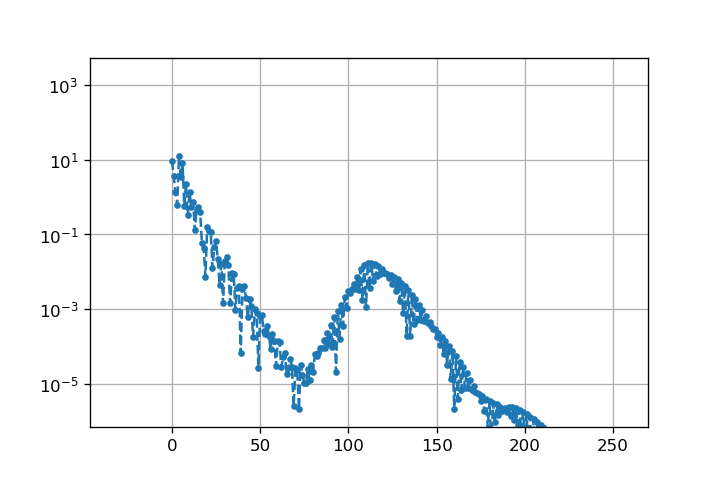

/tmp/ipykernel_7502/2842561413.py:28: UserWarning: frames=None which we can infer the length of, did not pass an explicit *save_count* and passed cache_frame_data=True.  To avoid a possibly unbounded cache, frame data caching has been disabled. To suppress this warning either pass `cache_frame_data=False` or `save_count=MAX_FRAMES`.
  ani = animation.FuncAnimation(


In [509]:
#N_frames = 50*10

%matplotlib notebook



import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(6,4))
ax.grid()



line, = ax.plot(np.abs(force_fur_arr[0]),'.--',lw=1.5)
ax.set_yscale('log')
#ax.axis('scaled')
ax.set_xlim(0, 2*N)
#ax.axvline(0, color='k')
#ax.axhline(0, color='k')
#ax.set_title(f'a={a}')
def animate(i):

    line.set_ydata(np.abs(force_fur_arr[i]))  # update the data.
    
    return line,


ani = animation.FuncAnimation(
    fig, animate)

# To save the animation, use e.g.
#
#ani.save(f"dyno_{2.4}.mp4")
#
# or
#
#writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie_{0.511}.mp4", writer=writer)

plt.show()

### State analys

In [952]:
t_j=0.4
j=np.argmin(np.abs(t_j-sol_t))
P_fur_j = np.zeros(N)
P_fur_j[1::] = sol_y[:N-1, j]
Z_fur_j = sol_y[N-1:, j].copy()

In [953]:
sol_t[j]

0.4

In [954]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 

### find surface tension ###
sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)

(-0.04578177582056278,
 0.9614172922318183,
 -0.6011585170304256,
 0.4071440670043377)

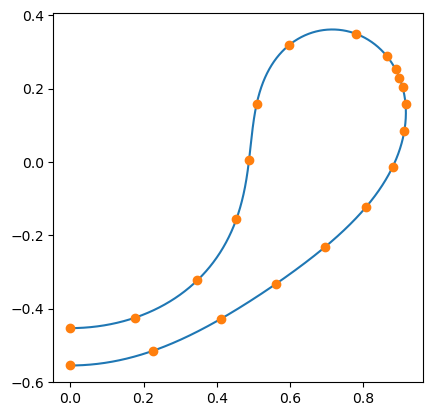

In [955]:
plt.figure()
plt.plot(P,Z)
plt.plot(P[::N_int//20],Z[::N_int//20],'o')

plt.axis('scaled')

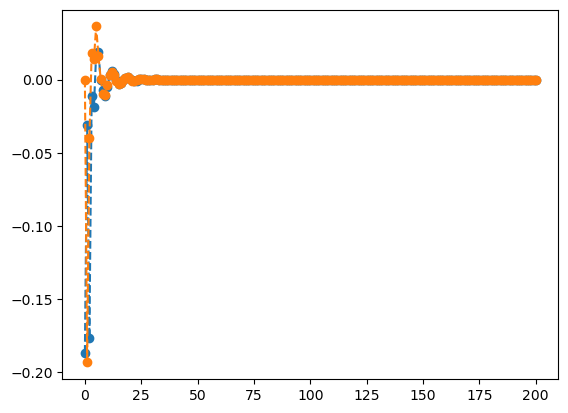

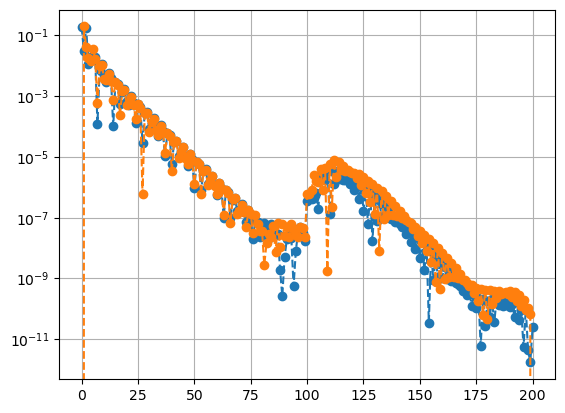

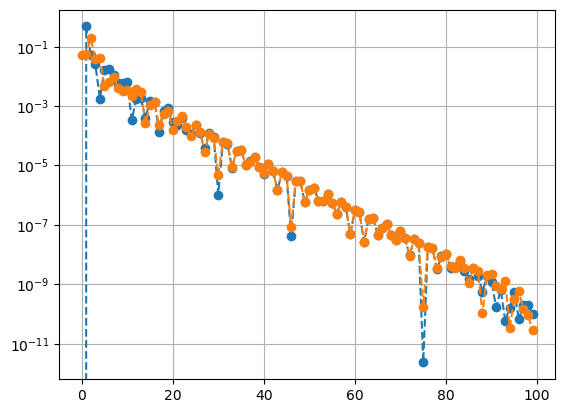

In [956]:
V_rho_fur, V_z_fur = get_velo_fur_full(P_fur_j, Z_fur_j)
plt.figure()
plt.plot(V_z_fur,'o--')
plt.plot(V_rho_fur,'o--')

plt.figure()
plt.plot(np.abs(V_z_fur),'o--')
plt.plot(np.abs(V_rho_fur),'o--')
plt.grid()
plt.yscale('log')

plt.figure()
plt.plot(np.abs(P_fur_j),'o--')
plt.plot(np.abs(Z_fur_j),'o--')
plt.grid()
plt.yscale('log')

(-0.04578177582056278,
 0.9614172922318183,
 -0.6011585170304256,
 0.4071440670043377)

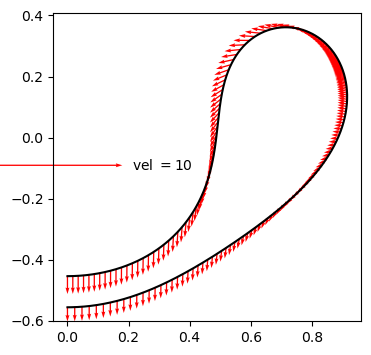

In [957]:
t_ = get_velo(P_fur_j, Z_fur_j)
fig = plt.figure(figsize = (4,4))
ax = fig.add_subplot(1, 1, 1)

#ax.scatter(p0, z0,s=6)
#qk = ax.quiverkey(Q, 0.4, 0.5, 100, r'$v=100$', labelpos='E',
#                  coordinates='figure')
plt.plot(P, Z,'k')

Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], t_[0],t_[1], color='red')
qk = ax.quiverkey(Qnow, 0.3, 0.5, 10, r'vel $=10$', labelpos='E',
                  coordinates='figure')
ax.axis('scaled')
#Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], 
#                 (force/V*(-Z1))[::N_int//n_int],(force/V*P1)[::N_int//n_int], color='blue')
#qk = ax.quiverkey(Qnow, 0.8, 0.8, 10, r'f $=10$', labelpos='E',
#                  coordinates='figure')

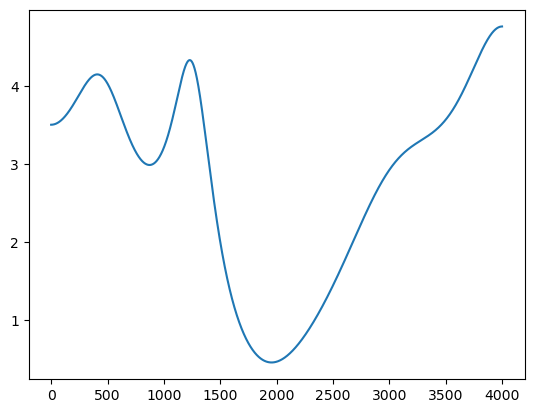

In [958]:
plt.figure()
plt.plot(V)

In [959]:
def get_plot_field(field, tp='z'):
    field_fur = np.fft.rfft(get_ext_array(field,tp), norm='forward')
    field_fur_ext = np.zeros(N_int)+0j
    field_fur_ext[:field_fur.shape[0]-1] = field_fur[:field_fur.shape[0]-1]
    field_fur_ext[field_fur.shape[0]-1] = field_fur[field_fur.shape[0]-1]/2
    field_N_int = np.fft.irfft(field_fur_ext, n=2*N_int,norm='forward')[:N_int+1]
    return field_N_int

<IPython.core.display.Javascript object>


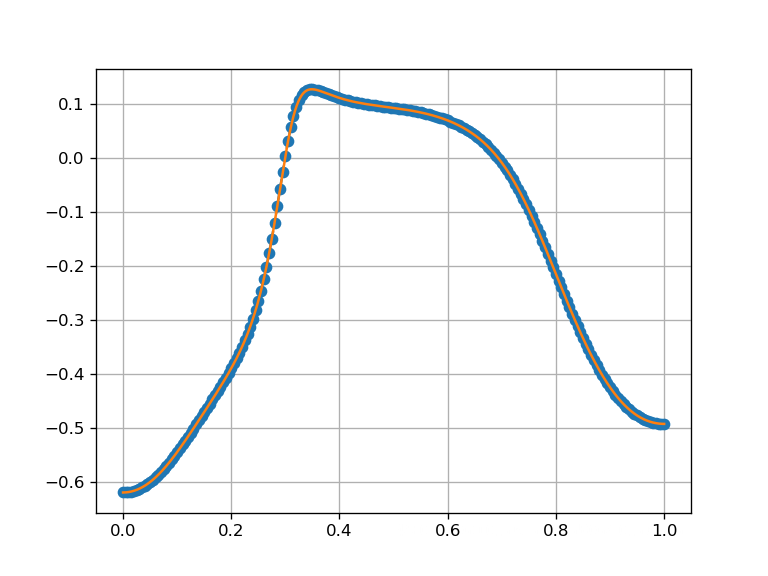

<IPython.core.display.Javascript object>


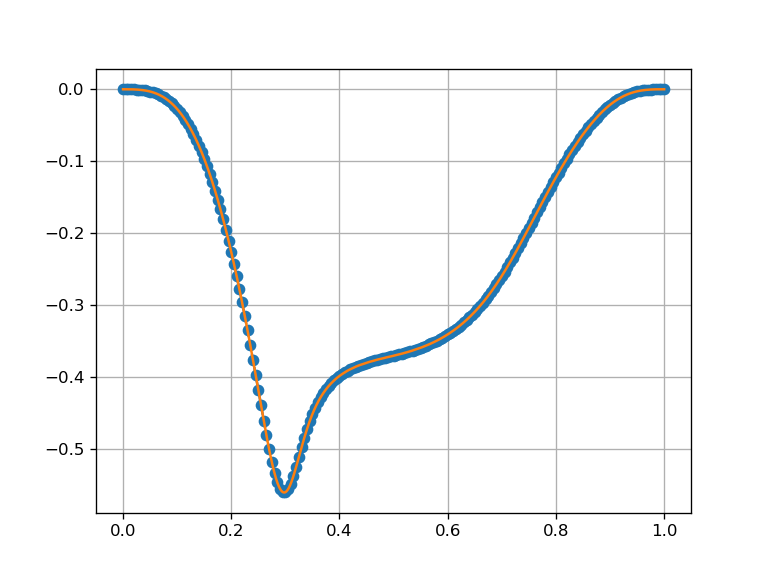

In [960]:
%matplotlib notebook
V_rho, V_z = get_velo(P_fur_j, Z_fur_j)
plt.figure()
plt.plot(tau_int, V_z,'o--')
plt.plot(Tau_int, get_plot_field(V_z, tp='z'),'-')
plt.grid()

plt.figure()
plt.plot(tau_int, V_rho,'o--')
plt.plot(Tau_int, get_plot_field(V_rho, tp='p'),'-')
plt.grid()
#plt.plot(Tau_int, force)

<IPython.core.display.Javascript object>


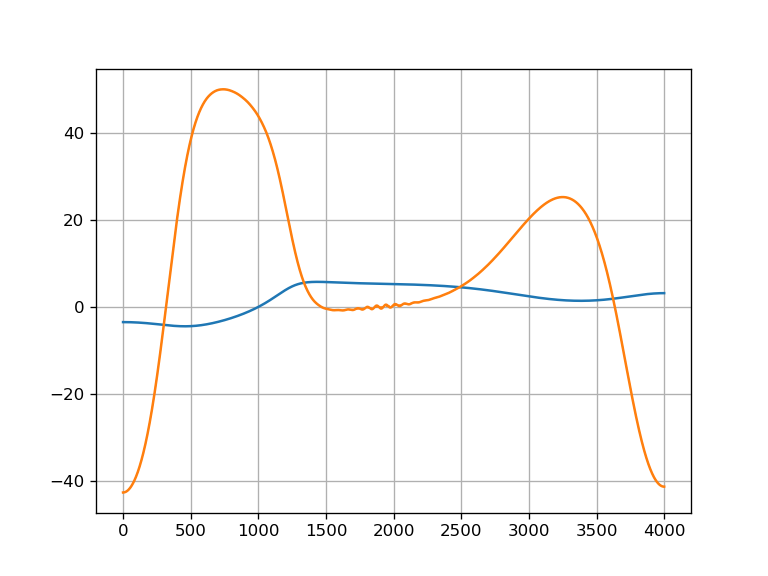

<IPython.core.display.Javascript object>


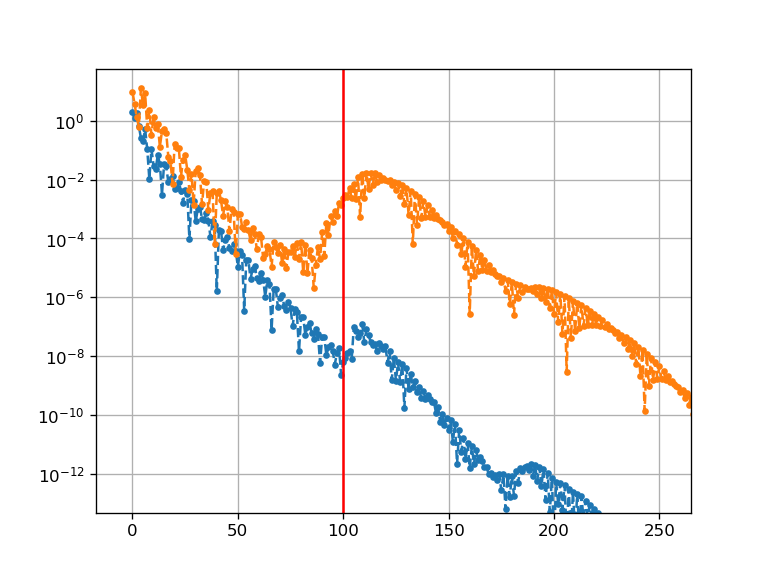

In [961]:
%matplotlib notebook
plt.figure()
plt.plot(H)


force_fur = np.fft.rfft(get_ext_array(force), norm='forward')
force_filt = np.fft.irfft(force_fur[:N], norm='forward', n=2*N_int)[:N_int+1]

line = plt.plot(force, label=f'N={N}')
plt.plot(force_filt,'--',lw=0.7, color=line[0].get_color())


plt.grid()




plt.figure()
plt.plot(np.abs(np.fft.rfft(get_ext_array(H), norm='forward')), '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(force), norm='forward')), '.--')






plt.yscale('log')
plt.axvline(N,color='red')
plt.xlim(0,4*N)
plt.ylim(1e-8,1e2)

plt.grid()

<IPython.core.display.Javascript object>


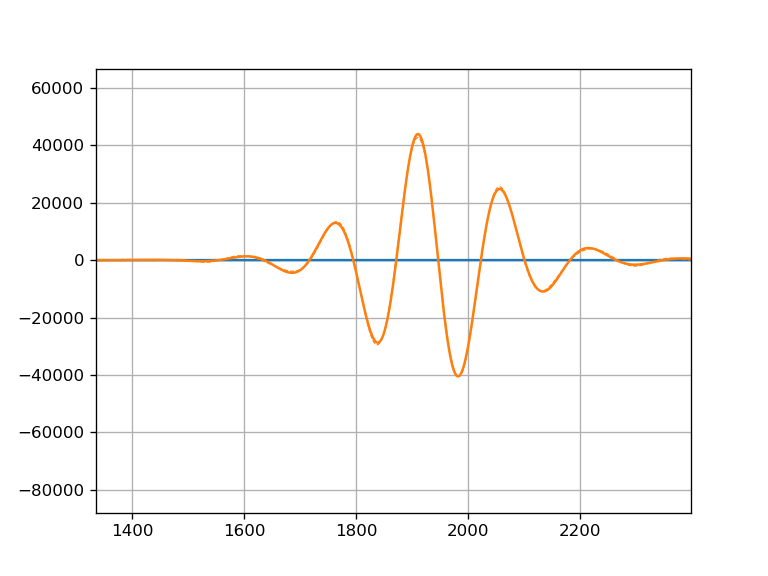

<IPython.core.display.Javascript object>


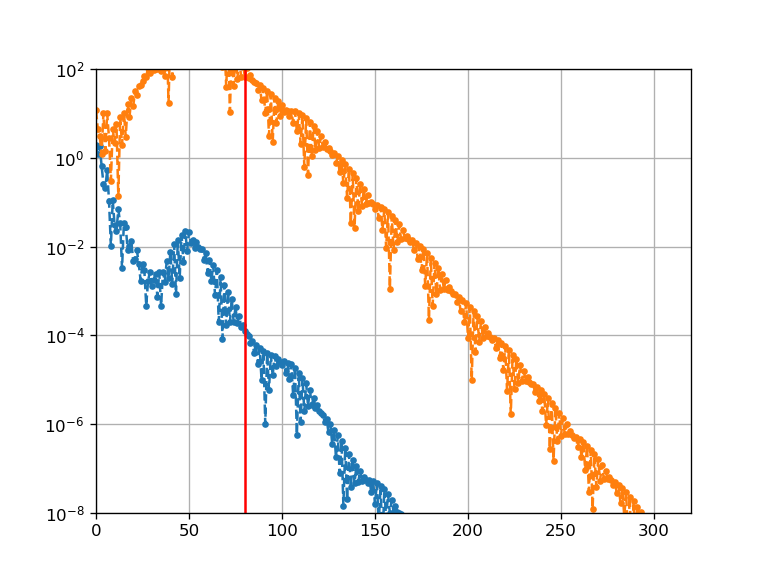

In [915]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j[:50])
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j[:50])
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 



plt.figure()
plt.plot(H)


force_fur = np.fft.rfft(get_ext_array(force), norm='forward')
force_filt = np.fft.irfft(force_fur[:N], norm='forward', n=2*N_int)[:N_int+1]

line = plt.plot(force, label=f'N={N}')
plt.plot(force_filt,'--',lw=0.7, color=line[0].get_color())


plt.grid()




plt.figure()
plt.plot(np.abs(np.fft.rfft(get_ext_array(H), norm='forward')), '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(force), norm='forward')), '.--')






plt.yscale('log')
plt.axvline(N,color='red')
plt.xlim(0,4*N)
plt.ylim(1e-8,1e2)

plt.grid()


<IPython.core.display.Javascript object>


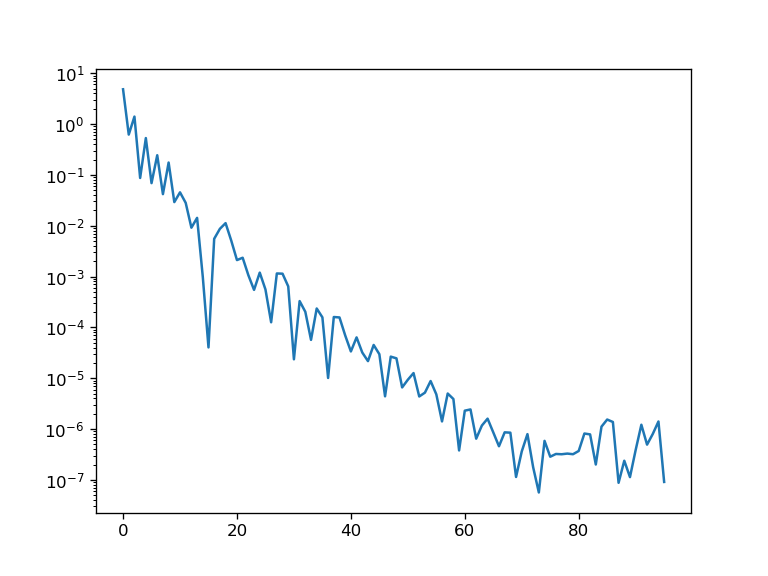

In [916]:
plt.figure()
plt.plot(np.abs(
get_sigma_fur_from_arr(P_fur_j, Z_fur_j)))
plt.yscale('log')

<IPython.core.display.Javascript object>


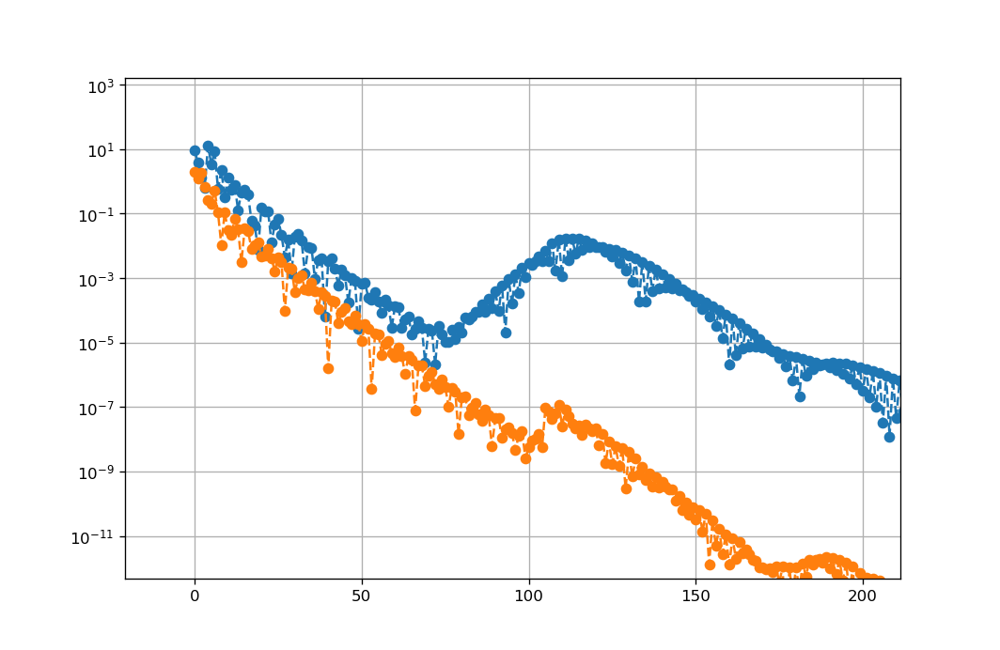

In [519]:
%matplotlib notebook
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
force_fur = np.fft.rfft(get_ext_array(force), norm='forward')
H_fur = np.fft.rfft(get_ext_array(H), norm='forward')

plt.figure()
plt.plot(np.abs(force_fur),'o--')
plt.plot(np.abs(H_fur),'o--')
plt.grid()
plt.xlim(0,4*N)
plt.yscale('log')

In [841]:
jac_norm_fun_steps = nd.Jacobian(lambda normal_delta_fur:
                        get_normal_velo_normal_delta(P_fur_j, Z_fur_j, normal_delta_fur), 
                                 step=1e-7)

In [842]:
jac_norm_steps = jac_norm_fun_steps(np.zeros(N))

In [843]:
w_steps,vr_steps =sc.linalg.eig(jac_norm_steps[N-20:N,N-20:N])

In [844]:
np.sort((w_steps))[::-1][:5]

array([-31446.18292612   +0.j        , -39325.89562198   +0.j        ,
       -41785.31342013+1737.53416728j, -41785.31342013-1737.53416728j,
       -49877.62732393   +0.j        ])

In [845]:
w_steps,vr_steps =sc.linalg.eig(jac_norm_steps)

In [846]:
np.sort((w_steps))[::-1][:5]

array([ 0.83279837+0.j        , -0.08401364+1.76734991j,
       -0.08401364-1.76734991j, -0.59921343+0.j        ,
       -2.59678777+0.j        ])

In [847]:
print(f'{w_steps.min():.2e}')
print(f'{1/w_steps.min():.2e}')

-1.81e+07+0.00e+00j
-5.53e-08-0.00e+00j


#### change n_int, N_int

In [768]:
N_ext_sigma=16

In [872]:
v_z_n_int = {}
for n_int in [100,150,200]:
    N_int = n_int*30
    
    Tau_int = np.arange(N_int+1)/(N_int)
    tau_int = np.arange(n_int+1)/(n_int)
    
    dtau_int = tau_int.reshape(-1,1) - Tau_int.reshape(1,-1) 
    
    weights_simp1 = np.zeros_like(Tau_int)
    weights_simp2 = np.zeros_like(Tau_int)
    
    weights_simp1 +=1
    weights_simp1[0]=1/2; weights_simp1[-1]=1/2
    
    weights_simp2[::2] +=1
    weights_simp2[::2][0]=1/2; weights_simp2[::2][-1]=1/2
    
    weights_simp = 4/3*weights_simp1 - 2/3*weights_simp2
    weights_simp /= N_int
    
    Kron = (np.abs(dtau_int)<1e-6)
    AKron = ~Kron
    
    
    V_rho_fur_, V_z_fur_ = get_velo_fur_full(P_fur_j, Z_fur_j)
    v_z_n_int[n_int] = V_z_fur_

<IPython.core.display.Javascript object>


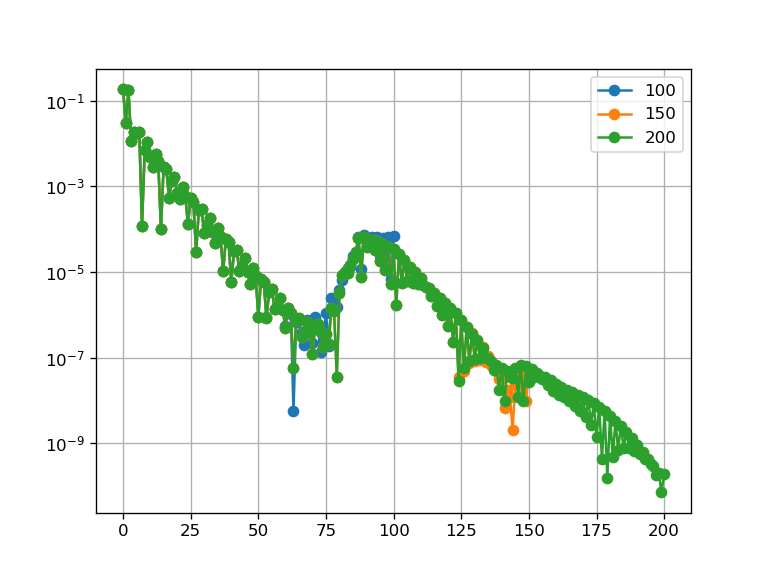

In [873]:
plt.figure()
plt.plot(np.abs(v_z_n_int[100]),'o-',label='100')
plt.plot(np.abs(v_z_n_int[150]),'o-',label='150')
plt.plot(np.abs(v_z_n_int[200]),'o-',label='200')

plt.legend()
#plt.plot(np.abs(V_rho_fur),'o--')
plt.grid()
plt.yscale('log')

<IPython.core.display.Javascript object>


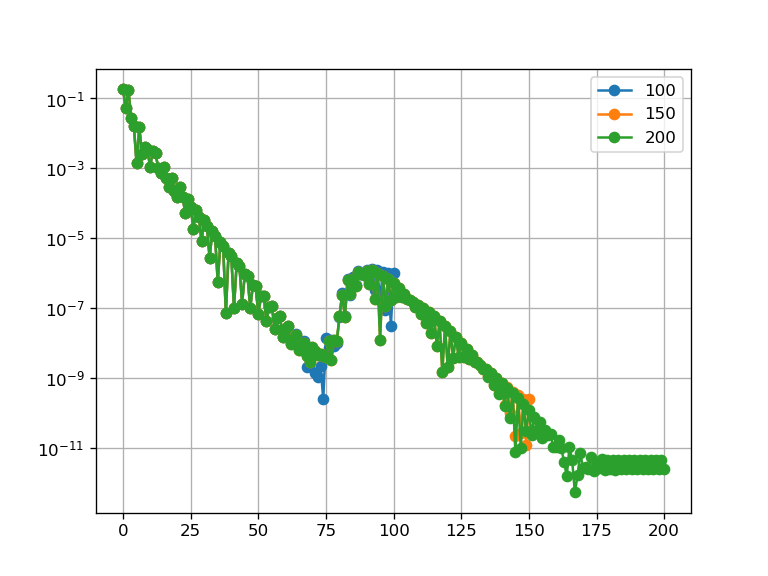

In [765]:
plt.figure()
plt.plot(np.abs(v_z_n_int[100]),'o-',label='100')
plt.plot(np.abs(v_z_n_int[150]),'o-',label='150')
plt.plot(np.abs(v_z_n_int[200]),'o-',label='200')

plt.legend()
#plt.plot(np.abs(V_rho_fur),'o--')
plt.grid()
plt.yscale('log')

### Demonstarte thick

In [1053]:
data = np.load('dyn_bdf_p1=1.000_z1=0.400_z2=-0.250_to_t=15_N=50_n_int=80_BDF_atol=1.00e-07.npy', allow_pickle=True).item()
sol_t = data['t']
sol_y = data['y']
t_max=10

In [1054]:
N=50

j_N = np.arange(N+1)
tau_N = j_N/N


n_int = 80
N_int = n_int*20

Tau_int = np.arange(N_int+1)/(N_int)
tau_int = np.arange(n_int+1)/(n_int)

dtau_int = tau_int.reshape(-1,1) - Tau_int.reshape(1,-1) 

weights_simp1 = np.zeros_like(Tau_int)
weights_simp2 = np.zeros_like(Tau_int)

weights_simp1 +=1
weights_simp1[0]=1/2; weights_simp1[-1]=1/2

weights_simp2[::2] +=1
weights_simp2[::2][0]=1/2; weights_simp2[::2][-1]=1/2

weights_simp = 4/3*weights_simp1 - 2/3*weights_simp2
weights_simp /= N_int

Kron = (np.abs(dtau_int)<1e-6)
AKron = ~Kron

#### Dynamic analys

<IPython.core.display.Javascript object>


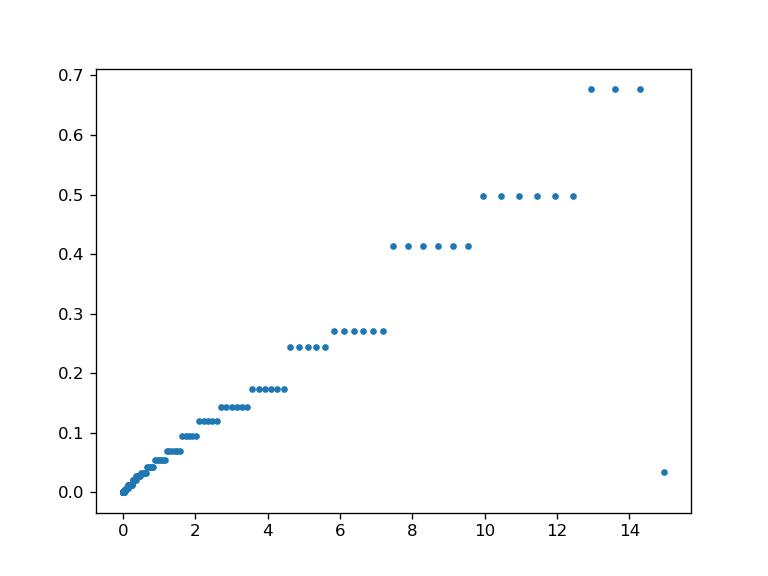

In [1055]:
plt.figure()
plt.plot(sol_t[:-1], sol_t[1:]-sol_t[:-1],'.')

<IPython.core.display.Javascript object>


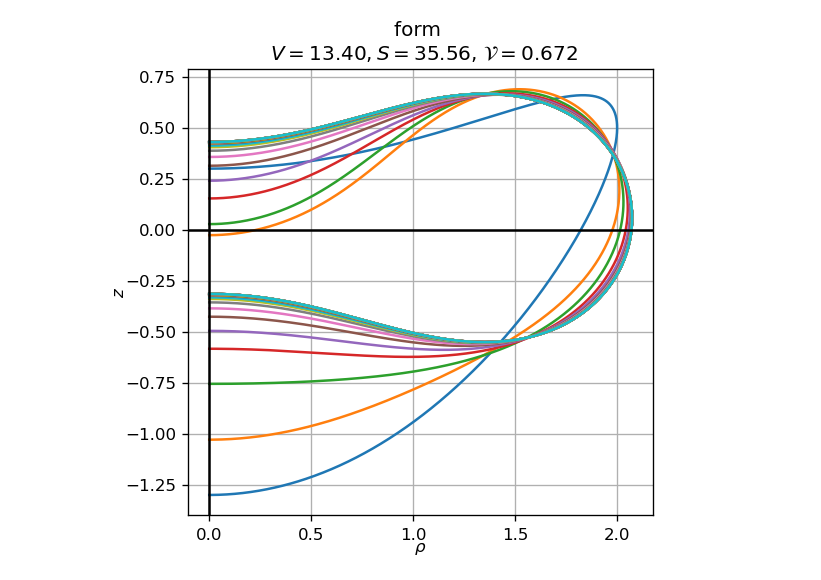

Text(0.5, 1.0, 'form \n $V=13.40, S=35.56$, $\\mathcal{V}=$$0.672$')

In [1056]:
%matplotlib notebook
plt.figure(figsize=(4,4))
t_max = 20
for t_j in np.linspace(0,t_max,30):#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1.5, label=f't={sol_t[j]:.2f}')


    
    
plt.axis('scaled')
#plt.legend(ncol=2)
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)

P_fur0 = np.zeros(N)
P_fur0[1::]=sol_y[:N-1,0]
Z_fur0=sol_y[N-1:,0]


Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
plt.grid()
plt.title(fr'form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


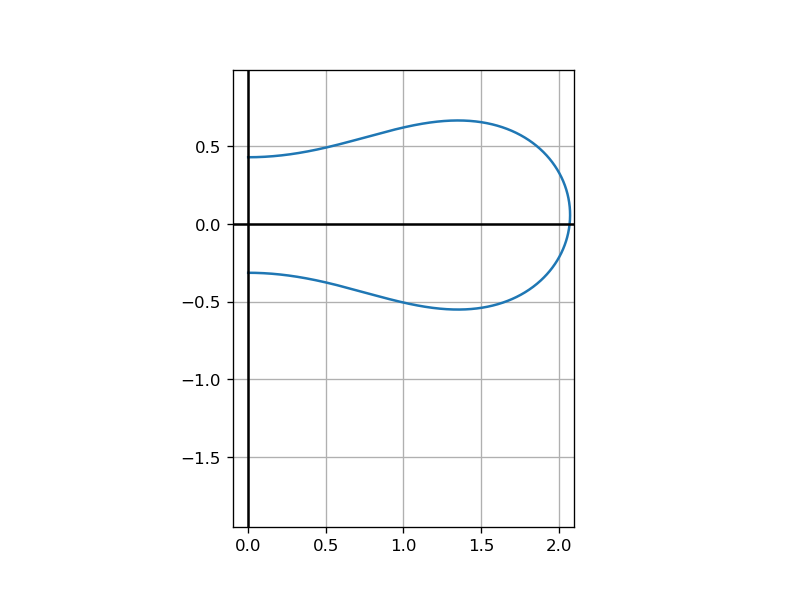

/tmp/ipykernel_7502/2298259793.py:38: UserWarning: frames=None which we can infer the length of, did not pass an explicit *save_count* and passed cache_frame_data=True.  To avoid a possibly unbounded cache, frame data caching has been disabled. To suppress this warning either pass `cache_frame_data=False` or `save_count=MAX_FRAMES`.
  ani = animation.FuncAnimation(


In [1057]:
%matplotlib notebook

import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(4,4))
ax.grid()

### Initial state ###
i=0
P_fur_j = np.zeros(N)
P_fur_j[1::]=sol_y[:N-1,i]
Z_fur_j=sol_y[N-1:,i]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)


line, = ax.plot(P,Z,lw=1.5)

ax.axis('scaled')
ax.set_ylim(Z.min()*1.5, Z.max()*1.5)
ax.axvline(0, color='k')
ax.axhline(0, color='k')
#ax.set_title(f'V={a}')

def animate(i):
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,i]
    Z_fur_j=sol_y[N-1:,i]

    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    line.set_ydata(Z);line.set_xdata(P)  # update the data.

    return line,


ani = animation.FuncAnimation(
    fig, animate)

# To save the animation, use e.g.
#
#ani.save(f"dyno_{2.4}.mp4")
#
# or
#
#writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie_{0.511}.mp4", writer=writer)

plt.show()

<IPython.core.display.Javascript object>


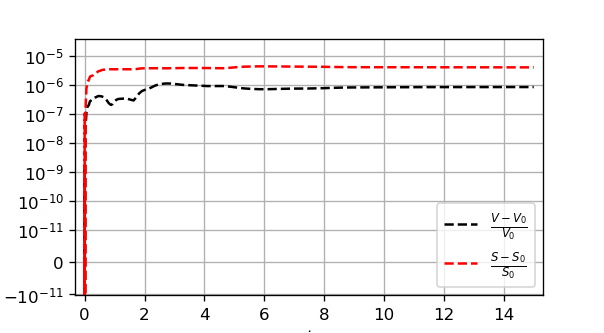

In [1007]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_t, Vol_ar/Vol0-1,'--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_t, Sqr_ar/Sqr0-1,'--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-11)

In [1008]:
%matplotlib inline
@interact(i=(0,len(sol_t)-1,1))
def plot_PZ_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,i]
    Z_fur_j=sol_y[N-1:,i]

    ax.plot(np.abs(P_fur_j),'.--',lw=1.5)
    ax.plot(np.abs(Z_fur_j),'.--',lw=1.5)
    ax.set_title(f't={sol_t[i]}')
    #ax.axis('scaled')
    ax.set_xlim(0, N)
    ax.set_ylim(1e-12, 1e0)
    ax.set_yscale('log')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=83, description='i', max=166), Output()), _dom_classes=('widget-interact…

In [1009]:
%matplotlib inline


@interact(k=(0, N-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1, 2, figsize=(8, 3))
    fig.tight_layout(pad=3.0)
    axs[0].plot(sol_t, sol_y[k+N-1, :], label=fr'Z[{k}]')
    axs[1].plot(sol_t[1:], np.abs(
        (sol_y[k+N-1, 1:]-sol_y[k+N-1, :-1])/(sol_t[1:]-sol_t[:-1])))
    if k > 0:
        axs[0].plot(sol_t, sol_y[k-1, :], label=fr'P[{k}]')
        axs[1].plot(sol_t[1:], np.abs(
            (sol_y[k-1, 1:]-sol_y[k-1, :-1])/(sol_t[1:]-sol_t[:-1])))

    axs[0].grid()
    axs[0].legend()

    axs[1].set_yscale('log')
    #axs[1].set_ylim(1e-11, 1e0)
    axs[1].set_ylabel(r'$|\partial_t|$')
    axs[1].grid()

interactive(children=(IntSlider(value=24, description='k', max=49), Output()), _dom_classes=('widget-interact'…

In [1058]:
force_arr =[]
force_fur_arr =[]

t_range = sol_t[::]
#t_range = sol_t[::10]
for t_j in tqdm(t_range):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]

    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
    V = np.sqrt(P1**2+Z1**2)
    
    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    force_fur = np.fft.rfft(get_ext_array(force), norm='forward')
    force_arr.append(force)
    force_fur_arr.append(force_fur)
force_arr=np.array(force_arr)
force_fur_arr=np.array(force_fur_arr)

  0%|          | 0/167 [00:00<?, ?it/s]

In [1059]:
%matplotlib inline
@interact(i=(0,len(t_range)-1,1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(force_arr[i],lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=83, description='i', max=166), Output()), _dom_classes=('widget-interact…

<IPython.core.display.Javascript object>


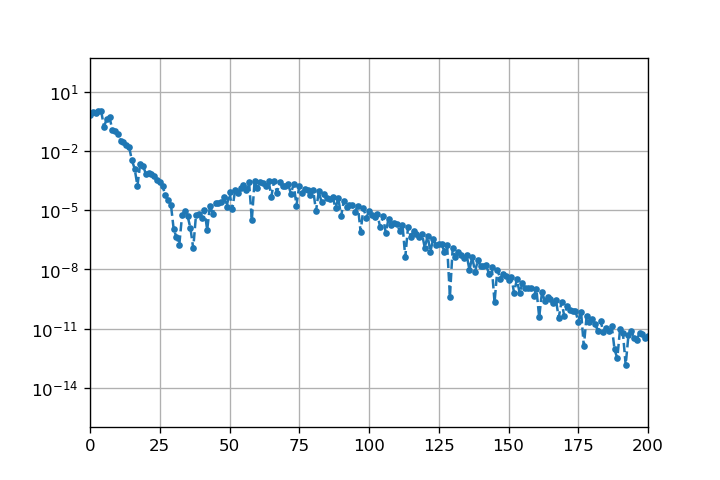

/tmp/ipykernel_7502/101124087.py:28: UserWarning: frames=None which we can infer the length of, did not pass an explicit *save_count* and passed cache_frame_data=True.  To avoid a possibly unbounded cache, frame data caching has been disabled. To suppress this warning either pass `cache_frame_data=False` or `save_count=MAX_FRAMES`.
  ani = animation.FuncAnimation(


In [1060]:
#N_frames = 50*10

%matplotlib notebook



import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(6,4))
ax.grid()



line, = ax.plot(np.abs(force_fur_arr[0]),'.--',lw=1.5)
ax.set_yscale('log')
#ax.axis('scaled')
ax.set_xlim(0, 4*N)
#ax.axvline(0, color='k')
#ax.axhline(0, color='k')
#ax.set_title(f'a={a}')
def animate(i):

    line.set_ydata(np.abs(force_fur_arr[i]))  # update the data.
    
    return line,


ani = animation.FuncAnimation(
    fig, animate)

# To save the animation, use e.g.
#
#ani.save(f"dyno_{2.4}.mp4")
#
# or
#
#writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie_{0.511}.mp4", writer=writer)

plt.show()

#### State analys

In [1061]:
t_j=15
j=np.argmin(np.abs(t_j-sol_t))
P_fur_j = np.zeros(N)
P_fur_j[1::] = sol_y[:N-1, j]
Z_fur_j = sol_y[N-1:, j].copy()

In [1062]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 

### find surface tension ###
sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)

<IPython.core.display.Javascript object>


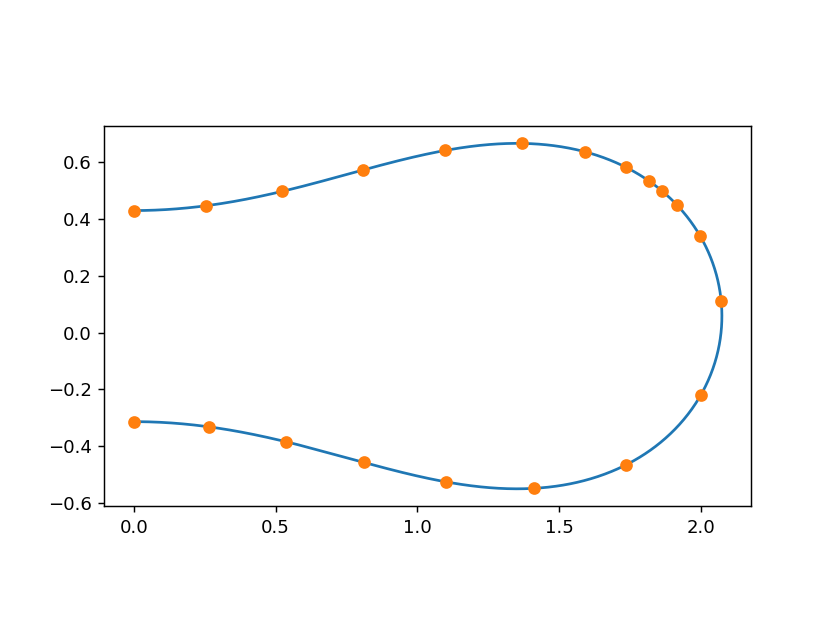

In [1063]:
plt.figure()
plt.plot(P,Z)
plt.plot(P[::N_int//20],Z[::N_int//20],'o')

plt.axis('scaled');

<IPython.core.display.Javascript object>


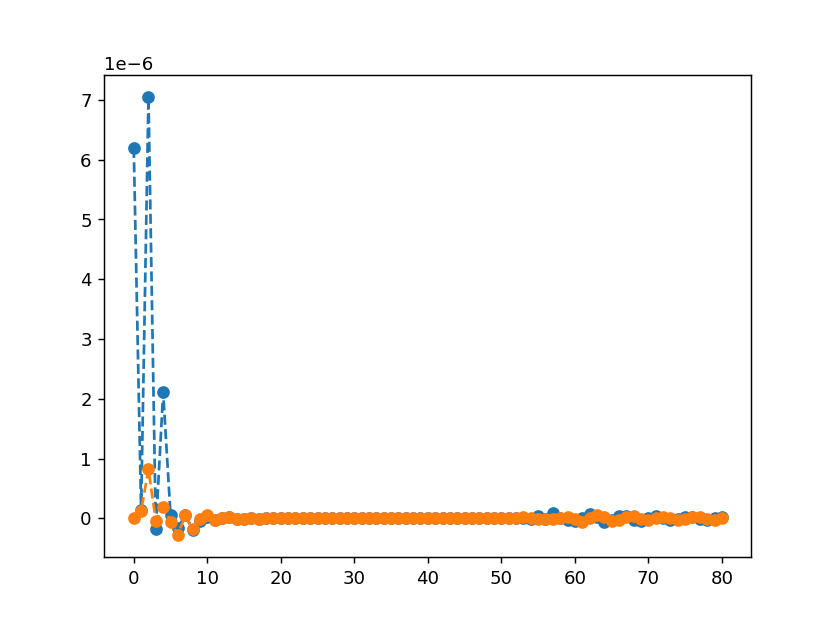

<IPython.core.display.Javascript object>


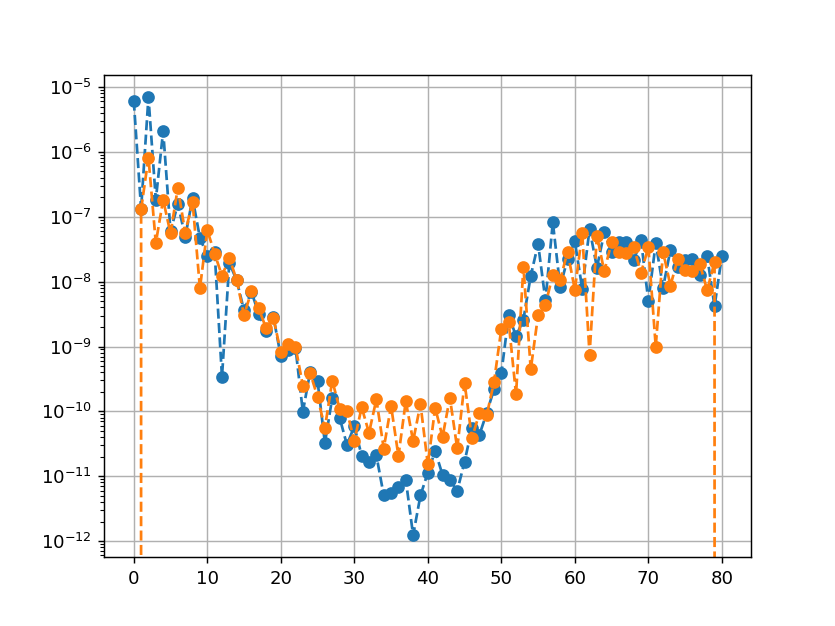

<IPython.core.display.Javascript object>


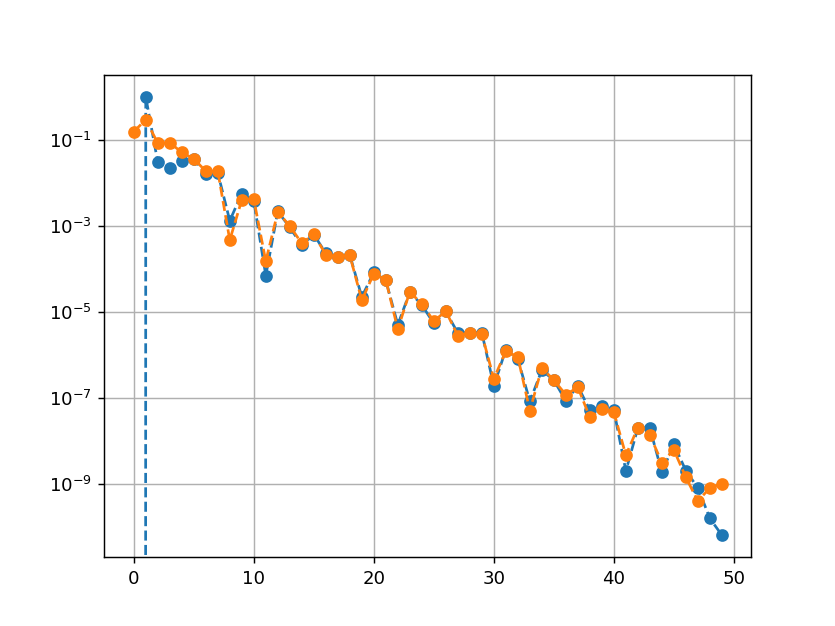

In [1064]:
V_rho_fur, V_z_fur = get_velo_fur_full(P_fur_j, Z_fur_j)
plt.figure()
plt.plot(V_z_fur,'o--')
plt.plot(V_rho_fur,'o--')

plt.figure()
plt.plot(np.abs(V_z_fur),'o--')
plt.plot(np.abs(V_rho_fur),'o--')
plt.grid()
plt.yscale('log')

plt.figure()
plt.plot(np.abs(P_fur_j),'o--')
plt.plot(np.abs(Z_fur_j),'o--')
plt.grid()
plt.yscale('log')

<IPython.core.display.Javascript object>


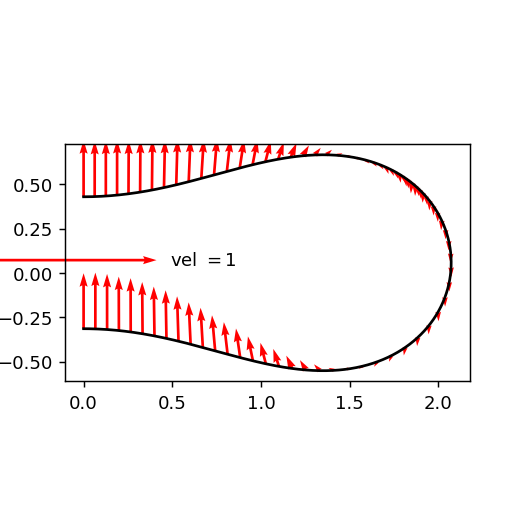

(-0.10366951213432599,
 2.1770597548208457,
 -0.6116216906229607,
 0.7279898986342035)

In [1065]:
t_ = get_velo(P_fur_j, Z_fur_j)
fig = plt.figure(figsize = (4,4))
ax = fig.add_subplot(1, 1, 1)

#ax.scatter(p0, z0,s=6)
#qk = ax.quiverkey(Q, 0.4, 0.5, 100, r'$v=100$', labelpos='E',
#                  coordinates='figure')
plt.plot(P, Z,'k')

Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], t_[0],t_[1], color='red')
qk = ax.quiverkey(Qnow, 0.3, 0.5, 1, r'vel $=1$', labelpos='E',
                  coordinates='figure')
ax.axis('scaled')
#Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], 
#                 (force/V*(-Z1))[::N_int//n_int],(force/V*P1)[::N_int//n_int], color='blue')
#qk = ax.quiverkey(Qnow, 0.8, 0.8, 10, r'f $=10$', labelpos='E',
#                  coordinates='figure')

<IPython.core.display.Javascript object>


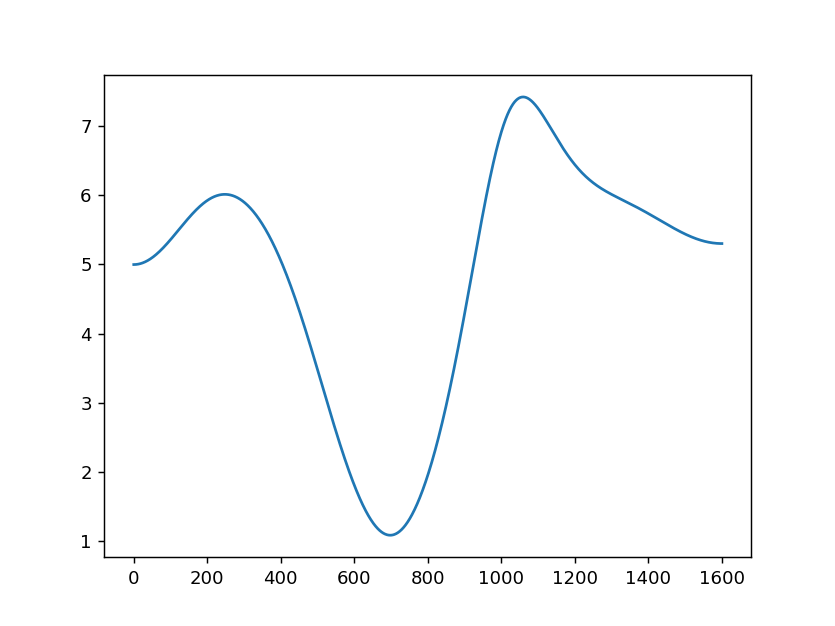

In [1066]:
plt.figure()
plt.plot(V)

In [1067]:
def get_plot_field(field, tp='z'):
    field_fur = np.fft.rfft(get_ext_array(field,tp), norm='forward')
    field_fur_ext = np.zeros(N_int)+0j
    field_fur_ext[:field_fur.shape[0]-1] = field_fur[:field_fur.shape[0]-1]
    field_fur_ext[field_fur.shape[0]-1] = field_fur[field_fur.shape[0]-1]/2
    field_N_int = np.fft.irfft(field_fur_ext, n=2*N_int,norm='forward')[:N_int+1]
    return field_N_int

<IPython.core.display.Javascript object>


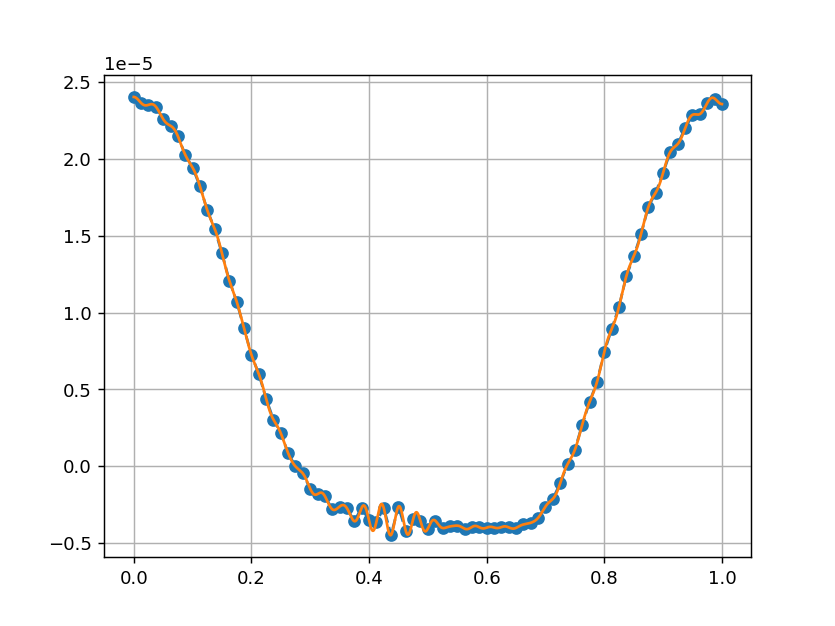

<IPython.core.display.Javascript object>


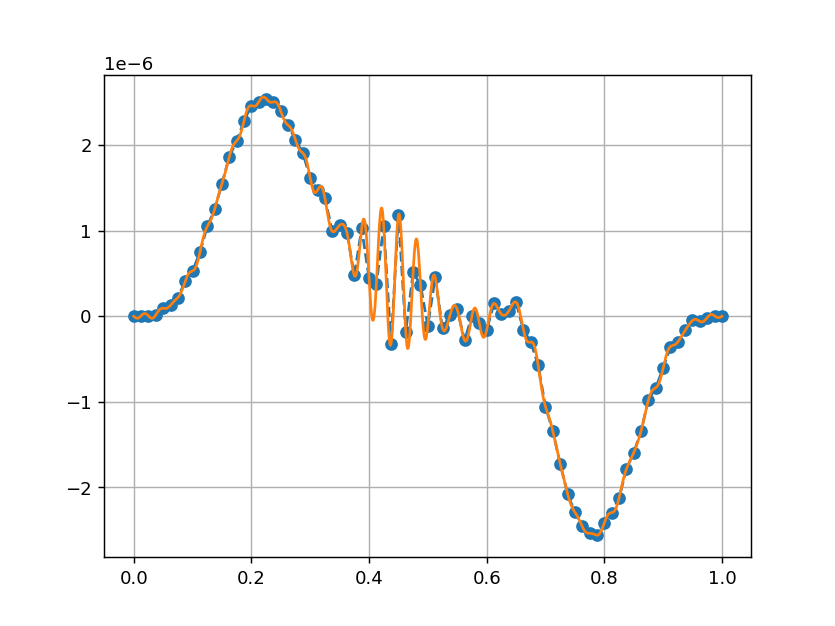

In [1068]:
%matplotlib notebook
V_rho, V_z = get_velo(P_fur_j, Z_fur_j)
plt.figure()
plt.plot(tau_int, V_z,'o--')
plt.plot(Tau_int, get_plot_field(V_z, tp='z'),'-')
plt.grid()

plt.figure()
plt.plot(tau_int, V_rho,'o--')
plt.plot(Tau_int, get_plot_field(V_rho, tp='p'),'-')
plt.grid()
#plt.plot(Tau_int, force)

<IPython.core.display.Javascript object>


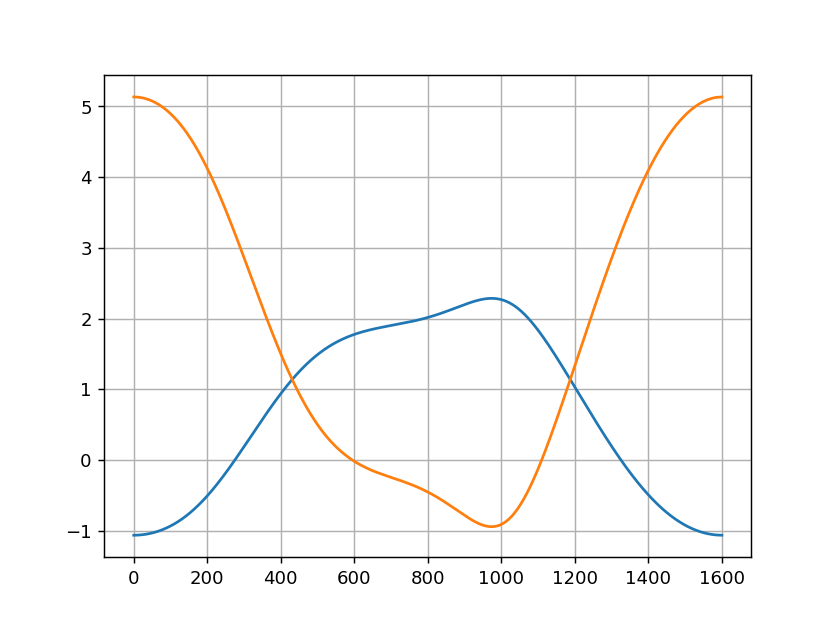

<IPython.core.display.Javascript object>


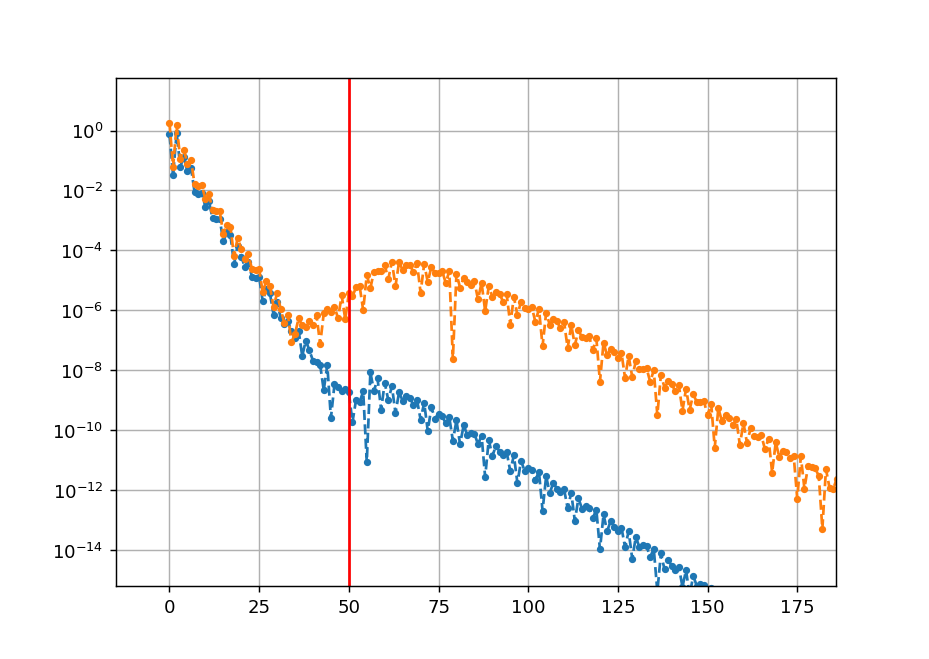

In [1069]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j[:50])
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j[:50])
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 



plt.figure()
plt.plot(H)


force_fur = np.fft.rfft(get_ext_array(force), norm='forward')
force_filt = np.fft.irfft(force_fur[:N], norm='forward', n=2*N_int)[:N_int+1]

line = plt.plot(force, label=f'N={N}')
plt.plot(force_filt,'--',lw=0.7, color=line[0].get_color())


plt.grid()




plt.figure()
plt.plot(np.abs(np.fft.rfft(get_ext_array(H), norm='forward')), '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(force), norm='forward')), '.--')






plt.yscale('log')
plt.axvline(N,color='red')
plt.xlim(0,4*N)
plt.ylim(1e-8,1e2)

plt.grid()


<IPython.core.display.Javascript object>


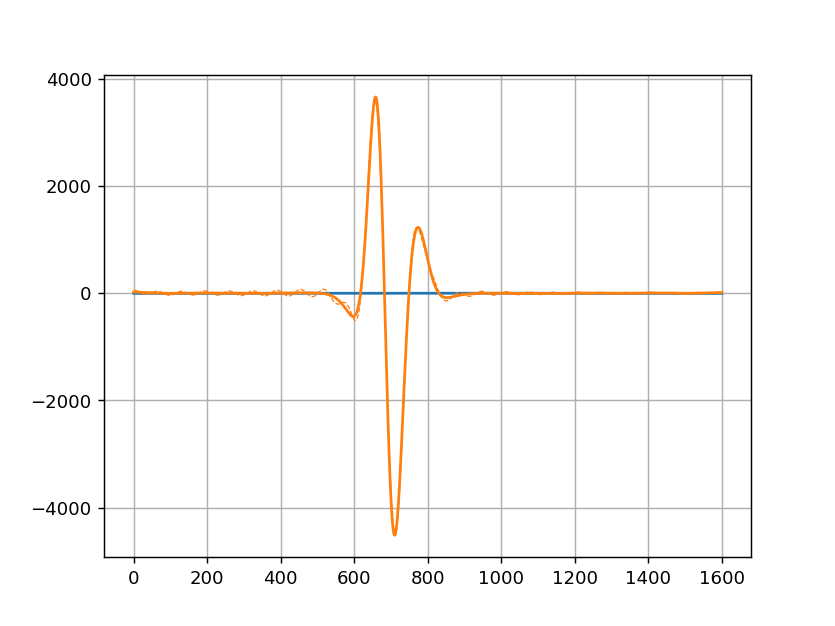

<IPython.core.display.Javascript object>


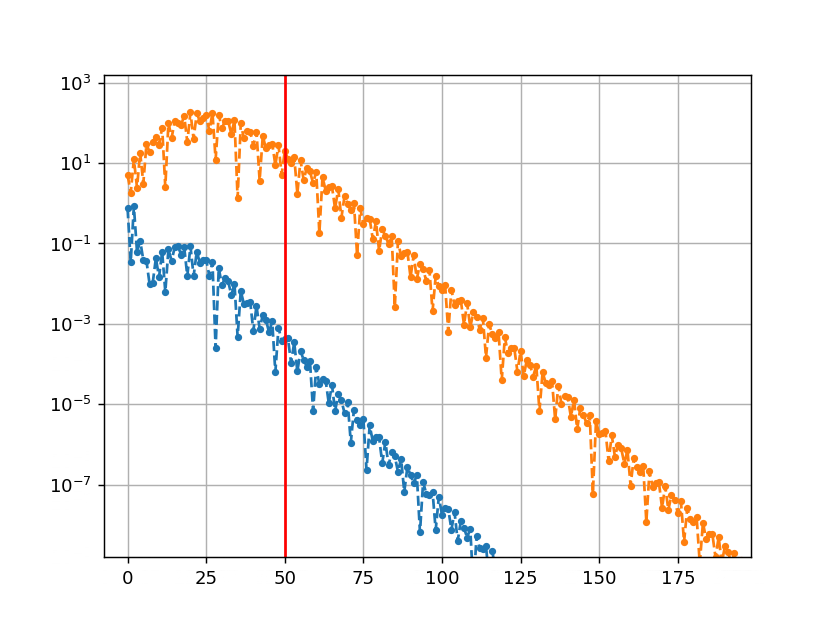

In [1070]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j[:16])
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j[:16])
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 



plt.figure()
plt.plot(H)


force_fur = np.fft.rfft(get_ext_array(force), norm='forward')
force_filt = np.fft.irfft(force_fur[:N], norm='forward', n=2*N_int)[:N_int+1]

line = plt.plot(force, label=f'N={N}')
plt.plot(force_filt,'--',lw=0.7, color=line[0].get_color())


plt.grid()




plt.figure()
plt.plot(np.abs(np.fft.rfft(get_ext_array(H), norm='forward')), '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(force), norm='forward')), '.--')






plt.yscale('log')
plt.axvline(N,color='red')
plt.xlim(0,4*N)
plt.ylim(1e-8,1e2)

plt.grid()


<IPython.core.display.Javascript object>


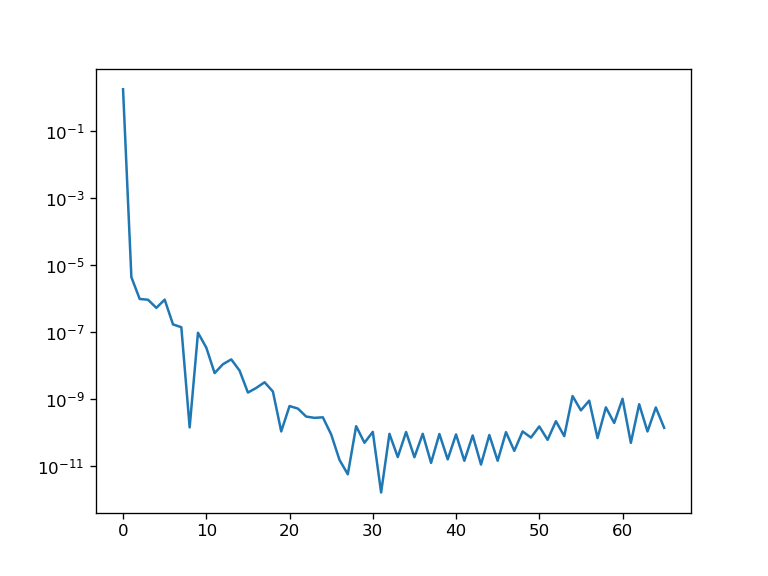

In [1029]:
plt.figure()
plt.plot(np.abs(
get_sigma_fur_from_arr(P_fur_j, Z_fur_j)))
plt.yscale('log')

In [841]:
jac_norm_fun_steps = nd.Jacobian(lambda normal_delta_fur:
                        get_normal_velo_normal_delta(P_fur_j, Z_fur_j, normal_delta_fur), 
                                 step=1e-7)

In [842]:
jac_norm_steps = jac_norm_fun_steps(np.zeros(N))

In [843]:
w_steps,vr_steps =sc.linalg.eig(jac_norm_steps[N-20:N,N-20:N])

In [844]:
np.sort((w_steps))[::-1][:5]

array([-31446.18292612   +0.j        , -39325.89562198   +0.j        ,
       -41785.31342013+1737.53416728j, -41785.31342013-1737.53416728j,
       -49877.62732393   +0.j        ])

In [845]:
w_steps,vr_steps =sc.linalg.eig(jac_norm_steps)

In [846]:
np.sort((w_steps))[::-1][:5]

array([ 0.83279837+0.j        , -0.08401364+1.76734991j,
       -0.08401364-1.76734991j, -0.59921343+0.j        ,
       -2.59678777+0.j        ])

In [847]:
print(f'{w_steps.min():.2e}')
print(f'{1/w_steps.min():.2e}')

-1.81e+07+0.00e+00j
-5.53e-08-0.00e+00j


### Demonstarte thin

In [1071]:
data = np.load('dyn_rad_p1=1.000_p2=-0.100_z1=0.130_z2=-0.300_to_t=0.8_N=80_n_int=120_rad_atol=1.00e-11.npy', allow_pickle=True).item()
sol_t = data['t']
sol_y = data['y']
t_max=sol_t[-1]

In [1072]:
N=80

j_N = np.arange(N+1)
tau_N = j_N/N


n_int = 120
N_int = n_int*20

Tau_int = np.arange(N_int+1)/(N_int)
tau_int = np.arange(n_int+1)/(n_int)

dtau_int = tau_int.reshape(-1,1) - Tau_int.reshape(1,-1) 

weights_simp1 = np.zeros_like(Tau_int)
weights_simp2 = np.zeros_like(Tau_int)

weights_simp1 +=1
weights_simp1[0]=1/2; weights_simp1[-1]=1/2

weights_simp2[::2] +=1
weights_simp2[::2][0]=1/2; weights_simp2[::2][-1]=1/2

weights_simp = 4/3*weights_simp1 - 2/3*weights_simp2
weights_simp /= N_int

Kron = (np.abs(dtau_int)<1e-6)
AKron = ~Kron

#### Dynamic analys

<IPython.core.display.Javascript object>


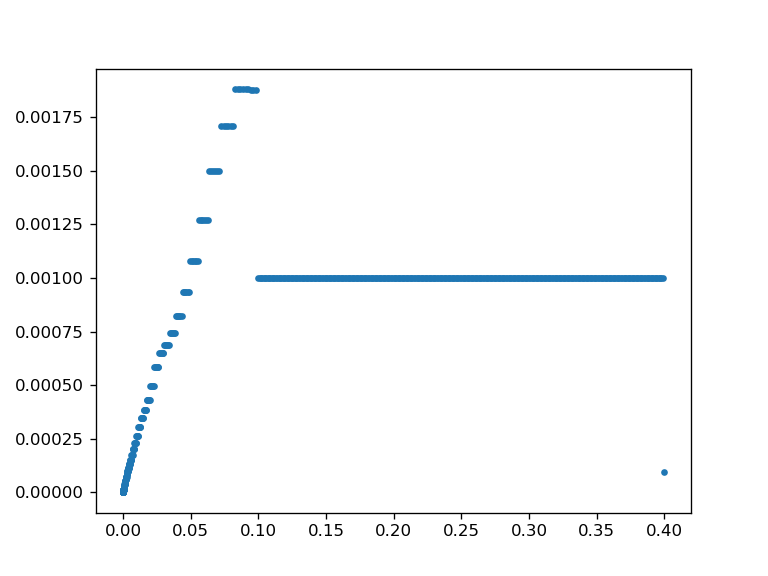

In [1038]:
plt.figure()
plt.plot(sol_t[:-1], sol_t[1:]-sol_t[:-1],'.')

<IPython.core.display.Javascript object>


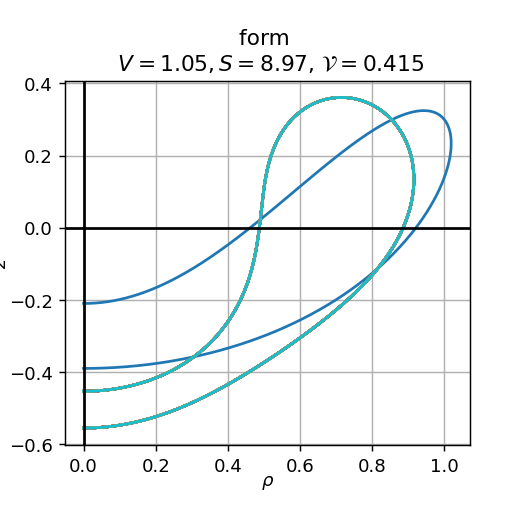

Text(0.5, 1.0, 'form \n $V=1.05, S=8.97$, $\\mathcal{V}=$$0.415$')

In [1073]:
%matplotlib notebook
plt.figure(figsize=(4,4))
t_max = 20
for t_j in np.linspace(0,t_max,30):#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    plt.plot(P,Z,lw=1.5, label=f't={sol_t[j]:.2f}')


    
    
plt.axis('scaled')
#plt.legend(ncol=2)
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)

P_fur0 = np.zeros(N)
P_fur0[1::]=sol_y[:N-1,0]
Z_fur0=sol_y[N-1:,0]


Vol0, Sqr0,V_cal0 = get_VolSqr(P_fur0, Z_fur0)
plt.grid()
plt.title(fr'form '+'\n'+fr' $V={Vol0:.2f}, S={Sqr0:.2f}$, '+r'$\mathcal{V}=$'+fr'${V_cal0:.3f}$')

<IPython.core.display.Javascript object>


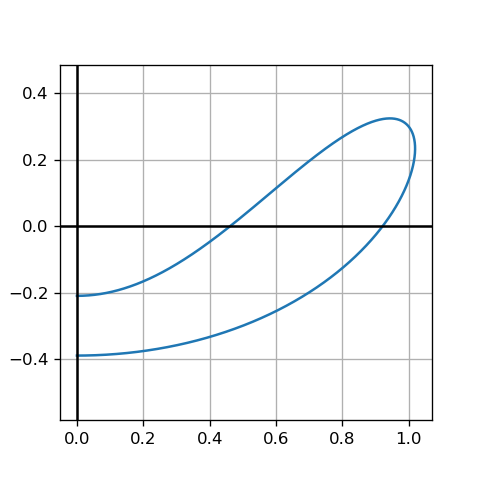

/tmp/ipykernel_7502/2298259793.py:38: UserWarning: frames=None which we can infer the length of, did not pass an explicit *save_count* and passed cache_frame_data=True.  To avoid a possibly unbounded cache, frame data caching has been disabled. To suppress this warning either pass `cache_frame_data=False` or `save_count=MAX_FRAMES`.
  ani = animation.FuncAnimation(


In [1040]:
%matplotlib notebook

import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(4,4))
ax.grid()

### Initial state ###
i=0
P_fur_j = np.zeros(N)
P_fur_j[1::]=sol_y[:N-1,i]
Z_fur_j=sol_y[N-1:,i]

P = get_int_field(-P_fur_j*1j)
Z = get_int_field(Z_fur_j)


line, = ax.plot(P,Z,lw=1.5)

ax.axis('scaled')
ax.set_ylim(Z.min()*1.5, Z.max()*1.5)
ax.axvline(0, color='k')
ax.axhline(0, color='k')
#ax.set_title(f'V={a}')

def animate(i):
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,i]
    Z_fur_j=sol_y[N-1:,i]

    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    line.set_ydata(Z);line.set_xdata(P)  # update the data.

    return line,


ani = animation.FuncAnimation(
    fig, animate)

# To save the animation, use e.g.
#
#ani.save(f"dyno_{2.4}.mp4")
#
# or
#
#writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie_{0.511}.mp4", writer=writer)

plt.show()

<IPython.core.display.Javascript object>


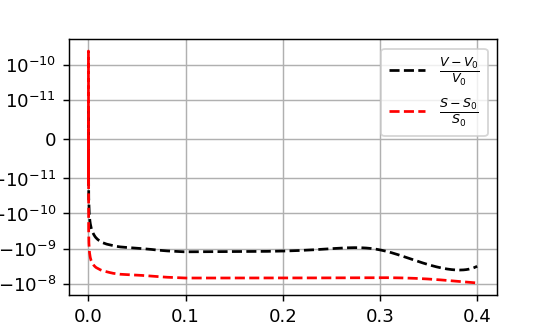

In [1074]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_fur0, Z_fur0)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_t, Vol_ar/Vol0-1,'--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_t, Sqr_ar/Sqr0-1,'--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-11)

In [1076]:
%matplotlib inline
@interact(i=(0,len(sol_t)-1,1))
def plot_PZ_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,i]
    Z_fur_j=sol_y[N-1:,i]

    ax.plot(np.abs(P_fur_j),'.--',lw=1.5)
    ax.plot(np.abs(Z_fur_j),'.--',lw=1.5)
    ax.set_title(f't={sol_t[i]}')
    #ax.axis('scaled')
    ax.set_xlim(0, N)
    ax.set_ylim(1e-12, 1e0)
    ax.set_yscale('log')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=303, description='i', max=606), Output()), _dom_classes=('widget-interac…

In [1077]:
%matplotlib inline


@interact(k=(0, N-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1, 2, figsize=(8, 3))
    fig.tight_layout(pad=3.0)
    axs[0].plot(sol_t, sol_y[k+N-1, :], label=fr'Z[{k}]')
    axs[1].plot(sol_t[1:], np.abs(
        (sol_y[k+N-1, 1:]-sol_y[k+N-1, :-1])/(sol_t[1:]-sol_t[:-1])))
    if k > 0:
        axs[0].plot(sol_t, sol_y[k-1, :], label=fr'P[{k}]')
        axs[1].plot(sol_t[1:], np.abs(
            (sol_y[k-1, 1:]-sol_y[k-1, :-1])/(sol_t[1:]-sol_t[:-1])))

    axs[0].grid()
    axs[0].legend()

    axs[1].set_yscale('log')
    #axs[1].set_ylim(1e-11, 1e0)
    axs[1].set_ylabel(r'$|\partial_t|$')
    axs[1].grid()

interactive(children=(IntSlider(value=39, description='k', max=79), Output()), _dom_classes=('widget-interact'…

In [1078]:
force_arr =[]
force_fur_arr =[]

t_range = sol_t[::]
#t_range = sol_t[::10]
for t_j in tqdm(t_range):
    j = np.argmin(np.abs(sol_t-t_j))

    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]

    P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
    Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
    V = np.sqrt(P1**2+Z1**2)
    
    H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 
    
    force_fur = np.fft.rfft(get_ext_array(force), norm='forward')
    force_arr.append(force)
    force_fur_arr.append(force_fur)
force_arr=np.array(force_arr)
force_fur_arr=np.array(force_fur_arr)

  0%|          | 0/607 [00:00<?, ?it/s]

In [1079]:
%matplotlib inline
@interact(i=(0,len(t_range)-1,1))
def plot_force_fur(i):
    fig, ax = plt.subplots(figsize=(6,4))
    ax.grid()



    line, = ax.plot(force_arr[i],lw=1.5)
    ax.set_title(f't={t_range[i]}')
    #ax.axis('scaled')


interactive(children=(IntSlider(value=303, description='i', max=606), Output()), _dom_classes=('widget-interac…

<IPython.core.display.Javascript object>


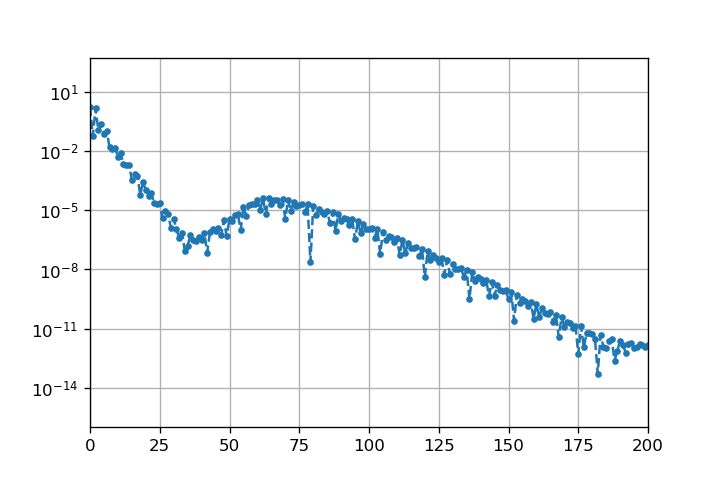

/tmp/ipykernel_7502/101124087.py:28: UserWarning: frames=None which we can infer the length of, did not pass an explicit *save_count* and passed cache_frame_data=True.  To avoid a possibly unbounded cache, frame data caching has been disabled. To suppress this warning either pass `cache_frame_data=False` or `save_count=MAX_FRAMES`.
  ani = animation.FuncAnimation(


In [1015]:
#N_frames = 50*10

%matplotlib notebook



import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(6,4))
ax.grid()



line, = ax.plot(np.abs(force_fur_arr[0]),'.--',lw=1.5)
ax.set_yscale('log')
#ax.axis('scaled')
ax.set_xlim(0, 4*N)
#ax.axvline(0, color='k')
#ax.axhline(0, color='k')
#ax.set_title(f'a={a}')
def animate(i):

    line.set_ydata(np.abs(force_fur_arr[i]))  # update the data.
    
    return line,


ani = animation.FuncAnimation(
    fig, animate)

# To save the animation, use e.g.
#
#ani.save(f"dyno_{2.4}.mp4")
#
# or
#
#writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
#ani.save("movie_{0.511}.mp4", writer=writer)

plt.show()

#### State analys

In [1080]:
t_j=0.4
j=np.argmin(np.abs(t_j-sol_t))
P_fur_j = np.zeros(N)
P_fur_j[1::] = sol_y[:N-1, j]
Z_fur_j = sol_y[N-1:, j].copy()

In [1081]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j)
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j)
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 

### find surface tension ###
sigma_fur = get_sigma_fur(P, P1, P2, Z, Z1, Z2, H, force)

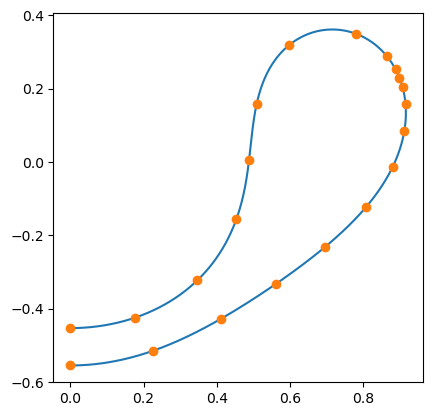

In [1082]:
plt.figure()
plt.plot(P,Z)
plt.plot(P[::N_int//20],Z[::N_int//20],'o')

plt.axis('scaled');

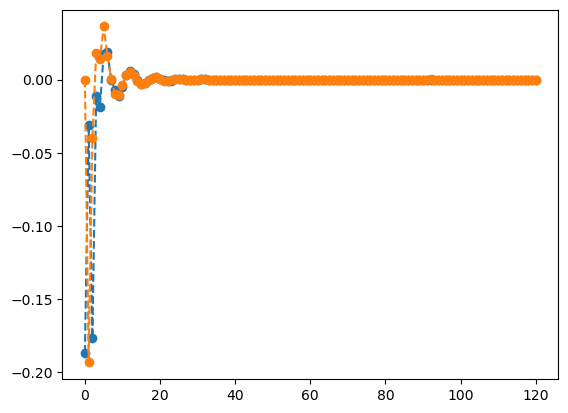

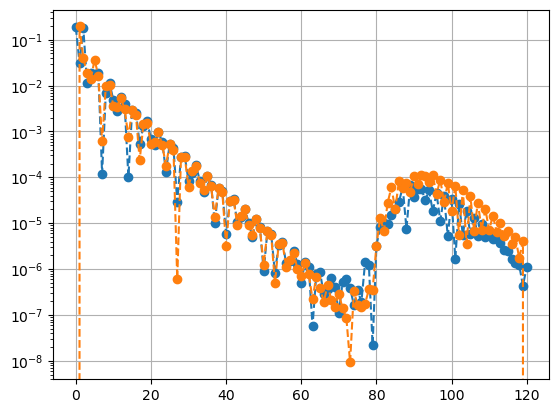

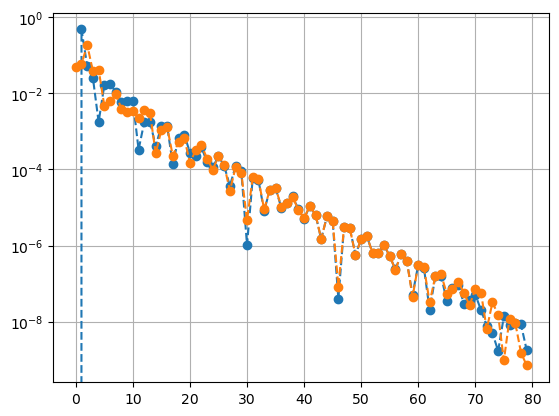

In [1083]:
V_rho_fur, V_z_fur = get_velo_fur_full(P_fur_j, Z_fur_j)
plt.figure()
plt.plot(V_z_fur,'o--')
plt.plot(V_rho_fur,'o--')

plt.figure()
plt.plot(np.abs(V_z_fur),'o--')
plt.plot(np.abs(V_rho_fur),'o--')
plt.grid()
plt.yscale('log')

plt.figure()
plt.plot(np.abs(P_fur_j),'o--')
plt.plot(np.abs(Z_fur_j),'o--')
plt.grid()
plt.yscale('log')

(-0.04578177580342633,
 0.9614172918719529,
 -0.6011584813904445,
 0.40714333908065603)

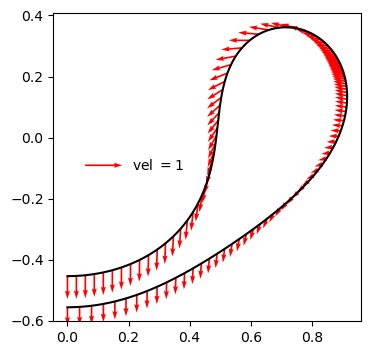

In [1084]:
t_ = get_velo(P_fur_j, Z_fur_j)
fig = plt.figure(figsize = (4,4))
ax = fig.add_subplot(1, 1, 1)

#ax.scatter(p0, z0,s=6)
#qk = ax.quiverkey(Q, 0.4, 0.5, 100, r'$v=100$', labelpos='E',
#                  coordinates='figure')
plt.plot(P, Z,'k')

Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], t_[0],t_[1], color='red')
qk = ax.quiverkey(Qnow, 0.3, 0.5, 1, r'vel $=1$', labelpos='E',
                  coordinates='figure')
ax.axis('scaled')
#Qnow = ax.quiver(P[::N_int//n_int], Z[::N_int//n_int], 
#                 (force/V*(-Z1))[::N_int//n_int],(force/V*P1)[::N_int//n_int], color='blue')
#qk = ax.quiverkey(Qnow, 0.8, 0.8, 10, r'f $=10$', labelpos='E',
#                  coordinates='figure')

In [1085]:
def get_plot_field(field, tp='z'):
    field_fur = np.fft.rfft(get_ext_array(field,tp), norm='forward')
    field_fur_ext = np.zeros(N_int)+0j
    field_fur_ext[:field_fur.shape[0]-1] = field_fur[:field_fur.shape[0]-1]
    field_fur_ext[field_fur.shape[0]-1] = field_fur[field_fur.shape[0]-1]/2
    field_N_int = np.fft.irfft(field_fur_ext, n=2*N_int,norm='forward')[:N_int+1]
    return field_N_int

<IPython.core.display.Javascript object>


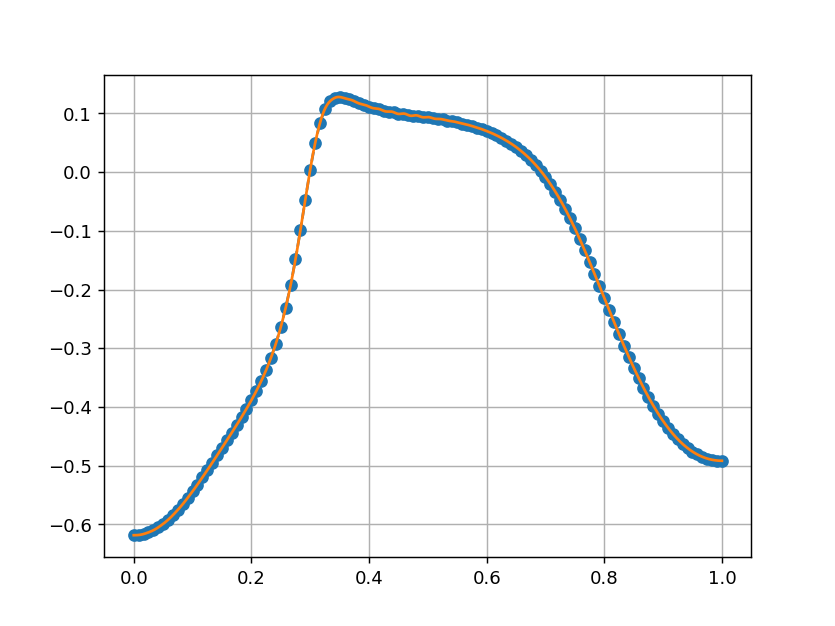

<IPython.core.display.Javascript object>


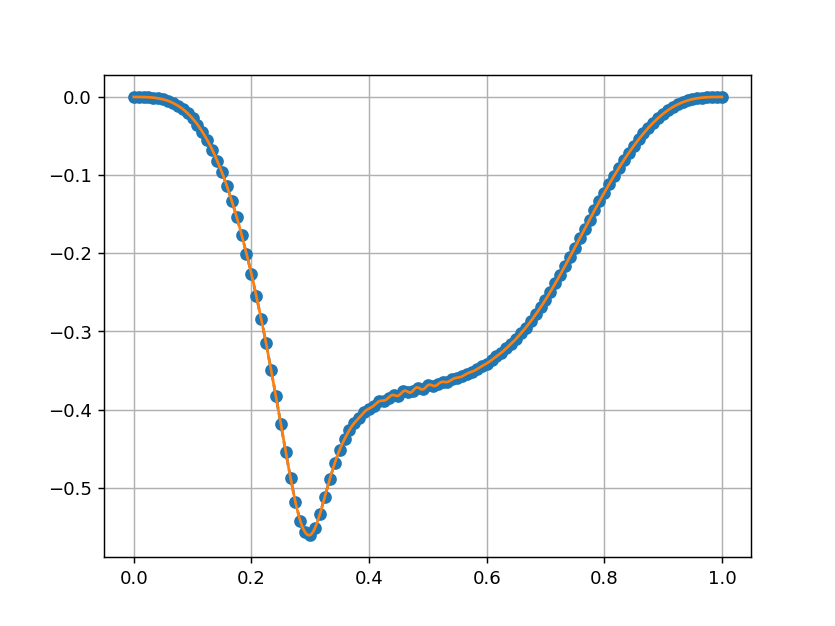

In [1086]:
%matplotlib notebook
V_rho, V_z = get_velo(P_fur_j, Z_fur_j)
plt.figure()
plt.plot(tau_int, V_z,'o--')
plt.plot(Tau_int, get_plot_field(V_z, tp='z'),'-')
plt.grid()

plt.figure()
plt.plot(tau_int, V_rho,'o--')
plt.plot(Tau_int, get_plot_field(V_rho, tp='p'),'-')
plt.grid()
#plt.plot(Tau_int, force)

<IPython.core.display.Javascript object>


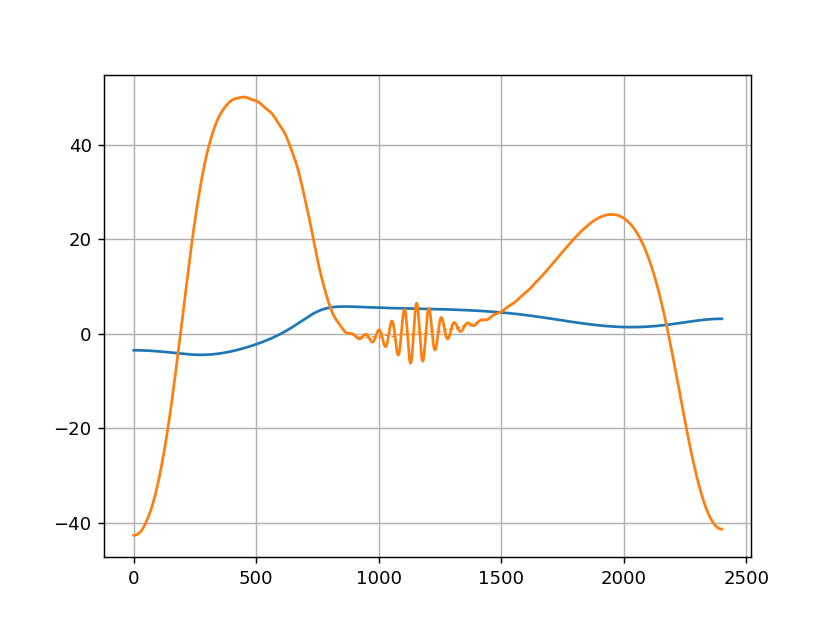

<IPython.core.display.Javascript object>


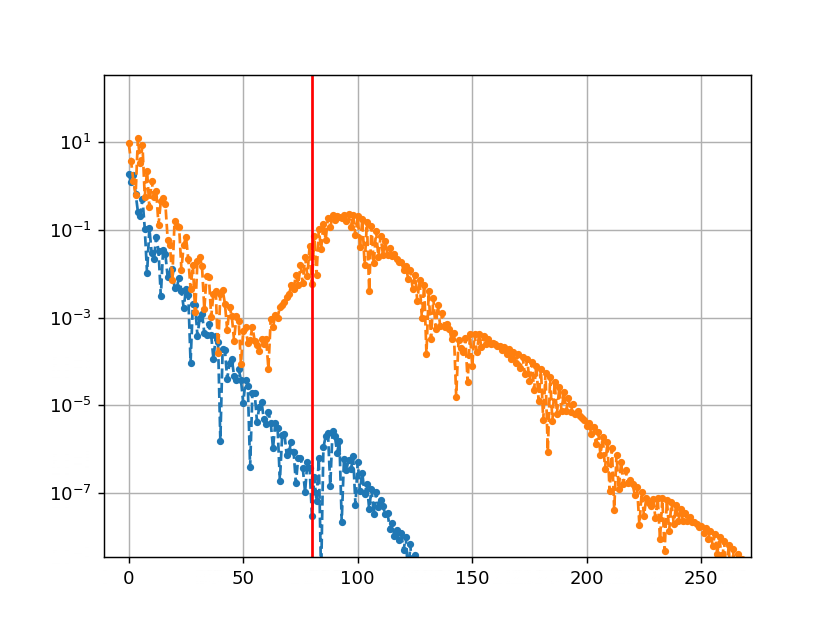

In [1088]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j[:])
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j[:])
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 



plt.figure()
plt.plot(H)


force_fur = np.fft.rfft(get_ext_array(force), norm='forward')
force_filt = np.fft.irfft(force_fur[:N], norm='forward', n=2*N_int)[:N_int+1]

line = plt.plot(force, label=f'N={N}')
plt.plot(force_filt,'--',lw=0.7, color=line[0].get_color())


plt.grid()




plt.figure()
plt.plot(np.abs(np.fft.rfft(get_ext_array(H), norm='forward')), '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(force), norm='forward')), '.--')






plt.yscale('log')
plt.axvline(N,color='red')
plt.xlim(0,4*N)
plt.ylim(1e-8,1e2)

plt.grid()


<IPython.core.display.Javascript object>


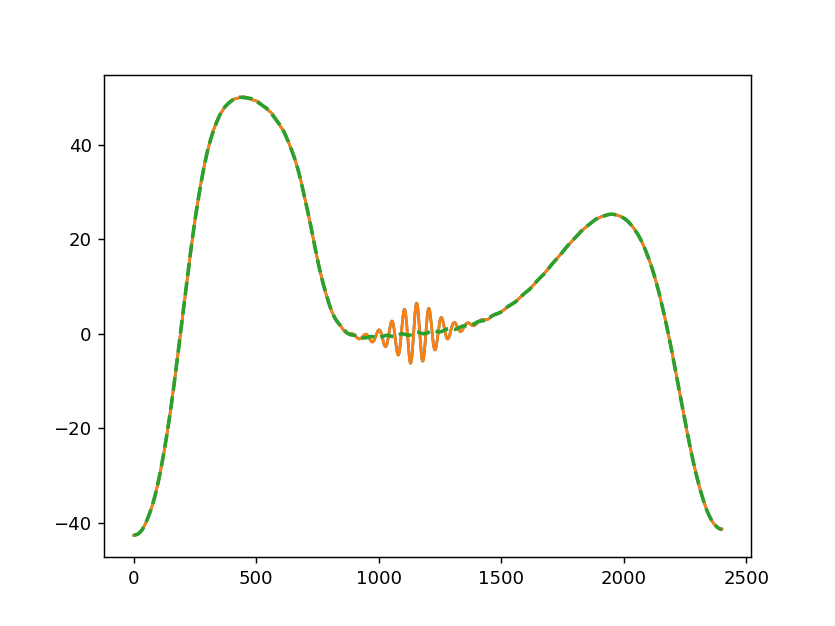

In [1091]:
P, P1,P2,P3,P4 = get_int_fields(-1j*P_fur_j[:])
Z, Z1,Z2,Z3,Z4 = get_int_fields(Z_fur_j[:])
V = np.sqrt(P1**2+Z1**2)

H, force = get_H_force(P,P1,P2,P3,P4,Z,Z1,Z2,Z3,Z4) 



plt.figure()
plt.plot(force)


force_fur = np.fft.rfft(get_ext_array(force), norm='forward')
force_filt = np.fft.irfft(force_fur[:N], norm='forward', n=2*N_int)[:N_int+1]

line = plt.plot(force, label=f'N={N}')
plt.plot(force_filt,'--',lw=2)




<IPython.core.display.Javascript object>


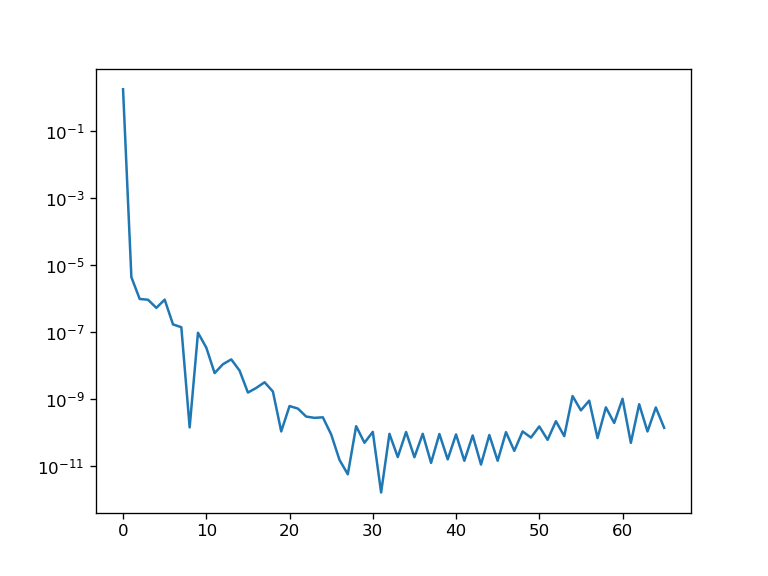

In [1029]:
plt.figure()
plt.plot(np.abs(
get_sigma_fur_from_arr(P_fur_j, Z_fur_j)))
plt.yscale('log')

In [841]:
jac_norm_fun_steps = nd.Jacobian(lambda normal_delta_fur:
                        get_normal_velo_normal_delta(P_fur_j, Z_fur_j, normal_delta_fur), 
                                 step=1e-7)

In [842]:
jac_norm_steps = jac_norm_fun_steps(np.zeros(N))

In [843]:
w_steps,vr_steps =sc.linalg.eig(jac_norm_steps[N-20:N,N-20:N])

In [844]:
np.sort((w_steps))[::-1][:5]

array([-31446.18292612   +0.j        , -39325.89562198   +0.j        ,
       -41785.31342013+1737.53416728j, -41785.31342013-1737.53416728j,
       -49877.62732393   +0.j        ])

In [845]:
w_steps,vr_steps =sc.linalg.eig(jac_norm_steps)

In [846]:
np.sort((w_steps))[::-1][:5]

array([ 0.83279837+0.j        , -0.08401364+1.76734991j,
       -0.08401364-1.76734991j, -0.59921343+0.j        ,
       -2.59678777+0.j        ])

In [847]:
print(f'{w_steps.min():.2e}')
print(f'{1/w_steps.min():.2e}')

-1.81e+07+0.00e+00j
-5.53e-08-0.00e+00j


## Sheme comp

In [312]:
t_max=5e-3

In [313]:
atol_list_bdf=[1e-7,1e-8,1e-9,1e-10]
atol_list_radau=[1e-7,1e-8,1e-9,1e-10]

In [215]:
f'dyn_rk_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_rk_max_step={max_step:.2e}.npy'


'dyn_rk_p1=1.000_p2=-0.100_z1=0.130_z2=-0.300_to_t=0.005_N=70_n_int=100_rk_max_step=2.00e-07.npy'

In [231]:
f'dyn_bdf_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy'

'dyn_bdf_p1=1.000_p2=-0.100_z1=0.130_z2=-0.300_to_t=0.005_N=70_n_int=100_BDF_atol=1.00e-08.npy'

In [288]:
f'dyn_rad_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_rad_atol={atol:.2e}.npy'

'dyn_rad_p1=1.000_p2=-0.100_z1=0.130_z2=-0.300_to_t=0.005_N=70_n_int=100_rad_atol=1.00e-09.npy'

In [315]:
max_step=2e-7

In [329]:
%matplotlib inline
@interact(k=(0,N-1))
def plot_sol_k(k):
    fig, axs = plt.subplots(1,2, figsize=(10,3))
    fig.tight_layout(pad=3.0)
    for atol in atol_list_bdf:
        sol = np.load(
            f'dyn_bdf_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', allow_pickle=True).item()
        sol_t = sol['t']
        sol_y = sol['y']    
        

        axs[0].plot(sol_t, sol_y[k+N-1,:], label=fr'{atol:.2e}')
        if k > 0:
            axs[1].plot(sol_t, sol_y[k-1, :])
        
    for atol in atol_list_radau:
        sol = np.load(
            f'dyn_rad_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_rad_atol={atol:.2e}.npy', allow_pickle=True).item()
        sol_t = sol['t']
        sol_y = sol['y']    

        axs[0].plot(sol_t, sol_y[k+N-1,:], '--',label=fr'{atol:.2e}')
        if k > 0:
            axs[1].plot(sol_t, sol_y[k-1, :],'--')      
    ### RK ###    
    sol = np.load(
        f'dyn_rk_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_rk_max_step={max_step:.2e}.npy'
                , allow_pickle=True).item()
    sol_t = sol['t']
    sol_y = sol['y']
    axs[0].plot(sol_t, sol_y[k+N-1,:],color='red' ,lw=2,label=fr'RK')
    if k > 0:
        axs[1].plot(sol_t, sol_y[k-1, :],lw=2, color='red')
    axs[0].grid()
    axs[1].grid()
        
    axs[0].set_xlim(0, t_max)
    axs[1].set_xlim(0, t_max)
    axs[0].legend(ncol=3)

interactive(children=(IntSlider(value=34, description='k', max=69), Output()), _dom_classes=('widget-interact'…

<IPython.core.display.Javascript object>


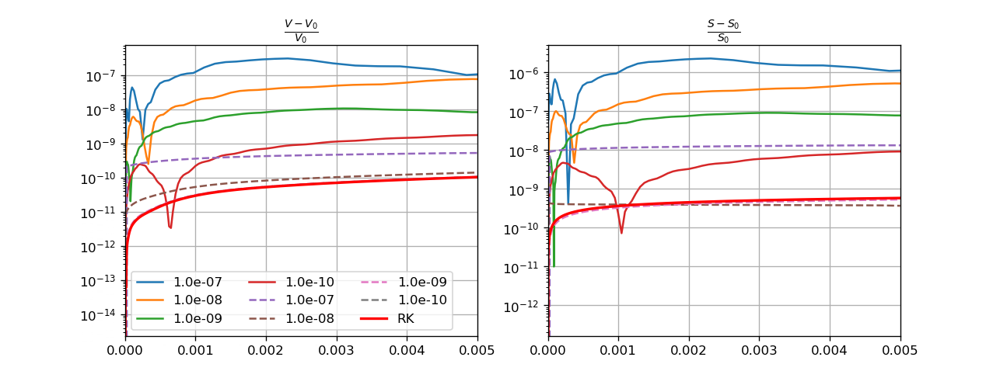

(0.0, 0.005)

In [333]:
%matplotlib notebook


fig,axs = plt.subplots(1,2,figsize=(8,4))
axs[0].grid()
axs[1].grid()
### BDF ###
for atol in atol_list_bdf:
    sol = np.load(
        f'dyn_bdf_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_BDF_atol={atol:.2e}.npy', allow_pickle=True).item()
    sol_t = sol['t']
    sol_y = sol['y']    
    
    Vol_ar=[]
    Sqr_ar=[]
    for j in range(len(sol_t)):
        P_fur_j = np.zeros(N)
        P_fur_j[1::]=sol_y[:N-1,j]
        Z_fur_j=sol_y[N-1:,j]
        
        Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
        Vol_ar.append(Vol)
        Sqr_ar.append(Sqr)
    Vol_ar=np.array(Vol_ar)
    Sqr_ar=np.array(Sqr_ar)   
    axs[0].plot(sol_t, np.abs(Vol_ar/Vol0-1),'-', label=fr'{atol:.1e}')
    axs[1].plot(sol_t, np.abs(Sqr_ar/Sqr0-1),'-')


### Radau ###
for atol in atol_list_radau:
    sol = np.load(
        f'dyn_rad_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_rad_atol={atol:.2e}.npy', allow_pickle=True).item()
    sol_t = sol['t']
    sol_y = sol['y']   
    
    Vol_ar=[]
    Sqr_ar=[]
    for j in range(len(sol_t)):
        P_fur_j = np.zeros(N)
        P_fur_j[1::]=sol_y[:N-1,j]
        Z_fur_j=sol_y[N-1:,j]
        
        Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
        Vol_ar.append(Vol)
        Sqr_ar.append(Sqr)
    Vol_ar=np.array(Vol_ar)
    Sqr_ar=np.array(Sqr_ar)   
    axs[0].plot(sol_t, np.abs(Vol_ar/Vol0-1),'--', label=fr'{atol:.1e}')
    axs[1].plot(sol_t, np.abs(Sqr_ar/Sqr0-1),'--')


### RK ###    
sol = np.load(
    f'dyn_rk_p1={p1:.3f}_p2={p2:.3f}_z1={z1:.3f}_z2={z2:.3f}_to_t={t_max}_N={N}_n_int={n_int}_rk_max_step={max_step:.2e}.npy'
            , allow_pickle=True).item()
sol_t = sol['t']
sol_y = sol['y']

Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_t)):
    P_fur_j = np.zeros(N)
    P_fur_j[1::]=sol_y[:N-1,j]
    Z_fur_j=sol_y[N-1:,j]
    
    Vol,Sqr,_ = get_VolSqr(P_fur_j, Z_fur_j)
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
axs[0].plot(sol_t, np.abs(Vol_ar/Vol0-1),'-',color='red',lw=2, label=fr'RK')
axs[1].plot(sol_t, np.abs(Sqr_ar/Sqr0-1),'-',color='red',lw=2)

axs[0].legend(ncol=3)
#plt.xlabel(r'$t$')
#plt.yscale('log')
axs[0].set_title(r'$\frac{V-V_0}{V_0}$')
axs[1].set_title(r'$\frac{S-S_0}{S_0}$')
axs[0].set_yscale('log')
axs[1].set_yscale('log')
#axs[0].set_ylim(1e-7,1e-4)
#axs[1].set_ylim(1e-7,1e-4)
axs[0].set_xlim(0, t_max)
axs[1].set_xlim(0, t_max)


## Make animations

<IPython.core.display.Javascript object>


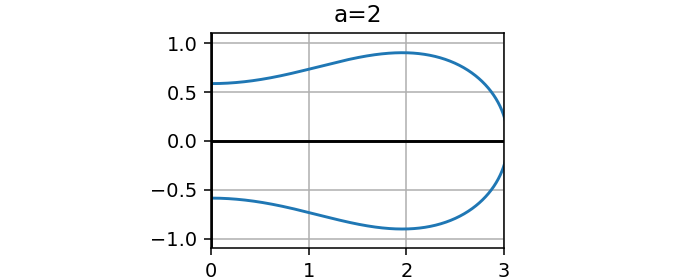

FileNotFoundError: [Errno 2] No such file or directory: 'dyn_bdf_a=2.8_to_t=5_N=26_n_int=44.npy'

In [457]:
for a in [2,2.8,3.2]:
    sol = np.load(f'dyn_bdf_a={a}_to_t=5_N={N}_n_int={n_int}.npy', allow_pickle=True)
    sol_t = sol[0]
    sol_y = sol[1]
    
    N_frames = 250
    t_frames = np.linspace(0,5,N_frames)
    
    %matplotlib notebook
    
    
    
    import matplotlib.animation as animation
    
    fig, ax = plt.subplots(figsize=(5,2))
    ax.grid()
    
    j=0
    P_fur_j = np.zeros(N)
    P_fur_j[1::2]=sol_y[:N//2,j]
    Z_fur_j = np.zeros(N)
    Z_fur_j[1::2]=sol_y[N//2:,j]
    
    P = get_int_field(-P_fur_j*1j)
    Z = get_int_field(Z_fur_j)
    
    line, = ax.plot(P,Z,lw=1.5)
    
    ax.axis('scaled')
    ax.set_xlim(0, 3)
    ax.axvline(0, color='k')
    ax.axhline(0, color='k')
    ax.set_title(f'a={a}')
    def animate(i):
        t_ = t_frames[i]
        index_t = np.argmin(np.abs(sol_t-t_))
        P_fur_j = np.zeros(N)
        P_fur_j[1::2]=sol_bdf.y[:N//2,index_t]
        Z_fur_j = np.zeros(N)
        Z_fur_j[1::2]=sol_bdf.y[N//2:,index_t]
        
        P = get_int_field(-P_fur_j*1j)
        Z = get_int_field(Z_fur_j)
        
        line.set_ydata(Z);line.set_xdata(P)  # update the data.
        
        return line,
    
    
    ani = animation.FuncAnimation(
        fig, animate, interval=5/N_frames, save_count=N_frames)
    
    # To save the animation, use e.g.
    #
    #ani.save(f"dyno_{2.4}.mp4")
    #
    # or
    #
    #writer = animation.FFMpegWriter(
    #     fps=15, metadata=dict(artist='Me'), bitrate=1800)
    #ani.save("movie_{0.511}.mp4", writer=writer)
    
    plt.show()
    
    ani.save(f"dyn_bdf_a={a}_to_t=5_N={N}_n_int={n_int}.gif")
    ani.save(f"dyn_bdf_a={a}_to_t=5_N={N}_n_int={n_int}.mp4", dpi=1000)

## Reparametrization 

$$
\partial_\tau' \tau = 1 + a\cos(2\pi\tau'), \tau = \tau' + a\frac{\sin(2\pi\tau_e)}{2\pi}
$$

In [ ]:
tau=symbols('tau')
from sympy import sin, cos,pi
a=0.35
tau_through_tau_s = tau +a*sin(2*pi*tau)/2/pi
tau_through_tau_s

In [46]:
%matplotlib inline
@interact_manual(a_=(0.25,0.5,0.05))
def plot(a_):
    tau_through_tau_s = tau +a_*sin(2*pi*tau)/2/pi
    tau_through_tau_s
    
    test_P_ = test_P.subs(tau, tau_through_tau_s)
    test_Z_ = test_Z.subs(tau, tau_through_tau_s)
    
    P_ar = np.array([test_P_.evalf(subs={tau:_}) for _ in tau_ar], dtype=float)
    Z_ar = np.array([test_Z_.evalf(subs={tau:_}) for _ in tau_ar], dtype=float)
    P_ar[-1]=0
    plt.figure()
    plt.plot(np.abs(np.fft.rfft(get_ext_array(Z_ar), norm='forward')),'.--',ms=15, label=r'$Z_k$')
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_force(P_ar, Z_ar)), norm='forward')),'.--',ms=15, label=r'$f_k$')
    
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_velo(P_ar, Z_ar)[1]), norm='forward')),'.--',ms=15, label=r'$v^z_k$')
    
    
    plt.xlim(0,N*2)
    plt.ylim(1e-5, 1e1)
    
    plt.legend()
    plt.yscale('log')

interactive(children=(FloatSlider(value=0.35, description='a_', max=0.5, min=0.25, step=0.05), Button(descript…

In [27]:
a = 0.2
tau_through_tau_s = tau +a*sin(2*pi*tau)/2/pi
tau_through_tau_s

test_P_ = test_P.subs(tau, tau_through_tau_s)
test_Z_ = test_Z.subs(tau, tau_through_tau_s)

P_ar = np.array([test_P_.evalf(subs={tau:_}) for _ in tau_ar], dtype=float)
Z_ar = np.array([test_Z_.evalf(subs={tau:_}) for _ in tau_ar], dtype=float)

In [28]:
def func(t, pz):
    v_rho, v_z = get_velo(np.concatenate([[0.],pz[:N-1],[0.]]), pz[N-1:])
    return np.concatenate([v_rho[1:-1],v_z])

In [29]:
sol_bdf = sc.integrate.solve_ivp(func, (0., 20), np.concatenate([P_ar[1:-1], Z_ar]), 
                                   method='BDF', atol=1e-7, rtol=1e-4)

In [30]:
len(sol_bdf.t)

217

Text(0.5, 1.0, 'form')

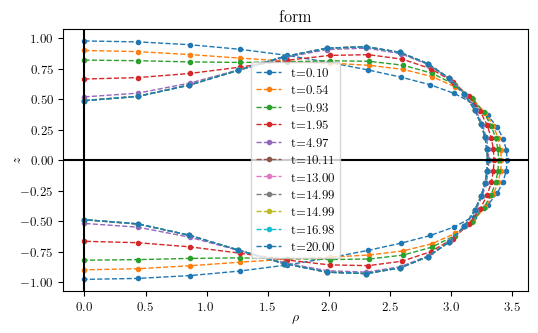

In [60]:
plt.figure(figsize=(6,6))
for t_j in [0.1,0.5, 1,2,5,10,13,15,15,17,20]:#range(len(sol_radau.t)):
    j = np.argmin(np.abs(sol_bdf.t-t_j))
    plt.plot(np.concatenate([[0.],sol_bdf.y[:N-1,j],[0.]]), sol_bdf.y[N-1:,j],'.--',
             lw=1, ms=6, label=f't={sol_bdf.t[j]:.2f}')


plt.axis('scaled')
plt.legend()
plt.axvline(0, color='k')
plt.axhline(0, color='k')

plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

In [32]:
def get_P_with0(P_red):
    return np.concatenate([[0], P_red, [0]])

<IPython.core.display.Javascript object>


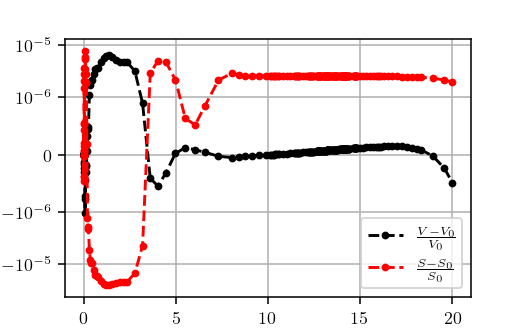

In [34]:
%matplotlib notebook
Vol0, Sqr0,_ = get_VolSqr(P_ar, Z_ar)
plt.figure(figsize=(3,2))
plt.grid()
Vol_ar=[]
Sqr_ar=[]
for j in range(len(sol_bdf.t)):
    Vol,Sqr,_ = get_VolSqr(get_P_with0(sol_bdf.y[:N-1,j]), sol_bdf.y[N-1:,j])
    Vol_ar.append(Vol)
    Sqr_ar.append(Sqr)
Vol_ar=np.array(Vol_ar)
Sqr_ar=np.array(Sqr_ar)   
plt.plot(sol_bdf.t, Vol_ar/Vol0-1,'.--', color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.plot(sol_bdf.t, Sqr_ar/Sqr0-1,'.--', color='r', label=r'$\frac{S-S_0}{S_0}$')

plt.legend()
plt.xlabel(r'$t$')
plt.yscale('symlog', linthresh=1e-6)

In [36]:
%matplotlib inline
@interact_manual(j=(0,len(sol_bdf.t)-1))
def plot_fields_j(j):
    P_j, Z_j = get_P_with0(sol_bdf.y[:N-1,j]), sol_bdf.y[N-1:,j]
    plt.figure()
    plt.title(f't={sol_bdf.t[j]:.3f}')
    plt.plot(np.abs(np.fft.rfft(get_ext_array(Z_j), norm='forward')),'.--',ms=15, label=r'$Z_k$')
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_force(P_j, Z_j)), norm='forward')),'.--',ms=15, label=r'$f_k$')
    
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_velo(P_j, Z_j)[1]), norm='forward')),'.--',ms=15, label=r'$v^z_k$')
    
    
    plt.xlim(0,N*2)
    plt.ylim(1e-7, 1e2)
    
    plt.legend()
    plt.yscale('log')

interactive(children=(IntSlider(value=108, description='j', max=216), Button(description='Run Interact', style…

In [37]:
def get_div_V_oper(P_ar, Z_ar):    
    ### find fields ###
    
    P_ext = get_ext_array(P_ar, tp='p')
    Z_ext = get_ext_array(Z_ar, tp='z')
    
    P_int = R_int_mesh @ P_ext
    Z_int = R_int_mesh @ Z_ext
    P_int[0]=0;P_int[-1]=0
    
    
    P1_int = R1_int_mesh @ P_ext
    Z1_int = R1_int_mesh @ Z_ext
    Z1_int[0]=0;Z1_int[-1]=0
    
    P2_int = R2_int_mesh @ P_ext
    Z2_int = R2_int_mesh @ Z_ext
    P2_int[0]=0;P2_int[-1]=0
    
    P3_int = R3_int_mesh @ P_ext
    Z3_int = R3_int_mesh @ Z_ext
    Z3_int[0]=0;Z3_int[-1]=0
    
    P4_int = R4_int_mesh @ P_ext
    Z4_int = R4_int_mesh @ Z_ext
    P4_int[0]=0;P4_int[-1]=0
    
    
    V_int = np.sqrt(P1_int**2+Z1_int**2)
    
    H1_int = H1_wol_lam(P_int,P1_int,P2_int,P3_int,P4_int, Z_int,Z1_int,Z2_int,Z3_int,Z4_int)
    
    H2_int = H2_wol_lam(P_int,P1_int,P2_int,P3_int,P4_int, Z_int,Z1_int,Z2_int,Z3_int,Z4_int)
    H2_int[0] = H1_int[0]
    H2_int[-1] = H1_int[-1]
    
    
    K_int = H1_int*H2_int
    H_int = H1_int+H2_int
    
    laplH1_int = laplH1_wol_lam(P_int,P1_int,P2_int,P3_int,P4_int, Z_int,Z1_int,Z2_int,Z3_int,Z4_int)
    laplH1_int[0] = 2*(-P1_int[0]**2*Z4_int[0]+4*P1_int[0]*P3_int[0]*Z2_int[0]+3*Z2_int[0]**3)/np.abs(P1_int[0])**5/P1_int[0]
    laplH1_int[-1] = 2*(-P1_int[-1]**2*Z4_int[-1]+4*P1_int[-1]*P3_int[-1]*Z2_int[-1]+3*Z2_int[-1]**3)/np.abs(P1_int[-1])**5/P1_int[-1]
    
    laplH2_int = laplH2_wol_lam(P_int,P1_int,P2_int,P3_int,P4_int, Z_int,Z1_int,Z2_int,Z3_int,Z4_int)
    laplH2_int[0]=laplH1_int[0]/3
    laplH2_int[-1]=laplH1_int[-1]/3
    
    laplH_int = laplH1_int+laplH2_int
    
    force_int =  H_int**3/2 - 2*H_int*K_int + laplH_int
    
    V_ar = V_int[::N_int//N]
    Z1_ar = Z1_int[::N_int//N]
    P1_ar = P1_int[::N_int//N]
    force_ar = force_int[::N_int//N]
    
    # kernals for v #
    G_rhoz_tilde_mesh_int = G_rhoz_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    G_rhorho_tilde_mesh_int = G_rhorho_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    
    K_rho =  P1_int.reshape(1,-1)*G_rhoz_tilde_mesh_int\
                     -Z1_int.reshape(1,-1)*G_rhorho_tilde_mesh_int
    
    K_rho[Kron]=0
    K_rho[0]=0; K_rho[-1]=0
    V_rho_force = K_rho @ (weights_simp*force_int) - (force_ar.reshape(-1,1)*K_rho) @ weights_simp
    V_rho_force /= 8*np.pi
    
    G_zz_tilde_mesh_int = G_zz_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    G_zrho_tilde_mesh_int = G_zrho_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    
    
    
    G_zz_tilde_mesh_int[0,0]=2*np.pi;G_zz_tilde_mesh_int[-1,-1]=2*np.pi
    G_zrho_tilde_mesh_int[0,0]=0;G_zrho_tilde_mesh_int[-1,-1]=0
    
    K_z =  P1_int.reshape(1,-1)*G_zz_tilde_mesh_int\
                     -Z1_int.reshape(1,-1)*G_zrho_tilde_mesh_int
    K_z[1:-1][Kron[1:-1]]=0
    
    
    V_z_force = K_z @ (weights_simp*force_int) - (force_ar.reshape(-1,1)*K_z) @ weights_simp
    V_z_force /= 8*np.pi
    
    ### force opers ###
    P2_ar = P2_int[::N_int//N]
    Z2_ar = Z2_int[::N_int//N]
    
    tan_force_oper = (R1_int_mesh/V_int.reshape(-1,1)) @ extender_z
    tan_force_ar_oper = tan_force_oper[::N_int//N,:]
    
    tan_force_der_ar_oper = (R2_int_mesh[::N_int//N]/V_ar.reshape(-1,1)) @ extender_z-\
                            (R1_int_mesh[::N_int//N]*((P1_ar*P2_ar+Z1_ar*Z2_ar)/V_ar**3).reshape(-1,1)) @ extender_z
    
    norm_force_oper = -(R_int_mesh*H_int.reshape(-1,1)) @ extender_z
    norm_force_ar_oper = norm_force_oper[::N_int//N,:]
    
    ### Kernals for div ###
    d_rhoG_rhorho = dG_rhorho_rho_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    d_zG_rhorho = dG_rhorho_z_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    
    d_rhoG_rhoz = dG_rhoz_rho_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    d_zG_rhoz = dG_rhoz_z_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    
    d_rhoG_zrho = dG_zrho_rho_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    d_zG_zrho = dG_zrho_z_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    
    d_rhoG_zz = dG_zz_rho_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    d_zG_zz = dG_zz_z_tilde_lam(P_ar.reshape(-1,1),
                     Z_ar.reshape(-1,1) - Z_int.reshape(1,-1),
                     P_int.reshape(1,-1))
    ### vector kernals ###
    D_rho = (P1_ar**2/V_ar**2).reshape(-1,1)*d_rhoG_rhorho + \
            (Z1_ar**2/V_ar**2).reshape(-1,1)*d_zG_zrho+\
            (P1_ar*Z1_ar/V_ar**2).reshape(-1,1)*(d_zG_rhorho+d_rhoG_zrho)+\
            (1/P_ar).reshape(-1,1)*(G_rhorho_tilde_mesh_int)
    
    D_z = (P1_ar**2/V_ar**2).reshape(-1,1)*d_rhoG_rhoz + \
            (Z1_ar**2/V_ar**2).reshape(-1,1)*d_zG_zz+\
            (P1_ar*Z1_ar/V_ar**2).reshape(-1,1)*(d_zG_rhoz+d_rhoG_zz)+\
            (1/P_ar).reshape(-1,1)*(G_rhoz_tilde_mesh_int)
    
    
    D_z[0,:] = D_z_axis_part(Z_ar[0]-Z_int, P_int)
    D_z[-1,:] = D_z_axis_part(Z_ar[-1]-Z_int, P_int)
    
    D_rho[0,:] = D_rho_axis_part(Z_ar[0]-Z_int, P_int)
    D_rho[-1,:] = D_rho_axis_part(Z_ar[-1]-Z_int, P_int)
    
    
    D_z[0,0] = np.pi*Z2_ar[0]/P1_ar[0]**2
    D_z[-1,-1] = np.pi*Z2_ar[-1]/P1_ar[-1]**2
    
    
    ### normal and tau response ###
    D_n = -Z1_int.reshape(1,-1)*D_rho + P1_int.reshape(1,-1)*D_z
    D_tau = P1_int.reshape(1,-1)*D_rho + Z1_int.reshape(1,-1)*D_z
    
    D_n[0,0] = -Z2_ar[0]*2*np.pi/P1_ar[0]+P1_ar[0]*D_z[0,0]
    D_n[-1,-1] = -Z2_ar[-1]*2*np.pi/P1_ar[-1]+P1_ar[-1]*D_z[-1,-1]
    
    
    D_tau[1:-1][Kron[1:-1]]=0
    D_n[1:-1][Kron[1:-1]]=0
    
    ### singular part of tau ###
    D_tau_ln = (P1_ar/P_ar).reshape(-1,1)*\
                        np.log(8*(P_ar/V_ar).reshape(-1,1)/np.abs(dtau_ar_int))
    D_tau_ln[0,:]=0;D_tau_ln[-1,:]=0
    
    D_tau_0 = (P1_ar*P2_ar+Z1_ar*Z2_ar)/V_ar**2 - 3*P1_ar*Z1_ar**2/P_ar/V_ar**2
    D_tau_0[0]=0;D_tau_0[-1]=0
    
    D_tau_ov = 2/(-dtau_ar_int)
    D_tau_ov[0]=0;D_tau_ov[-1]=0
    
    D_tau_sing = D_tau_ln + D_tau_ov
    D_tau_sing[1:-1][Kron[1:-1]]=0
    
    ### Weigted opers ###
    
    I_ln = (1+tau_ar*np.log(8*P_ar/V_ar/tau_ar)+
                      (1-tau_ar)*np.log(8*P_ar/V_ar/(1-tau_ar)))
    I_ov = 2*np.log((1-tau_ar)/tau_ar)
    
    
    
    Int_D_tau_reg_oper = D_tau * weights_simp.reshape(1,-1)
    Int_D_tau_reg_oper[0,0]=0;Int_D_tau_reg_oper[-1,-1]=0
    
    Int_D_tau_reg_sing_oper = -np.diag(D_tau_sing @ weights_simp)
    Int_D_tau_reg_0_oper = np.diag(D_tau_0*weights_simp[::N_int//N])
    Int_D_tau_reg_der_oper = 2*np.diag(weights_simp[::N_int//N])
    
    
    
    Int_D_tau_reg_der_oper[0,0] = 2*np.pi*weights_simp[0];Int_D_tau_reg_der_oper[-1,-1] = 2*np.pi*weights_simp[-1]
    
    
    Int_D_tau_sing_oper = np.diag(P1_ar/P_ar*I_ln + I_ov)
    Int_D_tau_sing_oper[0]=0;Int_D_tau_sing_oper[-1]=0
    
    
    Div_v_tau_oper = Int_D_tau_reg_oper @ tan_force_oper +\
                     Int_D_tau_reg_sing_oper @ tan_force_ar_oper+\
                     Int_D_tau_reg_0_oper    @ tan_force_ar_oper+\
                     Int_D_tau_reg_der_oper  @ tan_force_der_ar_oper+\
                     Int_D_tau_sing_oper     @ tan_force_ar_oper
    
    Div_v_n_oper_good = D_n * weights_simp.reshape(1,-1)      @ norm_force_oper -\
                     (D_n @ weights_simp).reshape(-1,1) * norm_force_ar_oper
    
    
    Div_v_sum_oper = Div_v_n_oper_good + Div_v_tau_oper
    Div_v_sum_oper /= 8*np.pi
    
    Div_V_force = (D_n * weights_simp.reshape(1,-1))  @ force_int -\
                      (D_n @ weights_simp) * force_ar
    Div_V_force /= (8*np.pi)
    
    
    sigma_sol = sc.linalg.solve(Div_v_sum_oper, -Div_V_force)
    norm_force_sigma = norm_force_oper @ sigma_sol
    tan_force_sigma = tan_force_oper @ sigma_sol
    
    V_z_sigma_norm = K_z @ (weights_simp*norm_force_sigma) - (norm_force_sigma[::N_int//N].reshape(-1,1)*K_z) @ weights_simp
    V_z_sigma_norm /= 8*np.pi
    
    V_rho_sigma_norm = K_rho @ (weights_simp*norm_force_sigma) - (norm_force_sigma[::N_int//N].reshape(-1,1)*K_rho) @ weights_simp
    V_rho_sigma_norm /= 8*np.pi
    
    ### tan velocity ###
    K_rhotau = Z1_int.reshape(1,-1)*G_rhoz_tilde_mesh_int+\
               P1_int.reshape(1,-1)*G_rhorho_tilde_mesh_int
    K_rhotau[Kron]=0
    
    K_rhotau_ln = P1_ar.reshape(-1,1)*2*\
                        np.log(8*(P_ar/V_ar).reshape(-1,1)/np.abs(dtau_ar_int))
    K_rhotau_ln[Kron]=0
    
    K_rhotau_0 = -4*P1_ar
    
    I_K_rhotau_ln = 2*P1_ar*I_ln
    
    K_ztau = Z1_int.reshape(1,-1)*G_zz_tilde_mesh_int+\
               P1_int.reshape(1,-1)*G_zrho_tilde_mesh_int
    K_ztau[1:-1][Kron[1:-1]]=0
    
    K_ztau_ln = Z1_ar.reshape(-1,1)*2*\
                        np.log(8*(P_ar/V_ar).reshape(-1,1)/np.abs(dtau_ar_int))
    K_ztau_ln[0,:]=0;K_ztau_ln[-1,:]=0
    K_ztau_ln[1:-1][Kron[1:-1]]=0
    
    K_ztau_0 = 2*Z1_ar
    K_ztau_0[0]=0; K_ztau_0[-1]=0
    
    
    I_K_ztau_ln = 2*Z1_ar*I_ln
    I_K_ztau_ln[0]=0;I_K_ztau_ln[-1]=0
    
    V_z_sigma_tan = K_ztau @ (weights_simp*tan_force_sigma)\
                    -(K_ztau_ln @ weights_simp) * tan_force_sigma[::N_int//N]\
                    +K_ztau_0*tan_force_sigma[::N_int//N]*weights_simp[::N_int//N]\
                    +I_K_ztau_ln*(tan_force_sigma[::N_int//N])
    V_z_sigma_tan /= 8*np.pi
    
    V_rho_sigma_tan = K_rhotau @ (weights_simp*tan_force_sigma)\
                    -(K_rhotau_ln @ weights_simp) * tan_force_sigma[::N_int//N]\
                    +K_rhotau_0*tan_force_sigma[::N_int//N]*weights_simp[::N_int//N]\
                    +I_K_rhotau_ln*(tan_force_sigma[::N_int//N])
    V_rho_sigma_tan[0]=0;V_rho_sigma_tan[-1]=0
    
    V_rho_sigma_tan /= 8*np.pi
    
    
    
    ### resalting velocity ###
    V_rho_sigma = V_rho_sigma_tan+V_rho_sigma_norm
    V_z_sigma = V_z_sigma_tan+V_z_sigma_norm
    
    V_rho_sum = V_rho_sigma + V_rho_force
    V_z_sum = V_z_sigma + V_z_force
    return Div_v_sum_oper

In [38]:
j=5
P_j, Z_j = get_P_with0(sol_bdf.y[:N-1,j]), sol_bdf.y[N-1:,j]
Div_V_oper_j = get_div_V_oper(P_j, Z_j)
w_div,vr_div =sc.linalg.eig(Div_V_oper_j)
w_div = np.real(w_div)
w_div_sort = np.sort(np.real(w_div))[::-1]
w_div_sort

array([-0.11266858, -0.14154969, -0.20464858, -0.39854514, -0.41086749,
       -0.59847273, -0.63647864, -0.79313079, -0.85672945, -0.99117205,
       -1.07088108, -1.19226793, -1.28148261, -1.39563621, -1.49061318,
       -1.598625  , -1.68292549, -1.75226844, -1.8342003 , -1.94820484,
       -2.11141942, -2.29987274, -2.53715501, -2.80397892, -3.139463  ,
       -3.51902143, -4.0062337 , -4.56924794, -5.33443377, -6.26426177,
       -7.93100525])

In [39]:
def get_V(P_ar, Z_ar):
    P_ext = get_ext_array(P_ar, tp='p')
    Z_ext = get_ext_array(Z_ar, tp='z')
    
    P_int = R_int_mesh @ P_ext
    Z_int = R_int_mesh @ Z_ext
    P_int[0]=0;P_int[-1]=0
    
    
    P1_int = R1_int_mesh @ P_ext
    Z1_int = R1_int_mesh @ Z_ext
    Z1_int[0]=0;Z1_int[-1]=0
    
    P2_int = R2_int_mesh @ P_ext
    Z2_int = R2_int_mesh @ Z_ext
    P2_int[0]=0;P2_int[-1]=0
    
    P3_int = R3_int_mesh @ P_ext
    Z3_int = R3_int_mesh @ Z_ext
    Z3_int[0]=0;Z3_int[-1]=0
    
    P4_int = R4_int_mesh @ P_ext
    Z4_int = R4_int_mesh @ Z_ext
    P4_int[0]=0;P4_int[-1]=0
    
    
    V_int = np.sqrt(P1_int**2+Z1_int**2)
        

    return P1_int[::N_int//N], Z1_int[::N_int//N], V_int[::N_int//N]

In [49]:
import numdifftools as nd
jfun = nd.Jacobian(lambda pz: func(0., pz) if np.min(pz[:N-1])>0 else print ("fuck"), step=1e-5)

In [57]:
jac_j = jfun(sol_bdf.y[:,j])

In [58]:
w_full,vr_full =sc.linalg.eig(jac_j)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-4]
w_full_real = np.real(w_full_real)
np.sort(w_full_real)

array([-8.75584812e+03, -3.81251594e+03, -2.25026291e+03, -1.45931417e+03,
       -9.59265387e+02, -6.51406777e+02, -5.20974274e+02, -4.58920446e+02,
       -3.35019281e+02, -2.38454608e+02, -1.81260361e+02, -1.35952762e+02,
       -1.09336032e+02, -8.92692322e+01, -8.13626367e+01, -7.18169901e+01,
       -6.02863157e+01, -4.79642755e+01, -3.87788792e+01, -2.93560669e+01,
       -2.30563566e+01, -1.61308792e+01, -1.28919243e+01, -1.22119041e+01,
       -7.42391359e+00, -5.41188630e+00, -2.38975942e+00, -1.84873570e+00,
       -5.16455506e-01, -4.13450914e-01, -2.88398138e-01, -1.46375098e-01,
       -5.59807608e-02, -1.79137349e-02, -4.13767286e-03, -1.77246893e-03,
       -8.47486370e-04, -4.82748378e-04, -2.11185540e-06,  9.55864322e-06,
        9.55864322e-06,  1.72018912e-05,  1.72018912e-05,  1.86256424e-02,
        2.10671347e-02,  2.37241114e-02,  1.94872706e+00,  3.78231507e+00])

In [52]:
P1_ar_j, Z1_ar_j, V_ar_j = get_V(get_P_with0(sol_bdf.y[:N-1,j]), sol_bdf.y[N-1:,j])

<IPython.core.display.Javascript object>


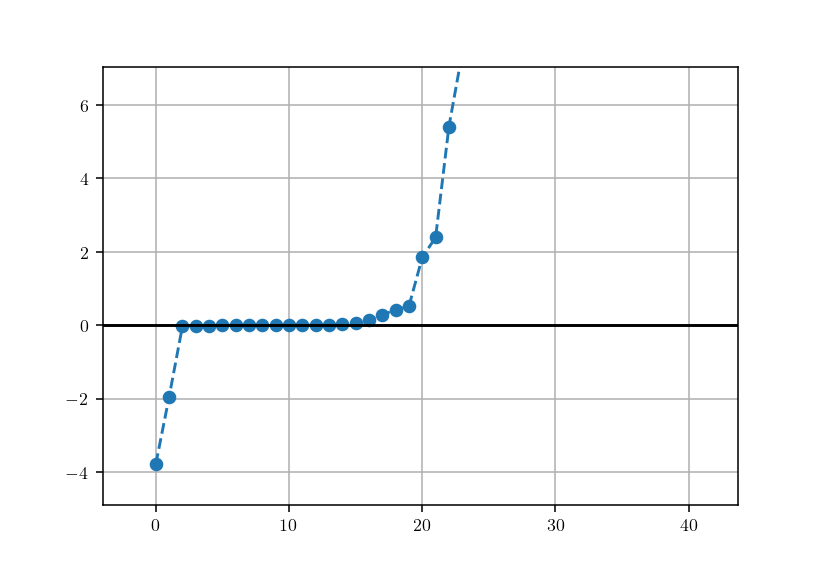

(-1.0, 10.0)

In [53]:
%matplotlib notebook
w_full,vr_full =sc.linalg.eig(jac_j)
w_full_real = w_full[np.abs(np.imag(w_full))<1e-4]
w_full_real = np.real(w_full_real)
plt.figure()
plt.plot(-np.sort(w_full_real)[::-1],'o--')
plt.grid()
plt.axhline(0, color='k')
plt.ylim(-1,10)

In [59]:

%matplotlib inline
@interact_manual(m=(0,50))
def plot_eig_j(m):
    plt.figure()
    
    w_m = (-np.sort(w_full_real)[::-1])[m]
    plt.title(f'w={w_m}')
    index_m = np.argmin(np.abs(w_full - w_m))
    v_m = np.real(vr_full[:, m])
    plt.plot(v_m[:N-1],'.--')
    plt.plot(v_m[N-1:],'.--')
    
    v_tau = get_P_with0(v_m[:N-1])*P1_ar_j + v_m[N-1:]*Z1_ar_j
    v_tau /= V_ar_j
    
    v_n = -Z1_ar_j*get_P_with0(v_m[:N-1]) + P1_ar_j*v_m[N-1:]
    v_n /= V_ar_j
    plt.figure()
    plt.plot(v_n, 'o--',label=r'$v_n$')
    plt.plot(v_tau, 'o--',label=r'$v_\tau$')
    plt.legend()

interactive(children=(IntSlider(value=25, description='m', max=50), Button(description='Run Interact', style=B…

<Figure size 640x480 with 0 Axes>

In [280]:
w_full_imag = w_full[~(np.abs(np.imag(w_full))<1e-4)]
w_full_imag

array([-3.39593519e+02+22.70489346j, -3.39593519e+02-22.70489346j,
        7.31998447e-02 +0.17953428j,  7.31998447e-02 -0.17953428j,
       -9.76169409e-02 +0.13225134j, -9.76169409e-02 -0.13225134j,
        9.50827909e-02 +0.1203832j ,  9.50827909e-02 -0.1203832j ,
       -1.13963435e-01 +0.02900283j, -1.13963435e-01 -0.02900283j,
        7.18439214e-04 +0.07174312j,  7.18439214e-04 -0.07174312j])

In [251]:
np.abs(w_full_imag)

array([0.01809938, 0.01809938, 0.00992296, 0.00992296, 0.00776788,
       0.00776788, 0.00688963, 0.00688963, 0.00567082, 0.00567082,
       0.00625893, 0.00625893, 0.00590779, 0.00590779])

In [ ]:
%matplotlib inline
@interact_manual(j=(0,len(sol_radau.t)-1))
def plot_fields_j(j):
    P_j, Z_j = get_P_with0(sol_radau.y[:N-1,j]), sol_radau.y[N-1:,j]
    plt.figure()
    plt.title(f't={sol_radau.t[j]:.3f}')
    plt.plot(np.abs(np.fft.rfft(get_ext_array(Z_j), norm='forward')),'.--',ms=15, label=r'$Z_k$')
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_force(P_j, Z_j)), norm='forward')),'.--',ms=15, label=r'$f_k$')
    
    plt.plot(np.abs(np.fft.rfft(get_ext_array(get_velo(P_j, Z_j)[1]), norm='forward')),'.--',ms=15, label=r'$v^z_k$')
    
    
    plt.xlim(0,N*2)
    plt.ylim(1e-7, 1e2)
    
    plt.legend()
    plt.yscale('log')

In [137]:
sol_bdf = sc.integrate.solve_ivp(func, (0., 10.), np.concatenate([P_ar[1:-1], Z_ar]), method='BDF')

<IPython.core.display.Javascript object>


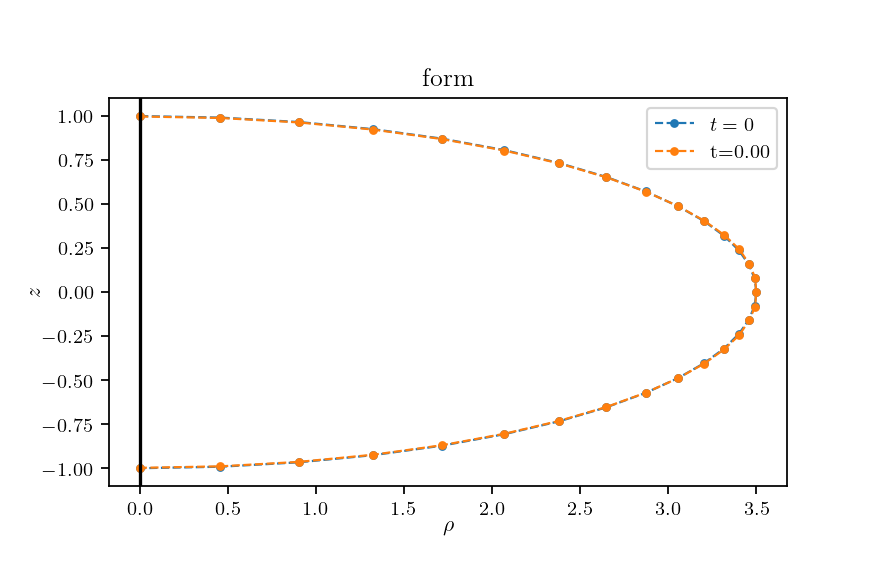

Text(0.5, 1.0, 'form')

In [155]:
plt.figure(figsize=(6,6))
plt.plot(P_ar, Z_ar,'.--',lw=1, ms=6, label=r'$t=0$')
for j in [-950]:
    plt.plot(sol_rk.y[:N+1,j], sol_rk.y[N+1:,j],'.--',lw=1, ms=6, label=f't={sol_rk.t[j]:.2f}')


plt.axis('scaled')
plt.legend()
plt.axvline(0, color='k')
plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

<IPython.core.display.Javascript object>


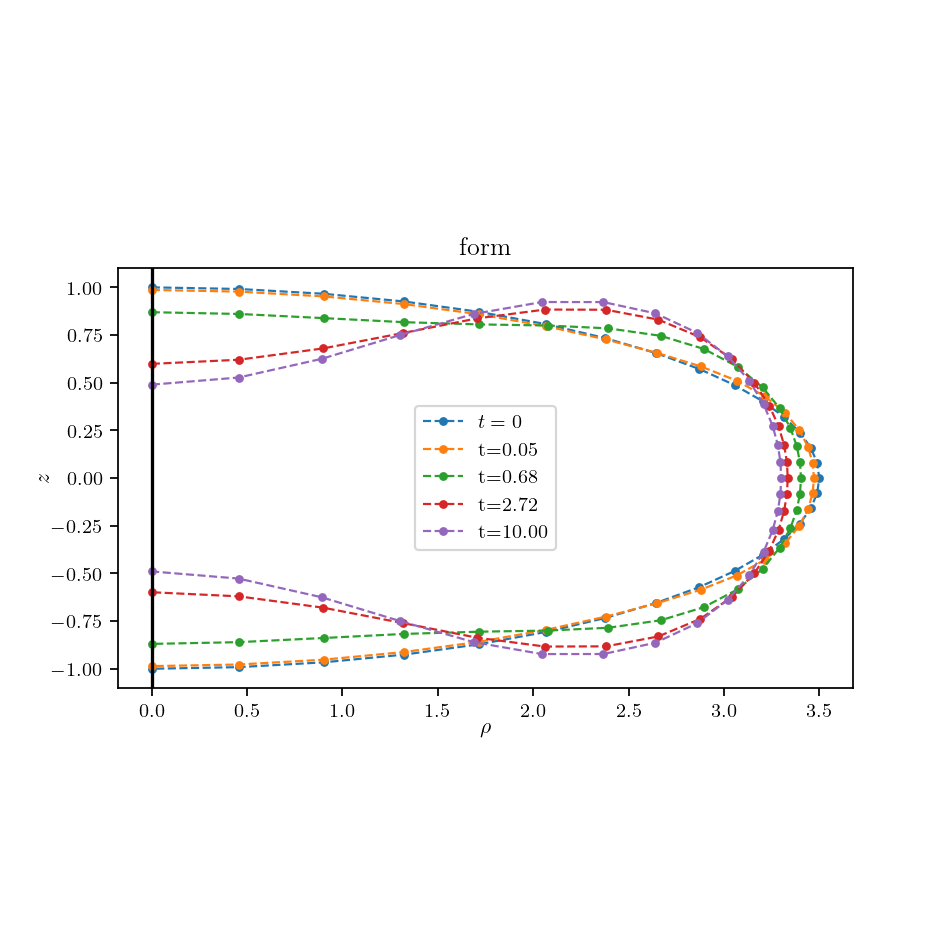

Text(0.5, 1.0, 'form')

In [139]:
plt.figure(figsize=(6,6))
plt.plot(P_ar, Z_ar,'.--',lw=1, ms=6, label=r'$t=0$')
for j in [-30,-20,-10,-1]:
    plt.plot(sol_bdf.y[:N+1,j], sol_bdf.y[N+1:,j],'.--',lw=1, ms=6, label=f't={sol_bdf.t[j]:.2f}')


plt.axis('scaled')
plt.legend()
plt.axvline(0, color='k')
plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

<IPython.core.display.Javascript object>


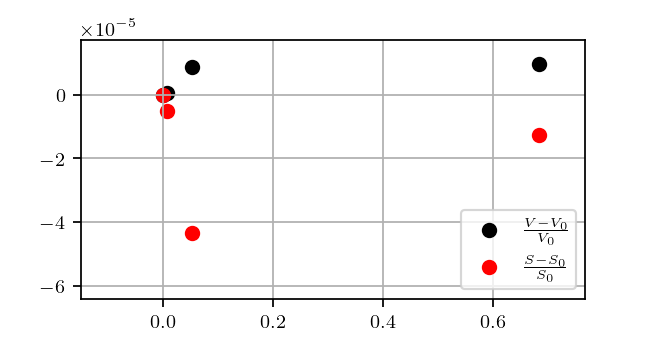

Text(0.5, 0, '$t$')

In [140]:
Vol0, Sqr0 = get_VolSqr(P_ar, Z_ar)
plt.figure(figsize=(3,2))
plt.grid()
for j in [-35,-30,-20,-15,-5, -1]:
    Vol,Sqr = get_VolSqr(sol_bdf.y[:N+1,j], sol_bdf.y[N+1:,j])
    plt.scatter(sol_bdf.t[j], Vol/Vol0-1,color='k')
    plt.scatter(sol_bdf.t[j], Sqr/Sqr0-1,color='r')
    
plt.scatter(0, 0,color='k', label=r'$\frac{V-V_0}{V_0}$')
plt.scatter(0, 0,color='r', label=r'$\frac{S-S_0}{S_0}$')
plt.legend()
plt.xlabel(r'$t$')
#plt.savefig('Dynamo_bdf_Ell_a=3_VolSqr.png', bbox_inches="tight", dpi=500)

In [141]:
Vol0/4/np.pi*3/(Sqr0/4/np.pi)**(3/2)

0.6435271753248232

<IPython.core.display.Javascript object>


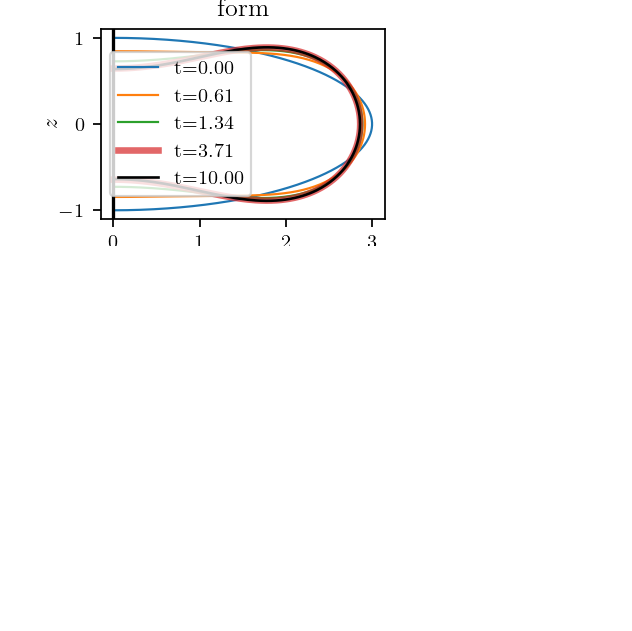

In [131]:
%matplotlib notebook
plt.figure(figsize=(4,4))
plt.plot(R_int_mesh @ extender_p @ P_ar,                 R_int_mesh @ extender_z @ Z_ar,'-',lw=1, ms=6)
plt.plot(R_int_mesh @ extender_p @ sol_bdf.y[:N+1,-120], R_int_mesh @ extender_z @ sol_bdf.y[N+1:,-120],'-',lw=1, ms=6)
plt.plot(R_int_mesh @ extender_p @ sol_bdf.y[:N+1,-115], R_int_mesh @ extender_z @ sol_bdf.y[N+1:,-115],'-',lw=1, ms=6)
plt.plot(R_int_mesh @ extender_p @ sol_bdf.y[:N+1,-100], R_int_mesh @ extender_z @ sol_bdf.y[N+1:,-100],'-',lw=3, alpha=0.7,ms=6)

plt.plot(R_int_mesh @ extender_p @ sol_bdf.y[:N+1,-1],   R_int_mesh @ extender_z @ sol_bdf.y[N+1:,-1],'-',lw=1.2, ms=6, color = 'k')

plt.axis('scaled')
plt.legend([f't={sol_bdf.t[0]:.2f}', f't={sol_bdf.t[-120]:.2f}', f't={sol_bdf.t[-115]:.2f}', 
           f't={sol_bdf.t[-100]:.2f}', f't={sol_bdf.t[-1]:.2f}'])
plt.axvline(0, color='k')
plt.xlabel(r'$\rho$', labelpad=-1)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')
plt.savefig('Dynamo_bdf_Ell_a=3.png', bbox_inches="tight", dpi=500)

<IPython.core.display.Javascript object>


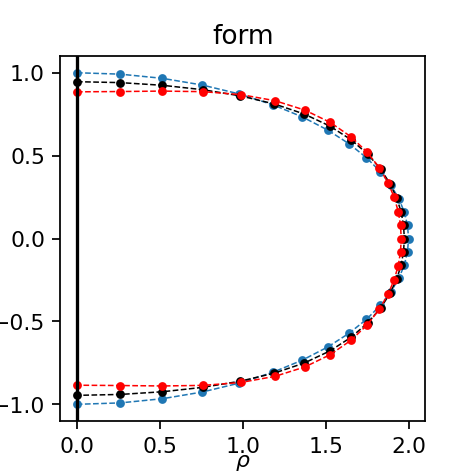

Text(0.5, 1.0, 'form')

In [49]:
plt.figure(figsize=(3,3))
plt.plot(P_ar, Z_ar,'.--',lw=0.7, ms=6, color = 'C0')
plt.plot(sol_bdf.y[:N+1,-15], sol_bdf.y[N+1:,-15],'.--',lw=0.7, ms=6, color = 'k')

plt.plot(sol_bdf.y[:N+1,-1], sol_bdf.y[N+1:,-1],'.--',lw=0.7, ms=6, color = 'r')

plt.axis('scaled')

plt.axvline(0, color='k')
plt.xlabel(r'$\rho$', labelpad=-2)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

In [53]:
P_end,Z_end = sol_bdf.y[:N+1,-1], sol_bdf.y[N+1:,-1]
H_end, sigma_end = get_H_sigma(P_end,Z_end)
force_end = get_force(P_end, Z_end)

<IPython.core.display.Javascript object>


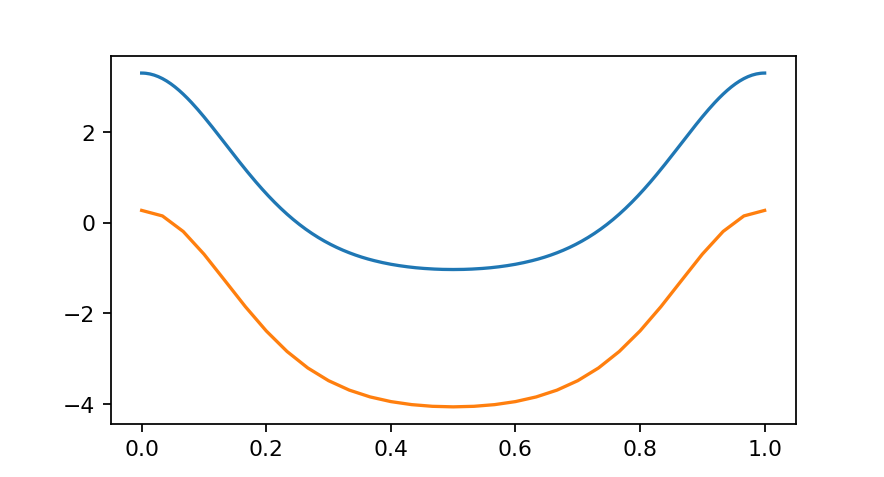

In [61]:
plt.figure()
#plt.plot(tau_int, H_end)
plt.plot(tau_int, force_end)
#plt.plot(tau_ar, sigma_end)
plt.plot(tau_ar, sigma_end*H_end[::N_int//N])


In [26]:
sol_lsoda = sc.integrate.solve_ivp(func, (0., 0.1), np.concatenate([P_ar, Z_ar]), method='LSODA')

<IPython.core.display.Javascript object>


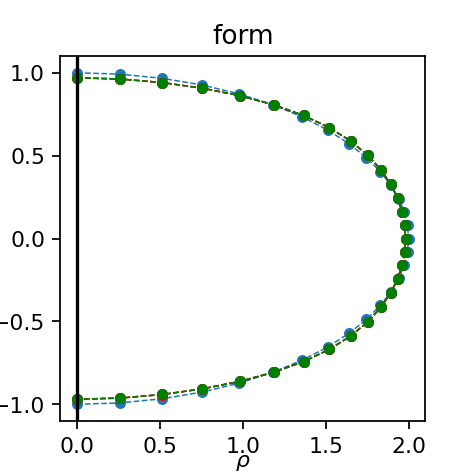

Text(0.5, 1.0, 'form')

In [33]:
plt.figure(figsize=(3,3))
plt.plot(P_ar, Z_ar,'.--',lw=0.7, ms=8, color = 'C0')
plt.plot(sol.y[:N+1,-1], sol.y[N+1:,-1],'.--',lw=0.7, ms=8, color = 'k')
plt.plot(sol_bdf.y[:N+1,-1], sol_bdf.y[N+1:,-1],'.--',lw=0.7, ms=8, color = 'r')
plt.plot(sol_lsoda.y[:N+1,-1], sol_lsoda.y[N+1:,-1],'.--',lw=0.7, ms=8, color = 'g')

plt.axis('scaled')

plt.axvline(0, color='k')
plt.xlabel(r'$\rho$', labelpad=-2)
plt.ylabel(r'$z$', labelpad=-1)
plt.title('form')

In [25]:
1/N**4

1.234567901234568e-06

In [29]:
dt = 5e-7
p1 = p0 + dt*v_rho_0
z1 = z0 + dt*v_z_0
v_rho_1, v_z_1 = get_velo(p1, z1)

p_old = p0.copy()
z_old = z0.copy()
v_rho_old = v_rho_0.copy()
v_z_old = v_z_0.copy()

p_now = p1.copy()
z_now = z1.copy()
v_rho_now = v_rho_1.copy()
v_z_now = v_z_1.copy()

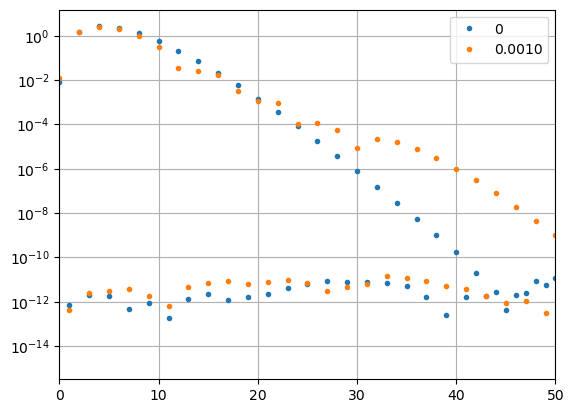

  0%|          | 0/1000 [00:00<?, ?it/s]

In [ ]:
%matplotlib inline
dinamic={}
t=0
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1) 
ax.plot(np.abs(np.fft.rfft(get_ext_array(get_force(p0, z0)), norm='forward')),'.')
fc_plot, = ax.plot(np.abs(np.fft.rfft(get_ext_array(get_force(p_now, z_now)), norm='forward')),'.')
ax.grid()
ax.set_xlim(0,50)

ax.set_yscale('log')
dh = display.display(fig, display_id=True)


for i in tqdm(range(10**3)):
    for j in range(10**3):
        p_new = p_now + dt*(v_rho_now + (v_rho_now-v_rho_old)/2)
        z_new = z_now + dt*(v_z_now + (v_z_now-v_z_old)/2)

        v_rho_new, v_z_new = get_velo(p_new, z_new)
   
        t+=dt

        p_old = p_now.copy()
        z_old = z_now.copy()
        v_rho_old = v_rho_now.copy()
        v_z_old = v_z_now.copy()
        
        p_now = p_new.copy()
        z_now = z_new.copy()
        v_rho_now = v_rho_new.copy()
        v_z_now = v_z_new.copy()
    
    
    dinamic[t]=(p_new, z_new)
    fc_plot.set_ydata(np.abs(np.fft.rfft(get_ext_array(get_force(p_now, z_now)), norm='forward')))
    ax.legend(['0',f'{t:.4f}'])
    plt.draw()
    dh.update(fig)
        #display(fig, clear=True)
        #display.display(fig, clear=True)
        

In [181]:
np.save(f'dynamic_ellip_a=2_{N}_{N_int}.npy', dinamic)

<IPython.core.display.Javascript object>


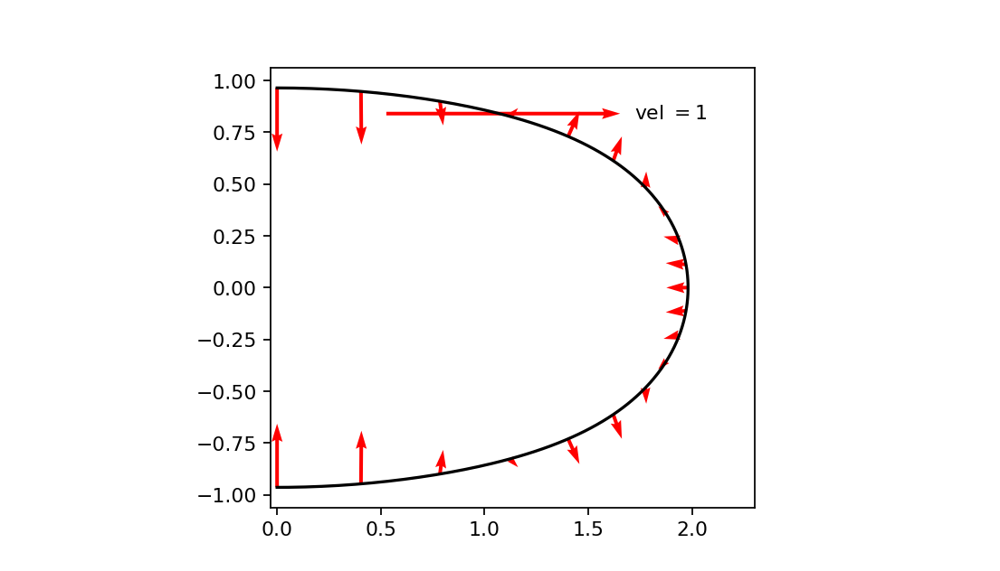

<IPython.core.display.Javascript object>


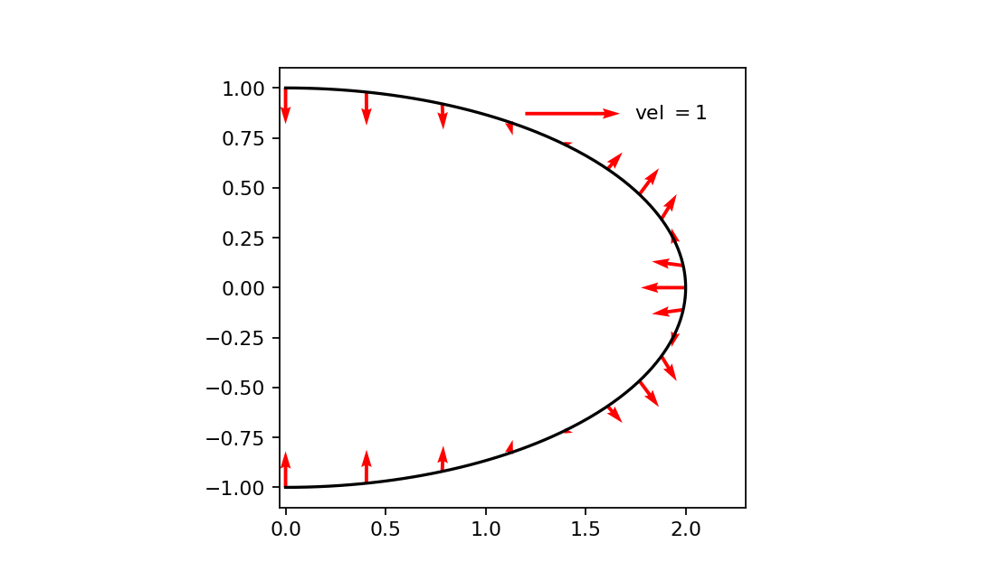

<IPython.core.display.Javascript object>


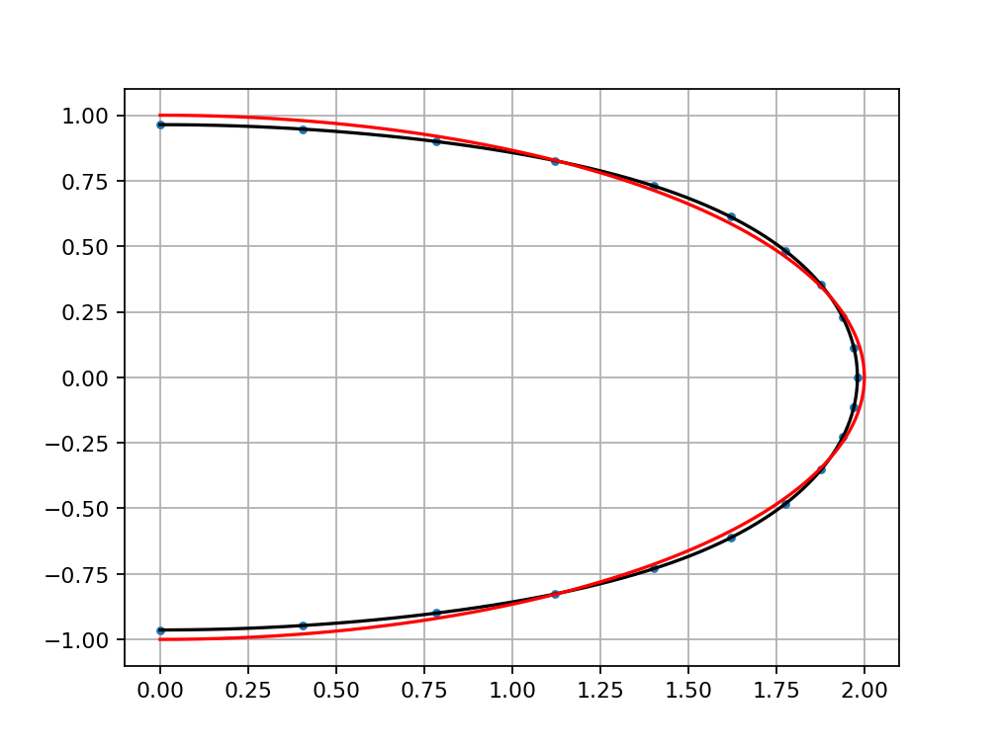

<IPython.core.display.Javascript object>


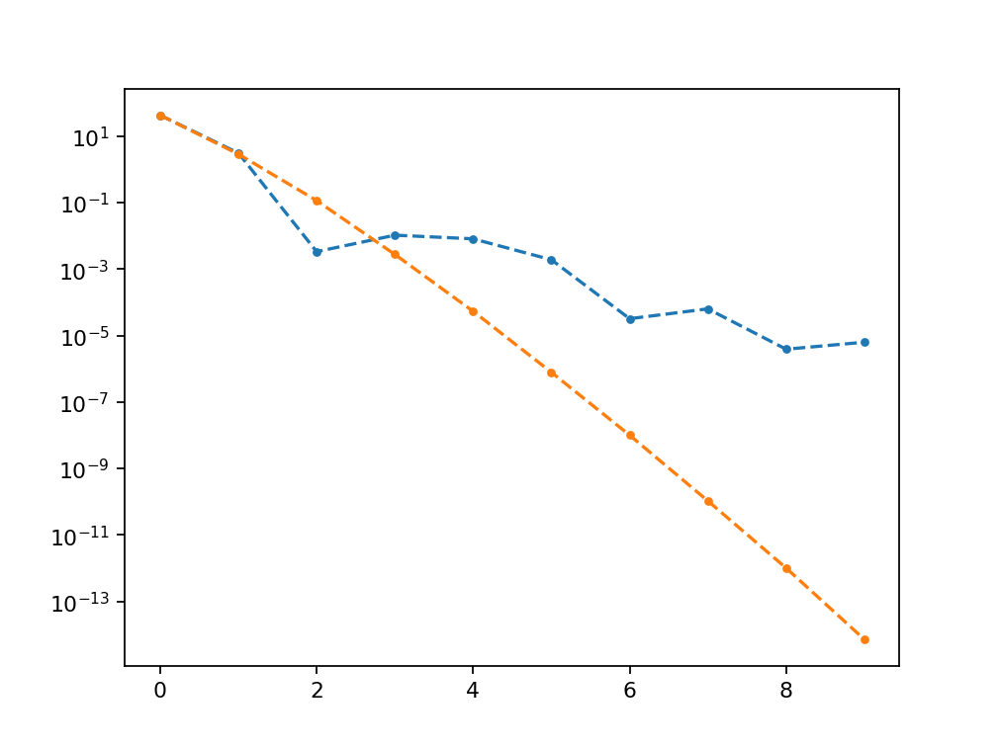

<IPython.core.display.Javascript object>


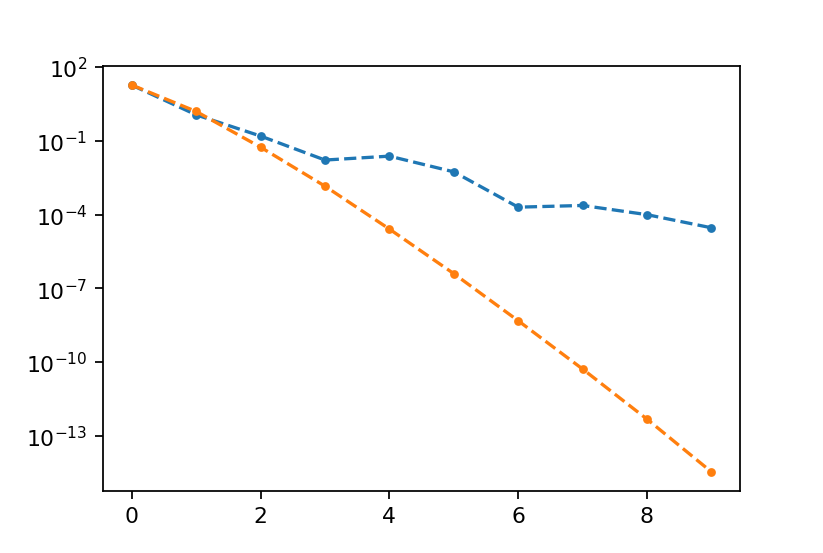

<IPython.core.display.Javascript object>


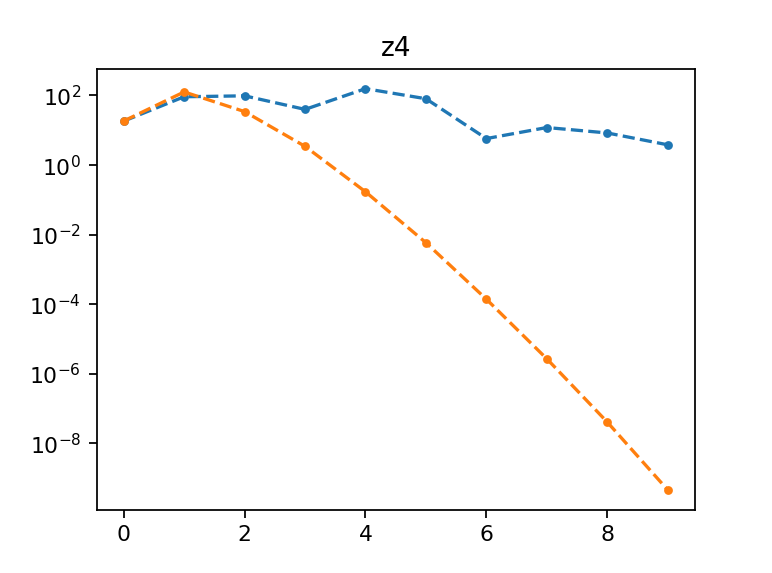

<IPython.core.display.Javascript object>


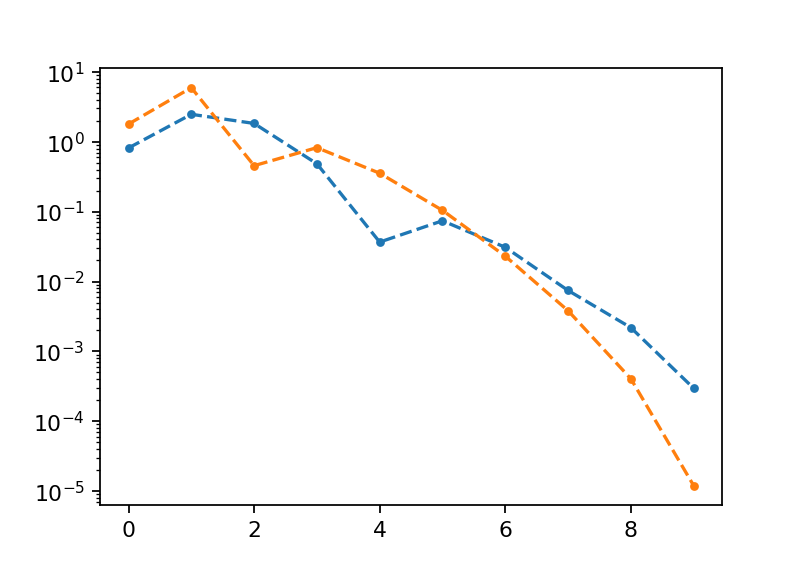

<IPython.core.display.Javascript object>


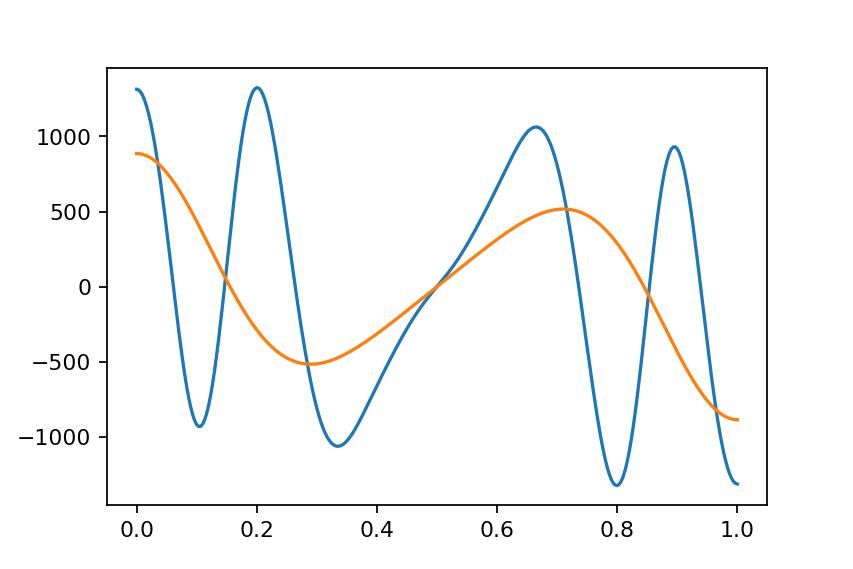

<IPython.core.display.Javascript object>


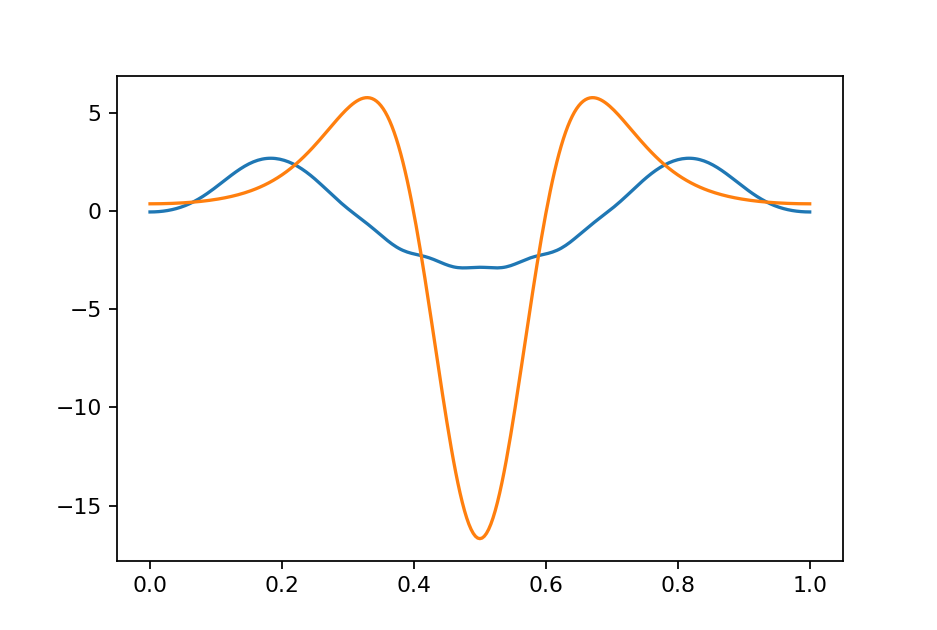

<IPython.core.display.Javascript object>


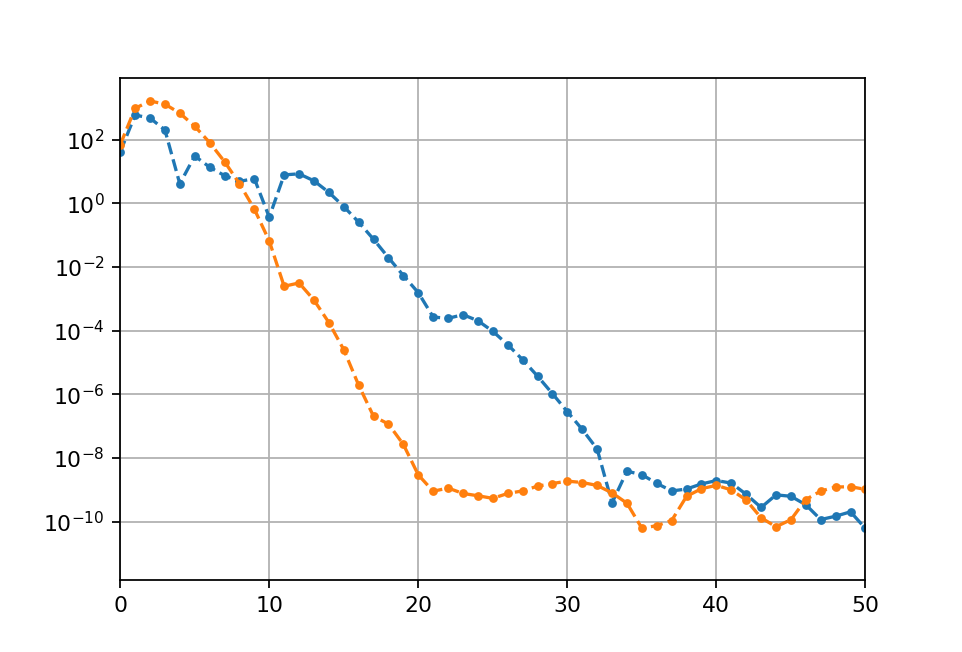

In [249]:



fig = plt.figure(figsize = (7,4))
ax = fig.add_subplot(1, 1, 1)

#ax.scatter(p0, z0,s=6)
#qk = ax.quiverkey(Q, 0.4, 0.5, 100, r'$v=100$', labelpos='E',
#                  coordinates='figure')
plt.plot(R_int_mesh @ extender_p @ p_now, R_int_mesh @ extender_z @ z_now,'k')

Qnow = ax.quiver(p_now, z_now, v_rho_now, v_z_now, color='red')
qk = ax.quiverkey(Qnow, 0.62, 0.8, 1, r'vel $=1$', labelpos='E',
                  coordinates='figure')

plt.axis('scaled')
plt.xlim(-3e-2,2.3)

fig = plt.figure(figsize = (7,4))
ax = fig.add_subplot(1, 1, 1)
plt.plot(R_int_mesh @ extender_p @ p0, R_int_mesh @ extender_z @ z0,'k')

Qnow = ax.quiver(p0, z0, v_rho_0, v_z_0, color='red')
qk = ax.quiverkey(Qnow, 0.62, 0.8, 1, r'vel $=1$', labelpos='E',
                  coordinates='figure')

#ax.scatter(p_old, z_old,s=6)
#plt.grid()
#plt.legend()
plt.axis('scaled')
plt.xlim(-3e-2,2.3)
#plt.ylim(-1.6,1.2)
#
#plt.xlabel(r'$\rho$')
#plt.ylabel(r'$z$')
#plt.grid()





plt.figure()
#i=1
#p_now, z_now = dinamic[(list(dinamic.keys()))[i]]
plt.plot(p_now, z_now,'.')
plt.plot(R_int_mesh @ extender_p @ p_now, R_int_mesh @ extender_z @ z_now,'k')
plt.plot(R_int_mesh @ extender_p @ p0, R_int_mesh @ extender_z @ z0,'r')
plt.grid()

plt.figure()
plt.plot(np.abs(np.fft.rfft(extender_p @ p_now))[1::2], '.--')
plt.plot(np.abs(np.fft.rfft(extender_p @ p0))[1::2], '.--')

plt.yscale('log')


plt.figure()
plt.plot(np.abs(np.fft.rfft(extender_z @ z_now))[1::2], '.--')
plt.plot(np.abs(np.fft.rfft(extender_z @ z0))[1::2], '.--')

plt.yscale('log')

plt.figure()
plt.plot((np.arange(0,21)**4*np.abs(np.fft.rfft(extender_z @ z_now)))[1::2], '.--')
plt.plot((np.arange(0,21)**4*np.abs(np.fft.rfft(extender_z @ z0)))[1::2], '.--')
plt.title('z4')
plt.yscale('log')



plt.figure()
plt.plot(np.abs(np.fft.rfft(extender_z @ v_z_now))[1::2], '.--')
plt.plot(np.abs(np.fft.rfft(extender_z @ v_z_0))[1::2], '.--')

plt.yscale('log')

plt.figure()
plt.plot(tau_int, R4_int_mesh @ extender_z @ z_now)
plt.plot(tau_int, R4_int_mesh @ extender_z @ z0)

plt.figure()
plt.plot(tau_int, get_force(p_now, z_now))
plt.plot(tau_int, get_force(p0, z0))

plt.figure()
plt.plot(np.abs(np.fft.rfft(get_ext_array(get_force(p_now, z_now))))[::2], '.--')
plt.plot(np.abs(np.fft.rfft(get_ext_array(get_force(p0, z0))))[::2], '.--')
plt.grid()

plt.xlim(0,50)

plt.yscale('log')

<IPython.core.display.Javascript object>


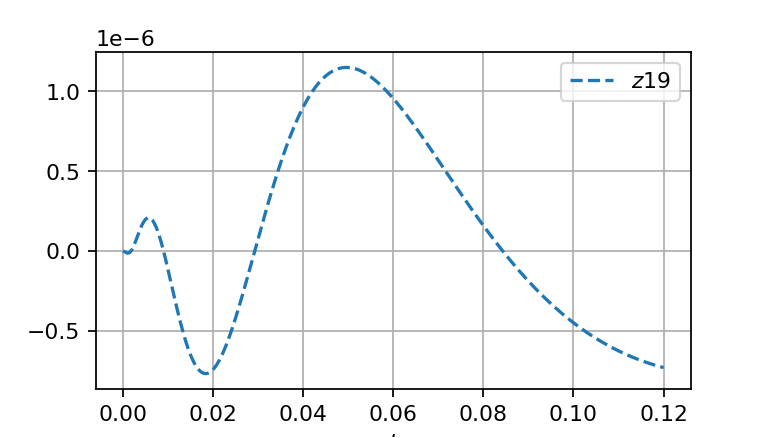

Text(0.5, 0, '$t$')

In [247]:
%matplotlib notebook
plt.figure(figsize=(5,3))
for k in [19]:
    plt.plot([(list(dinamic.keys()))[i] for i in range(len(list(dinamic.keys())))],
             [np.real(np.fft.rfft(get_ext_array(
        (dinamic[(list(dinamic.keys()))[i]])[1]),norm='forward'))[k] for i in range(len(list(dinamic.keys())))],'--',label=fr'$z {k}$')
plt.grid()
plt.legend()
plt.xlabel(r'$t$')
#plt.yscale('log')